# LAB 2

<font size="4">**Lab 2 - Principal Component Analysis**</font>

## Libraries

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from mpl_toolkits.mplot3d import Axes3D
import warnings
warnings.filterwarnings("ignore")

In [2]:
plt.rcParams["figure.figsize"] = (8,6)
plt.rcParams["figure.dpi"] = 100

## 2D PCA - Implementation and Theory

## Empirical Search for the Direction of Maximum Variance

Simulate bivariate normal data

In [3]:
np.random.seed(5032024) # fix random seed for reproducible results
mu = np.array([1, 2]) # mean
sig = np.array([[1, 1], # cov matrix
                [1, 4]])
n = 100 # number of observations
X = np.random.multivariate_normal(mu, sig, n) # sample from multivariate normal N(mu,sig)
mean_X = X.mean(axis=0)

In [4]:
mean_X

array([1.07391511, 1.96455451])

Plot the data and the sample mean

Text(0.5, 1.0, 'Bivariate Normal Data')

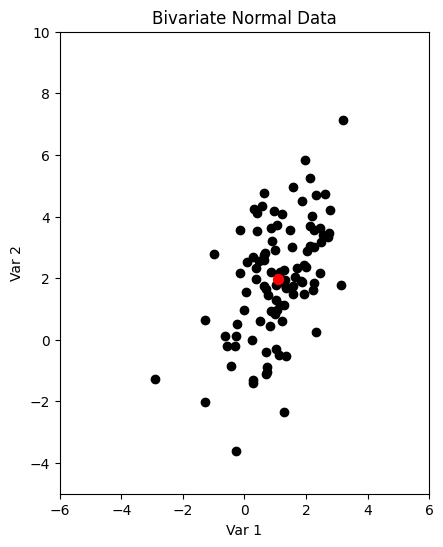

In [ ]:
fig, ax = plt.subplots()
ax.scatter(X[:,0], X[:,1], color='black', marker='o') # plot the data
ax.scatter(mean_X[0], mean_X[1], color='red', s=50) # add a red point with the sample mean
ax.set_xlabel('Var 1')
ax.set_ylabel('Var 2')
ax.set_xlim(-6, 6)
ax.set_ylim(-5, 10)
ax.set_aspect('equal', adjustable='box')
plt.title('Bivariate Normal Data')

Compute the variance along specific directions

Variance along x-axis: 1.1063041224946633


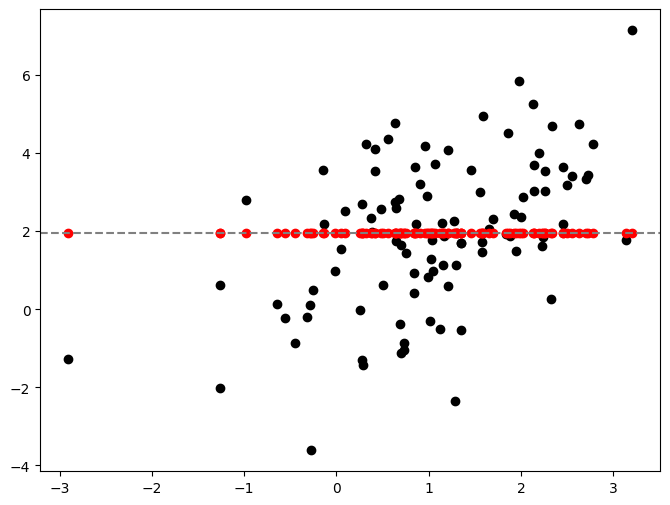

In [ ]:
# Compute and plot variance of the projection of the data along the x-axis
fig, ax = plt.subplots()
ax.scatter(X[:,0], X[:,1], color='black')
ax.axhline(mean_X[1], color='grey', linestyle='--')
ax.scatter(X[:,0], np.full(n, mean_X[1]), color='red')
var_x = np.var(X[:,0], ddof=1) # ddof=1 computes the sample variance correctly
print('Variance along x-axis:', var_x)

Variance along y-axis: 3.6623604597560124


Text(0.5, 1.0, 'Variance along Coordinate Axes')

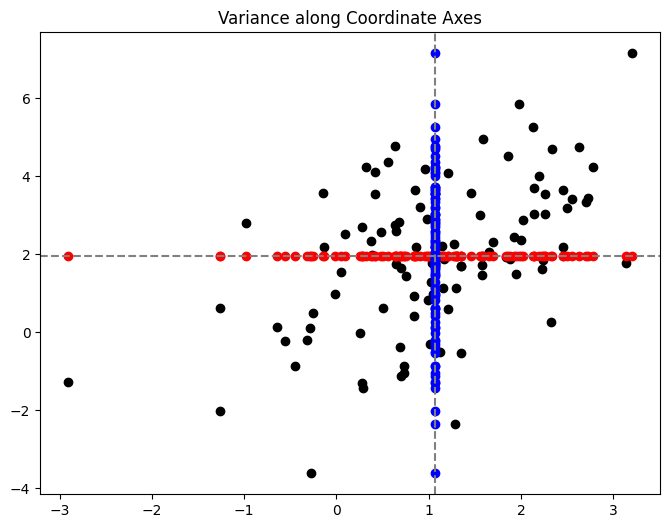

In [ ]:
fig, ax = plt.subplots()
ax.scatter(X[:,0], X[:,1], color='black')
ax.axhline(mean_X[1], color='grey', linestyle='--')
ax.scatter(X[:,0], np.full(n, mean_X[1]), color='red')

ax.axvline(mean_X[0], color='grey', linestyle='--')
ax.scatter(np.full(n, mean_X[0]), X[:,1], color='blue')
var_y = np.var(X[:,1], ddof=1)
print('Variance along y-axis:', var_y)
plt.title('Variance along Coordinate Axes')

Projection along theta = pi/6

Variance along direction (pi/6): 2.6343768188470174


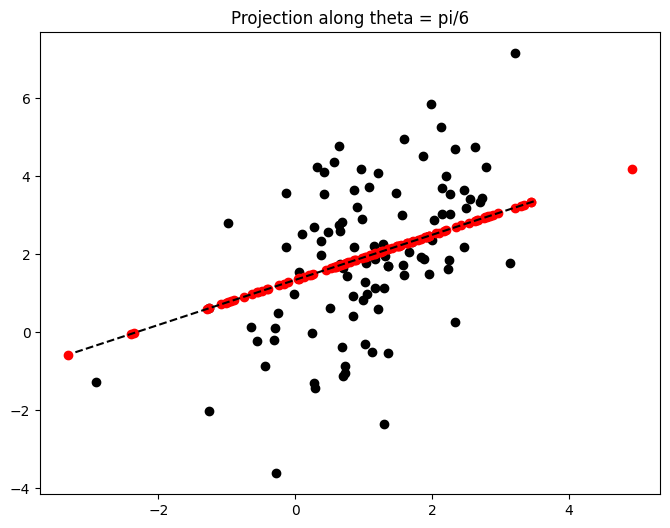

In [ ]:
theta = np.pi / 6
a = np.array([np.cos(theta), np.sin(theta)])
proj30 = (X - mean_X) @ a # matrix multiplication
## TODO
fig, ax = plt.subplots()
ax.scatter(X[:,0], X[:,1], color='black')
x_line = np.linspace(ax.get_xlim()[0], ax.get_xlim()[1], 100)
y_line = mean_X[1] - np.tan(theta)*mean_X[0] + np.tan(theta)*x_line
ax.plot(x_line, y_line, linestyle='--', color='black')
ax.scatter(mean_X[0] + np.cos(theta)*proj30, mean_X[1] + np.sin(theta)*proj30, color='red')
var_proj30 = np.var(proj30, ddof=1)
print('Variance along direction (pi/6):', var_proj30)
plt.title('Projection along theta = pi/6')
plt.show()

Compute variance along all directions, find min and max variance

In [8]:
thetas = np.linspace(0, np.pi, 181)
variances = []

for t in thetas:
## TODO
  a = np.array([np.cos(t), np.sin(t)])
  proj = (X - mean_X) @ a # matrix multiplication
  var_proj = np.var(proj, ddof=1)
  variances.append(var_proj)

max_theta_idx = np.argmax(variances)
max_theta = thetas[max_theta_idx]

min_theta_idx = np.argmin(variances)
min_theta = thetas[min_theta_idx]

In [9]:
max_theta / np.pi * 180
#degrees

np.float64(71.0)

In [10]:
min_theta / np.pi * 180

np.float64(161.0)

In [ ]:
max_var

4.023468121296431

In [ ]:
min_var

0.7451964609542457

Plot variance along all directions, highlighting directions with min and max variance

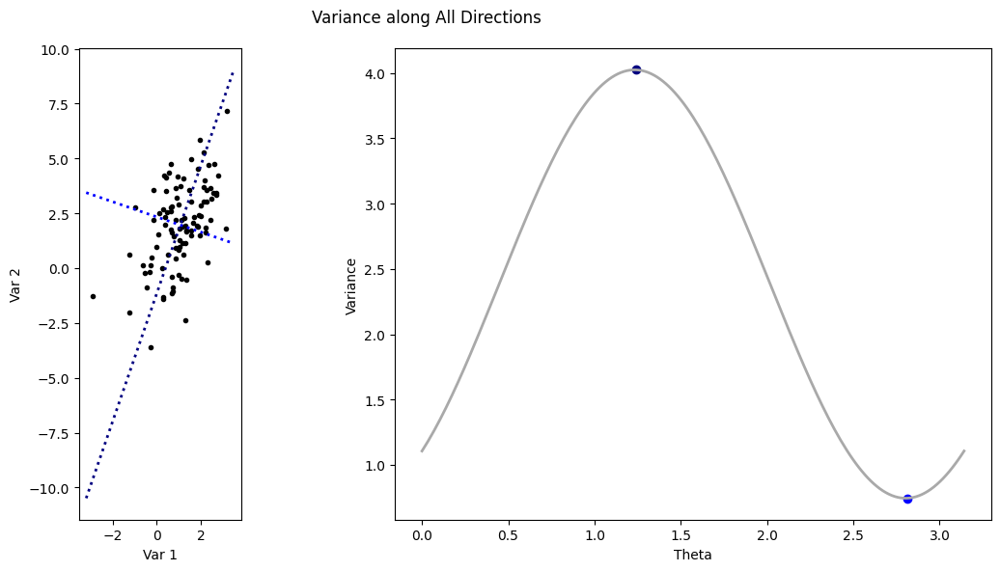

In [ ]:
fig, axs = plt.subplots(1, 2, figsize=(12,6))
axs[0].scatter(X[:,0], X[:,1], color='black', marker='.')
axs[0].plot(x_line, mean_X[1] - np.tan(max_theta)*mean_X[0] + np.tan(max_theta)*x_line,
            linestyle=':', color='navy', linewidth=2)
axs[0].plot(x_line, mean_X[1] - np.tan(min_theta)*mean_X[0] + np.tan(min_theta)*x_line,
            linestyle=':', color='blue', linewidth=2)
axs[0].set_xlabel('Var 1')
axs[0].set_ylabel('Var 2')
axs[0].set_aspect('equal')

axs[1].plot(thetas, variances, color='darkgrey', linewidth=2)
axs[1].scatter([max_theta], [max_var], color='navy')
axs[1].scatter([min_theta], [min_var], color='blue')
axs[1].set_xlabel('Theta')
axs[1].set_ylabel('Variance')
plt.suptitle('Variance along All Directions')
plt.tight_layout()
plt.show()

## Confrontation with the theory

In [ ]:
# Compute the sample covariance matrix and its eigen-decomposition
M = mean_X  # sample mean from previous cell
S = np.cov(X, rowvar=False)
eigvals, eigvecs = np.linalg.eig(S)
order = eigvals.argsort()[::-1] #sort in descending order for eigenvalues
eigvals, eigvecs = eigvals[order], eigvecs[:, order]

print("Eigenvalues:", eigvals)
print("Eigenvectors (columns):\n", eigvecs)
print("Empirical max variance:", max_var)
print("Empirical min variance:", min_var)

max_a = np.array([np.cos(max_theta), np.sin(max_theta)])
min_a = np.array([np.cos(min_theta), np.sin(min_theta)])
print("Empirical max direction:", max_a)
print("Empirical min direction:", min_a)

Eigenvalues: [4.02361759 0.74504699]
Eigenvectors (columns):
 [[-0.33194486 -0.94329879]
 [-0.94329879  0.33194486]]
Empirical max variance: 4.023468121296431
Empirical min variance: 0.7451964609542457
Empirical max direction: [0.32556815 0.94551858]
Empirical min direction: [-0.94551858  0.32556815]


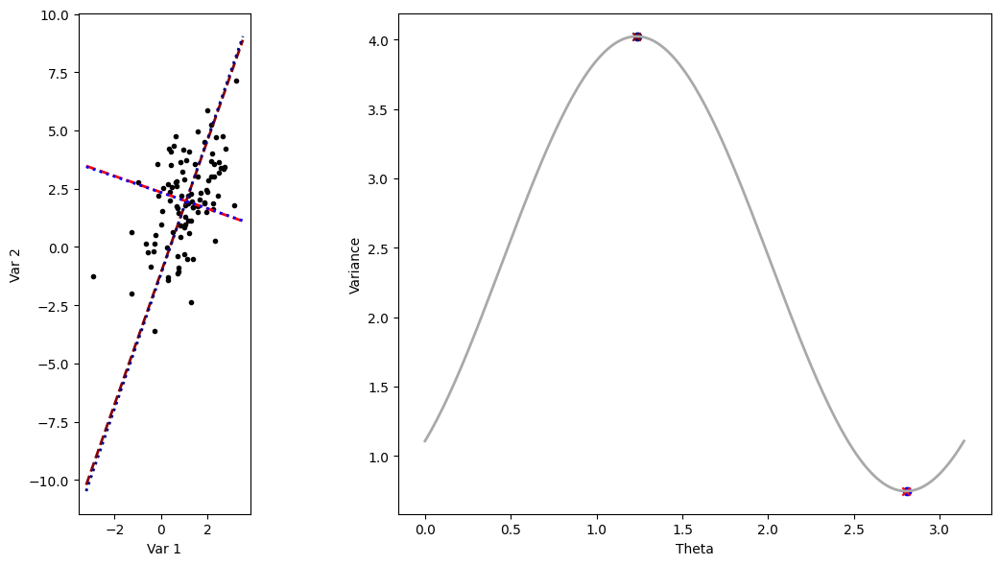

In [ ]:
fig, axs = plt.subplots(1, 2, figsize=(12,6))

# Left subplot: data and direction lines
axs[0].scatter(X[:,0], X[:,1], color='black', marker='.')
axs[0].set_xlabel('Var 1')
axs[0].set_ylabel('Var 2')
axs[0].set_aspect('equal')

# Plot the eigenvector directions (using slopes computed from eigenvectors)
slope1 = eigvecs[1,0] / eigvecs[0,0]
slope2 = eigvecs[1,1] / eigvecs[0,1]
x_line = np.linspace(axs[0].get_xlim()[0], axs[0].get_xlim()[1], 100)
axs[0].plot(x_line, M[1] - slope1*M[0] + slope1*x_line,
            linestyle='--', color='darkred', linewidth=2)
axs[0].plot(x_line, M[1] - slope2*M[0] + slope2*x_line,
            linestyle='--', color='red', linewidth=2)

# Also plot the empirically found max/min directions for comparison
axs[0].plot(x_line, M[1] - np.tan(max_theta)*M[0] + np.tan(max_theta)*x_line,
            linestyle=':', color='navy', linewidth=2)
axs[0].plot(x_line, M[1] - np.tan(min_theta)*M[0] + np.tan(min_theta)*x_line,
            linestyle=':', color='blue', linewidth=2)

# Right subplot: variance as a function of theta, marking the extrema
axs[1].plot(thetas, variances, color='darkgrey', linewidth=2)

axs[1].scatter([max_theta], [max_var], color='navy', marker='o')
axs[1].scatter([min_theta], [min_var], color='blue', marker='o')

angle1 = np.arctan(eigvecs[1, 0] / eigvecs[0, 0])
angle2 = np.arctan(eigvecs[1, 1] / eigvecs[0, 1]) + np.pi
axs[1].scatter(angle1, max(eigvals), marker='x', color='darkred', label='Max Var')
axs[1].scatter(angle2, min(eigvals), marker='x', color='red', label='Min Var')

axs[1].set_xlabel('Theta')
axs[1].set_ylabel('Variance')

plt.tight_layout()
plt.show()

## 3D PCA Visualization

The next cells simulate 3D data, plot the data and a covariance ellipsoid, and then show how the PCA approximates the data by 0D (a point), 1D (a line) and 2D (a plane) representations.

In [ ]:
# Simulate 3D data
mu3 = np.array([0, 2, 3])
sig3 = np.array([[9, 1, 1],
                 [1, 4, 1],
                 [1, 1, 1]])
nobs = 100
X3 = np.random.multivariate_normal(mu3, sig3, nobs)
M3 = X3.mean(axis=0)
S3 = np.cov(X3, rowvar=False)
print('3D sample mean:', M3)
print('3D sample covariance:\n', S3)

3D sample mean: [0.49563483 2.15064285 3.13808932]
3D sample covariance:
 [[8.96561188 0.68645295 1.16789945]
 [0.68645295 3.29351486 0.80839048]
 [1.16789945 0.80839048 0.90224219]]


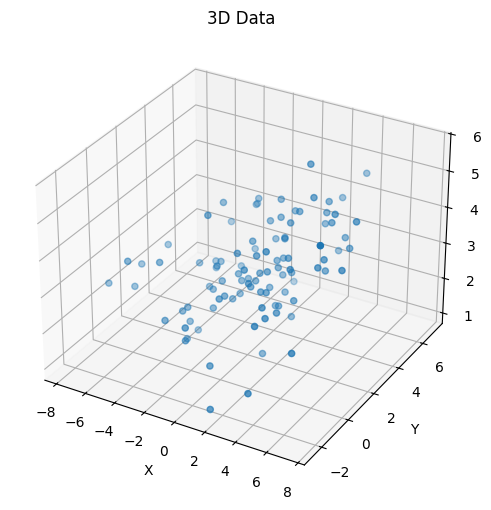

In [ ]:
# 3D plot of data
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.scatter(X3[:,0], X3[:,1], X3[:,2], s=20)
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')
plt.title('3D Data')
plt.show()

In [ ]:
pca3 = PCA()
PC_scores = pca3.fit_transform(X3)
print('3D PCA components:\n', pca3.components_)
print('3D PCA explained variance:', pca3.explained_variance_)

3D PCA components:
 [[ 0.97959616  0.13354028  0.15019439]
 [-0.16653875  0.95769728  0.23469291]
 [-0.1124998  -0.25491746  0.96039621]]
3D PCA explained variance: [9.23825594 3.37224798 0.55086502]


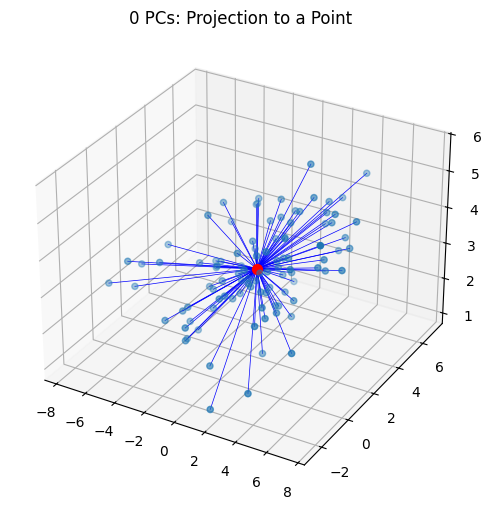

In [ ]:
# 0-dimensional approximation: projection to the mean
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.scatter(X3[:,0], X3[:,1], X3[:,2], s=20)
ax.scatter(M3[0], M3[1], M3[2], color='red', s=50)
for i in range(nobs):
    ax.plot([X3[i,0], M3[0]], [X3[i,1], M3[1]], [X3[i,2], M3[2]], color='blue', linewidth=0.5)
ax.set_title('0 PCs: Projection to a Point')
plt.show()

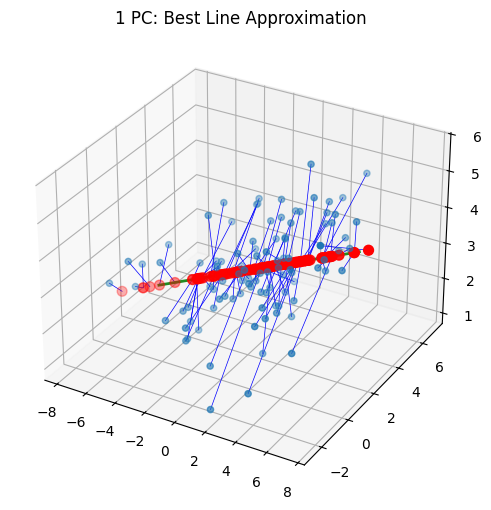

In [ ]:
# 1D approximation: projection on first principal component
explained_std = np.sqrt(pca3.explained_variance_)
PC1 = np.array([M3 + score[0] * pca3.components_[0] for score in PC_scores])
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.scatter(X3[:,0], X3[:,1], X3[:,2], s=20)
ax.scatter(PC1[:,0], PC1[:,1], PC1[:,2], color='red', s=50)
for i in range(nobs):
    ax.plot([X3[i,0], PC1[i,0]], [X3[i,1], PC1[i,1]], [X3[i,2], PC1[i,2]], color='blue', linewidth=0.5)
line_PC1 = np.array([M3 + 2*explained_std[0]*pca3.components_[0],
                     M3 - 2*explained_std[0]*pca3.components_[0]])
ax.plot(line_PC1[:,0], line_PC1[:,1], line_PC1[:,2], color='forestgreen', linewidth=2)
ax.set_title('1 PC: Best Line Approximation')
plt.show()

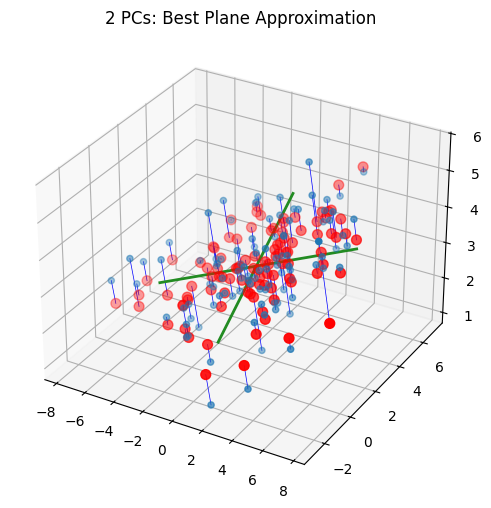

In [ ]:
# 2D approximation: projection on first two principal components
PC12 = np.array([M3 + score[0]*pca3.components_[0] + score[1]*pca3.components_[1] for score in PC_scores])
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.scatter(X3[:,0], X3[:,1], X3[:,2], s=20)
ax.scatter(PC12[:,0], PC12[:,1], PC12[:,2], color='red', s=50)
for i in range(nobs):
    ax.plot([X3[i,0], PC12[i,0]], [X3[i,1], PC12[i,1]], [X3[i,2], PC12[i,2]], color='blue', linewidth=0.5)
line_PC1 = np.array([M3 + 2*explained_std[0]*pca3.components_[0], M3 - 2*explained_std[0]*pca3.components_[0]])
line_PC2 = np.array([M3 + 2*explained_std[1]*pca3.components_[1], M3 - 2*explained_std[1]*pca3.components_[1]])
ax.plot(line_PC1[:,0], line_PC1[:,1], line_PC1[:,2], color='forestgreen', linewidth=2)
ax.plot(line_PC2[:,0], line_PC2[:,1], line_PC2[:,2], color='forestgreen', linewidth=2)
ax.set_title('2 PCs: Best Plane Approximation')
plt.show()

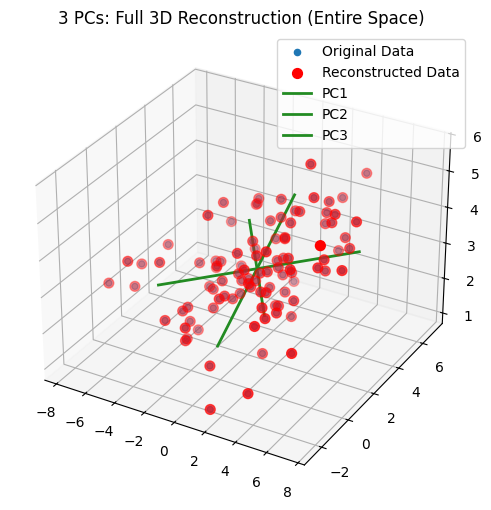

In [ ]:
# ## Space spanned by all PCs -------------------------------------------------------------------
# I, II and III principal components: the best approximation of dimension 3 (the entire space)

# Reconstruct each observation using all three PCs.
# This reconstruction should be (almost) identical to the original data.
PC123 = np.array([
    M3 + score[0]*pca3.components_[0] + score[1]*pca3.components_[1] + score[2]*pca3.components_[2]
    for score in PC_scores
])

# Create a 3D figure for the full reconstruction.
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

# Plot the original 3D data points.
ax.scatter(X3[:, 0], X3[:, 1], X3[:, 2], s=20, label='Original Data')

# Plot the reconstructed data points (should closely overlay the original points).
ax.scatter(PC123[:, 0], PC123[:, 1], PC123[:, 2], color='red', s=50, label='Reconstructed Data')

# Draw blue lines connecting each original point with its reconstruction.
for i in range(nobs):
    ax.plot([X3[i, 0], PC123[i, 0]],
            [X3[i, 1], PC123[i, 1]],
            [X3[i, 2], PC123[i, 2]],
            color='blue', linewidth=0.5)

# For consistency with the 1D and 2D projection codes,
# we plot the principal component directions scaled by 2*standard deviation.
# (Here, we assume that 'explained_std' was computed as:
#     explained_std = np.sqrt(pca3.explained_variance_))
line_PC1 = np.array([M3 + 2 * explained_std[0] * pca3.components_[0],
                     M3 - 2 * explained_std[0] * pca3.components_[0]])
line_PC2 = np.array([M3 + 2 * explained_std[1] * pca3.components_[1],
                     M3 - 2 * explained_std[1] * pca3.components_[1]])
line_PC3 = np.array([M3 + 2 * explained_std[2] * pca3.components_[2],
                     M3 - 2 * explained_std[2] * pca3.components_[2]])

# Plot the principal component directions.
ax.plot(line_PC1[:, 0], line_PC1[:, 1], line_PC1[:, 2],
        color='forestgreen', linewidth=2, label='PC1')
ax.plot(line_PC2[:, 0], line_PC2[:, 1], line_PC2[:, 2],
        color='forestgreen', linewidth=2, label='PC2')
ax.plot(line_PC3[:, 0], line_PC3[:, 1], line_PC3[:, 2],
        color='forestgreen', linewidth=2, label='PC3')

ax.set_title("3 PCs: Full 3D Reconstruction (Entire Space)")
ax.legend()

plt.show()

## PCA on the Tourists Dataset

## Load and visualize dataset

The dataset "tourists.txt" collects the data on the flow of Italian tourism
from outside Lombardy to Milan for the year 2015. Each statistical unit
corresponds to a Region of origin and a month of observation. For each unit,
the tourist flow is quantified through the number of nights spent by clients
in: '5 stars hotels', '4 stars hotels', '3 stars hotels', '2 stars hotels',
'1 star hotels', 'residences', 'B&B' and 'rented flats'.

In [6]:
# Read the tourists dataset
tourists = pd.read_csv('../DatasetsLabs/tourists.txt', sep=' ')
tourists.head()

,Month,Region.of.origin,Hotel.5stars,Hotel.4stars,Hotel.3stars,Hotel.2stars,Hotel.1star,Residences,Bed.Breakfast,Rented.flats
1,Jan,PIEMONTE,255,5733,3878,351,504,1489,41,551
2,Feb,PIEMONTE,277,6613,3816,352,380,1617,31,415
3,Mar,PIEMONTE,272,7278,4518,523,475,1949,42,520
4,Apr,PIEMONTE,181,5311,3550,383,330,1853,42,542
5,May,PIEMONTE,301,5885,3231,396,421,2050,85,561


In [7]:
tourists_data = tourists.iloc[:, 2:]
tourists_label = tourists.iloc[:, :2]
n_tour, p_tour = tourists_data.shape
print('Tourists dataset shape:', tourists_data.shape)
tourists_data.head()
tourists_data.columns

Tourists dataset shape: (240, 8)


Index(['Hotel.5stars', 'Hotel.4stars', 'Hotel.3stars', 'Hotel.2stars',
       'Hotel.1star', 'Residences', 'Bed.Breakfast', 'Rented.flats'],
      dtype='object')

In [8]:
tourists_data.var()

Hotel.5stars     6.612105e+04
Hotel.4stars     3.243746e+07
Hotel.3stars     9.415516e+06
Hotel.2stars     1.482218e+05
Hotel.1star      8.868538e+04
Residences       1.794907e+06
Bed.Breakfast    7.967204e+03
Rented.flats     2.921683e+05
dtype: float64

Come si può notare la varianza è su scale diverse, per questo faccio fatica a comprendere quale componente è meglio e quale no, soprattutto se devo applicare la PCA.
Lo scaling serve proprio a questo, ad uniformare le scale delle varianze, nella prossima cella scalo tutto e mostro come cambiano le cose.

In [9]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
X = pd.DataFrame(scaler.fit_transform(tourists_data), columns = tourists_data.columns)
X.head()

,Hotel.5stars,Hotel.4stars,Hotel.3stars,Hotel.2stars,Hotel.1star,Residences,Bed.Breakfast,Rented.flats
0,0.209126,0.014004,0.091331,-0.293548,0.521219,0.125027,-0.437469,-0.011826
1,0.294861,0.168838,0.071083,-0.290945,0.103963,0.220767,-0.549736,-0.263959
2,0.275376,0.285843,0.300340,0.154143,0.423635,0.469094,-0.426242,-0.069298
3,-0.079256,-0.060246,-0.015786,-0.210257,-0.064285,0.397289,-0.426242,-0.028512
4,0.388390,0.040748,-0.119964,-0.176420,0.241927,0.544639,0.056508,0.006713


Infatti ora è molto più facile vedere quali variabili sono importanti

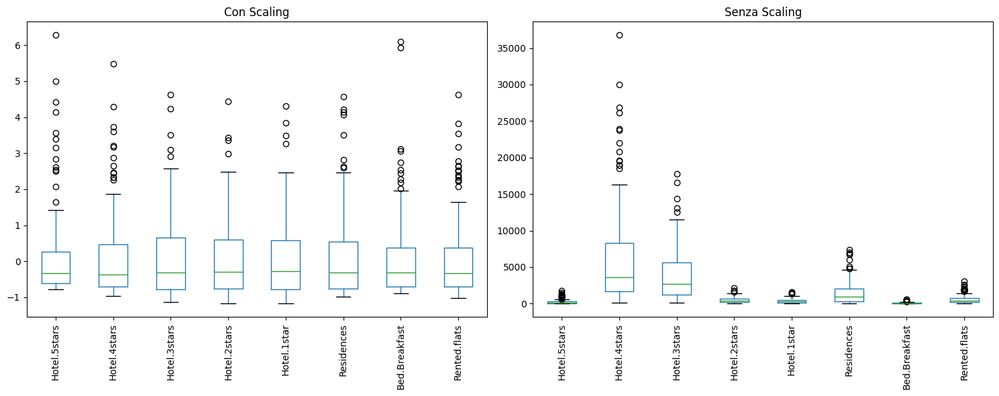

In [10]:
# Crea una figura con 2 subplot affiancati
plt.figure(figsize=(15, 6))

# Primo boxplot (sinistra)
plt.subplot(1, 2, 1)
X.boxplot(rot=90, grid=False)
plt.title('Con Scaling')

# Secondo boxplot (destra)
plt.subplot(1, 2, 2)
# Sostituisci 'altro_dataset' con i tuoi dati
tourists_data.boxplot(rot=90, grid=False)
plt.title('Senza Scaling')

plt.tight_layout()  # Aggiusta automaticamente gli spazi
plt.show()

Boxplot of original data

## PCA on original data

In [11]:
pca_tourists = PCA()
tourists_scores = pca_tourists.fit_transform(tourists_data)
print('Tourists PCA explained variance ratio:\n', pca_tourists.explained_variance_ratio_)

Tourists PCA explained variance ratio:
 [9.80435551e-01 1.54348931e-02 3.01060627e-03 5.99554411e-04
 3.13904868e-04 9.33619028e-05 8.57873032e-05 2.63408204e-05]


Guarda se applico la pca a i dati originali come si distribuisce la varianza. è giusto nei principal components che la variance si distribuisca in modo crescente, ma in questo caso è data da unità di misura sballate

<Axes: >

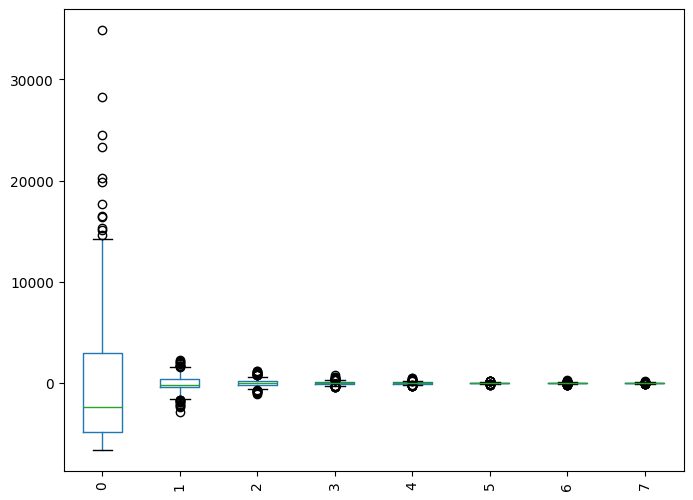

In [12]:
tourists_scores = pd.DataFrame(tourists_scores)
tourists_scores.boxplot(rot=90, grid=False)

<Axes: >

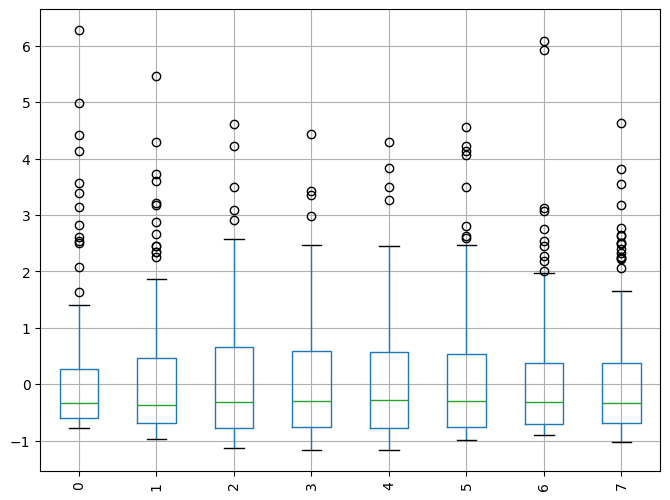

In [13]:
scaler = StandardScaler()
tourists_data_scaled = scaler.fit_transform(tourists_data)
tourists_data_scaled = pd.DataFrame(tourists_data_scaled)
tourists_data_scaled.boxplot(rot = 90)

In [14]:
variance_explained = [pca_tourists.explained_variance_ / np.sum(pca_tourists.explained_variance_)*100]
variance_explained

[array([9.80435551e+01, 1.54348931e+00, 3.01060627e-01, 5.99554411e-02,
        3.13904868e-02, 9.33619028e-03, 8.57873032e-03, 2.63408204e-03])]

Non ha senso che il primo pc abbia 98% di variance da solo

In [15]:
pca = PCA()
X = pca.fit_transform(X)
pca.explained_variance_
variance_explained_scaled = [pca.explained_variance_ / np.sum(pca.explained_variance_)*100]
variance_explained_scaled

[array([89.6114837 ,  5.05078934,  2.7060312 ,  1.15780767,  0.6211281 ,
         0.45792556,  0.25689113,  0.13794332])]

In [20]:
pc_sd = np.sqrt(pca_tourists.explained_variance_)
print("Standard deviation of the components:")
print(pc_sd)

# Cumulative proportion of explained variance:
cumulative_explained_variance = np.cumsum(pca_tourists.explained_variance_ratio_)
print("Cumulative proportion of explained variance:")
print(cumulative_explained_variance)

Standard deviation of the components:
[6586.75180678  826.44429714  364.99654582  162.88311834  117.85847007
   64.27567128   61.61313141   34.14101456]
Cumulative proportion of explained variance:
[0.98043555 0.99587044 0.99888105 0.99948061 0.99979451 0.99988787
 0.99997366 1.        ]


Loadings

In [17]:
load_tour = pca_tourists.components_.T
load_tour

array([[ 0.036988  , -0.06875905,  0.03032049, -0.01538322, -0.09843182,
         0.1792697 ,  0.87877522, -0.42270057],
       [ 0.86250762, -0.48404327, -0.12963676,  0.00331453,  0.03025384,
         0.0104852 , -0.06070552,  0.01598857],
       [ 0.45374825,  0.83652698, -0.17078613, -0.151654  , -0.20265148,
        -0.01267825,  0.03057386,  0.00227378],
       [ 0.0525281 ,  0.14868959, -0.1461287 ,  0.15710032,  0.79181454,
        -0.5148528 ,  0.15814922, -0.10974173],
       [ 0.03921975,  0.14477781, -0.04127983,  0.2494434 ,  0.45701223,
         0.81423507, -0.16034057, -0.12659831],
       [ 0.19594019,  0.10300007,  0.95393089, -0.12569757,  0.15539773,
        -0.02558117, -0.00302853,  0.0200594 ],
       [ 0.01153809,  0.01380745, -0.02285702,  0.08655516,  0.10166414,
         0.13233387,  0.41520552,  0.88961706],
       [ 0.07747214,  0.08560395,  0.13979581,  0.93089164, -0.27930944,
        -0.14619468, -0.00302077, -0.03423665]])

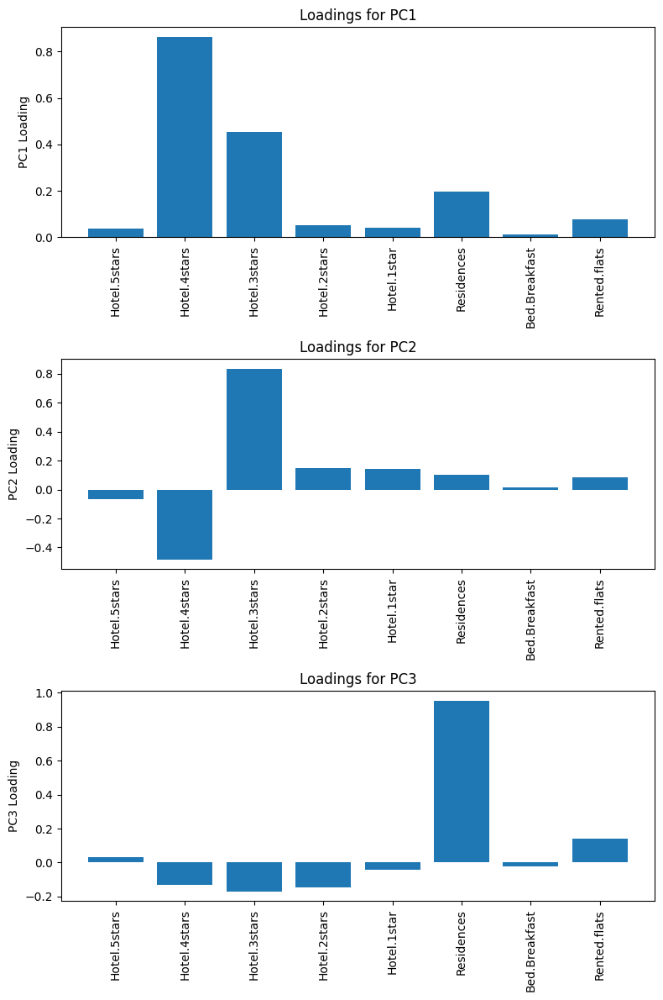

In [21]:
##TODO Barplots of loadings for the first three PCs, i loadings sono i pesi che ogni feature ha nella costruzione del PCi
fig, axes = plt.subplots(3, 1, figsize=(8, 12))

for i, ax in enumerate(axes):
    ax.bar(tourists_data.columns, load_tour[:, i])
    ax.set_xticklabels(tourists_data.columns, rotation=90)
    ax.set_ylabel(f"PC{i+1} Loading")
    ax.set_title(f"Loadings for PC{i+1}")

plt.tight_layout()
plt.show()


Interpretation of the loadings:

First PC: weighted average of the number of nights in 3,4 stars hotel and residences

Second PC: contrast between the number of nights in 3 and 4 stars hotel

Third PC: residences

The loadings reflect the previous observation: the first 3 PCs are
driven by the variables displaying the highest variability

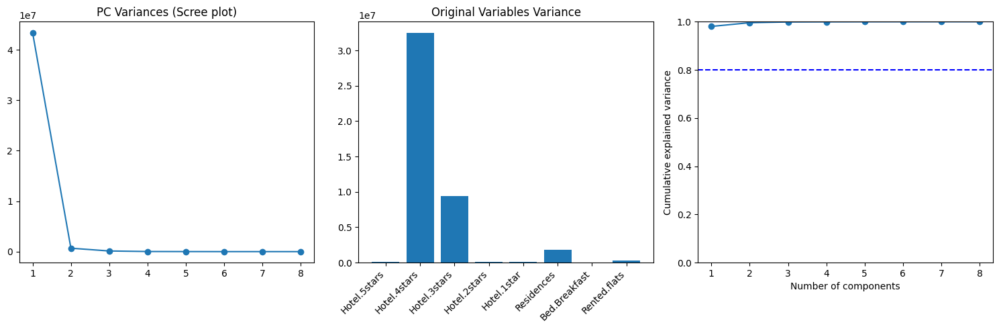

In [22]:
fig, axs = plt.subplots(1, 3, figsize=(15,5))
axs[0].plot(np.arange(1, p_tour+1), pca_tourists.explained_variance_, marker='o')
axs[0].set_title('PC Variances (Scree plot)')
orig_variances = tourists_data.var(ddof=1)
axs[1].bar(tourists_data.columns, orig_variances)
axs[1].tick_params(axis='x', rotation=45)
plt.setp(axs[1].get_xticklabels(), rotation=45, ha='right')
axs[1].set_title('Original Variables Variance')
cum_explained = np.cumsum(pca_tourists.explained_variance_ratio_)
axs[2].plot(np.arange(1, p_tour+1), cum_explained, marker='o')
axs[2].axhline(1, color='blue')
axs[2].axhline(0.8, color='blue', linestyle='--')
axs[2].set_xlabel('Number of components')
axs[2].set_ylabel('Cumulative explained variance')
axs[2].set_ylim(0,1)
plt.tight_layout()
plt.show()

The first PC explains more than 98% of the total variability.

This is due to the masking effect of those 3 variables over the others

## PCA on standardized data

Standardize data

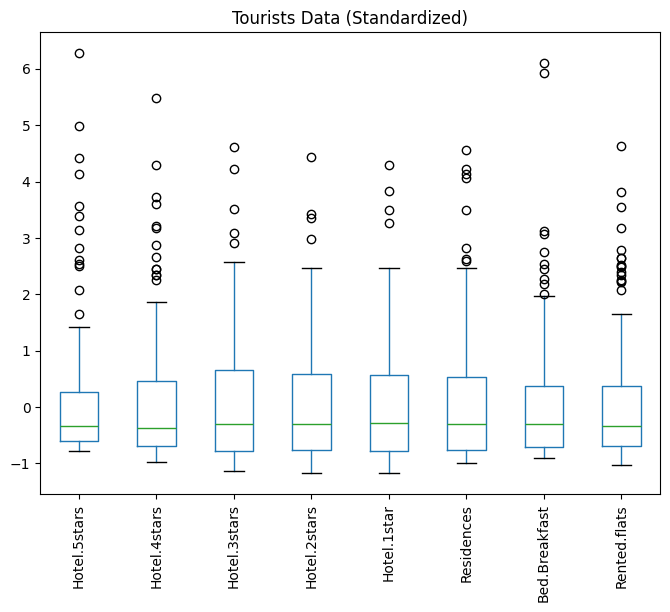

In [23]:
scaler = StandardScaler()
tourists_std = scaler.fit_transform(tourists_data)
tourists_std_df = pd.DataFrame(tourists_std, columns=tourists_data.columns)
plt.figure()
tourists_std_df.boxplot(rot=90, grid=False)
plt.title('Tourists Data (Standardized)')
plt.show()

PCA on standardized data

In [24]:
# TODO
pca_tourists_std = PCA()
tourists_scores_std = pca_tourists_std.fit_transform(tourists_std_df)
print('Standardized Tourists PCA explained variance ratio:\n', pca_tourists_std.explained_variance_ratio_)
load_tour_std = pca_tourists_std.components_.T

Standardized Tourists PCA explained variance ratio:
 [0.89611484 0.05050789 0.02706031 0.01157808 0.00621128 0.00457926
 0.00256891 0.00137943]


In [25]:
# Estrai tutte le caratteristiche
components = pca_tourists_std.components_ #pesi o loadings di ogni componente per ogni pc
loadings = pca_tourists_std.components_.T
explained_var = pca_tourists_std.explained_variance_
explained_var_ratio = pca_tourists_std.explained_variance_ratio_
cumulative_var = np.cumsum(explained_var_ratio)
components

array([[ 0.34094343,  0.36303235,  0.36824629,  0.3519069 ,  0.34676276,
         0.35803476,  0.33792625,  0.36040788],
       [ 0.59123382,  0.30520188, -0.0754591 , -0.42808893, -0.52252462,
         0.25373557, -0.17132443,  0.03967862],
       [ 0.19309851, -0.0638927 , -0.20740553, -0.07764867, -0.17281238,
        -0.30791029,  0.86887665, -0.17310351],
       [-0.26881534, -0.27124653, -0.15913374, -0.50223959,  0.07582116,
         0.23674428,  0.1935478 ,  0.69089654],
       [-0.14749888, -0.16271971,  0.07951614, -0.22697655,  0.15164369,
         0.70801281,  0.18520528, -0.57909089],
       [ 0.40169545, -0.00646527, -0.10460492, -0.43716996,  0.72368312,
        -0.27644559, -0.13472994, -0.13508378],
       [-0.32438137,  0.34510892,  0.69912569, -0.43661624, -0.07946065,
        -0.27417451,  0.09804763, -0.07188258],
       [-0.36920591,  0.74282077, -0.53321503, -0.03684846,  0.13447521,
         0.06080133,  0.04449633, -0.04967821]])

In [26]:
pc_sd = np.sqrt(pca_tourists_std.explained_variance_)
print("Standard deviation of the components:")
print(pc_sd)

cumulative_explained_variance = np.cumsum(pca_tourists_std.explained_variance_ratio_)
print("Cumulative proportion of explained variance:")
print(cumulative_explained_variance)

Standard deviation of the components:
[2.68307923 0.63698806 0.46624916 0.30497896 0.22337895 0.19180022
 0.14365681 0.10526936]
Cumulative proportion of explained variance:
[0.89611484 0.94662273 0.97368304 0.98526112 0.9914724  0.99605166
 0.99862057 1.        ]


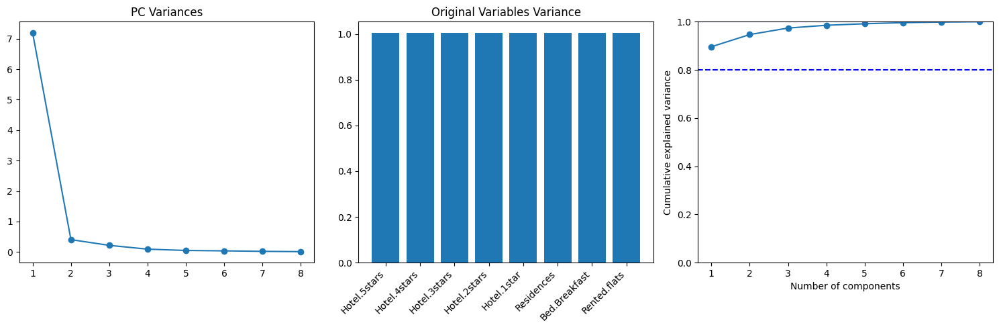

In [27]:
fig, axs = plt.subplots(1, 3, figsize=(15,5))
axs[0].plot(np.arange(1, p_tour+1), pca_tourists_std.explained_variance_, marker='o')
axs[0].set_title('PC Variances')
orig_variances = tourists_std_df.var(ddof=1)
axs[1].bar(tourists_data.columns, orig_variances)
axs[1].tick_params(axis='x', rotation=45)
plt.setp(axs[1].get_xticklabels(), rotation=45, ha='right')
axs[1].set_title('Original Variables Variance')
cum_explained = np.cumsum(pca_tourists_std.explained_variance_ratio_)
axs[2].plot(np.arange(1, p_tour+1), cum_explained, marker='o')
axs[2].axhline(1, color='blue')
axs[2].axhline(0.8, color='blue', linestyle='--')
axs[2].set_xlabel('Number of components')
axs[2].set_ylabel('Cumulative explained variance')
axs[2].set_ylim(0,1)
plt.tight_layout()
plt.show()

If we wanted to perform dimensionality reduction, we could keep 1 or 2 PCs

Loadings

In [28]:
load_tour_std = pca_tourists_std.components_.T
load_tour_std

array([[ 0.34094343,  0.59123382,  0.19309851, -0.26881534, -0.14749888,
         0.40169545, -0.32438137, -0.36920591],
       [ 0.36303235,  0.30520188, -0.0638927 , -0.27124653, -0.16271971,
        -0.00646527,  0.34510892,  0.74282077],
       [ 0.36824629, -0.0754591 , -0.20740553, -0.15913374,  0.07951614,
        -0.10460492,  0.69912569, -0.53321503],
       [ 0.3519069 , -0.42808893, -0.07764867, -0.50223959, -0.22697655,
        -0.43716996, -0.43661624, -0.03684846],
       [ 0.34676276, -0.52252462, -0.17281238,  0.07582116,  0.15164369,
         0.72368312, -0.07946065,  0.13447521],
       [ 0.35803476,  0.25373557, -0.30791029,  0.23674428,  0.70801281,
        -0.27644559, -0.27417451,  0.06080133],
       [ 0.33792625, -0.17132443,  0.86887665,  0.1935478 ,  0.18520528,
        -0.13472994,  0.09804763,  0.04449633],
       [ 0.36040788,  0.03967862, -0.17310351,  0.69089654, -0.57909089,
        -0.13508378, -0.07188258, -0.04967821]])

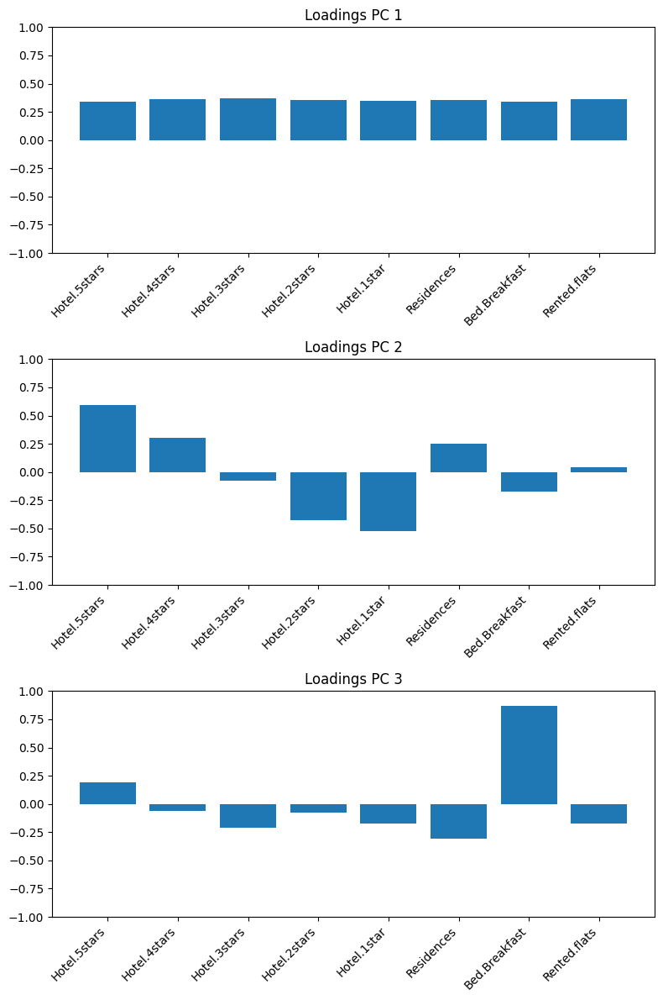

In [29]:
# Barplots of loadings for the first three PCs
fig, axs = plt.subplots(3, 1, figsize=(8,12))
for i in range(3):
    axs[i].bar(tourists_std_df.columns, load_tour_std[:, i])
    axs[i].set_ylim([-1, 1])
    axs[i].set_title(f'Loadings PC {i+1}')
    axs[i].tick_params(axis='x', rotation=45)
    plt.setp(axs[i].get_xticklabels(), rotation=45, ha='right')
plt.tight_layout()
plt.show()

Interpretation of the loadings:

TODO

## Interpretations with categorical variables

Project the data applying PCA

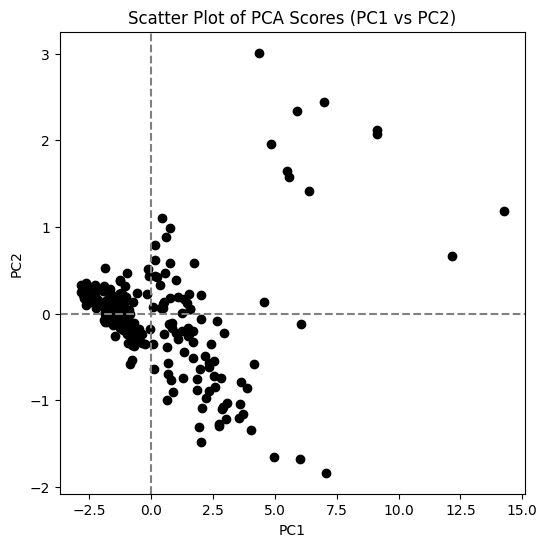

In [30]:
scores_tourists = pca_tourists_std.transform(tourists_std_df)
n = scores_tourists.shape[0]

# Scatter plot of the scores for the first two PCs
plt.figure(figsize=(6,6))
plt.scatter(scores_tourists[:, 0], scores_tourists[:, 1], color='black', marker='o')
plt.axhline(0, linestyle='--', color='grey')
plt.axvline(0, linestyle='--', color='grey')
plt.xlabel("PC1")
plt.ylabel("PC2")
plt.title("Scatter Plot of PCA Scores (PC1 vs PC2)")
plt.show()

Analysis by month

In [31]:
months = ["Jan", "Feb", "Mar", "Apr", "May", "Jun", "Jul", "Aug", "Sept", "Oct", "Nov", "Dec"]

# Convert the first column to an ordered categorical variable.
tourists_label['Month'] = pd.Categorical(tourists_label.iloc[:, 0],
                                           categories=months,
                                           ordered=True)

# Define a cyclic palette (list of hex colors) for the 12 months.
palette = ["#2D1857", "#4D2C8C", "#6C47C7", "#8B63FF", "#7A8CDD", "#68B5C5",
           "#5ECABA", "#46AF89", "#108963", "#047138", "#025A26", "#013814"]

# Map each month to a color.
month_to_color = {m: c for m, c in zip(months, palette)}
col_lab1 = tourists_label['Month'].map(month_to_color)


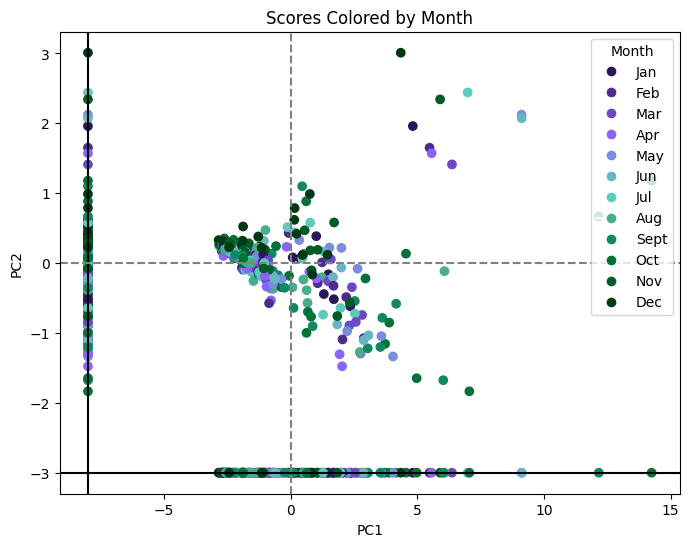

In [ ]:
# Scatter plot of scores colored by month.
plt.figure(figsize=(8,6))
plt.scatter(scores_tourists[:, 0], scores_tourists[:, 1], c=col_lab1, marker='o')
plt.axhline(-3, color='black')
plt.axvline(-8, color='black')
# Additional points along the margins
plt.scatter(scores_tourists[:, 0], np.full(n, -3), c=col_lab1, marker='o')
plt.scatter(np.full(n, -8), scores_tourists[:, 1], c=col_lab1, marker='o')
plt.axhline(0, linestyle='--', color='grey')
plt.axvline(0, linestyle='--', color='grey')
plt.xlabel("PC1")
plt.ylabel("PC2")

plt.title("Scores Colored by Month")

legend_handles = [plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=month_to_color[m],
                               markersize=8, label=m) for m in months]
plt.legend(handles=legend_handles, title="Month", loc='upper right')
plt.show()

Analysis for month of Expo (May to Oct)

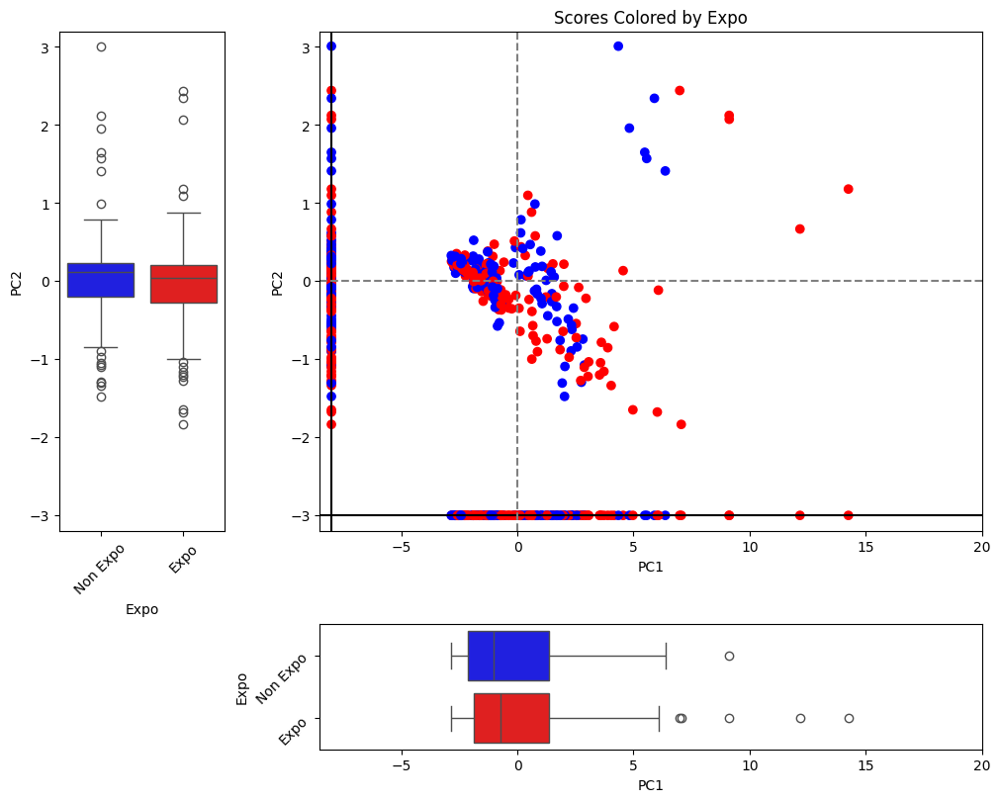

In [32]:
expo_months = ["May", "Jun", "Jul", "Aug", "Sept", "Oct"]

# Create a new column 'Expo' that is 'Expo' if the month is in expo_months, otherwise 'Non Expo'
tourists_label['Expo'] = tourists_label['Month'].apply(lambda m: 'Expo' if m in expo_months else 'Non Expo')

# Define colors for Expo groups.
col_expo = tourists_label['Expo'].map({'Expo': 'red', 'Non Expo': 'blue'})

# Create a layout with a scatter plot and two boxplots.
import matplotlib.gridspec as gridspec
fig = plt.figure(constrained_layout=True, figsize=(10,8))
gs = fig.add_gridspec(2, 2, width_ratios=[1, 4], height_ratios=[4, 1])

ax_scatter = fig.add_subplot(gs[0, 1])
ax_box_y = fig.add_subplot(gs[0, 0], sharey=ax_scatter)
ax_box_x = fig.add_subplot(gs[1, 1], sharex=ax_scatter)

# Scatter plot with expo colors.
ax_scatter.scatter(scores_tourists[:, 0], scores_tourists[:, 1], c=col_expo, marker='o')
ax_scatter.set_xlim(-8.5, 20)
ax_scatter.set_ylim(-3.2, 3.2)
ax_scatter.axhline(-3, color='black')
ax_scatter.axvline(-8, color='black')
ax_scatter.scatter(scores_tourists[:, 0], np.full(n, -3), c=col_expo, marker='o')
ax_scatter.scatter(np.full(n, -8), scores_tourists[:, 1], c=col_expo, marker='o')
ax_scatter.axhline(0, linestyle='--', color='grey')
ax_scatter.axvline(0, linestyle='--', color='grey')
ax_scatter.set_xlabel("PC1")
ax_scatter.set_ylabel("PC2")
ax_scatter.set_title("Scores Colored by Expo")

# Prepare a DataFrame for boxplots.
scores_df = pd.DataFrame(scores_tourists[:,:2], columns=["PC1", "PC2"])
scores_df['Expo'] = tourists_label['Expo']

# Boxplot for PC2 grouped by Expo (vertical boxplot)
sns.boxplot(x='Expo', y='PC2', data=scores_df, ax=ax_box_y,
            palette={'Expo': 'red', 'Non Expo': 'blue'})
ax_box_y.set_ylim(-3.2, 3.2)
ax_box_y.tick_params(axis='x', rotation=45)

# Boxplot for PC1 grouped by Expo (horizontal boxplot)
sns.boxplot(x='PC1', y='Expo', data=scores_df, ax=ax_box_x,
            palette={'Expo': 'red', 'Non Expo': 'blue'}, orient='h')
ax_box_x.set_xlim(-8.5, 20)
ax_box_x.tick_params(axis='y', rotation=45)

plt.show()


Scores Colored by Region of Origin

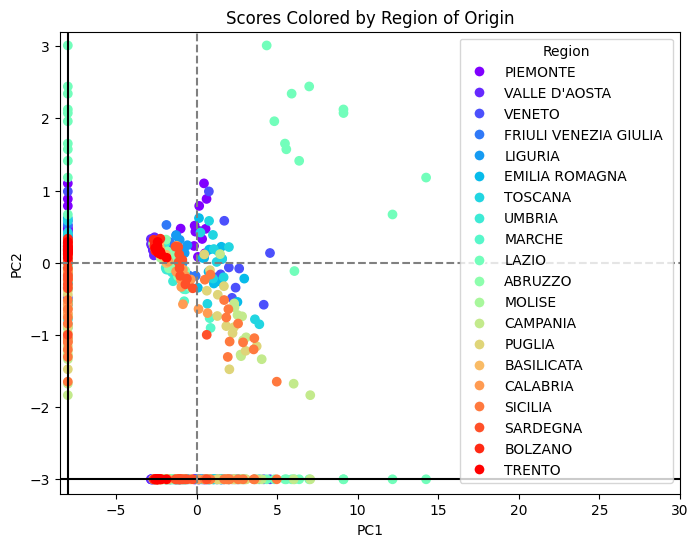

In [33]:
regions = tourists_label['Region.of.origin'].unique()
# Create a color mapping using a rainbow colormap.
region_colors = {region: color for region, color in zip(regions, plt.cm.rainbow(np.linspace(0, 1, len(regions))))}
col_lab2 = tourists_label.iloc[:, 1].map(region_colors)

plt.figure(figsize=(8,6))
plt.scatter(scores_tourists[:, 0], scores_tourists[:, 1], c=col_lab2, marker='o')
plt.xlim(-8.5, 30)
plt.ylim(-3.2, 3.2)
plt.axhline(-3, color='black')
plt.axvline(-8, color='black')
plt.scatter(scores_tourists[:, 0], np.full(n, -3), c=col_lab2, marker='o')
plt.scatter(np.full(n, -8), scores_tourists[:, 1], c=col_lab2, marker='o')
plt.axhline(0, linestyle='--', color='grey')
plt.axvline(0, linestyle='--', color='grey')
plt.xlabel("PC1")
plt.ylabel("PC2")
plt.title("Scores Colored by Region of Origin")
# Create legend for regions.
legend_handles_regions = [plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=region_colors[r],
                                     markersize=8, label=r) for r in regions]
plt.legend(handles=legend_handles_regions, title="Region", loc='upper right')
plt.show()

## PCA on the Food Dataset

## Load and visualize dataset

In [35]:
food = pd.read_csv('../DatasetsLabs/Food.txt', sep=' ')
print(food.head())
print('Food dataset shape:', food.shape)

                Meat  Pigs  Eggs  Milk  Fish  Cereals  Pulse  Fruit
Albania         10.1   1.4   0.5   8.9   0.2     42.3    5.5    1.7
Austria          8.9  14.0   4.3  19.9   2.1     28.0    1.3    4.3
Belg.Lux.       13.5   9.3   4.1  17.5   4.5     26.6    2.1    4.0
Bulgaria         7.8   6.0   1.6   8.3   1.2     56.7    3.7    4.2
Czechoslovakia   9.7  11.4   2.8  12.5   2.0     34.3    1.1    4.0
Food dataset shape: (25, 8)


In [36]:
food.sum(axis=1)

Albania           70.6
Austria           82.8
Belg.Lux.         81.6
Bulgaria          89.5
Czechoslovakia    77.8
Denmark           85.0
East.Germany      69.2
Finland           85.3
France            93.4
Greece            95.5
Hungary           80.3
Ireland           85.1
Italy             81.9
Netherlands       80.5
Norway            77.2
Poland            86.8
Portugal          72.7
Romania           83.8
Spain             71.5
Sweden            76.3
Switzerland       85.3
United.Kingdom    83.7
USSR              85.5
West.Germany      74.1
Yugoslavia        85.5
dtype: float64

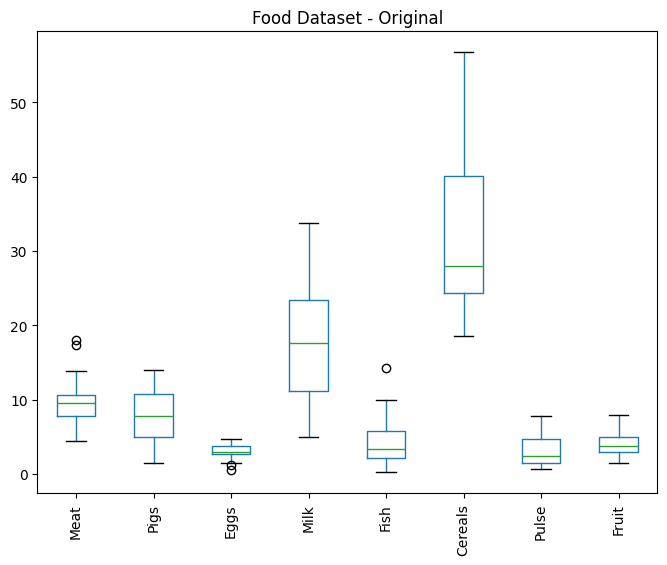

In [38]:
n_food, p_food = food.shape

food.boxplot(rot=90, grid=False)
plt.title('Food Dataset - Original')
plt.show()

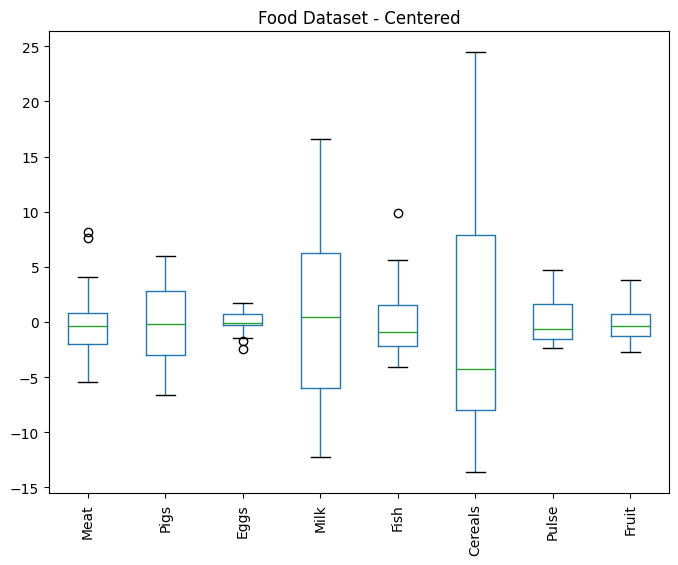

In [39]:
food_centered = food - food.mean()
plt.figure()
food_centered.boxplot(rot=90, grid=False)
plt.title('Food Dataset - Centered')
plt.show()

## PCA on standardized data

In [40]:
# Standardize the food data
scaler_food = StandardScaler()
food_std = scaler_food.fit_transform(food)
food_std_df = pd.DataFrame(food_std, columns=food.columns)
print(food_std_df.head())

       Meat      Pigs      Eggs      Milk      Fish   Cereals     Pulse  \
0  0.082941 -1.867718 -2.289993 -1.179538 -1.225033  0.934804  1.247968   
1 -0.282974  1.697926  1.258936  0.399688 -0.655111 -0.395051 -0.910790   
2  1.119699  0.367884  1.072150  0.055129  0.064791 -0.525246 -0.499598   
3 -0.618396 -0.565975 -1.262672 -1.265678 -0.925074  2.273959  0.322786   
4 -0.039031  0.962158 -0.141957 -0.662700 -0.685107  0.190830 -1.013588   

      Fruit  
0 -1.378251  
1  0.092789  
2 -0.076947  
3  0.036210  
4 -0.076947  


In [41]:
pca_food = PCA()
food_scores = pca_food.fit_transform(food_std_df)
print('Food PCA explained variance ratio:\n', pca_food.explained_variance_ratio_)

Food PCA explained variance ratio:
 [0.46323022 0.18218656 0.14032046 0.10846036 0.04107323 0.03496567
 0.01585753 0.01390598]


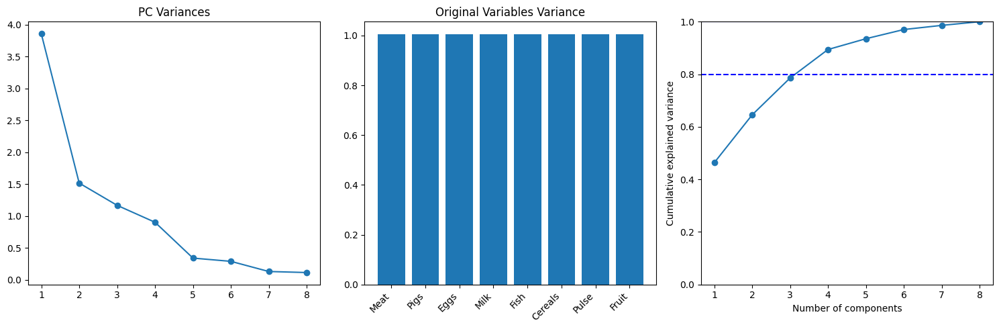

In [42]:
fig, axs = plt.subplots(1, 3, figsize=(15,5))
axs[0].plot(np.arange(1, p_food+1), pca_food.explained_variance_, marker='o')
axs[0].set_title('PC Variances')
orig_variances = food_std.var(ddof=1)
axs[1].bar(food_std_df.columns, orig_variances)
axs[1].tick_params(axis='x', rotation=45)
plt.setp(axs[1].get_xticklabels(), rotation=45, ha='right')
axs[1].set_title('Original Variables Variance')
cum_explained = np.cumsum(pca_food.explained_variance_ratio_)
axs[2].plot(np.arange(1, p_food+1), cum_explained, marker='o')
axs[2].axhline(1, color='blue')
axs[2].axhline(0.8, color='blue', linestyle='--')
axs[2].set_xlabel('Number of components')
axs[2].set_ylabel('Cumulative explained variance')
axs[2].set_ylim(0,1)
plt.tight_layout()
plt.show()

In [43]:
scores_food_df = pd.DataFrame(food_scores)

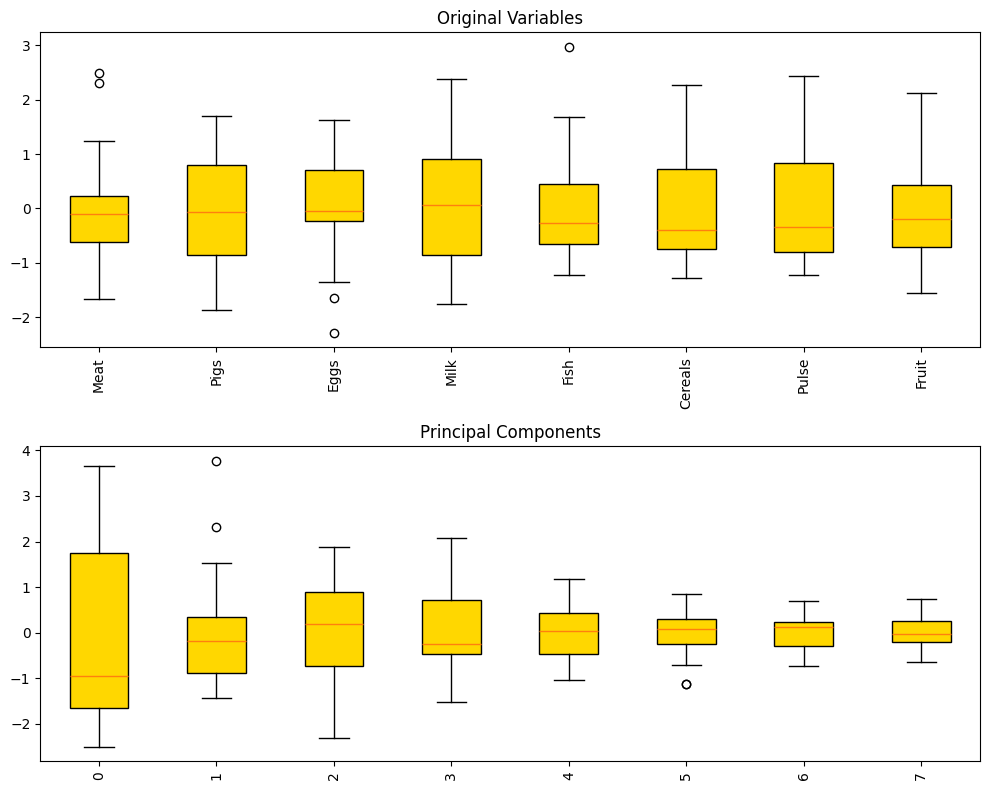

In [44]:
fig, axs = plt.subplots(2, 1, figsize=(10, 8))

# Boxplot for the original variables
bp1 = axs[0].boxplot(food_std_df.values, patch_artist=True)
# Set x-tick labels using the DataFrame's column names and rotate them 90° (or 45° if desired)
axs[0].set_xticklabels(food_std_df.columns, rotation=90)  # change rotation=45 if you prefer
axs[0].set_title('Original Variables')
# Color each box gold
for box in bp1['boxes']:
    box.set_facecolor('gold')

# Boxplot for the PCA scores (principal components)
bp2 = axs[1].boxplot(scores_food_df.values, patch_artist=True)
axs[1].set_xticklabels(scores_food_df.columns, rotation=90)  # or rotation=45 as needed
axs[1].set_title('Principal Components')
for box in bp2['boxes']:
    box.set_facecolor('gold')

plt.tight_layout()
plt.show()

Loadings

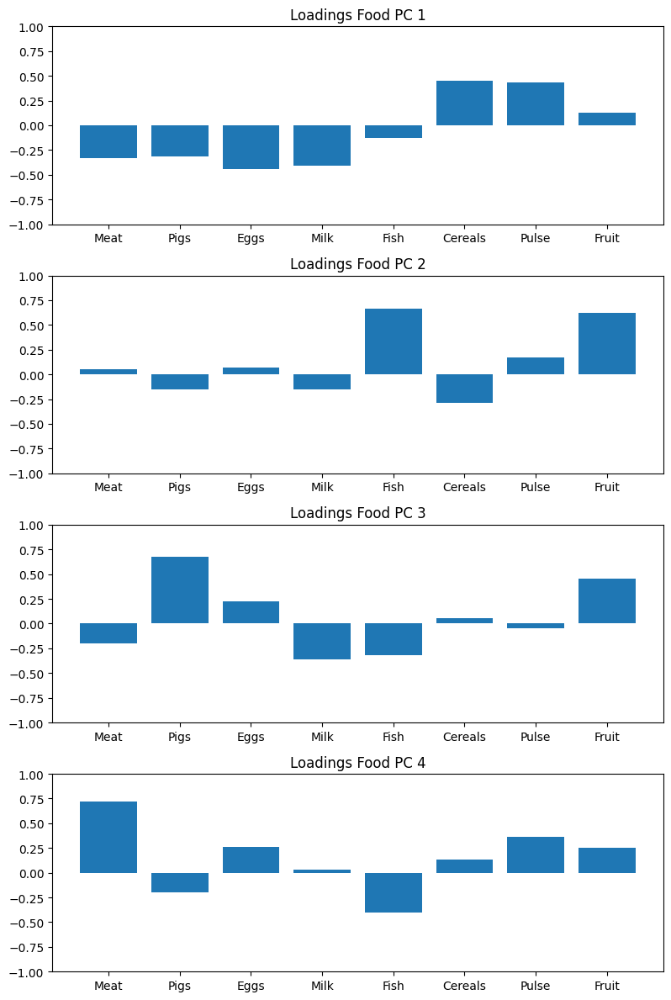

In [45]:
load_food = pca_food.components_.T
fig, axs = plt.subplots(4, 1, figsize=(8,12))
for i in range(4):
    axs[i].bar(food_std_df.columns, load_food[:, i])
    axs[i].set_ylim([-1, 1])
    axs[i].set_title(f'Loadings Food PC {i+1}')
plt.tight_layout()
plt.show()

Let's plot only the most significant loadings

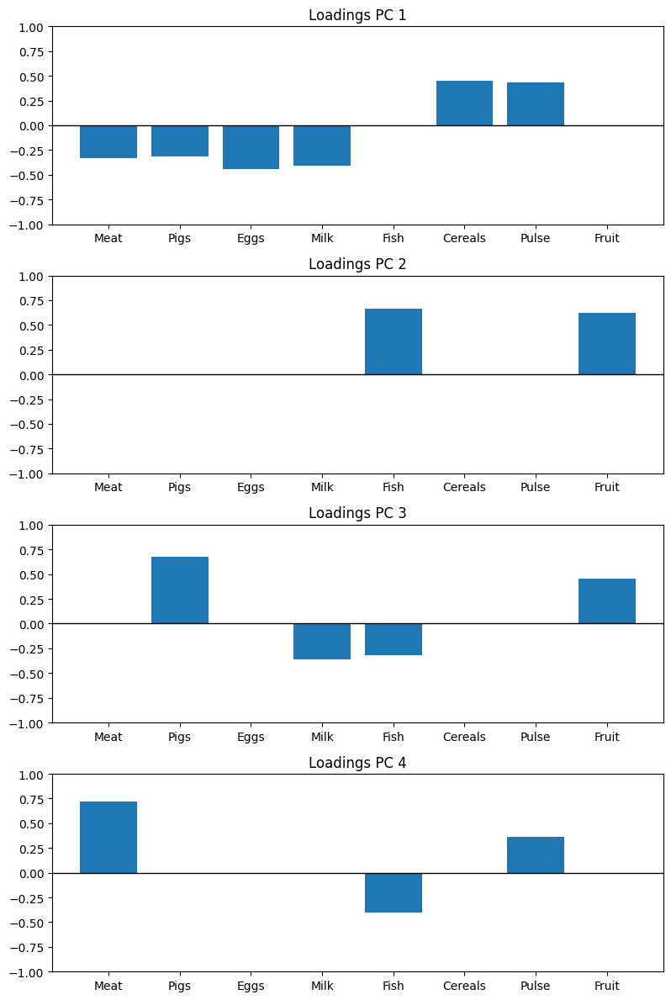

In [46]:
fig, axs = plt.subplots(4, 1, figsize=(8, 12))
for i in range(4):
    # Replace values with 0 if |value| < 0.3
    significant_loadings = np.where(np.abs(load_food[:, i]) < 0.3, 0, load_food[:, i])
    axs[i].bar(food_std_df.columns, significant_loadings)
    axs[i].set_ylim([-1, 1])
    axs[i].axhline(0, color='black', linewidth=1)
    axs[i].set_title(f'Loadings PC {i+1}')
plt.tight_layout()
plt.show()


Let's have a look at how well we can reconstruct the original data with an increasing number of components

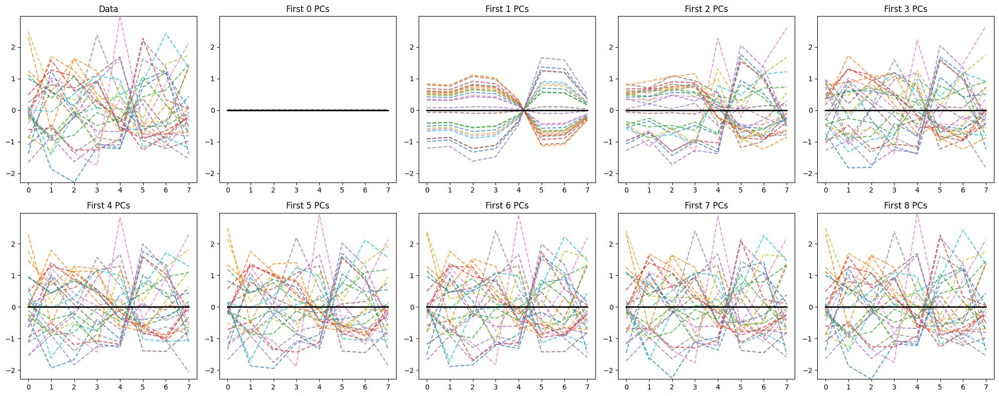

In [47]:
import numpy as np
import matplotlib.pyplot as plt

n_obs, n_vars = food_std_df.shape
x = np.arange(n_vars)  # x-axis: one value for each variable (or use food_sd.columns if preferred)

# Create a figure with 2 rows and 5 columns (10 subplots total)
fig, axs = plt.subplots(2, 5, figsize=(20, 8))
axs = axs.flatten()  # Flatten for easy iteration

# --- Plot the Original Data ---
# Each observation (each row of food_sd) is plotted as a line.
for i in range(n_obs):
    axs[0].plot(x, food_std_df.iloc[i, :], '--', alpha=0.7)
axs[0].set_title("Data")
axs[0].set_ylim(food_std_df.values.min(), food_std_df.values.max())

# --- Plot the "First 0 PCs" Approximation ---
# Compute the mean vector (i.e. the column means) of food_sd.
meanF = food_std_df.mean(axis=0).values

# Create an initial projection matrix that is just the mean for every observation.
projection = np.tile(meanF, (n_obs, 1))
for i in range(n_obs):
    axs[1].plot(x, projection[i, :], '--', color='black', alpha=0.7)
# Overlay the overall mean as a thick black line.
axs[1].plot(x, meanF, 'k-', linewidth=2)
axs[1].set_title("First 0 PCs")
axs[1].set_ylim(food_std_df.values.min(), food_std_df.values.max())

# --- Iteratively Add the Contributions of the First k PCs ---
# For each component from 1 to 8 (or fewer if there are not 8 PCs),
# update the projection by adding the outer product of the PC scores and its loading.
num_components = min(8, scores_food_df.shape[1])
for comp in range(num_components):
    # Update: for the comp-th PC, add (score for that PC) * (loading vector for that PC)
    # This yields an (n_obs x n_vars) matrix.
    projection = projection + np.outer(scores_food_df.iloc[:, comp], load_food[:, comp])

    # Plot the updated projection in subplot comp+2 (since index 0 is original data, index 1 is 0 PCs).
    ax = axs[comp + 2]
    # Plot one line per observation (i.e. each row of projection)
    for i in range(n_obs):
        ax.plot(x, projection[i, :], '--', alpha=0.7)
    # Optionally overlay the mean for reference.
    ax.plot(x, meanF, 'k-', linewidth=2)
    ax.set_title(f"First {comp+1} PCs")
    ax.set_ylim(food_std_df.values.min(), food_std_df.values.max())

plt.tight_layout()
plt.show()


In the first plot each line corresponds to an observation of the original dataset

In the second plot there are no principal components: each observation is represented by the mean, which is zero for all since they were standardized

From the third plot on we progressively add more principal components

**<font size="5">Applied Statistics</font>**

<font size="3">MSc in High Performance Computing Engineering, Computer Science and Engineering, Physics Engineering - A.Y. 2024-2025</font>

Prof. Mario Beraha - Dott. Vittorio Torri

---

<font size="4">**Lab 3 - Hierarchical clustering**</font>

# LAB 3

## Libraries

In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.cluster.hierarchy import dendrogram, linkage, cut_tree, cophenet, fcluster
from scipy.spatial.distance import pdist, squareform, cdist
from mpl_toolkits.mplot3d import Axes3D  # for 3D plots
import statsmodels.api as sm
import warnings
warnings.filterwarnings("ignore")

## Hierarchical Clustering

## Iris dataset

### Load and plot

In [3]:
from sklearn.datasets import load_iris
iris_data = load_iris()
print(iris_data.DESCR)

.. _iris_dataset:

Iris plants dataset
--------------------

**Data Set Characteristics:**

:Number of Instances: 150 (50 in each of three classes)
:Number of Attributes: 4 numeric, predictive attributes and the class
:Attribute Information:
    - sepal length in cm
    - sepal width in cm
    - petal length in cm
    - petal width in cm
    - class:
            - Iris-Setosa
            - Iris-Versicolour
            - Iris-Virginica

:Summary Statistics:

============== ==== ==== ======= ===== ====================
                Min  Max   Mean    SD   Class Correlation
============== ==== ==== ======= ===== ====================
sepal length:   4.3  7.9   5.84   0.83    0.7826
sepal width:    2.0  4.4   3.05   0.43   -0.4194
petal length:   1.0  6.9   3.76   1.76    0.9490  (high!)
petal width:    0.1  2.5   1.20   0.76    0.9565  (high!)
============== ==== ==== ======= ===== ====================

:Missing Attribute Values: None
:Class Distribution: 33.3% for each of 3 classes.
:Cr

In [4]:
iris4 = pd.DataFrame(iris_data.data, columns=iris_data.feature_names)
species_name = iris_data.target
iris = iris4.copy()
iris['target'] = species_name
iris

,sepal length (cm),sepal width (cm),petal length (cm),petal width (cm),target
0,5.1,3.5,1.4,0.2,0
1,4.9,3.0,1.4,0.2,0
2,4.7,3.2,1.3,0.2,0
3,4.6,3.1,1.5,0.2,0
4,5.0,3.6,1.4,0.2,0
...,...,...,...,...,...
145,6.7,3.0,5.2,2.3,2
146,6.3,2.5,5.0,1.9,2
147,6.5,3.0,5.2,2.0,2
148,6.2,3.4,5.4,2.3,2


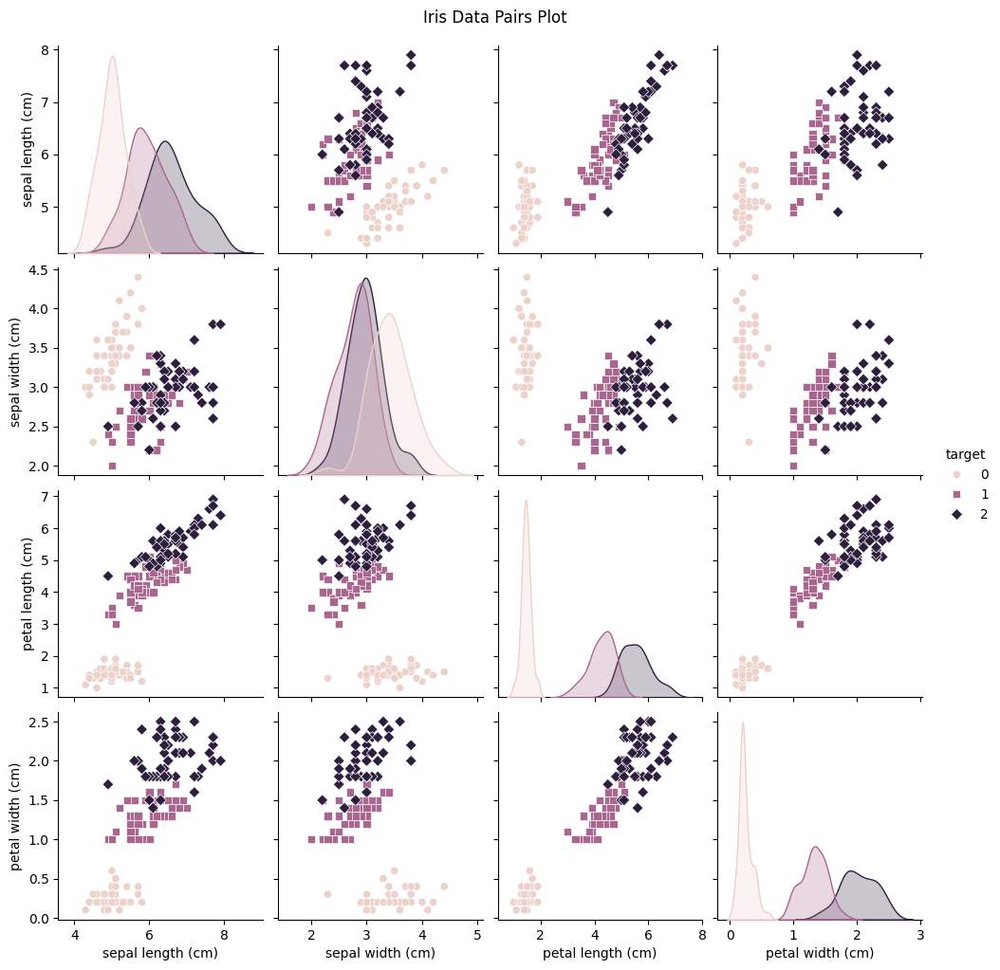

In [5]:
sns.pairplot(iris, hue="target", diag_kind="kde", markers=["o", "s", "D"])

plt.suptitle("Iris Data Pairs Plot", y=1.02)
plt.show()

### Dissimilarity matrix

Euclidean distance

$$
d_{\text{Euclidean}}(x_i, x_j) = \sqrt{\sum_{k=1}^{p} (x_{ik} - x_{jk})^2}
$$


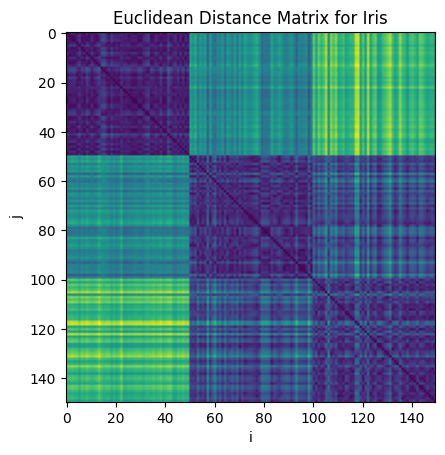

In [6]:
iris_e = pdist(iris4, metric='euclidean')
plt.imshow(squareform(iris_e), aspect='equal')
plt.title("Euclidean Distance Matrix for Iris")
plt.xlabel("i")
plt.ylabel("j")
plt.show()


Other metrics: Manhattan and Canberra

$$
d_{\text{Manhattan}}(x_i, x_j) = \sum_{k=1}^{p} |x_{ik} - x_{jk}|
$$

$$
d_{\text{Canberra}}(x_i, x_j) = \sum_{k=1}^{p} \frac{|x_{ik} - x_{jk}|}{|x_{ik}| + |x_{jk}|}
$$

Manhattan distance is less sensitive to high-dimensionality than Euclidean distance (L2 norm) and less sensitive to outliers.

The fraction in Canberra distance magnifies the impact of small differences when absolute values are small


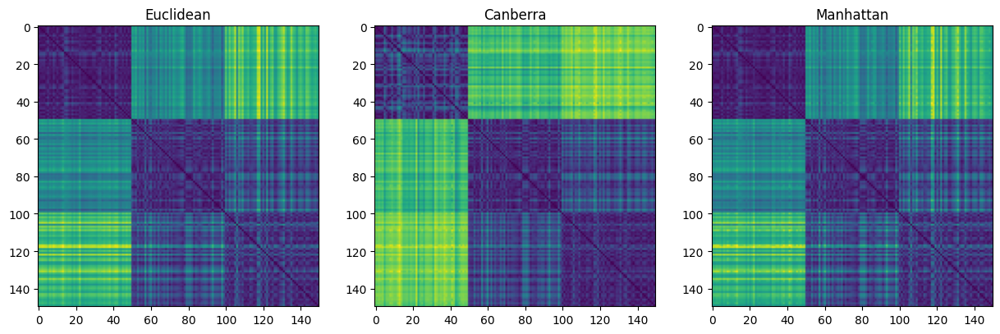

In [7]:
iris_m = pdist(iris4, metric='cityblock')
iris_c = pdist(iris4, metric='canberra')

fig, axs = plt.subplots(1, 3, figsize=(15,5))
axs[0].imshow(squareform(iris_e), aspect='equal')
axs[0].set_title("Euclidean")
axs[1].imshow(squareform(iris_c), aspect='equal')
axs[1].set_title("Canberra")
axs[2].imshow(squareform(iris_m), aspect='equal')
axs[2].set_title("Manhattan")
plt.show()

But the data should not be ordered according to labels. Let's shuffle them:

In [8]:
np.random.seed(42)
iris = iris.sample(frac=1)
iris4 = iris.drop('target', axis=1)

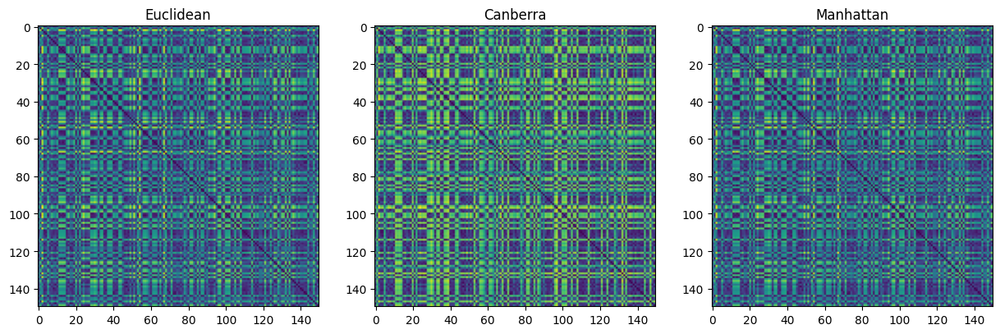

In [9]:
iris_e = pdist(iris4, metric='euclidean')
iris_m = pdist(iris4, metric='cityblock')
iris_c = pdist(iris4, metric='canberra')

fig, axs = plt.subplots(1, 3, figsize=(15,5))
axs[0].imshow(squareform(iris_e), aspect='equal')
axs[0].set_title("Euclidean")
axs[1].imshow(squareform(iris_c), aspect='equal')
axs[1].set_title("Canberra")
axs[2].imshow(squareform(iris_m), aspect='equal')
axs[2].set_title("Manhattan")
plt.show()

### Hierarchical clustering

Single linkage tends to form long, chain-like clusters. Works well for data where clusters are naturally spread out .

Complete linkage ensures clusters are tight and well-defined, finding more easily spherical clusters and naturally resisting outliers. Might over-fragment data when clusters have a natural spread.

Average linkage is less sensitive to outliers compared to single linkage but more flexible than complete linkage.

In [10]:
iris_es = linkage(iris_e, method='single')
iris_ea = linkage(iris_e, method='average')
iris_ec = linkage(iris_e, method='complete')

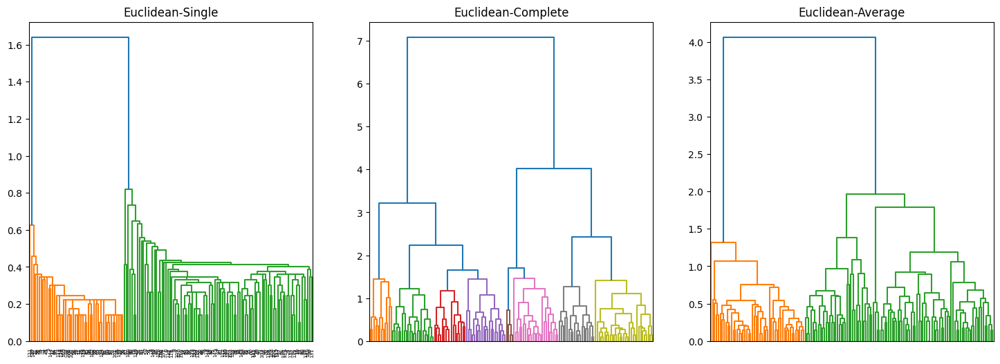

In [11]:
# Plot dendrograms:
fig, axs = plt.subplots(1, 3, figsize=(18,6))
dendrogram(iris_es, ax=axs[0], no_labels=False)
axs[0].set_title("Euclidean-Single")
dendrogram(iris_ec, ax=axs[1], no_labels=True, color_threshold=1.5)
axs[1].set_title("Euclidean-Complete")
dendrogram(iris_ea, ax=axs[2], no_labels=True)
axs[2].set_title("Euclidean-Average")
plt.show()

From the documentation of the scipy dendogram function:

   For brevity, let t  be the color_threshold. Colors all the descendent links below a cluster node the same color if is the first node below the cut threshold t.
   All links connecting nodes with distances greater than or equal to the threshold are colored with the default matplotlib color 'C0'.
   If t is less than or equal to zero, all nodes are colored 'C0'. If color_threshold is None or ‘default’, corresponding with MATLAB(TM) behavior, the threshold is set to 0.7*max(Z[:,2]).



Cut the dendrograms into 2 clusters:

In [12]:
cluster_ec = cut_tree(iris_ec, n_clusters=2).flatten()
cluster_es = cut_tree(iris_es, n_clusters=2).flatten()
cluster_ea = cut_tree(iris_ea, n_clusters=2).flatten()

In [13]:
print("Contingency table for Euclidean-Single:")
print(pd.crosstab(iris.target, cluster_es))
print("Contingency table for Euclidean-Complete:")
print(pd.crosstab(iris.target, cluster_ec))
print("Contingency table for Euclidean-Average:")
print(pd.crosstab(iris.target, cluster_ea))

Contingency table for Euclidean-Single:
col_0    0   1
target        
0        0  50
1       50   0
2       50   0
Contingency table for Euclidean-Complete:
col_0    0   1
target        
0        0  50
1       23  27
2       49   1
Contingency table for Euclidean-Average:
col_0    0   1
target        
0        0  50
1       50   0
2       50   0


In [14]:
cluster_ec = cut_tree(iris_ec, n_clusters=3).flatten()
cluster_es = cut_tree(iris_es, n_clusters=3).flatten()
cluster_ea = cut_tree(iris_ea, n_clusters=3).flatten()

print("Contingency table for Euclidean-Single:")
print(pd.crosstab(iris.target, cluster_es))
print("Contingency table for Euclidean-Complete:")
print(pd.crosstab(iris.target, cluster_ec))
print("Contingency table for Euclidean-Average:")
print(pd.crosstab(iris.target, cluster_ea))

Contingency table for Euclidean-Single:
col_0    0   1  2
target           
0        0  50  0
1       50   0  0
2       48   0  2
Contingency table for Euclidean-Complete:
col_0    0   1   2
target            
0        0  50   0
1       23   0  27
2       49   0   1
Contingency table for Euclidean-Average:
col_0    0   1   2
target            
0        0  50   0
1       50   0   0
2       14   0  36


Fix k=2 clusters

In [15]:
cluster_ec = cut_tree(iris_ec, n_clusters=2).flatten()
cluster_es = cut_tree(iris_es, n_clusters=2).flatten()
cluster_ea = cut_tree(iris_ea, n_clusters=2).flatten()

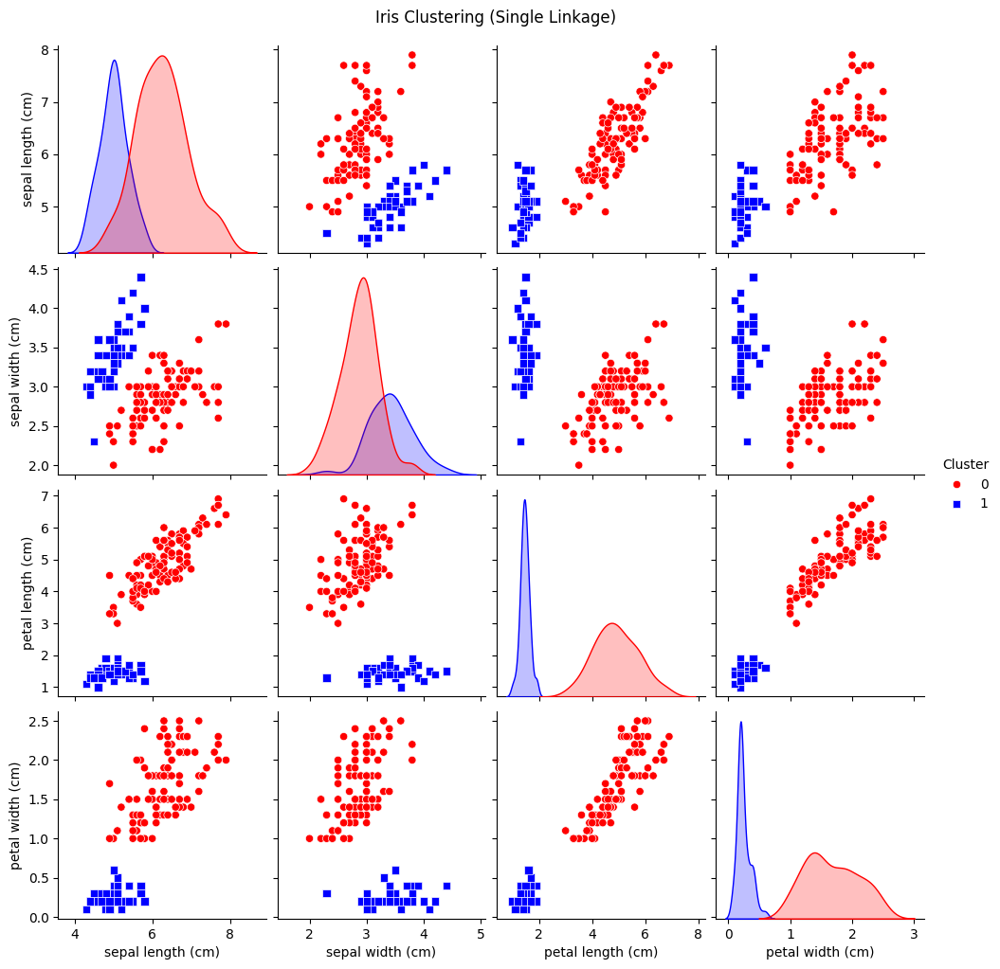

In [16]:
iris4['Cluster'] = cluster_es
palette = {0: 'red', 1: 'blue'}
sns.pairplot(iris4, hue="Cluster", diag_kind="kde", palette=palette, markers=["o", "s"])
plt.suptitle("Iris Clustering (Single Linkage)", y=1.02)
plt.show()

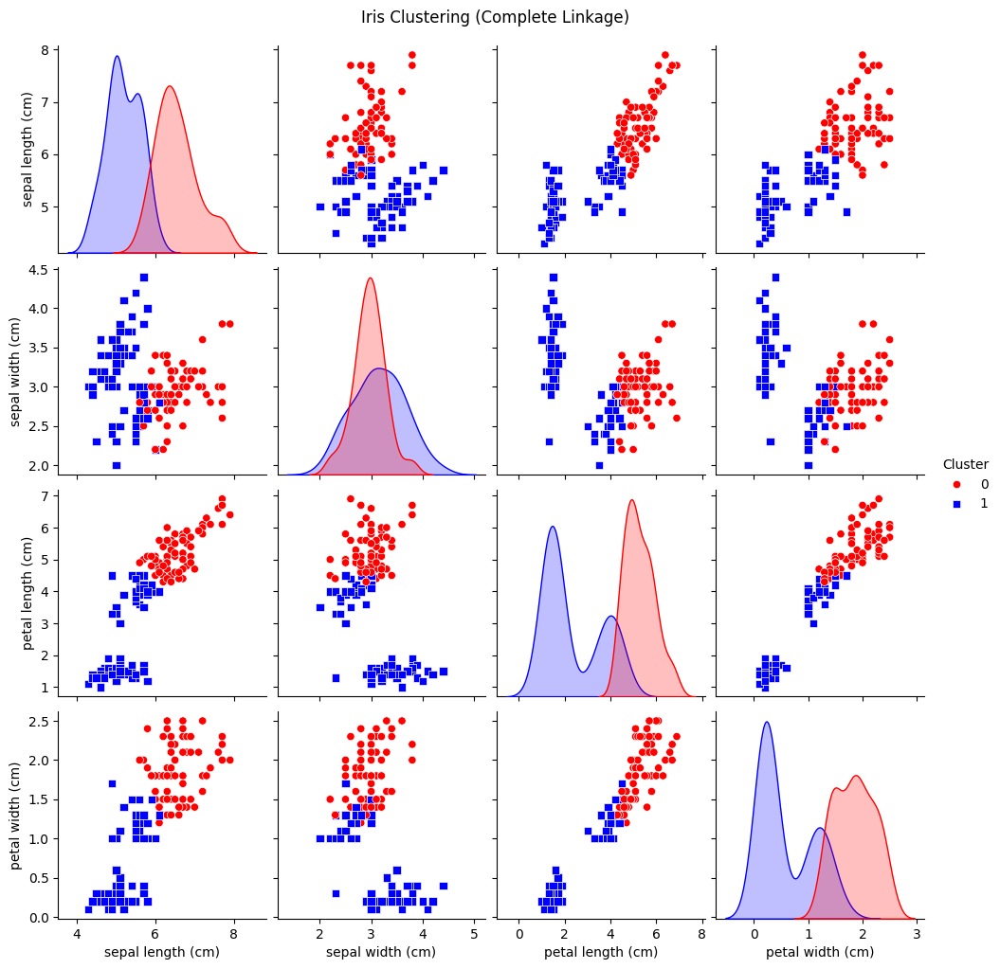

In [17]:
iris4['Cluster'] = cluster_ec
palette = {0: 'red', 1: 'blue'}
sns.pairplot(iris4, hue="Cluster", diag_kind="kde", palette=palette, markers=["o", "s"])
plt.suptitle("Iris Clustering (Complete Linkage)", y=1.02)
plt.show()

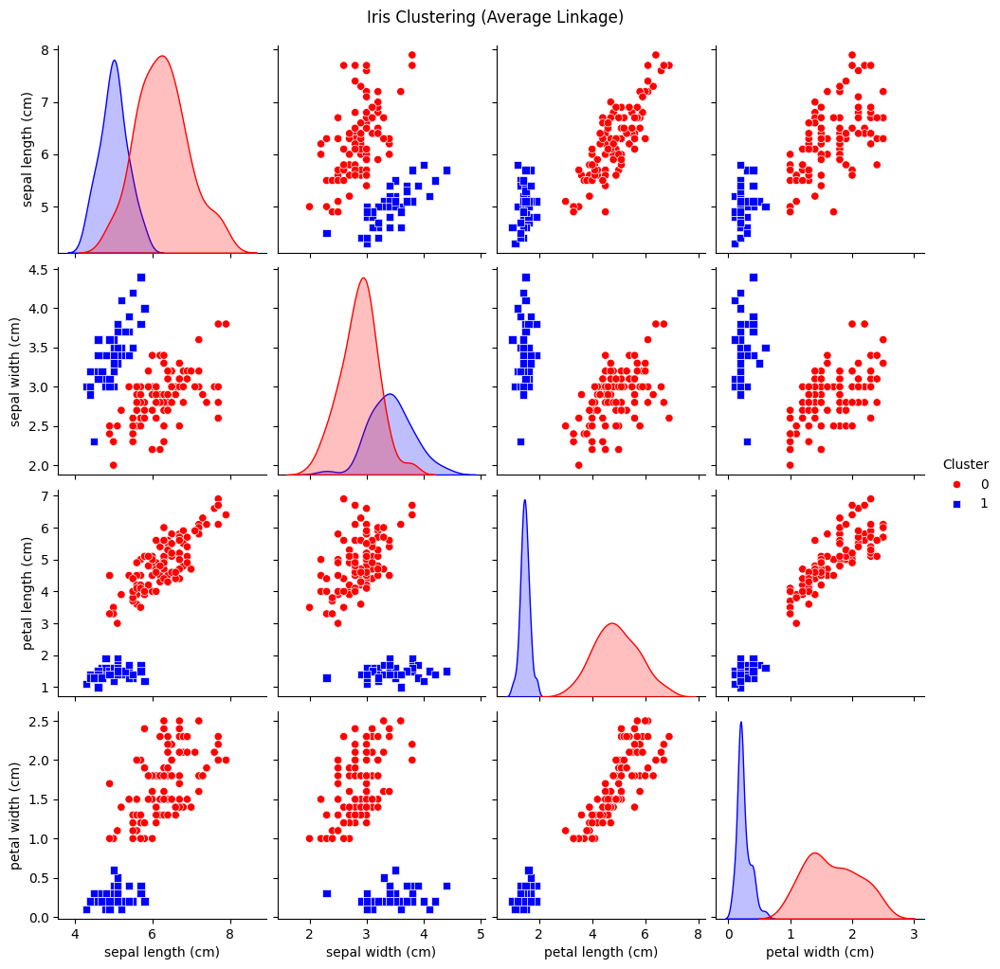

In [18]:
iris4['Cluster'] = cluster_ea
palette = {0: 'red', 1: 'blue'}
sns.pairplot(iris4, hue="Cluster", diag_kind="kde", palette=palette, markers=["o", "s"])
plt.suptitle("Iris Clustering (Average Linkage)", y=1.02)
plt.show()

### Cluster evaluation

The **cophenetic distance** between two points in a hierarchical clustering tree (dendrogram) is the height at which they are merged into the same cluster.

The **cophenetic correlation coefficient** measures how well the hierarchical clustering structure preserves the original pairwise distances, computing the correlation between $D$ and $C$

$$
CCC = \frac{\sum (d_{ij} - \bar{d})(c_{ij} - \bar{c})}{\sqrt{\sum (d_{ij} - \bar{d})^2 \sum (c_{ij} - \bar{c})^2}}
$$


with $d_{ij}$ original distances and $c_{ij}$ cophenetic distances

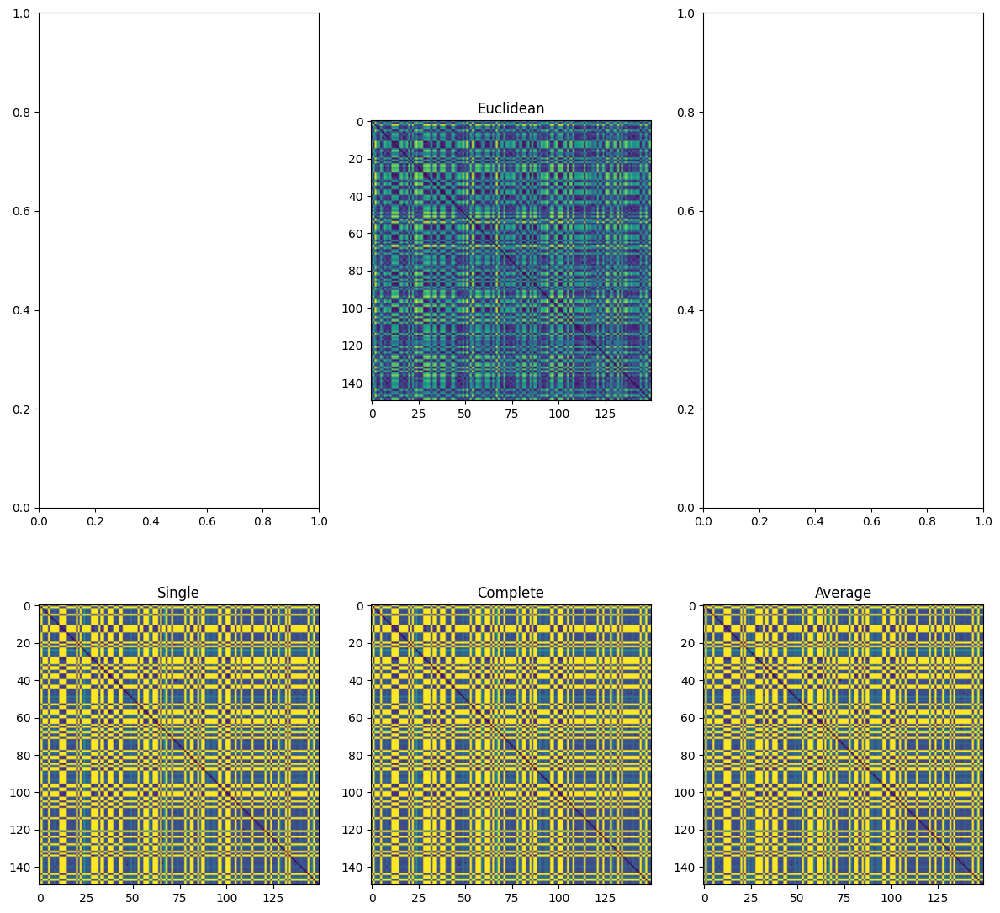

In [19]:
# Compute cophenetic distances and coefficients
coph_es, coph_dists_es = cophenet(iris_es, iris_e)
coph_ec, coph_dists_ec = cophenet(iris_ec, iris_e)
coph_ea, coph_dists_ea = cophenet(iris_ea, iris_e)

fig, axs = plt.subplots(2, 3, figsize=(12,12))
axs[0,1].imshow(squareform(iris_e), aspect='equal')
axs[0,1].set_title("Euclidean")
axs[1,0].imshow(squareform(coph_dists_es), aspect='equal')
axs[1,0].set_title("Single")
axs[1,1].imshow(squareform(coph_dists_es), aspect='equal')
axs[1,1].set_title("Complete")
axs[1,2].imshow(squareform(coph_dists_es), aspect='equal')
axs[1,2].set_title("Average")
plt.tight_layout()
plt.show()

In [20]:
print("Cophenetic coefficients:")
print({"Eucl-Single": coph_es, "Eucl-Complete": coph_ec, "Eucl-Average": coph_ea})

Cophenetic coefficients:
{'Eucl-Single': np.float64(0.8638786773076584), 'Eucl-Complete': np.float64(0.7276283289028814), 'Eucl-Average': np.float64(0.8769561464741984)}


Internal metrics valid for any clustering algorithm:

$$
WSS = \sum_{k=1}^{K} \sum_{x_i \in C_k} \| x_i - \mu_k \|^2
$$

$$
BSS = \sum_{k=1}^{K} |C_k| \cdot \| \mu_k - \mu \|^2
$$

WSS should be minimized, while BSS should be maximized

In [21]:
def compute_internal_measures(x, merges, k_values):
    wss_values = {}
    bss_values = {}

    overall_mean = np.mean(x, axis=0)  # Compute global mean

    for k in k_values:
        clustering = fcluster(merges, k, criterion='maxclust')
        # computes centroids for all clusters
        centroids = [np.mean(x[clustering==c],axis=0) for c in range(1,k+1)]
        cluster_sizes = [len(x[clustering==c]) for c in range(1,k+1)]
        # computes the euclidean distance between each point and each centroid
        D = cdist(x, centroids, 'euclidean')
        # find nearest centroid for each point
        cIdx = np.argmin(D,axis=1)
        # store the distances to the nearest centroid
        d = np.min(D,axis=1)

        # WSS
        wss = sum(d**2)

        # BSS
        bss = np.sum([size * np.sum((centroid - overall_mean) ** 2) for size, centroid in zip(cluster_sizes, centroids)])

        wss_values[k] = wss
        bss_values[k] = bss
    return wss_values,bss_values

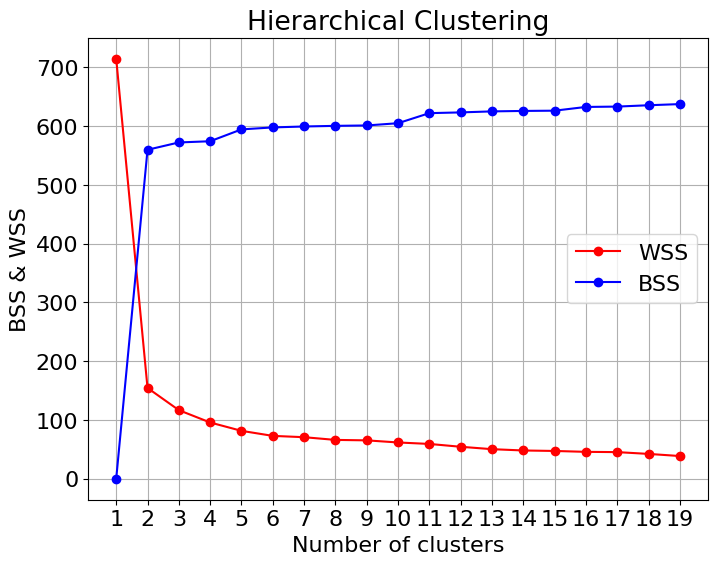

In [22]:
k_values = range(1,20)
wss_dict, bss_dict = compute_internal_measures(iris4, iris_es, k_values)
wss_values = [wss_dict[x] for x in range(1,20)]
bss_values = [bss_dict[x] for x in range(1,20)]
fig = plt.figure(figsize=(8,6))
font = {'family' : 'sans', 'size'   : 16}
plt.rc('font', **font)
plt.plot(k_values, wss_values, 'bo-', color='red', label='WSS')
plt.plot(k_values, bss_values, 'bo-', color='blue', label='BSS')
plt.grid(True)
plt.xlabel('Number of clusters')
plt.ylabel('BSS & WSS')
plt.xticks(k_values)
plt.legend()
plt.title('Hierarchical Clustering');

### Cluster description

In [23]:
iris4['Cluster'] = cluster_ea
iris4.groupby('Cluster').describe()

sepal length (cm)                                            \
                    count   mean       std  min  25%  50%  75%  max   
Cluster                                                               
0                   100.0  6.262  0.662834  4.9  5.8  6.3  6.7  7.9   
1                    50.0  5.006  0.352490  4.3  4.8  5.0  5.2  5.8   

        sepal width (cm)         ... petal length (cm)      petal width (cm)  \
                   count   mean  ...               75%  max            count   
Cluster                          ...                                           
0                  100.0  2.872  ...             5.525  6.9            100.0   
1                   50.0  3.428  ...             1.575  1.9             50.0   

                                                   
          mean       std  min  25%  50%  75%  max  
Cluster                                            
0        1.676  0.424769  1.0  1.3  1.6  2.0  2.5  
1        0.246  0.105386  0.1  0.2  0.2  0.3  0.6  

[2 rows x 32 columns]

**Snake plots**

First, the data are normalized (according to the mean and the standard deviation) then we plot each cluster's average normalized values of each attribute.

In [25]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()

normalized_iris = scaler.fit_transform(iris4)
df_iris_normalized = pd.DataFrame(normalized_iris,columns=iris4.columns)
df_iris_normalized['Cluster'] = cluster_ea

In [26]:
df_iris_melt = pd.melt(df_iris_normalized,
                    id_vars=['Cluster'],
                    value_vars=iris4.columns,
                    var_name='Attribute',
                    value_name='Value')
df_iris_melt

,Cluster,Attribute,Value
0,0,sepal length (cm),0.310998
1,1,sepal length (cm),-0.173674
2,0,sepal length (cm),2.249683
3,0,sepal length (cm),0.189830
4,0,sepal length (cm),1.159173
...,...,...,...
595,0,petal width (cm),0.132510
596,0,petal width (cm),0.659038
597,1,petal width (cm),-1.315444
598,0,petal width (cm),0.000878


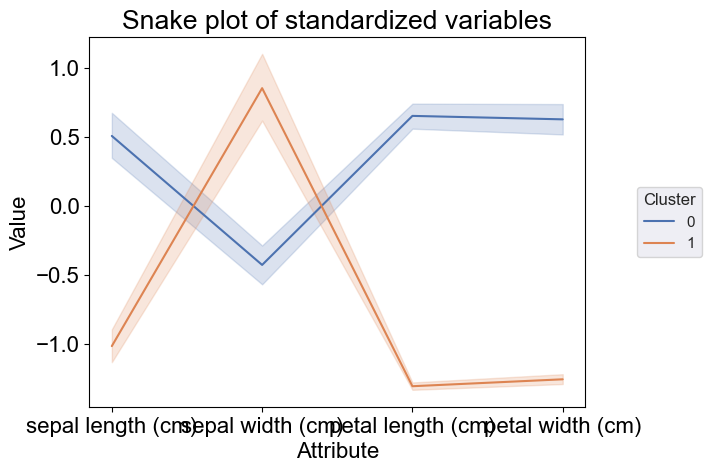

In [27]:
plt.title('Snake plot of standardized variables')
sns.set(rc={'figure.figsize':(20,8)})
sns.lineplot(x="Attribute", y="Value", hue='Cluster', data=df_iris_melt)
plt.legend(loc='center right', bbox_to_anchor=(1.25, 0.5), ncol=1, title='Cluster');

## Simulated data

### Univariate

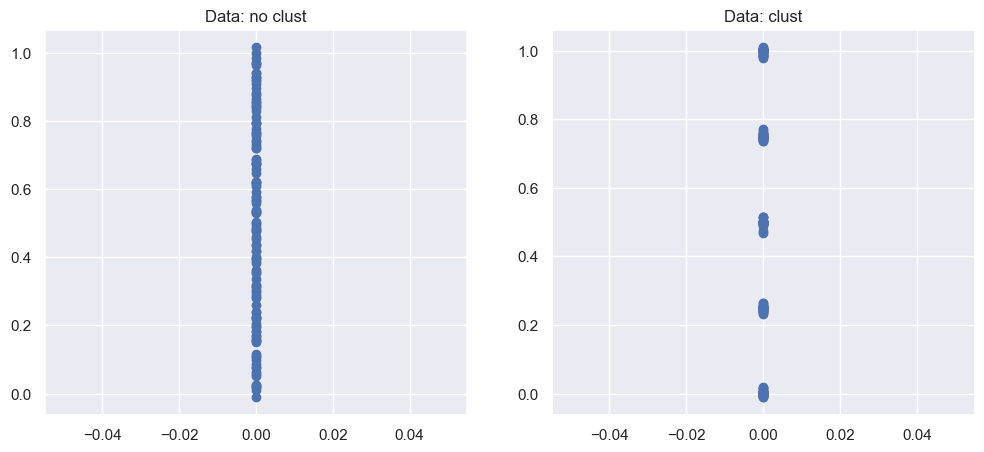

In [28]:
np.random.seed(123)
# x : vector of NON clustered data
x = np.linspace(0, 1, 125) + np.random.normal(scale=0.01, size=125)
# y: 5 clusters of 25 points each
y = np.concatenate([np.random.normal(loc=mean, scale=0.01, size=25) for mean in [0, 0.25, 0.5, 0.75, 1]])
x = np.random.permutation(x)
y = np.random.permutation(y)

plt.figure(figsize=(12,5))
plt.subplot(1,2,1)
plt.plot(np.zeros(125), x, 'o')
plt.title("Data: no clust")
plt.subplot(1,2,2)
plt.plot(np.zeros(125), y, 'o')
plt.title("Data: clust")
plt.show()

In [29]:
dx = pdist(x.reshape(-1,1), metric='euclidean')
dy = pdist(y.reshape(-1,1), metric='euclidean')
hcx = linkage(dx, method='single')
hcy = linkage(dy, method='single')
dx

array([0.6681858 , 0.40570206, 0.28933963, ..., 0.10706038, 0.64422969,
       0.75129007], shape=(7750,))

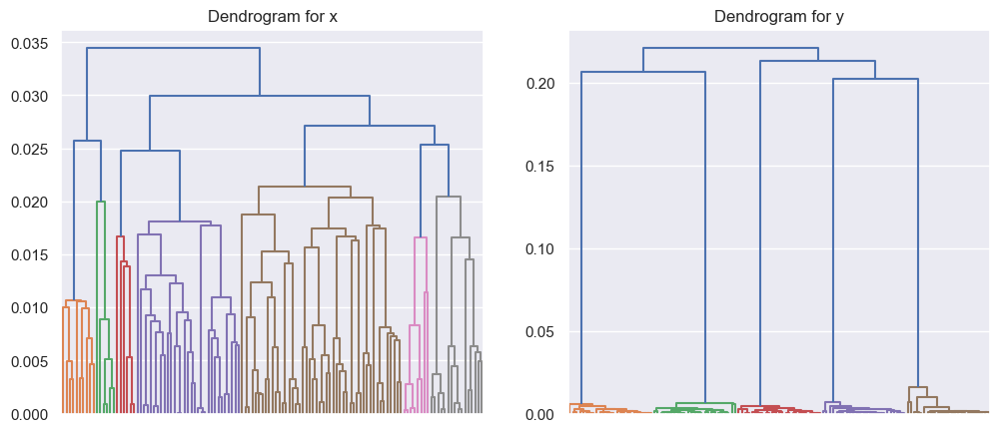

In [30]:
plt.figure(figsize=(12,5))
plt.subplot(1,2,1)
dendrogram(hcx, no_labels=True)
plt.title("Dendrogram for x")
plt.subplot(1,2,2)
dendrogram(hcy, no_labels=True)
plt.title("Dendrogram for y")
plt.show()

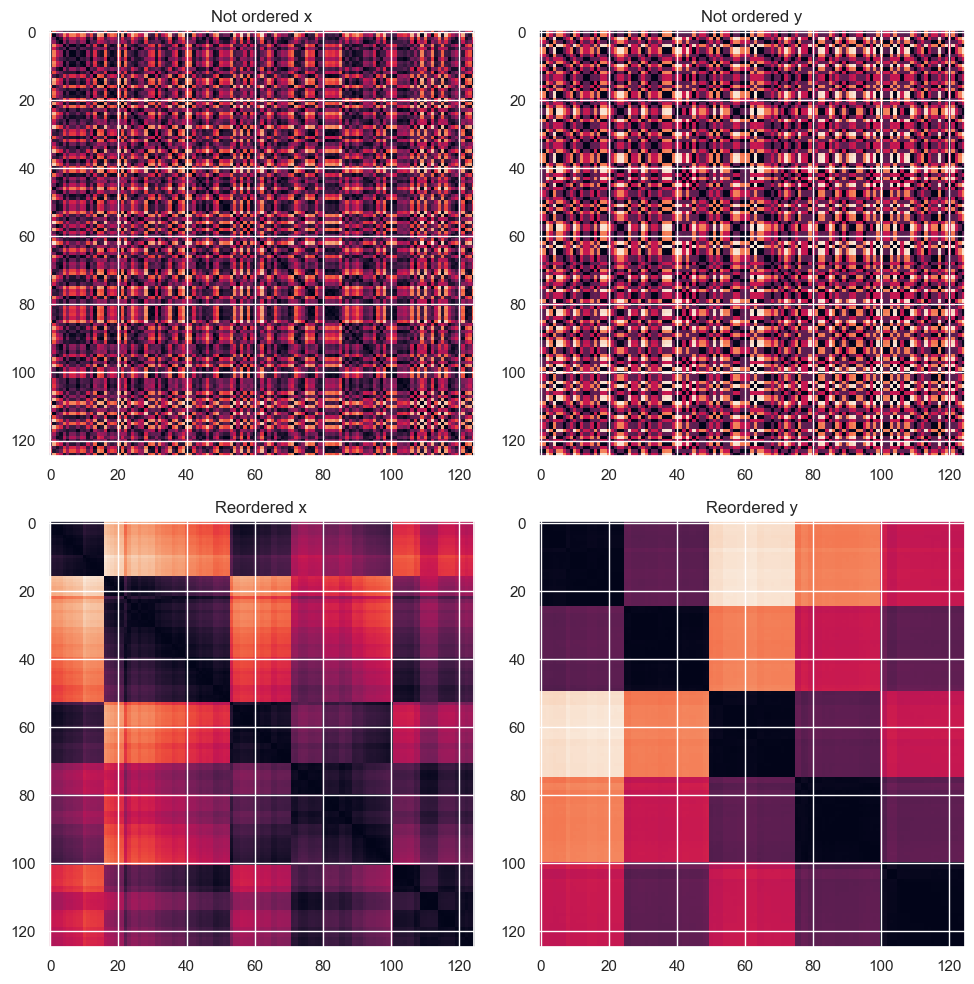

In [31]:
plt.figure(figsize=(10,10))
plt.subplot(2,2,1)
plt.imshow(squareform(dx), aspect='equal')
plt.title("Not ordered x")
plt.subplot(2,2,2)
plt.imshow(squareform(dy), aspect='equal')
plt.title("Not ordered y")

order_x = dendrogram(hcx, no_plot=True)['leaves']
order_y = dendrogram(hcy, no_plot=True)['leaves']
plt.subplot(2,2,3)
plt.imshow(squareform(dx)[np.ix_(order_x, order_x)], aspect='equal')
plt.title("Reordered x")
plt.subplot(2,2,4)
plt.imshow(squareform(dy)[np.ix_(order_y, order_y)], aspect='equal')
plt.title("Reordered y")
plt.tight_layout()
plt.show()

### Bivariate 1

Chaining effect with single linkage

In [33]:
p = 2
n = 100
mu1 = [0, 1]
mu2 = [5, 1.2]
sig = np.eye(p)
np.random.seed(1)
X1 = np.random.multivariate_normal(mu1, sig, n)
X2 = np.random.multivariate_normal(mu2, sig, n)
X = np.vstack([X1, X2])

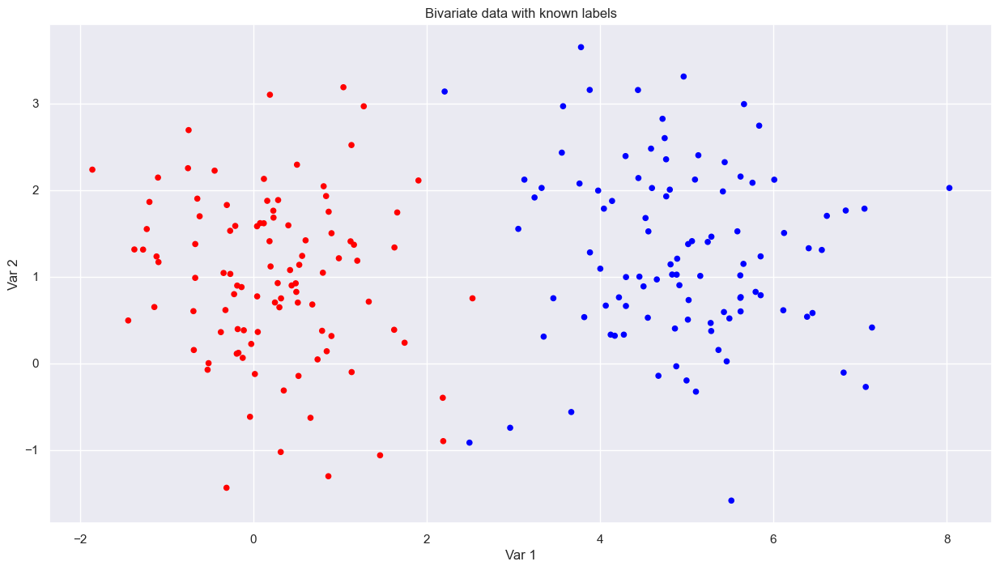

In [34]:
plt.figure()
plt.scatter(X[:,0], X[:,1], c=np.repeat(['red','blue'], n), s=20)
plt.xlabel("Var 1")
plt.ylabel("Var 2")
plt.title("Bivariate data with known labels")
plt.gca().set_aspect('equal', adjustable='box')
plt.show()

In [35]:
from scipy.cluster.hierarchy import dendrogram, linkage, cut_tree, cophenet, fcluster

clusters = {}
linkages = ['single', 'average', 'complete']
dissimilarity_matrix = pdist(X, metric='euclidean')
cs=[]

for lin in linkages:
  c = linkage(dissimilarity_matrix, method=lin)
  cs.append(c)
  cluster = cut_tree(c, n_clusters=2).flatten()
  clusters[lin] = cluster


clusters

{'single': array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0]),
 'average': array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0,
 

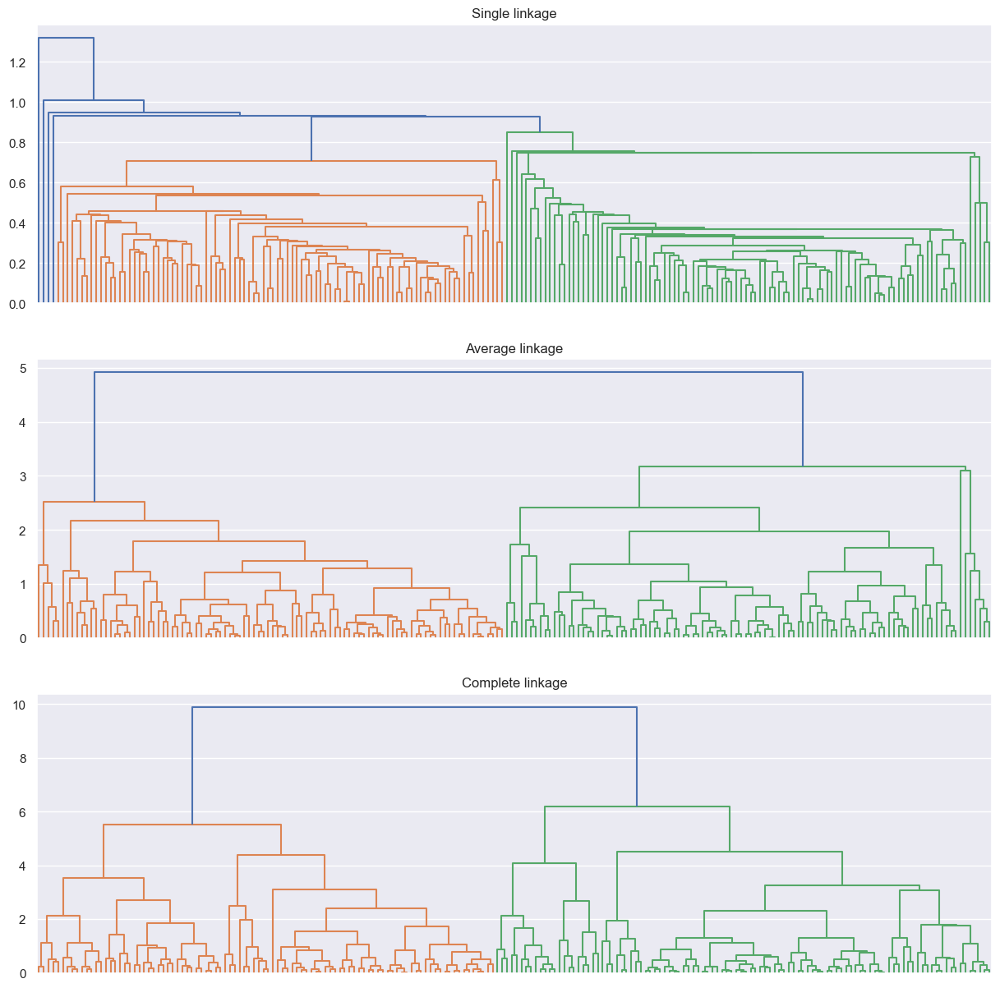

In [36]:
#al dendogram passi il risultato dei linkage
fig, axs = plt.subplots(3,1, figsize=(15,15))
dendrogram(cs[0], ax=axs[0], no_labels=True)
axs[0].set_title("Single linkage")
dendrogram(cs[1], ax=axs[1], no_labels=True)
axs[1].set_title("Average linkage")
dendrogram(cs[2], ax=axs[2], no_labels=True)
axs[2].set_title("Complete linkage")
plt.show()

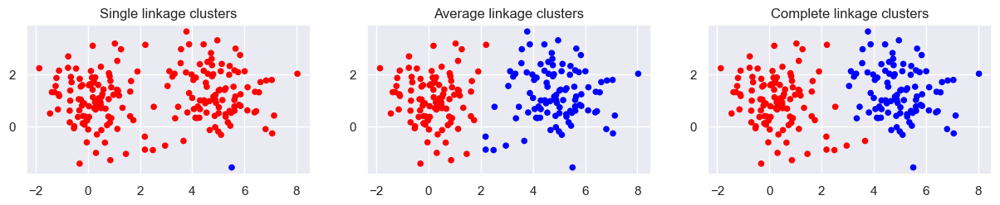

In [37]:
#cutting the dendogram into 2 classes
fig, axs = plt.subplots(1,3, figsize=(15,5))
axs[0].scatter(X[:,0], X[:,1], c=np.where(clusters['single']==0, 'red','blue'), s=20)
axs[0].set_title("Single linkage clusters")
axs[1].scatter(X[:,0], X[:,1], c=np.where(clusters['average']==0, 'red','blue'), s=20)
axs[1].set_title("Average linkage clusters")
axs[2].scatter(X[:,0], X[:,1], c=np.where(clusters['complete']==0, 'red','blue'), s=20)
axs[2].set_title("Complete linkage clusters")
for ax in axs:
    ax.set_aspect('equal', adjustable='box')
plt.show()

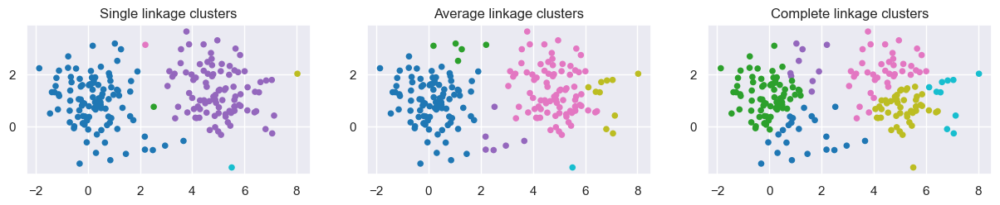

In [38]:
# Cut the dendrogram to get more clusters
k=6
cmap = plt.get_cmap('tab10')

cluster_es = cut_tree(cs[0], n_clusters=k).flatten()
cluster_ea = cut_tree(cs[1], n_clusters=k).flatten()
cluster_ec = cut_tree(cs[2], n_clusters=k).flatten()

fig, axs = plt.subplots(1,3, figsize=(15,5))
axs[0].scatter(X[:,0], X[:,1], c=cluster_es, cmap=cmap, s=20)
axs[0].set_title("Single linkage clusters")
axs[1].scatter(X[:,0], X[:,1], c=cluster_ea, cmap=cmap, s=20)
axs[1].set_title("Average linkage clusters")
axs[2].scatter(X[:,0], X[:,1], c=cluster_ec, cmap=cmap, s=20)
axs[2].set_title("Complete linkage clusters")
for ax in axs:
    ax.set_aspect('equal', adjustable='box')
plt.show()

### Bivariate 2

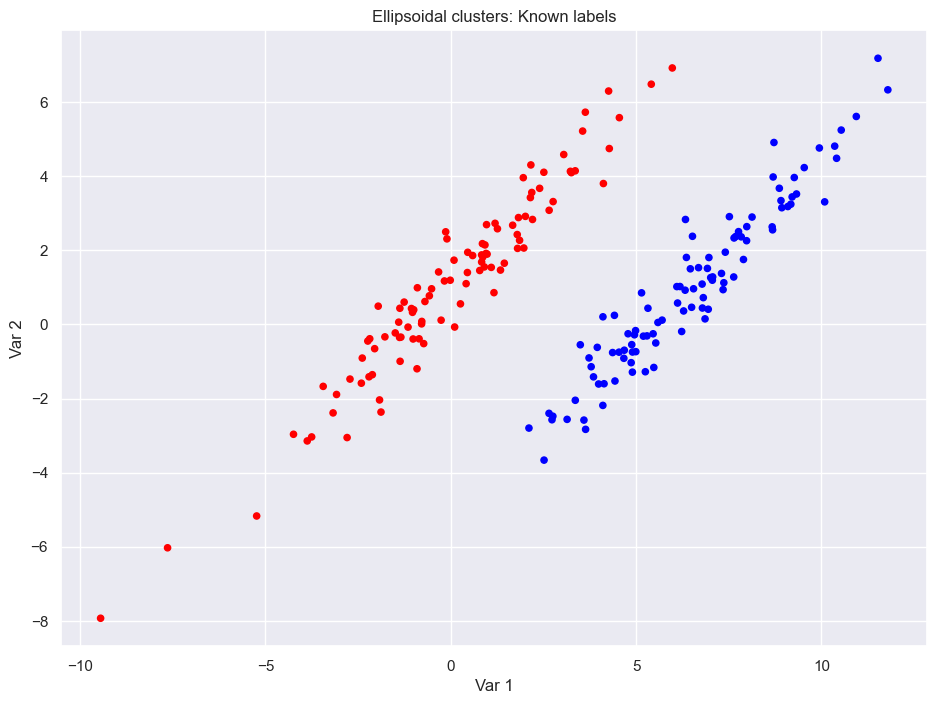

In [39]:
p = 2
n = 100
mu1 = [0, 1]
mu2 = [6.5, 1]
e1 = np.array([1, 1])
e2 = np.array([-1, 1])
sig = 5 * np.outer(e1, e1) + 0.1 * np.outer(e2, e2)
np.random.seed(2)
X1 = np.random.multivariate_normal(mu1, sig, n)
X2 = np.random.multivariate_normal(mu2, sig, n)
X = np.vstack([X1, X2])
plt.figure()
plt.scatter(X[:,0], X[:,1], c=np.repeat(['red','blue'], n), s=20)
plt.xlabel("Var 1")
plt.ylabel("Var 2")
plt.title("Ellipsoidal clusters: Known labels")
plt.gca().set_aspect('equal', adjustable='box')
plt.show()

In [40]:
x_d = pdist(X, metric='euclidean')
x_es = linkage(x_d, method='single')
x_ea = linkage(x_d, method='average')
x_ec = linkage(x_d, method='complete')

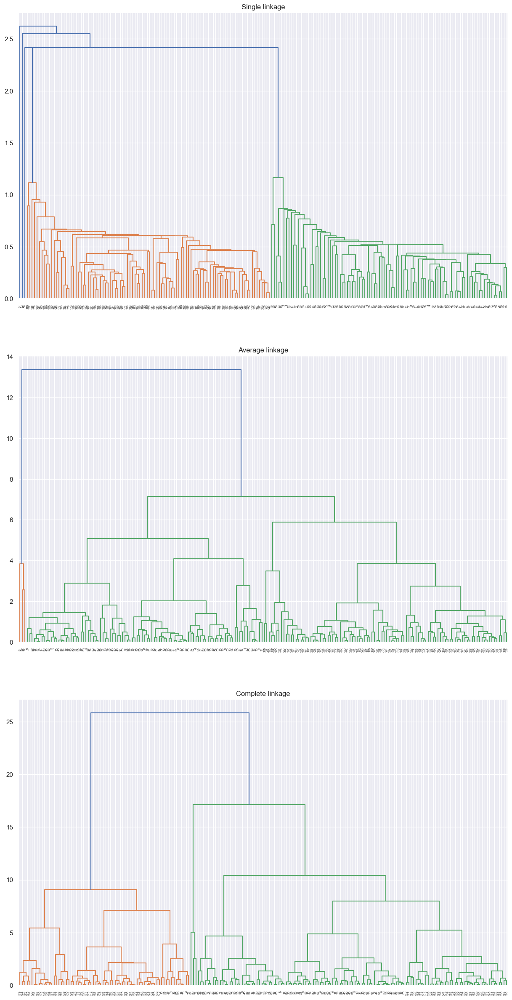

In [41]:
fig, axs = plt.subplots(3,1, figsize=(15,30))
dendrogram(x_es, ax=axs[0], no_labels=False)
axs[0].set_title("Single linkage")
dendrogram(x_ea, ax=axs[1], no_labels=False)
axs[1].set_title("Average linkage")
dendrogram(x_ec, ax=axs[2], no_labels=False)
axs[2].set_title("Complete linkage")
plt.show()

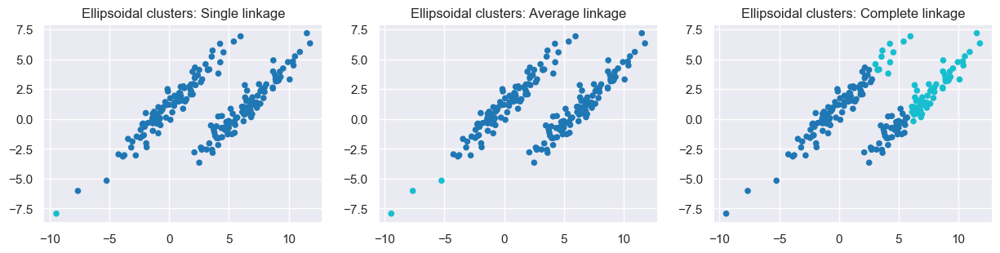

In [42]:
k=2
cluster_es = cut_tree(x_es, n_clusters=k).flatten()
cluster_ea = cut_tree(x_ea, n_clusters=k).flatten()
cluster_ec = cut_tree(x_ec, n_clusters=k).flatten()

fig, axs = plt.subplots(1,3, figsize=(15,5))
axs[0].scatter(X[:,0], X[:,1], c=cluster_es+1, s=20, cmap='tab10')
axs[0].set_title("Ellipsoidal clusters: Single linkage")
axs[1].scatter(X[:,0], X[:,1], c=cluster_ea+1, s=20, cmap='tab10')
axs[1].set_title("Ellipsoidal clusters: Average linkage")
axs[2].scatter(X[:,0], X[:,1], c=cluster_ec+1, s=20, cmap='tab10')
axs[2].set_title("Ellipsoidal clusters: Complete linkage")
for ax in axs:
    ax.set_aspect('equal', adjustable='box')
plt.show()

What if we remove some outliers?

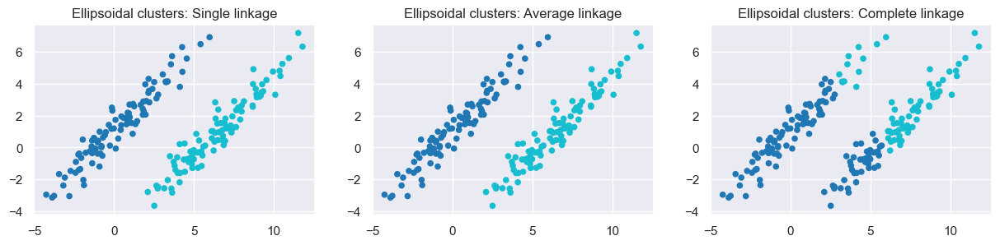

In [43]:
X_filtered = X[X[:, 1] > -5]
x_d = pdist(X_filtered, metric='euclidean')
x_es = linkage(x_d, method='single')
x_ea = linkage(x_d, method='average')
x_ec = linkage(x_d, method='complete')
k=2
cluster_es = cut_tree(x_es, n_clusters=k).flatten()
cluster_ea = cut_tree(x_ea, n_clusters=k).flatten()
cluster_ec = cut_tree(x_ec, n_clusters=k).flatten()

fig, axs = plt.subplots(1,3, figsize=(15,5))
axs[0].scatter(X_filtered[:,0], X_filtered[:,1], c=cluster_es+1, s=20, cmap='tab10')
axs[0].set_title("Ellipsoidal clusters: Single linkage")
axs[1].scatter(X_filtered[:,0], X_filtered[:,1], c=cluster_ea+1, s=20, cmap='tab10')
axs[1].set_title("Ellipsoidal clusters: Average linkage")
axs[2].scatter(X_filtered[:,0], X_filtered[:,1], c=cluster_ec+1, s=20, cmap='tab10')
axs[2].set_title("Ellipsoidal clusters: Complete linkage")
for ax in axs:
    ax.set_aspect('equal', adjustable='box')
plt.show()

## Earthquake dataset

In [ ]:
# Load the quakes dataset from R via statsmodels
import ssl
import urllib.request
import statsmodels.api as sm
ssl._create_default_https_context = ssl._create_unverified_context
quakes = sm.datasets.get_rdataset("quakes", "datasets").data

Q = quakes.iloc[:, :2].copy()
Q['depth'] = -quakes.iloc[:, 2] / 100
print(Q)

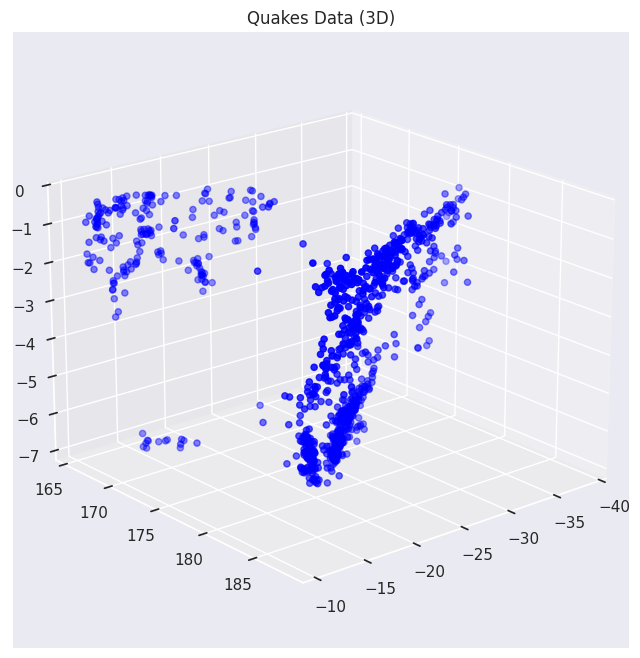

In [49]:
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.scatter(Q.iloc[:,0], Q.iloc[:,1], Q['depth'], c='blue', s=20)
ax.set_title("Quakes Data (3D)")
ax.view_init(elev=20, azim=50)
plt.show()

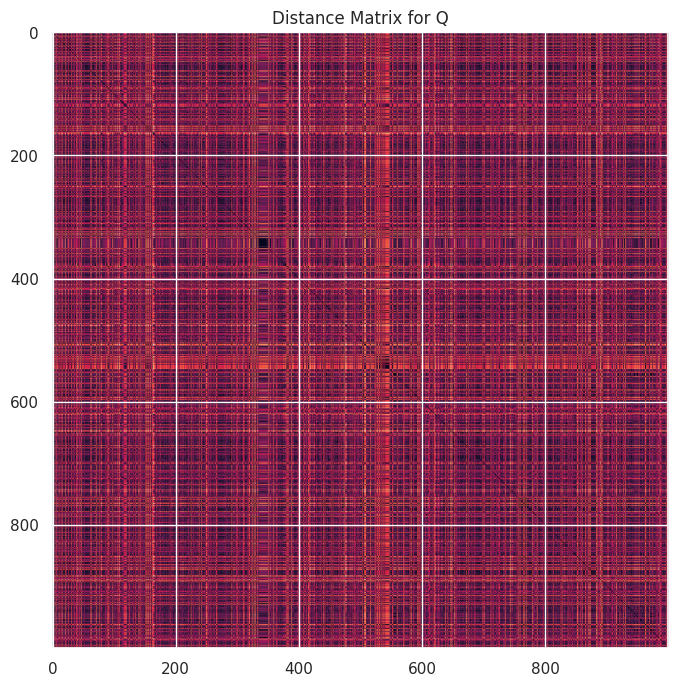

In [50]:
d_Q = pdist(Q.values, metric='euclidean')
plt.imshow(squareform(d_Q), aspect='equal')
plt.title("Distance Matrix for Q")
plt.show()

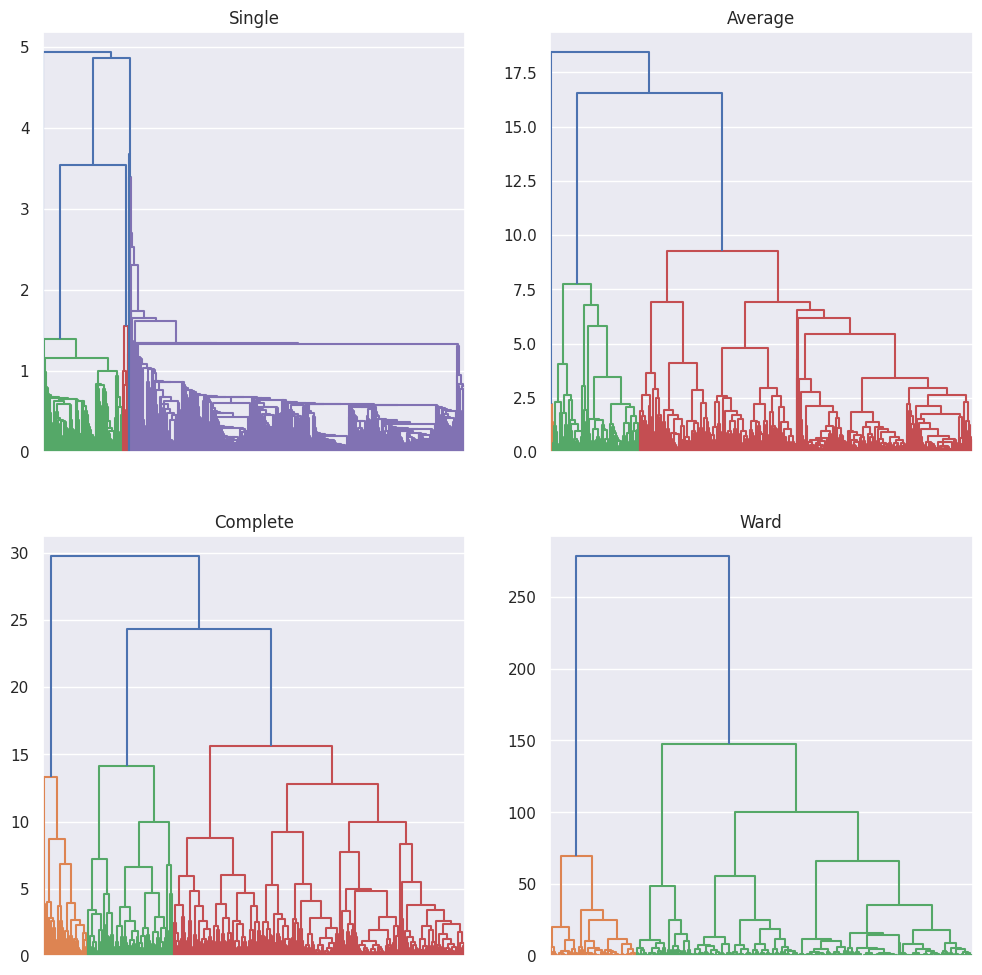

In [51]:
# Hierarchical clustering on Q:
clusts = linkage(d_Q, method='single')
clusta = linkage(d_Q, method='average')
clustc = linkage(d_Q, method='complete')
clustw = linkage(d_Q, method='ward')  # ward.D2 in R corresponds to Ward's method in scipy

fig, axs = plt.subplots(2, 2, figsize=(12,12))
dendrogram(clusts, ax=axs[0,0], no_labels=True)
axs[0,0].set_title("Single")
dendrogram(clusta, ax=axs[0,1], no_labels=True)
axs[0,1].set_title("Average")
dendrogram(clustc, ax=axs[1,0], no_labels=True)
axs[1,0].set_title("Complete")
dendrogram(clustw, ax=axs[1,1], no_labels=True)
axs[1,1].set_title("Ward")
plt.show()

Ward linkage choose the pair of clusters that once merged causes the smallest increase in WSS.

It avoids "chaining" seen in single linkage (where clusters can be stretched out).
It produces compact, spherical clusters.
It balances cluster sizes, unlike complete linkage, which might create clusters of very different sizes. It is more computational expensive.

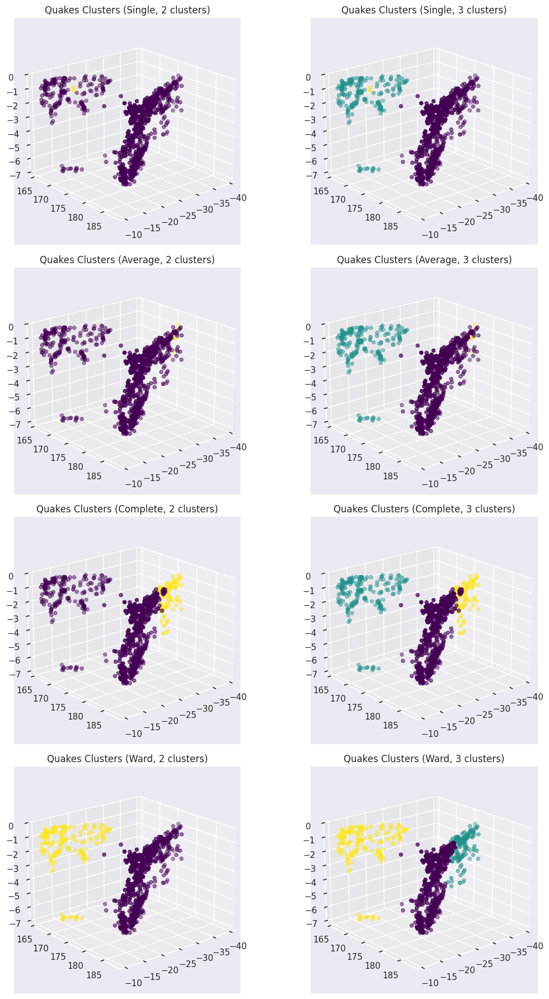

In [53]:
from scipy.cluster.hierarchy import cut_tree

cluster_s_2 = cut_tree(clusts, n_clusters=2).flatten()
cluster_s_3 = cut_tree(clusts, n_clusters=3).flatten()

cluster_a_2 = cut_tree(clusta, n_clusters=2).flatten()
cluster_a_3 = cut_tree(clusta, n_clusters=3).flatten()

cluster_c_2 = cut_tree(clustc, n_clusters=2).flatten()
cluster_c_3 = cut_tree(clustc, n_clusters=3).flatten()

cluster_w_2 = cut_tree(clustw, n_clusters=2).flatten()
cluster_w_3 = cut_tree(clustw, n_clusters=3).flatten()

# Create a 3x2 grid of 3D plots.
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D  # ensures 3D projection support

fig = plt.figure(figsize=(12, 18))

color_map = 'viridis'

# Row 1: Single Linkage
ax1 = fig.add_subplot(4, 2, 1, projection='3d')
ax1.scatter(Q.iloc[:, 0], Q.iloc[:, 1], Q['depth'], c=cluster_s_2 + 1, s=20, cmap=color_map)
ax1.set_title("Quakes Clusters (Single, 2 clusters)")
ax1.view_init(elev=20, azim=50)

ax2 = fig.add_subplot(4, 2, 2, projection='3d')
ax2.scatter(Q.iloc[:, 0], Q.iloc[:, 1], Q['depth'], c=cluster_s_3 + 1, s=20, cmap=color_map)
ax2.set_title("Quakes Clusters (Single, 3 clusters)")
ax2.view_init(elev=20, azim=50)

# Row 2: Average Linkage
ax3 = fig.add_subplot(4, 2, 3, projection='3d')
ax3.scatter(Q.iloc[:, 0], Q.iloc[:, 1], Q['depth'], c=cluster_a_2 + 1, s=20, cmap=color_map)
ax3.set_title("Quakes Clusters (Average, 2 clusters)")
ax3.view_init(elev=20, azim=50)

ax4 = fig.add_subplot(4, 2, 4, projection='3d')
ax4.scatter(Q.iloc[:, 0], Q.iloc[:, 1], Q['depth'], c=cluster_a_3 + 1, s=20, cmap=color_map)
ax4.set_title("Quakes Clusters (Average, 3 clusters)")
ax4.view_init(elev=20, azim=50)

# Row 3: Complete Linkage
ax5 = fig.add_subplot(4, 2, 5, projection='3d')
ax5.scatter(Q.iloc[:, 0], Q.iloc[:, 1], Q['depth'], c=cluster_c_2 + 1, s=20, cmap=color_map)
ax5.set_title("Quakes Clusters (Complete, 2 clusters)")
ax5.view_init(elev=20, azim=50)

ax6 = fig.add_subplot(4, 2, 6, projection='3d')
ax6.scatter(Q.iloc[:, 0], Q.iloc[:, 1], Q['depth'], c=cluster_c_3 + 1, s=20, cmap=color_map)
ax6.set_title("Quakes Clusters (Complete, 3 clusters)")
ax6.view_init(elev=20, azim=50)

# Row 4: Ward Linkage
ax7 = fig.add_subplot(4, 2, 7, projection='3d')
ax7.scatter(Q.iloc[:, 0], Q.iloc[:, 1], Q['depth'], c=cluster_w_2 + 1, s=20, cmap=color_map)
ax7.set_title("Quakes Clusters (Ward, 2 clusters)")
ax7.view_init(elev=20, azim=50)

ax8 = fig.add_subplot(4, 2, 8, projection='3d')
ax8.scatter(Q.iloc[:, 0], Q.iloc[:, 1], Q['depth'], c=cluster_w_3 + 1, s=20, cmap=color_map)
ax8.set_title("Quakes Clusters (Ward, 3 clusters)")
ax8.view_init(elev=20, azim=50)


plt.tight_layout()
plt.show()


**<font size="5">Applied Statistics</font>**

<font size="3">MSc in High Performance Computing Engineering, Computer Science and Engineering, Physics Engineering - A.Y. 2024-2025</font>

Prof. Mario Beraha - Dott. Vittorio Torri

---

<font size="4">**Lab 4 - K-Means and Gaussian Mixture Models clustering**</font>

# LAB 4

## Libraries

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
import matplotlib.cm as cm
import seaborn as sns
from sklearn.cluster import KMeans
from sklearn.datasets import load_iris, make_blobs, make_moons
from sklearn.metrics import silhouette_samples, silhouette_score
from sklearn.preprocessing import StandardScaler
from sklearn.mixture import GaussianMixture
from sklearn.decomposition import PCA
from matplotlib.colors import Normalize
from matplotlib.patches import Ellipse
import statsmodels.api as sm
import warnings
warnings.filterwarnings("ignore")

## K-Means

## Iterative Simulation

Simulate data belonging to three clusters

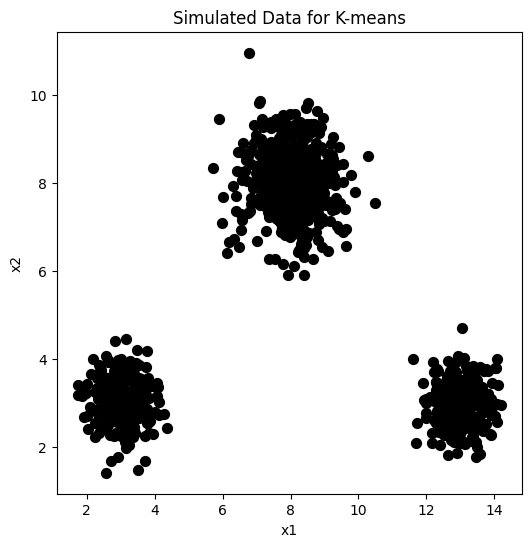

In [2]:
np.random.seed(1)

clusterA = np.random.normal([8,8], .75, (500,2))
clusterB = np.random.normal([3,3], .5, (250,2))
clusterC = np.random.normal([13,3], .5, (250,2))

x_data = np.concatenate((clusterA, clusterB, clusterC))

plt.figure(figsize=(6,6))
plt.scatter(x_data[:,0], x_data[:,1], c='black', s=50)
plt.xlabel("x1")
plt.ylabel("x2")
plt.title("Simulated Data for K-means")
plt.show()

Simulate k-means step-by-step execution

iteration  0
[[8.17888718 5.73646988]
 [7.98152621 5.55164672]
 [7.91311058 5.25665717]]
iteration  1
[[9.32152254 6.86728762]
 [6.45144978 6.86941434]
 [5.60283074 2.89630097]]
iteration  2
[[10.58292546  5.66990775]
 [ 7.35451667  8.09879361]
 [ 3.03964586  3.03814593]]
iteration  3
[[12.82753185  3.16195038]
 [ 8.00178631  8.05165588]
 [ 3.03964586  3.03814593]]
iteration  4
[[12.99259293  2.98426617]
 [ 8.03507366  8.02314505]
 [ 3.03964586  3.03814593]]


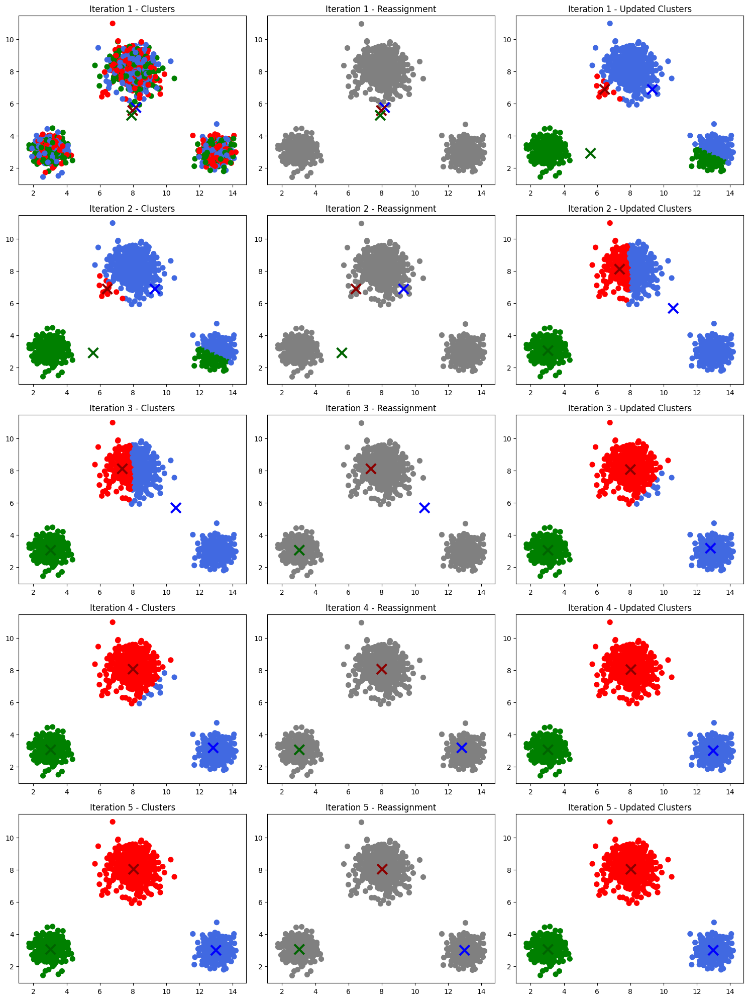

In [3]:
k = 3
n=1000
np.random.seed(0)
# Initial random cluster assignments
cluster_assign = np.random.choice([0, 1, 2], size=n)
iter_max = 5

colplot = ['royalblue', 'red', 'green']
colpoints = ['blue', 'darkred', 'darkgreen']

fig, axs = plt.subplots(iter_max, 3, figsize=(15, 4 * iter_max))
for i in range(iter_max):
    print('iteration ', i)
    # Compute cluster centers:
    C = np.array([x_data[cluster_assign == l].mean(axis=0) for l in range(k)])
    print(C)
    # Plot current clustering:
    axs[i, 0].scatter(x_data[:,0], x_data[:,1],
                      c=[colplot[c] for c in cluster_assign], s=50)
    axs[i, 0].scatter(C[:,0], C[:,1], c=colpoints, marker='x', s=200, linewidths=3)
    axs[i, 0].set_title(f"Iteration {i+1} - Clusters")

    # Reassign clusters based on Euclidean distance:
    D = np.linalg.norm(x_data[:, None, :] - C[None, :, :], axis=2)
    cluster_assign = np.argmin(D, axis=1)

    axs[i, 1].scatter(x_data[:,0], x_data[:,1], c='grey', s=50)
    axs[i, 1].scatter(C[:,0], C[:,1], c=colpoints, marker='x', s=200, linewidths=3)
    axs[i, 1].set_title(f"Iteration {i+1} - Reassignment")

    # After reassignment, update centers and plot:
    C = np.array([x_data[cluster_assign == l].mean(axis=0) for l in range(k)])
    axs[i, 2].scatter(x_data[:,0], x_data[:,1],
                      c=[colplot[c] for c in cluster_assign], s=50)
    axs[i, 2].scatter(C[:,0], C[:,1], c=colpoints, marker='x', s=200, linewidths=3)
    axs[i, 2].set_title(f"Iteration {i+1} - Updated Clusters")
plt.tight_layout()
plt.show()

## Earthquake dataset

In [4]:
# Load the quakes dataset from R via statsmodels
quakes = sm.datasets.get_rdataset("quakes", "datasets").data
Q = quakes.iloc[:, :2].copy()
Q['depth'] = -quakes.iloc[:, 2] / 100
print(Q)

URLError: <urlopen error [SSL: CERTIFICATE_VERIFY_FAILED] certificate verify failed: unable to get local issuer certificate (_ssl.c:1028)>

In [5]:
kmeans_result = KMeans(n_clusters=2, random_state=42).fit(Q)
print("K-means clusters (Earthquakes):\n", kmeans_result.labels_)
print("K-means centers:\n", kmeans_result.cluster_centers_)

K-means clusters (Earthquakes):
 [0 0 0 0 0 0 1 0 0 0 0 1 0 0 1 0 1 0 0 0 0 1 0 0 0 0 1 0 0 0 0 1 0 0 0 0 1
 0 0 1 0 0 0 0 1 0 0 1 0 0 0 0 1 0 0 0 0 0 0 0 0 0 1 1 0 0 0 0 0 0 0 0 1 0
 0 0 0 1 0 0 0 0 0 0 0 0 1 0 0 0 1 1 0 1 0 0 0 0 1 0 0 0 0 0 0 0 0 1 0 0 0
 0 0 0 0 0 1 1 1 1 1 0 0 0 0 1 0 0 0 0 0 0 1 0 0 1 0 0 0 0 1 0 1 0 1 0 0 1
 0 0 0 1 0 1 1 0 1 0 1 1 0 0 1 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1
 0 0 0 1 0 0 0 1 0 0 0 0 0 0 0 0 1 0 0 0 1 0 0 0 0 0 0 1 1 1 0 1 0 0 0 1 0
 0 0 0 1 0 0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0
 0 0 0 1 1 0 0 0 1 0 0 0 0 0 1 1 0 0 0 0 0 1 0 1 1 0 0 0 1 0 0 1 0 1 0 0 0
 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 1 0 0 1 0 0 0 0 1 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 1 1 0 1 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 1 0 1 0 0 0 0 0
 1 0 0 0 0 1 0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 1 0 0 0 1 0 1 0
 0 0 0 0 0 0 0 0 1 0 0 1 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 1 0 0 0 

In [6]:
print(kmeans_result.cluster_centers_[1,0])
print(kmeans_result.cluster_centers_[1,1])
print(kmeans_result.cluster_centers_[1,2])

-15.877853658536587
168.25980487804878
-1.6963902439024383


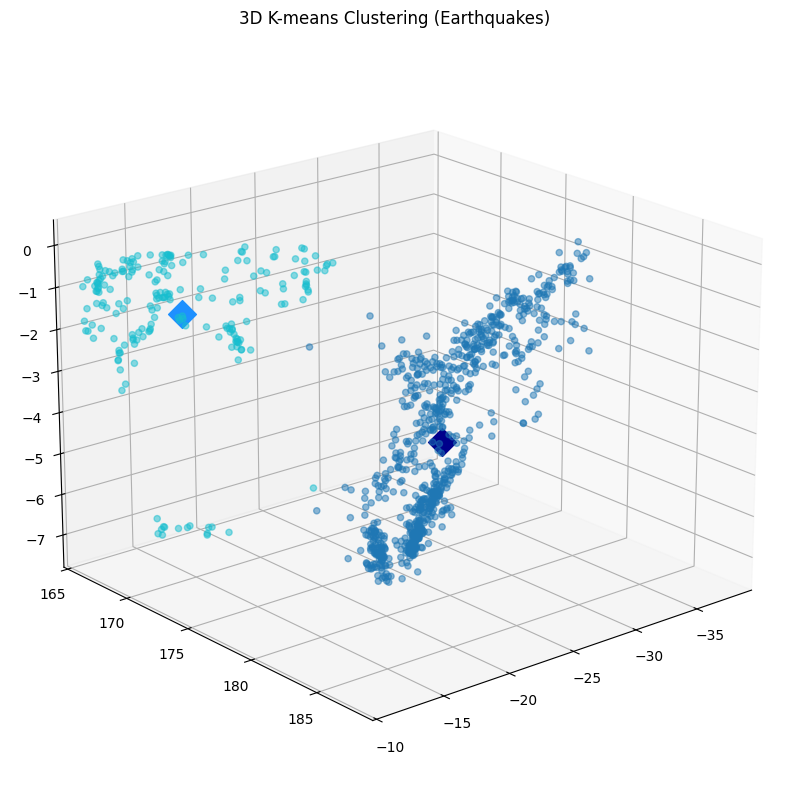

In [7]:
fig = plt.figure(figsize=(10,10))
ax = fig.add_subplot(111, projection='3d')
ax.set_xlim(Q.iloc[:,0].min()-1, Q.iloc[:,0].max()+1)
ax.set_ylim(Q.iloc[:,1].min()-1, Q.iloc[:,1].max()+1)
ax.set_zlim(Q['depth'].min()-1, Q['depth'].max()+1)
ax.scatter(Q.iloc[:,0], Q.iloc[:,1], Q['depth'], cmap='tab10', c=kmeans_result.labels_+1, s=20, alpha=0.5)
ax.scatter(kmeans_result.cluster_centers_[1,0],
           kmeans_result.cluster_centers_[1,1],
           kmeans_result.cluster_centers_[1,2],
           c='dodgerblue', s=200, marker='D', alpha=1)
ax.scatter(kmeans_result.cluster_centers_[0,0],
           kmeans_result.cluster_centers_[0,1],
           kmeans_result.cluster_centers_[0,2],
           c='darkblue', s=200, marker='D', alpha=1)
ax.set_title("3D K-means Clustering (Earthquakes)")
ax.view_init(elev=20, azim=50)
plt.show()

How to choose k

We can use WSS and BSS or a combination of them called variability ratio:

$$
\text{Variability ratio} = \frac{WSS}{WSS+BSS}
$$

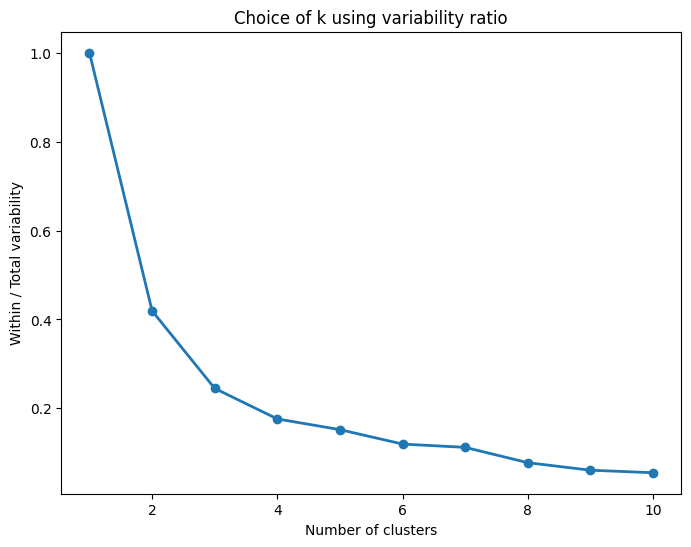

In [8]:
w = []
b = []
Q_values = Q.values
totss = np.sum((Q_values - Q_values.mean(axis=0))**2)
for k_val in range(1, 11):
    km = KMeans(n_clusters=k_val, random_state=42).fit(Q)
    withinss = km.inertia_ # WSS
    between_ss = totss - withinss
    w.append(withinss)
    b.append(between_ss)
ratio = np.array(w) / (np.array(w) + np.array(b))
plt.figure(figsize=(8,6))
plt.plot(range(1, 11), ratio, marker='o', linewidth=2)
plt.xlabel("Number of clusters")
plt.ylabel("Within / Total variability")
plt.title("Choice of k using variability ratio")
plt.show()

The variability ratio suggests k = 2 or 4. Let’s try k = 4

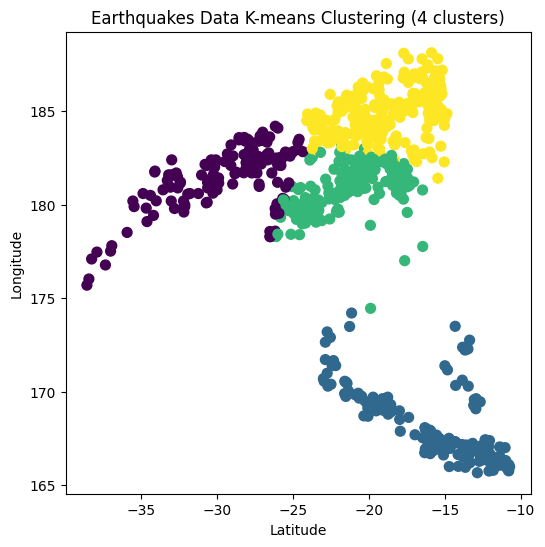

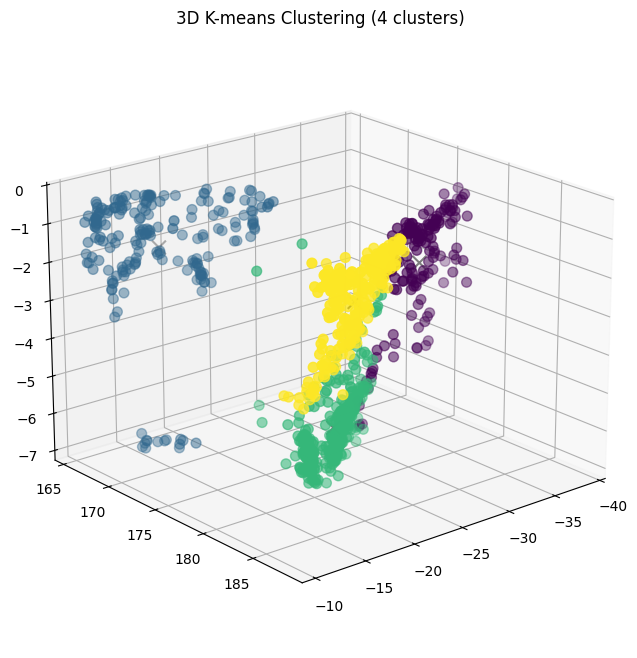

In [9]:
kmeans_result4 = KMeans(n_clusters=4, random_state=42).fit(Q)
plt.figure(figsize=(6,6))
plt.scatter(Q.iloc[:,0], Q.iloc[:,1], c=kmeans_result4.labels_+1, s=50)
plt.title("Earthquakes Data K-means Clustering (4 clusters)")
plt.xlabel("Latitude")
plt.ylabel("Longitude")
plt.show()

fig = plt.figure(figsize=(8,8))
ax = fig.add_subplot(111, projection='3d')
ax.scatter(Q.iloc[:,0], Q.iloc[:,1], Q['depth'], c=kmeans_result4.labels_+1, s=50)
ax.scatter(kmeans_result4.cluster_centers_[:,0],
           kmeans_result4.cluster_centers_[:,1],
           kmeans_result4.cluster_centers_[:,2],
           c='black', s=100, marker='x')
ax.set_title("3D K-means Clustering (4 clusters)")
ax.view_init(elev=20, azim=50)
plt.show()

##Iris (with silhouette)

Silhouette is both a measure of cohesion and separation of clusters. It is based on the difference between the average distance to points in the closest cluster and to points in the same cluster. For each point $x_i$ we calculate its silhouette coefficient $s_i$ as,

$s(x_i) = \frac{b(x_i)-a(x_i)}{max\{a(x_i),b(x_i)\}}$

Where $a(x_i)$ is the average distance between item $x_i$ and all other data within the same cluster; $b(x_i)$ is the mean distances from x_i to points in the closest cluster.

The $s_i$ value of a point $x_i$ lies in the interval [−1,+1]:
- A value close to +1 indicates that $x_i$ is much closer to points in its own cluster and is far from other clusters.
- A value close to zero indicates that $x_i$ is close to the boundary between two clusters.
- A value close to −1 indicates that $x_i$ is much closer to another cluster than its own cluster, and therefore, the point may be mis-clustered.

Silhouette analysis can be used to study the separation distance between the
resulting clusters. The silhouette plot displays a measure of how close each
point in one cluster is to points in the neighboring clusters and thus provides
a way to assess parameters like number of clusters visually. This measure has a
range of [-1, 1].

The **Silhouette Coefficient** is defined as the mean $s_i$ value across all the points. A value close to +1 indicates a good clustering.

$SC = \frac{1}{n} \sum_i s_i$

<b>Drawbacks</b>: note that the Silhouette Coefficient is generally higher for convex clusters than other concepts of clusters, such as density based clusters like those obtained through DBSCAN (not presented in this course).

In [10]:
iris_data = load_iris()
iris4 = pd.DataFrame(iris_data.data, columns=iris_data.feature_names)
species_name = iris_data.target
iris = iris4.copy()
iris['target'] = species_name

In [11]:
iris4

,sepal length (cm),sepal width (cm),petal length (cm),petal width (cm)
0,5.1,3.5,1.4,0.2
1,4.9,3.0,1.4,0.2
2,4.7,3.2,1.3,0.2
3,4.6,3.1,1.5,0.2
4,5.0,3.6,1.4,0.2
...,...,...,...,...
145,6.7,3.0,5.2,2.3
146,6.3,2.5,5.0,1.9
147,6.5,3.0,5.2,2.0
148,6.2,3.4,5.4,2.3


For n_clusters = 2 The average silhouette_score is : 0.6810461692117465
For n_clusters = 3 The average silhouette_score is : 0.5511916046195927
For n_clusters = 4 The average silhouette_score is : 0.49535632852885064
For n_clusters = 5 The average silhouette_score is : 0.48989824728439524
For n_clusters = 6 The average silhouette_score is : 0.47711750058213453


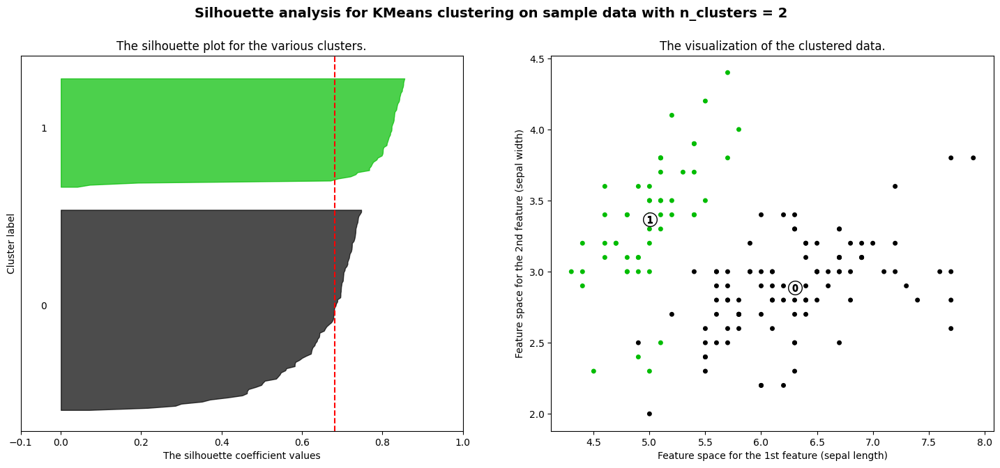

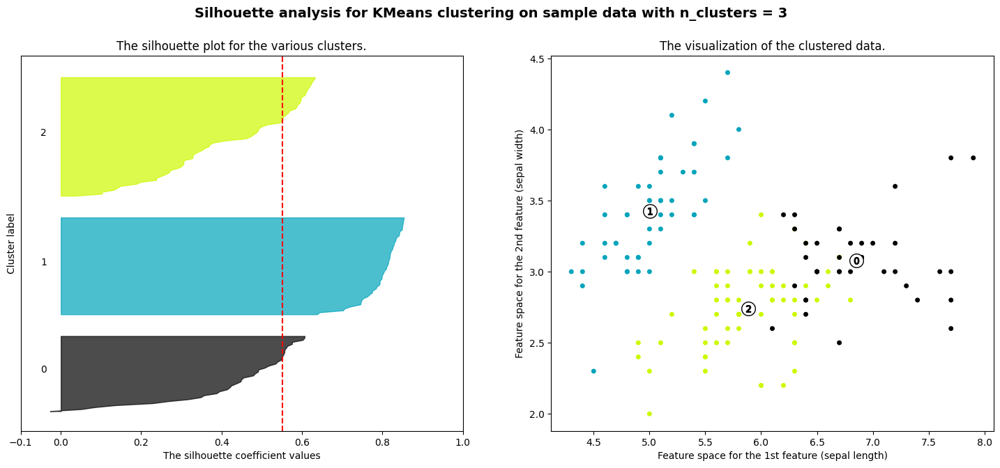

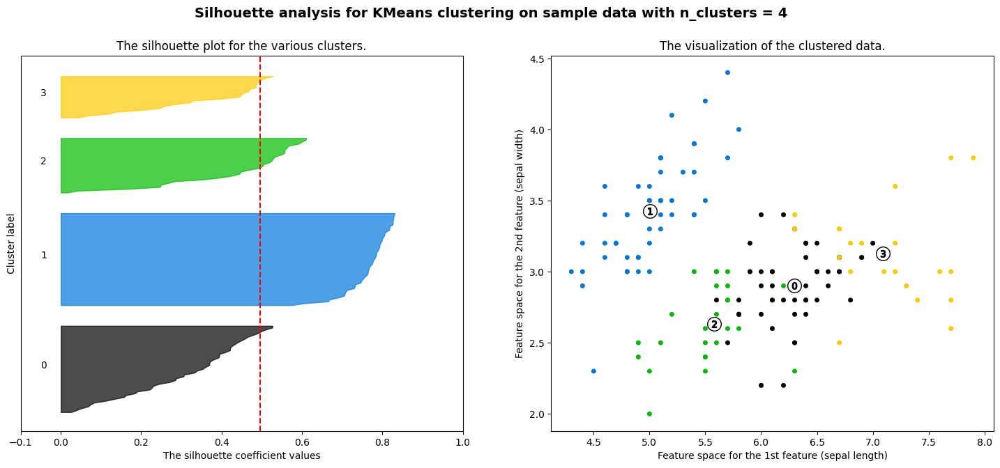

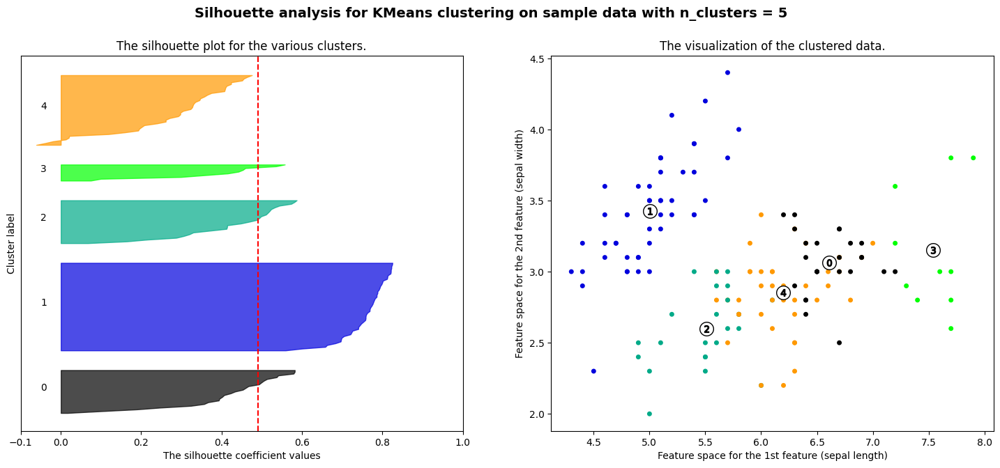

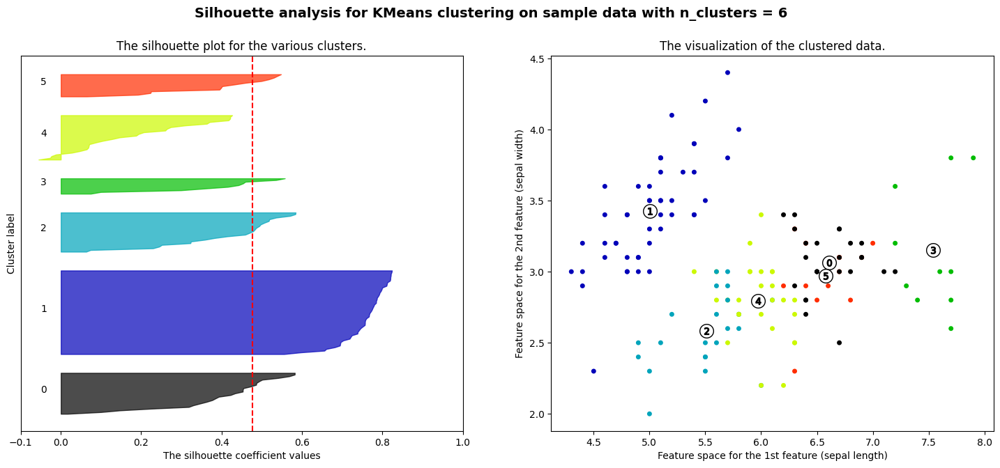

In [12]:
import matplotlib.cm as cm

#scaler = StandardScaler()
#X = scaler.fit_transform(iris.data)

X = iris.iloc[:, :4].values

range_n_clusters = [2, 3, 4, 5, 6]

for n_clusters in range_n_clusters:
    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.set_size_inches(18, 7)

    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-0.1, 1]
    ax1.set_xlim([-0.1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(X) + (n_clusters + 1) * 10])

    # Initialize the clusterer with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    clusterer = KMeans(n_clusters=n_clusters, random_state=10)
    cluster_labels = clusterer.fit_predict(X)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    silhouette_avg = silhouette_score(X, cluster_labels)
    print("For n_clusters =", n_clusters,
          "The average silhouette_score is :", silhouette_avg)

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(X, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = \
            sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i) / n_clusters)
        ax1.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("The silhouette plot for the various clusters.")
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

    # 2nd Plot showing the actual clusters formed
    colors = cm.nipy_spectral(cluster_labels.astype(float) / n_clusters)
    ax2.scatter(X[:, 0], X[:, 1], marker='.', s=100, lw=0, alpha=1,
                c=colors, edgecolor='k')

    # Labeling the clusters
    centers = clusterer.cluster_centers_
    # Draw white circles at cluster centers
    ax2.scatter(centers[:, 0], centers[:, 1], marker='o',
                c="white", alpha=1, s=200, edgecolor='k')

    for i, c in enumerate(centers):
        ax2.scatter(c[0], c[1], marker='$%d$' % i, alpha=1,
                    s=50, edgecolor='k')

    ax2.set_title("The visualization of the clustered data.")
    ax2.set_xlabel("Feature space for the 1st feature (sepal length)")
    ax2.set_ylabel("Feature space for the 2nd feature (sepal width)")

    plt.suptitle(("Silhouette analysis for KMeans clustering on sample data "
                  "with n_clusters = %d" % n_clusters),
                 fontsize=14, fontweight='bold')

plt.show()

WSS: 78.851441426146


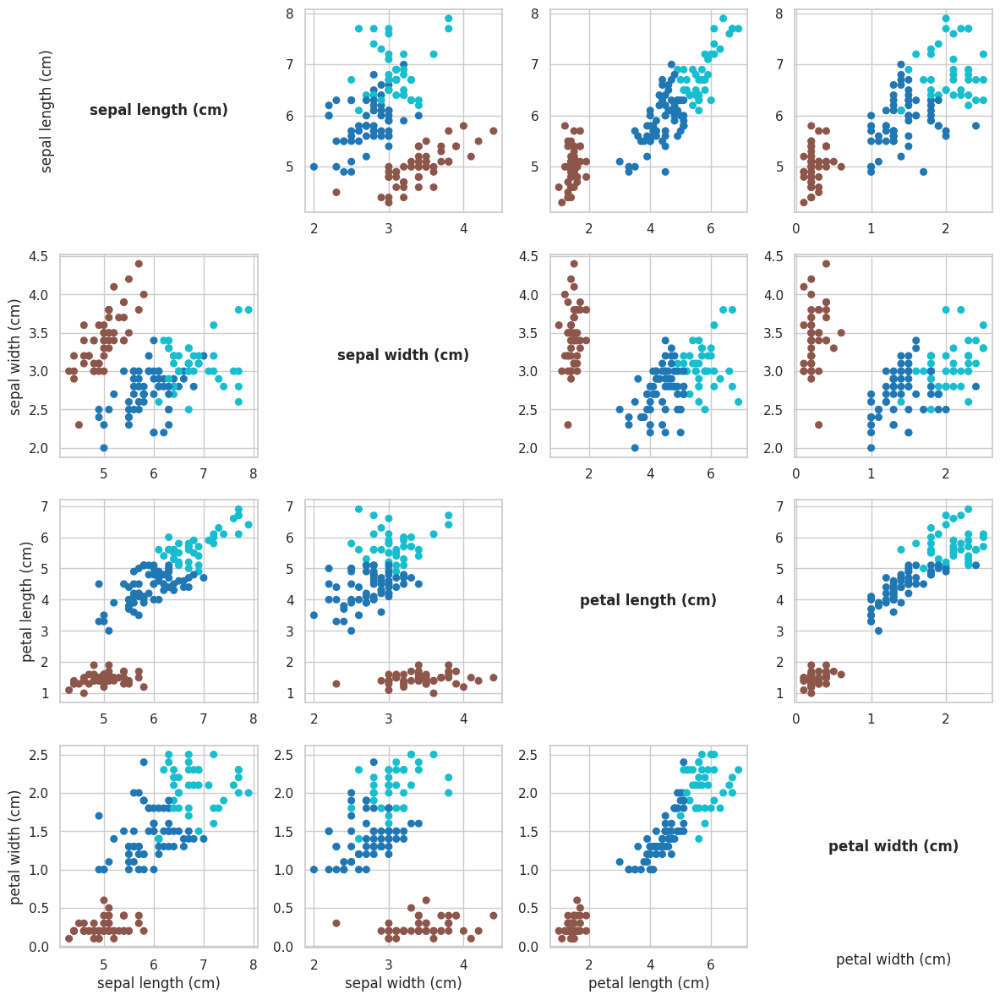

In [13]:
X = iris.iloc[:, :4].values

kmeans = KMeans(n_clusters=3, random_state=42, n_init=10)
kmeans.fit(X)

clusters = kmeans.predict(X)
print('WSS:', kmeans.inertia_)

# Create pairwise scatter plots
sns.set(style="whitegrid")
fig, axes = plt.subplots(4, 4, figsize=(12, 12))  # 4x4 grid for pairwise scatter plots
features = iris4.columns
num_features = len(features)
cmap = cm.get_cmap('tab10', 3)  # Three clusters

for i in range(num_features):
    for j in range(num_features):
        ax = axes[i, j]

        if i == j:
            ax.text(0.5, 0.5, features[i], ha='center', va='center', fontsize=12, fontweight='bold')
            ax.set_xticks([])
            ax.set_yticks([])
            ax.set_frame_on(False)
        else:
            colors = np.array([cmap(k) for k in clusters])  # Assign colors based on cluster
            ax.scatter(iris.iloc[:, j], iris.iloc[:, i], s=30, color=colors)

        if i == num_features - 1:
            ax.set_xlabel(features[j])
        if j == 0:
            ax.set_ylabel(features[i])

plt.tight_layout()
plt.show()


Silhouette analysis provides some guidelines but it is just one perspective and we should try more approaches and looks for some sort of agreement. For instance, we might check what the elbow and knee analysis has to say about this.

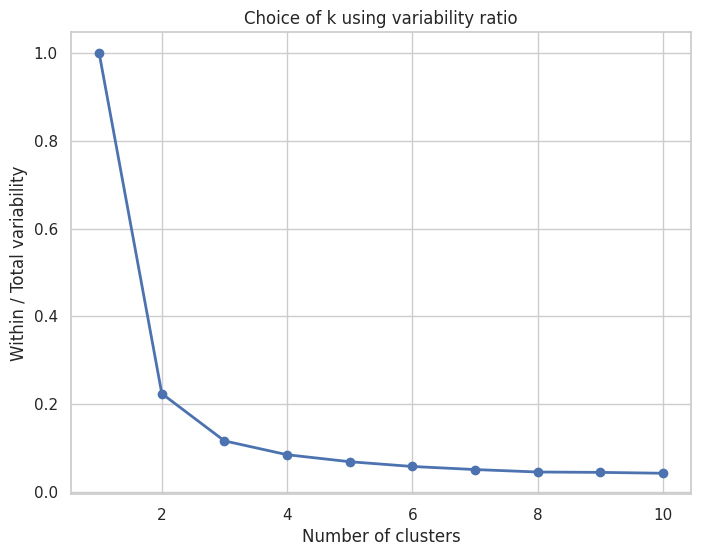

In [14]:
w = []
b = []
totss = np.sum((X - X.mean(axis=0))**2)
for k_val in range(1, 11):
    km = KMeans(n_clusters=k_val, random_state=42).fit(X)
    withinss = km.inertia_
    between_ss = totss - withinss
    w.append(withinss)
    b.append(between_ss)
ratio = np.array(w) / (np.array(w) + np.array(b))
plt.figure(figsize=(8,6))
plt.plot(range(1, 11), ratio, marker='o', linewidth=2)
plt.xlabel("Number of clusters")
plt.ylabel("Within / Total variability")
plt.title("Choice of k using variability ratio")
plt.show()

## Initialization effect

*n_init* runs k-means multiple times with different initializations and choose the best one wrt to WSS (also called *inertia*).

The default initialization in scikit-learn is *k-means++* which is optimized to spread out the initial positioning of the centroid. With this initialization, the default *n_init* is 1, while with the *random* initialization the default *n_init* is 10

WSS: 2816.0038196102405
WSS: 2812.8222498026266


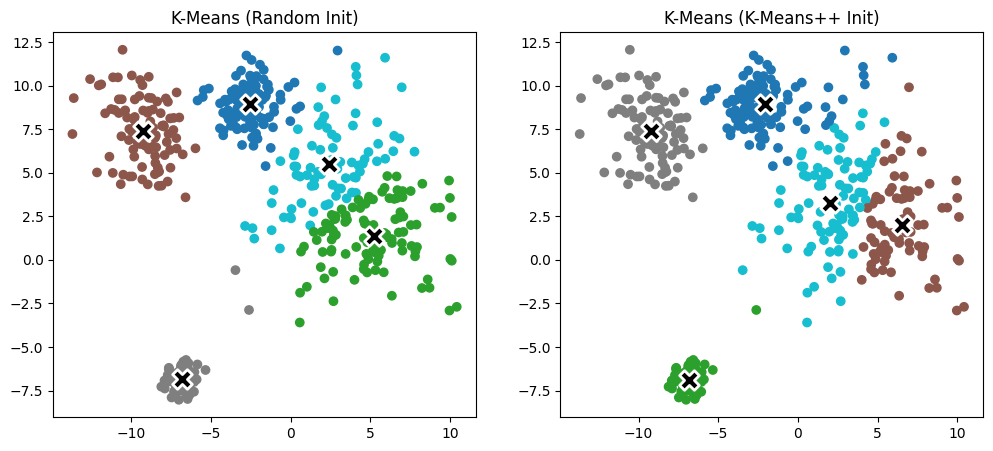

In [6]:
X, _ = make_blobs(n_samples=500, centers=5, cluster_std=[1.0, 2.5, 0.5, 1.8, 3.2], random_state=42)

# Fit K-Means with random initialization
kmeans_random = KMeans(n_clusters=5, init='random', random_state=12, n_init=1)
kmeans_random.fit(X)
clusters_random = kmeans_random.predict(X)
print('WSS:', kmeans_random.inertia_)

# Fit K-Means with k-means++ initialization
kmeans_plus = KMeans(n_clusters=5, init='k-means++', random_state=12, n_init=1)
kmeans_plus.fit(X)
clusters_plus = kmeans_plus.predict(X)
print('WSS:', kmeans_plus.inertia_)

fig, axes = plt.subplots(1, 2, figsize=(12, 5))

# Scatter plot for random initialization
axes[0].scatter(X[:, 0], X[:, 1], c=clusters_random, cmap=cm.get_cmap('tab10', 5))
axes[0].scatter(kmeans_random.cluster_centers_[:, 0], kmeans_random.cluster_centers_[:, 1],
                s=200, c='black', marker='X', edgecolors='white', linewidth=2)
axes[0].set_title("K-Means (Random Init)")

# Scatter plot for k-means++ initialization
axes[1].scatter(X[:, 0], X[:, 1], c=clusters_plus, cmap=cm.get_cmap('tab10', 5))
axes[1].scatter(kmeans_plus.cluster_centers_[:, 0], kmeans_plus.cluster_centers_[:, 1],
                s=200, c='black', marker='X', edgecolors='white', linewidth=2)
axes[1].set_title("K-Means (K-Means++ Init)")

plt.show()


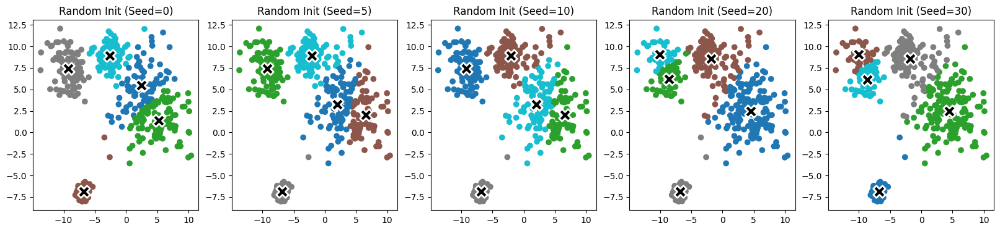

In [7]:
# Run K-Means multiple times with different seeds
fig, axes = plt.subplots(1, 5, figsize=(20, 4))

for i, seed in enumerate([0, 5, 10, 20, 30]):
    kmeans = KMeans(n_clusters=5, init='random', random_state=seed, n_init=1)
    kmeans.fit(X)
    clusters = kmeans.predict(X)

    # Scatter plot
    axes[i].scatter(X[:, 0], X[:, 1], c=clusters, cmap=cm.get_cmap('tab10', 5))
    axes[i].scatter(kmeans.cluster_centers_[:, 0], kmeans.cluster_centers_[:, 1],
                    s=200, c='black', marker='X', edgecolors='white', linewidth=2)
    axes[i].set_title(f"Random Init (Seed={seed})")

plt.show()


## Standardization

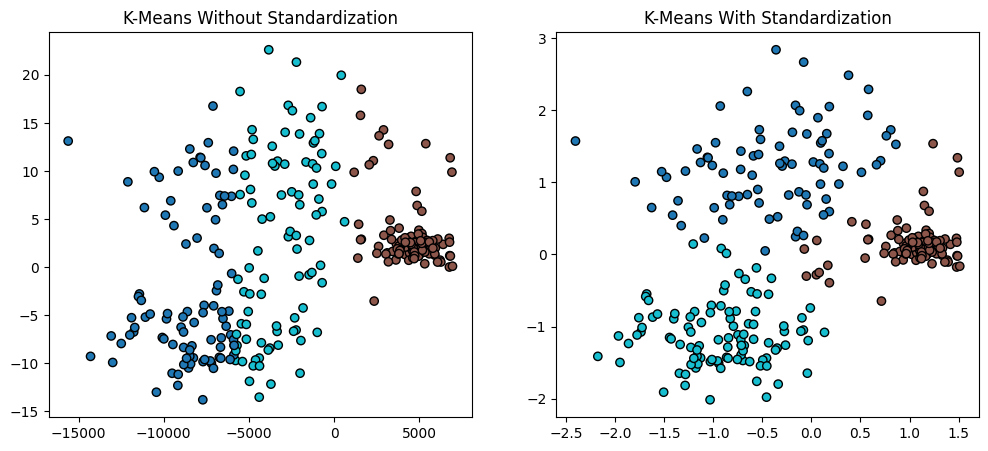

In [8]:
# Generate synthetic data with three clusters
X, _ = make_blobs(n_samples=300, centers=3, cluster_std=[5.0, 1.0, 3.0], random_state=42)

# Scale one feature to be much larger than the other
X[:, 0] *= 1000  # Multiply first feature by 1000 (large scale)

# K-Means clustering without standardization
kmeans_no_scaling = KMeans(n_clusters=3, random_state=42)
clusters_no_scaling = kmeans_no_scaling.fit_predict(X)

# Standardize the dataset
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# K-Means clustering with standardization
kmeans_scaled = KMeans(n_clusters=3, random_state=42, n_init=10)
clusters_scaled = kmeans_scaled.fit_predict(X_scaled)

# Plot results
fig, axes = plt.subplots(1, 2, figsize=(12, 5))

# Without Standardization
axes[0].scatter(X[:, 0], X[:, 1], c=clusters_no_scaling, cmap='tab10', edgecolors='k')
axes[0].set_title("K-Means Without Standardization")

# With Standardization
axes[1].scatter(X_scaled[:, 0], X_scaled[:, 1], c=clusters_scaled, cmap='tab10', edgecolors='k')
axes[1].set_title("K-Means With Standardization")

plt.show()


## Dimensionality Reduction

An example where PCA is harmful


Contingency Table - Original 2D:
K-Means_2D    0    1    2
True                     
0             0    1  199
1           199    1    0
2             3  197    0 

Contingency Table - After PCA to 1D:
K-Means_1D    0    1    2
True                     
0             4    0  196
1           174   26    0
2            24  176    0


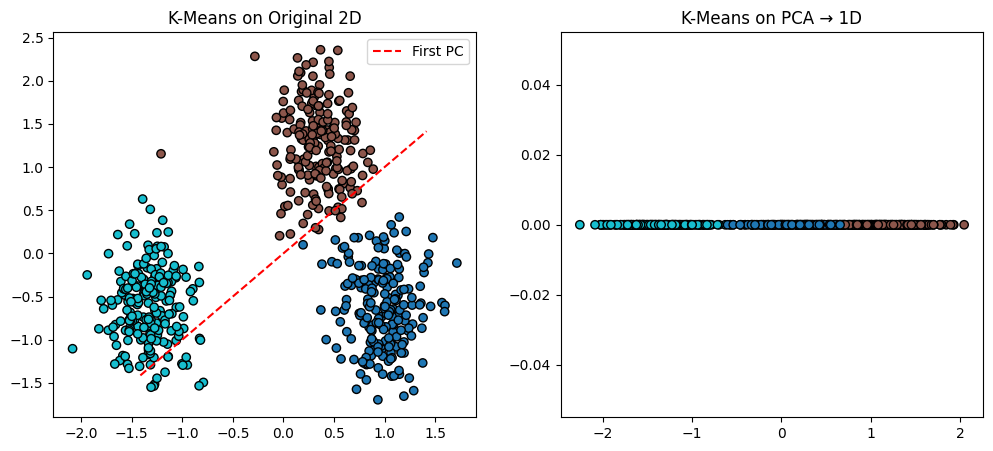

In [9]:
# --------------------------------------------------------
# Generate a simple 2D dataset with 3 well-separated clusters
# --------------------------------------------------------
rng = np.random.RandomState(42)

n_per_cluster = 200

# Cluster 1 around (0, 0)
X1 = rng.normal(loc=[0, 0], scale=1.0, size=(n_per_cluster, 2))
y1 = np.zeros(n_per_cluster, dtype=int)

# Cluster 2 around (10, 0)
X2 = rng.normal(loc=[10, 0], scale=1.0, size=(n_per_cluster, 2))
y2 = np.ones(n_per_cluster, dtype=int)

# Cluster 3 around (5, 5)
X3 = rng.normal(loc=[7, 4], scale=1.0, size=(n_per_cluster, 2))
y3 = np.full(n_per_cluster, 2, dtype=int)

# Combine into one dataset
X_2D = np.vstack([X1, X2, X3])
y_true = np.concatenate([y1, y2, y3])

# Standardize the data so it's centered at (0,0) with unit variance
scaler = StandardScaler()
X_2D_scaled = scaler.fit_transform(X_2D)

# --------------------------------------------------------
# K-Means on the original 2D data
# --------------------------------------------------------
kmeans_2d = KMeans(n_clusters=3, random_state=42, n_init=10)
labels_2d = kmeans_2d.fit_predict(X_2D_scaled)

# --------------------------------------------------------
# PCA to 1D, then K-Means
# --------------------------------------------------------
pca_1d = PCA(n_components=1, random_state=42)
X_1D = pca_1d.fit_transform(X_2D_scaled)

kmeans_1d = KMeans(n_clusters=3, random_state=42, n_init=10)
labels_1d = kmeans_1d.fit_predict(X_1D)


# --------------------------------------------------------
# Contingency tables
# --------------------------------------------------------
cont_2d = pd.crosstab(pd.Series(y_true, name='True'),
                      pd.Series(labels_2d, name='K-Means_2D'))
cont_1d = pd.crosstab(pd.Series(y_true, name='True'),
                      pd.Series(labels_1d, name='K-Means_1D'))

print("\nContingency Table - Original 2D:")
print(cont_2d, "\n")
print("Contingency Table - After PCA to 1D:")
print(cont_1d)

# --------------------------------------------------------
# Plot results: including the 1D PCA direction
# --------------------------------------------------------
fig, axes = plt.subplots(1, 2, figsize=(12, 5))

# (A) Scatter in original 2D (scaled), color by K-Means cluster
axes[0].scatter(X_2D_scaled[:, 0], X_2D_scaled[:, 1],
                c=labels_2d, cmap="tab10", edgecolor='k')
axes[0].set_title("K-Means on Original 2D")

pc_vector = pca_1d.components_[0]  # shape: (2,)
# We'll draw a line passing through the origin (center = 0,0 after StandardScaler)
# param "alpha" will range from -5 to +5 for a visually nice line
alpha_vals = np.linspace(-2, 2, 100)
line_x = alpha_vals * pc_vector[0]
line_y = alpha_vals * pc_vector[1]

axes[0].plot(line_x, line_y, color='red', linestyle='--', label='First PC')
axes[0].legend()

axes[1].scatter(X_1D[:, 0], np.zeros_like(X_1D[:, 0]),
                c=labels_1d, cmap="tab10", edgecolor='k')
axes[1].set_title("K-Means on PCA → 1D")

plt.show()


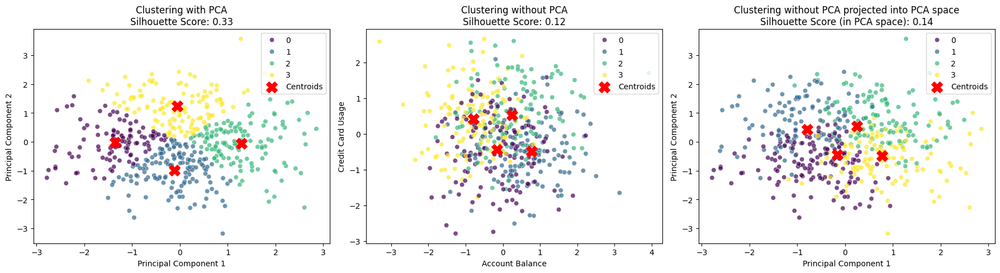

In [10]:
np.random.seed(42)
num_customers = 500

data = {
    'account_balance': np.random.normal(5000, 2000, num_customers),
    'credit_card_usage': np.random.normal(2000, 800, num_customers),
    'loan_amount': np.random.normal(10000, 5000, num_customers),
    'investment_value': np.random.normal(15000, 7000, num_customers),
    'transaction_frequency': np.random.randint(1, 50, num_customers),
    'monthly_deposits': np.random.normal(3000, 1000, num_customers),
}

df = pd.DataFrame(data)

# Standardize the data
scaler = StandardScaler()
scaled_data = scaler.fit_transform(df)

# Apply PCA
pca = PCA(n_components=2)  # Reduce to 2D for visualization
pca_data = pca.fit_transform(scaled_data)

# Apply K-Means clustering
num_clusters = 4
kmeans = KMeans(n_clusters=num_clusters, random_state=42, n_init=10)
clusters = kmeans.fit_predict(pca_data)

df['Cluster'] = clusters

# Apply K-Means clustering on original high-dimensional data
kmeans_original = KMeans(n_clusters=num_clusters, random_state=42, n_init=10)
clusters_original = kmeans_original.fit_predict(scaled_data)

# Compute silhouette scores for comparison
silhouette_pca = silhouette_score(pca_data, clusters)
silhouette_original = silhouette_score(scaled_data, clusters_original)
silhouette_original_pca_space = silhouette_score(pca_data, clusters_original)

# Plot Clustering with PCA
plt.figure(figsize=(18, 5))

plt.subplot(1, 3, 1)
sns.scatterplot(x=pca_data[:, 0], y=pca_data[:, 1], hue=clusters, palette='viridis', alpha=0.7)
plt.scatter(kmeans.cluster_centers_[:, 0], kmeans.cluster_centers_[:, 1], c='red', marker='X', s=200, label='Centroids')
plt.title(f'Clustering with PCA\nSilhouette Score: {silhouette_pca:.2f}')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.legend(loc='upper right')

# Plot Clustering without PCA using first two original features
plt.subplot(1, 3, 2)
sns.scatterplot(x=scaled_data[:,0], y=scaled_data[:,1], hue=clusters_original, palette='viridis', alpha=0.7)
plt.scatter(kmeans_original.cluster_centers_[:, 0], kmeans_original.cluster_centers_[:, 1], c='red', marker='X', s=200, label='Centroids')
plt.title(f'Clustering without PCA\nSilhouette Score: {silhouette_original:.2f}')
plt.xlabel('Account Balance')
plt.ylabel('Credit Card Usage')
plt.legend(loc='upper right')

# Plot Clustering without PCA in the PCA space
plt.subplot(1, 3, 3)
sns.scatterplot(x=pca_data[:,0], y=pca_data[:,1], hue=clusters_original, palette='viridis', alpha=0.7)
plt.scatter(kmeans_original.cluster_centers_[:, 0], kmeans_original.cluster_centers_[:, 1], c='red', marker='X', s=200, label='Centroids')
plt.title(f'Clustering without PCA projected into PCA space\nSilhouette Score (in PCA space): {silhouette_original_pca_space:.2f}')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.legend(loc='upper right')

plt.tight_layout()
plt.show()

## Limitations of K-Means

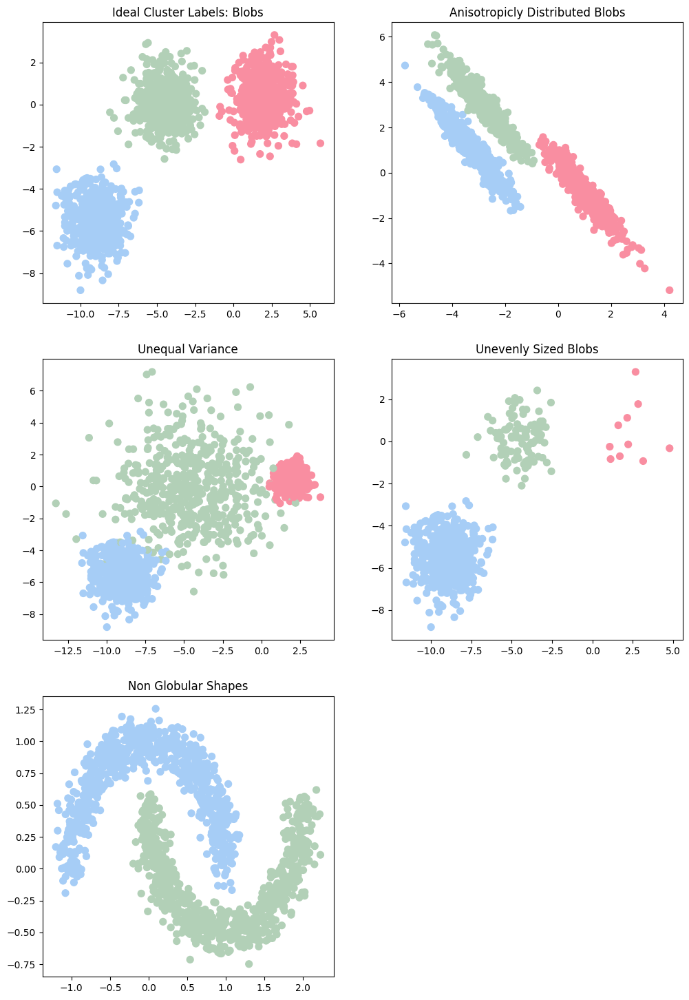

In [11]:
# Define the color palettes
data_colors = ['#a6cdf6','#b2d0b7','#f98ea1']
background_cmap3 = ListedColormap(['#a6cdf6','#b2d0b7','#f98ea1'])

plt.figure(figsize=(12, 18))
n_samples = 1500
random_state = 170

###############################################
# Incorrect number of clusters
# make_blobs generate by default 3 isotropic Gaussian blobs. What if you specify an incorrect number of blobs, like 2?
###############################################
X, y = make_blobs(n_samples=n_samples, random_state=random_state)

plt.subplot(321)
plt.scatter(X[:, 0], X[:, 1], s=50, c=[data_colors[label] for label in y], cmap=background_cmap3)
plt.title("Ideal Cluster Labels: Blobs")

###############################################
# Anisotropicly distributed data
###############################################
transformation = np.array([[0.60834549, -0.63667341], [-0.40887718, 0.85253229]])
X_aniso = np.dot(X, transformation)

plt.subplot(322)
plt.scatter(X_aniso[:, 0], X_aniso[:, 1], s=50, c=[data_colors[label] for label in y], cmap=background_cmap3)
plt.title("Anisotropicly Distributed Blobs")

###############################################
# Different variance
###############################################
X_varied, y_varied = make_blobs(n_samples=n_samples,
                                cluster_std=[1.0, 2.5, 0.5],
                                random_state=random_state)

plt.subplot(323)
plt.scatter(X_varied[:, 0], X_varied[:, 1], s=50, c=[data_colors[label] for label in y_varied], cmap=background_cmap3)
plt.title("Unequal Variance")

###############################################
# Unevenly sized blobs
###############################################
X_filtered = np.vstack((X[y == 0][:500], X[y == 1][:100], X[y == 2][:10]))
y_filtered = np.concatenate((y[y == 0][:500], y[y == 1][:100], y[y == 2][:10]))

plt.subplot(324)
plt.scatter(X_filtered[:, 0], X_filtered[:, 1], s=50, c=[data_colors[label] for label in y_filtered], cmap=background_cmap3)
plt.title("Unevenly Sized Blobs")

###############################################
# Unevenly sized blobs
###############################################
X, y = make_moons(n_samples=1500, random_state=170, noise=0.1)

plt.subplot(325)
plt.scatter(X[:, 0], X[:, 1], s=50, c=[data_colors[l] for l in y], cmap=background_cmap3)
plt.title("Non Globular Shapes")


plt.show()

Text(0.5, 1.0, 'Unevenly Sized Blobs')

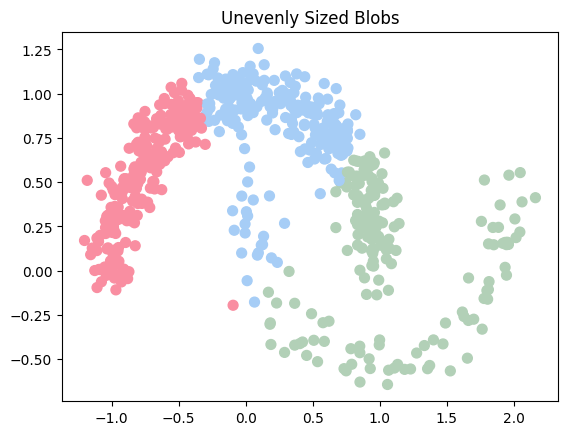

In [12]:
###############################################
# Unevenly sized blobs
###############################################
X_filtered = np.vstack((X[y == 0][:500], X[y == 1][:100], X[y == 2][:10]))
y_filtered = np.concatenate((y[y == 0][:500], y[y == 1][:100], y[y == 2][:10]))


km_labels = KMeans(n_clusters = 3, random_state=42, n_init=10).fit_predict(X_filtered)



plt.scatter(X_filtered[:, 0], X_filtered[:, 1], s=50, c=[data_colors[label] for label in km_labels], cmap=background_cmap3)
plt.title("Unevenly Sized Blobs")


Text(0.5, 1.0, 'Anisotropicly Distributed Blobs')

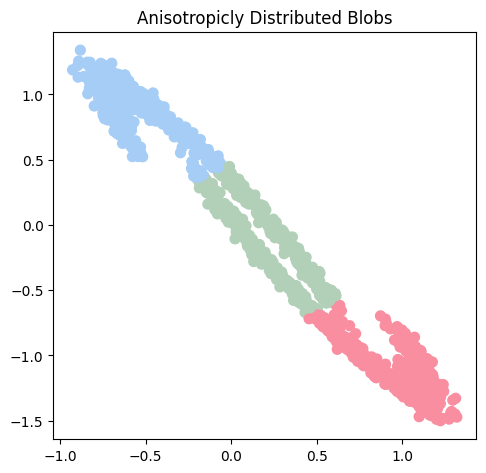

In [13]:
# Define the color palettes
data_colors = ['#a6cdf6','#b2d0b7','#f98ea1']
background_cmap3 = ListedColormap(['#a6cdf6','#b2d0b7','#f98ea1'])

plt.figure(figsize=(12, 18))
n_samples = 1500
random_state = 170

###############################################
# Anisotropicly distributed data
###############################################
transformation = np.array([[0.60834549, -0.63667341], [-0.40887718, 0.85253229]])
X_aniso = np.dot(X, transformation)


km_labels = KMeans(n_clusters = 3, random_state=42, n_init=10).fit_predict(X_aniso)

plt.subplot(322)
plt.scatter(X_aniso[:, 0], X_aniso[:, 1], s=50, c=[data_colors[label] for label in km_labels], cmap=background_cmap3)
plt.title("Anisotropicly Distributed Blobs")


Text(0.5, 1.0, 'Non Globular Shapes')

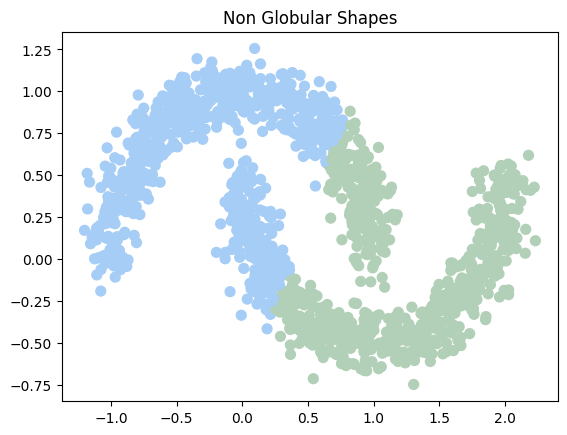

In [14]:
###############################################
# Unevenly sized blobs
###############################################
X, y = make_moons(n_samples=1500, random_state=170, noise=0.1)

km_labels = KMeans(n_clusters = 2, n_init = 10, random_state = 42).fit_predict(X)


plt.scatter(X[:, 0], X[:, 1], s=50, c=[data_colors[l] for l in km_labels], cmap=background_cmap3)
plt.title("Non Globular Shapes")


## Gaussian Mixture Models

## Iterative Simulation

Adapted from https://github.com/Ransaka/GMM-from-scratch

In [15]:
from scipy.stats import multivariate_normal
from scipy.stats import norm

In [16]:
def plot_pdf(mu,sigma,label,alpha=0.5,linestyle='k--',density=True,color='green'):
    """
    Plot 1-D data and its PDF curve.

    Parameters
    ----------
    X : array-like, shape (n_samples,)
        The input data.
    """
    # Compute the mean and standard deviation of the data

    # Plot the data

    X = norm.rvs(mu, sigma, size=1000)

    plt.hist(X, bins=50, density=density, alpha=alpha,label=label,color=color)

    # Plot the PDF
    x = np.linspace(X.min(), X.max(), 1000)
    y = norm.pdf(x, mu, sigma)
    plt.plot(x, y, linestyle)

In [17]:
n_samples = 100
mu1, sigma1 = -5, 1.2
mu2, sigma2 = 5, 1.8
mu3, sigma3 = 0, 1.6

x1 = np.random.normal(loc = mu1, scale = np.sqrt(sigma1), size = n_samples)
x2 = np.random.normal(loc = mu2, scale = np.sqrt(sigma2), size = n_samples)
x3 = np.random.normal(loc = mu3, scale = np.sqrt(sigma3), size = n_samples)

X = np.concatenate((x1,x2,x3))

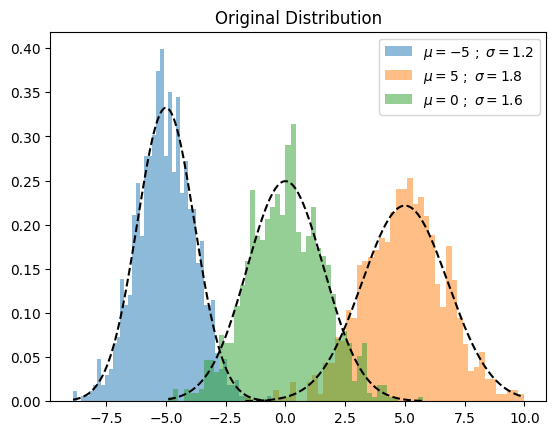

In [18]:
plot_pdf(mu1,sigma1,label=r"$\mu={} \ ; \ \sigma={}$".format(mu1,sigma1),color=None)
plot_pdf(mu2,sigma2,label=r"$\mu={} \ ; \ \sigma={}$".format(mu2,sigma2),color=None)
plot_pdf(mu3,sigma3,label=r"$\mu={} \ ; \ \sigma={}$".format(mu3,sigma3),color=None)
plt.title("Original Distribution")
plt.legend()
plt.show()

Formulas needed for GMM

In [19]:
def random_init(n_components):
    pi = np.ones((n_components)) / n_components
    means = np.random.choice(X, n_components)
    variances = np.random.random_sample(size=n_components)
    plot_pdf(means[0],variances[0],'Random Init 01',)
    plot_pdf(means[1],variances[1],'Random Init 02',color='blue')
    plot_pdf(means[2],variances[2],'Random Init 03',color='orange')

    plt.title("Random Initialization")

    plt.legend()
    plt.show()

    return means,variances,pi

def step_expectation(X,n_components,means,variances):
    weights = np.zeros((n_components,len(X)))
    for j in range(n_components):
        weights[j,:] = norm(loc=means[j],scale=np.sqrt(variances[j])).pdf(X)
    return weights

def step_maximization(X,weights,means,variances,n_compenents,pi):
    r = []
    for j in range(n_compenents):
        r.append((weights[j] * pi[j]) / (np.sum([weights[i] * pi[i] for i in range(n_compenents)], axis=0)))

        means[j] = np.sum(r[j] * X) / (np.sum(r[j]))
        variances[j] = np.sum(r[j] * np.square(X - means[j])) / (np.sum(r[j]))

        pi[j] = np.mean(r[j])

    return variances,means,pi

def plot_intermediate_steps(means,variances,step):

    plot_pdf(mu1,sigma1,alpha=0.0,linestyle='r--',label='Original Distibutions')
    plot_pdf(mu2,sigma2,alpha=0.0,linestyle='r--',label='Original Distibutions')
    plot_pdf(mu3,sigma3,alpha=0.0,linestyle='r--',label='Original Distibutions')

    color_gen = (x for x in ['green','blue','orange'])

    for mu,sigma in zip(means,variances):
        plot_pdf(mu,sigma,alpha=0.5,label='d',color=next(color_gen))
    plt.title(f"step: {step}")
    plt.show()

Implementation

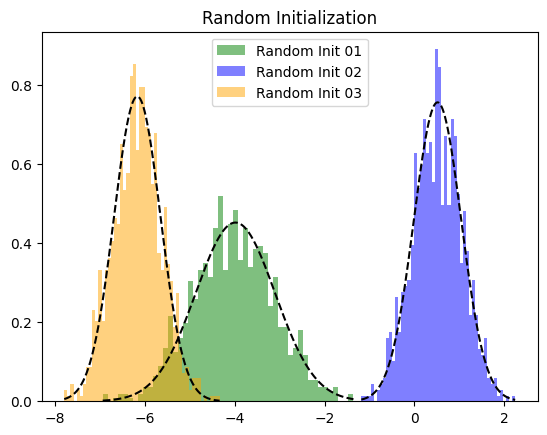

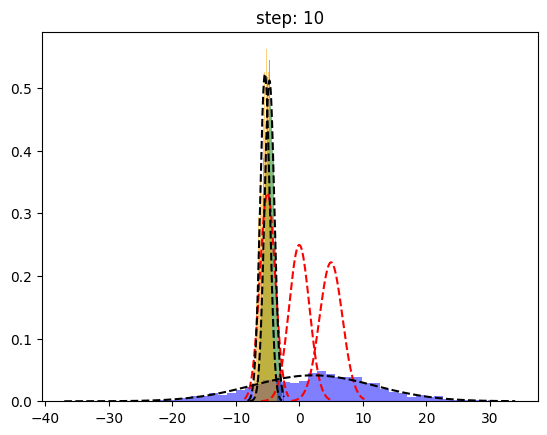

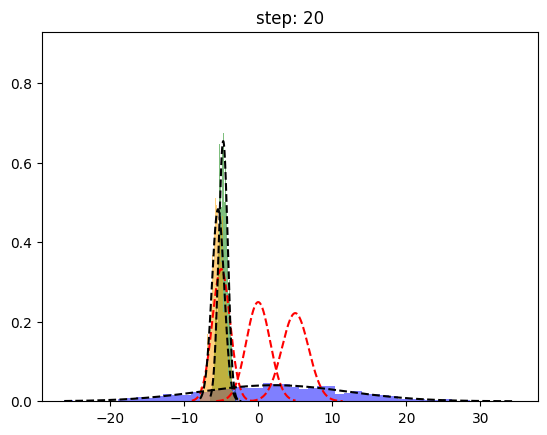

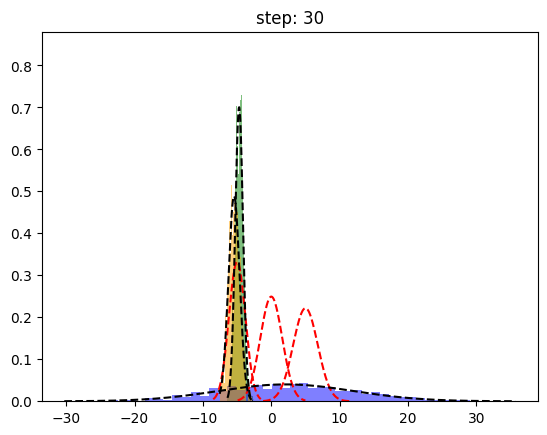

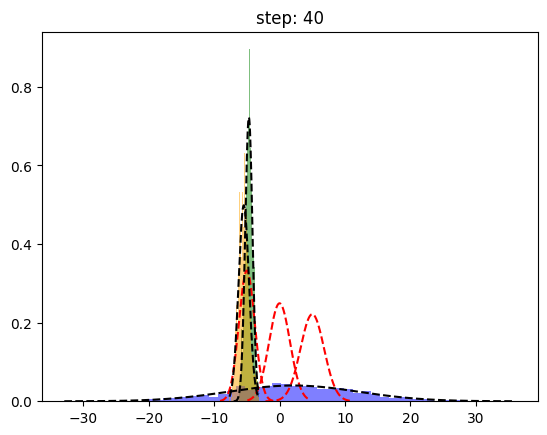

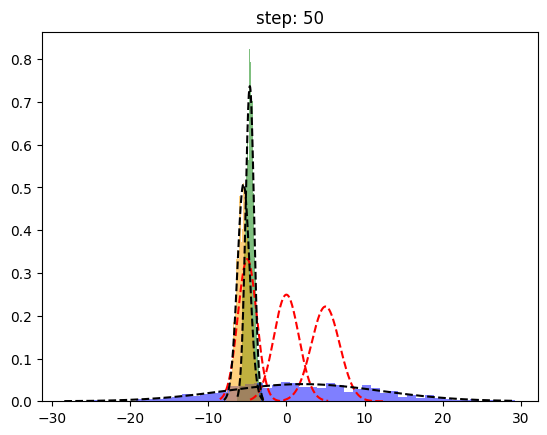

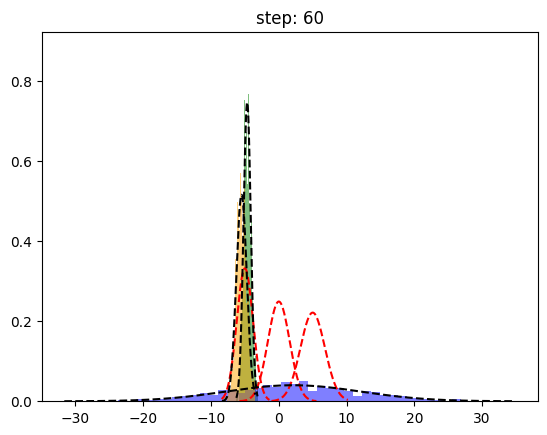

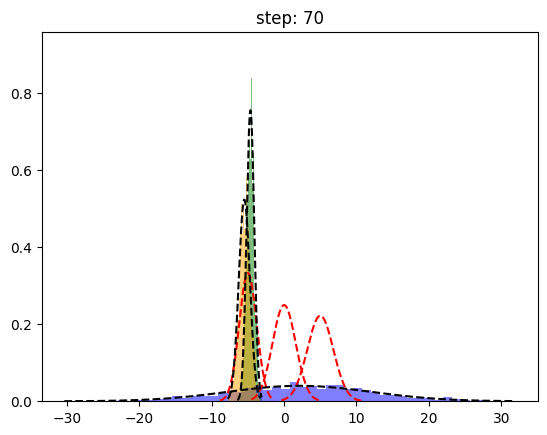

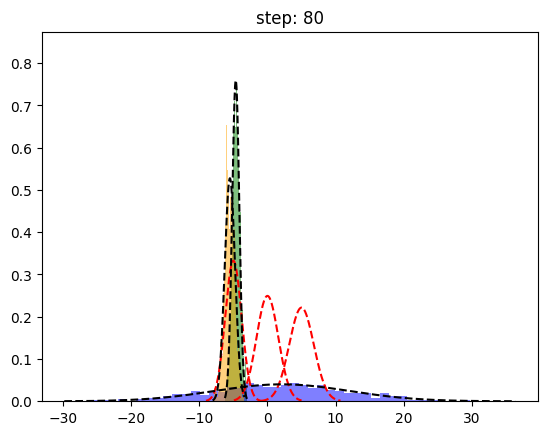

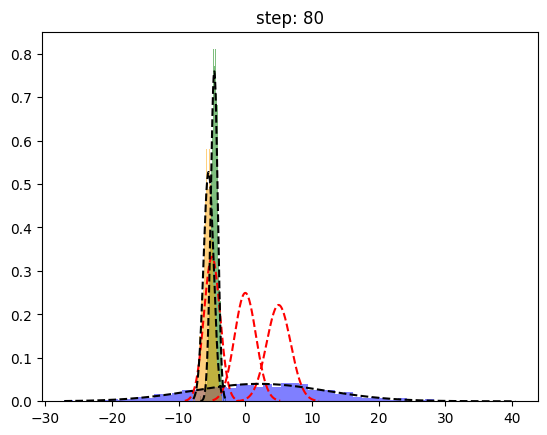

In [20]:
n_components=3
n_steps=80

means,variances,pi = random_init(n_components)

for step in range(1, n_steps+1):
    weights = step_expectation(X,n_components,means,variances)
    variances,means,pi = step_maximization(X, weights, means, variances, n_components, pi)
    if step % 10 == 0:
      plot_intermediate_steps(means,variances,step)
plot_intermediate_steps(means,variances, step)

## Iris

In [21]:
def plot_gmm(X, model, ax, title):
    """Plot GMM clustering results with covariance ellipses."""
    y_prob = model.predict_proba(X)  # Get probabilities
    y_pred = model.predict(X)  # Get hard cluster assignments
    max_prob = y_prob.max(axis=1)  # Take the highest probability per point

    # Normalize alpha between 0 and 1 (probabilities)
    norm = Normalize(vmin=0, vmax=1)
    alpha_values = norm(max_prob)  # Normalize alpha

    # Dynamically generate cluster colors
    num_clusters = model.n_components
    cluster_cmap = cm.get_cmap('tab10', num_clusters)  # Ensure unique colors
    colors = np.array([cluster_cmap(i) for i in y_pred])  # Assign colors based on cluster
    colors[:, -1] = alpha_values  # Set alpha transparency in RGBA

    # Scatter plot
    ax.scatter(X[:, 0], X[:, 1], s=50, color=colors)
    ax.scatter(model.means_[:, 0], model.means_[:, 1], marker='*', s=200, c='black', edgecolors='white', linewidth=2)

    # Plot covariance ellipses
    for i, (mean, cov) in enumerate(zip(model.means_, model.covariances_)):
        plot_covariance_ellipse(ax, mean, cov, 'black')

    ax.set_title(title)

    return ax

def plot_covariance_ellipse(ax, mean, cov, color):
    """Plot a Gaussian covariance ellipse."""
    if cov.shape == (2, 2):  # Full covariance
        U, S, Vt = np.linalg.svd(cov)
        angle = np.degrees(np.arctan2(U[1, 0], U[0, 0]))
        width, height = 2 * np.sqrt(S)  # 2 standard deviations
    else:  # Diagonal covariance
        angle = 0
        width, height = 2 * np.sqrt(cov)

    ellipse = Ellipse(mean, width, height, angle=angle, edgecolor=color, facecolor='none', linestyle='--', linewidth=2)
    ax.add_patch(ellipse)

In [22]:
iris_data = load_iris()
iris4 = pd.DataFrame(iris_data.data, columns=iris_data.feature_names)
species_name = iris_data.target
iris = iris4.copy()

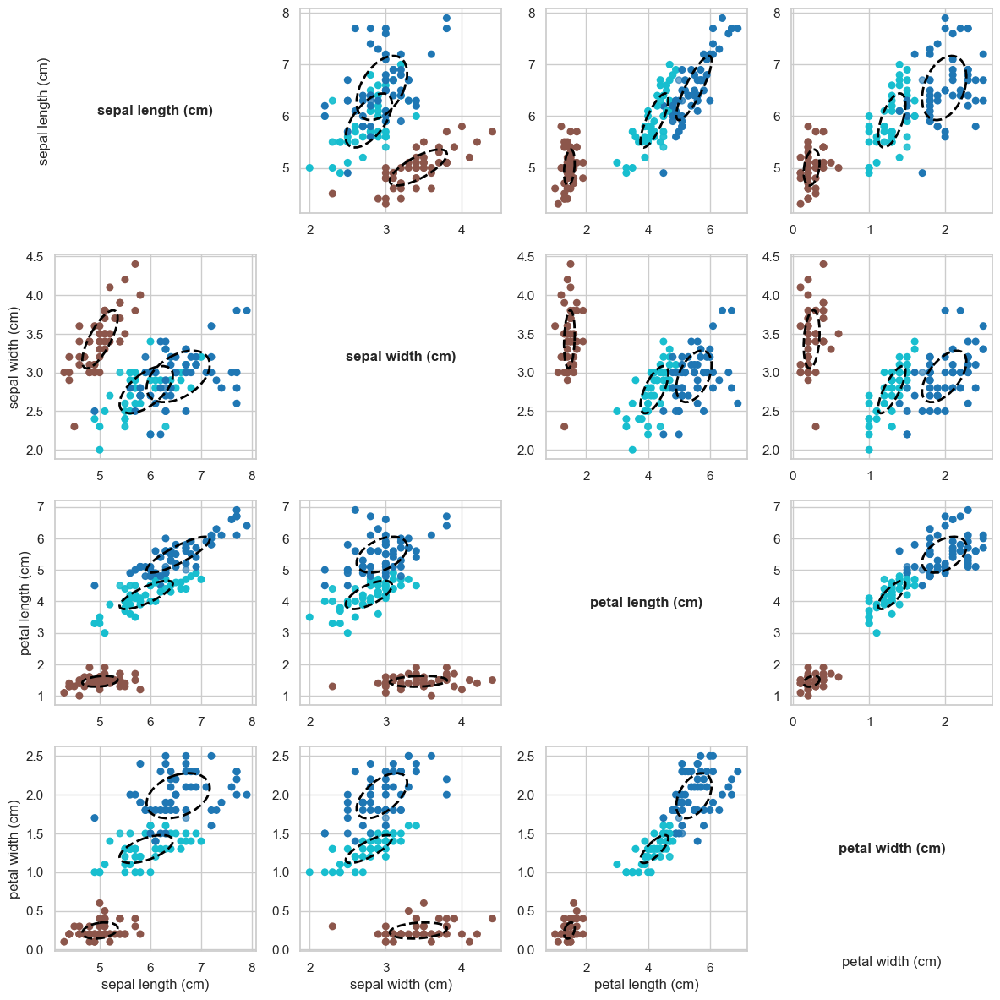

In [23]:
# Fit GMM with 3 clusters (since we know Iris has 3 species)
gmm = GaussianMixture(n_components=3, covariance_type='full', random_state=42)
gmm.fit(iris)

# Predict cluster assignments and probabilities
clusters = gmm.predict(iris)
probabilities = gmm.predict_proba(iris)

# Create pairwise scatter plots
sns.set(style="whitegrid");
fig, axes = plt.subplots(4, 4, figsize=(12, 12));
features = iris.columns
num_features = len(features)
cmap = cm.get_cmap('tab10', 3);

# Loop through feature pairs
for i in range(num_features):
    for j in range(num_features):
        ax = axes[i, j]

        # Diagonal: Show feature names
        if i == j:
            ax.text(0.5, 0.5, features[i], ha='center', va='center', fontsize=12, fontweight='bold')
            ax.set_xticks([])
            ax.set_yticks([])
            ax.set_frame_on(False)
        else:
            # Scatter plot
            norm = Normalize(vmin=0, vmax=1)
            colors = np.array([cmap(k) for k in clusters])  # Assign colors based on cluster
            colors[:, -1] = norm(probabilities.max(axis=1))  # Adjust transparency by probability

            ax.scatter(iris.iloc[:, j], iris.iloc[:, i], s=30, color=colors)

            # Plot covariance ellipses
            for k in range(gmm.n_components):
                mean = gmm.means_[k][[j, i]]  # Select only relevant dimensions
                cov = gmm.covariances_[k][np.ix_([j, i], [j, i])]  # Extract 2x2 covariance matrix
                plot_covariance_ellipse(ax, mean, cov, color='black')

        # Set labels
        if i == num_features - 1:
            ax.set_xlabel(features[j])
        if j == 0:
            ax.set_ylabel(features[i])

plt.tight_layout()
plt.show()

## Comparison with k-means

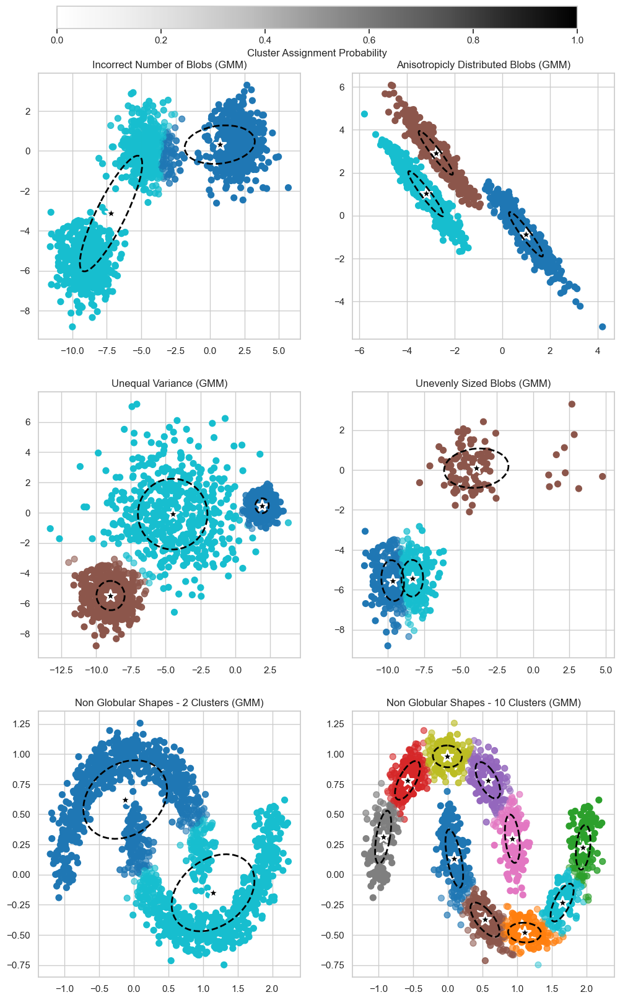

In [24]:
fig, axes = plt.subplots(3, 2, figsize=(12, 18))  # 3x2 Grid
fig.subplots_adjust(top=0.92)  # Adjust top spacing for color bar

n_samples = 1500
random_state = 170

###############################################
# Incorrect number of clusters
###############################################
X, y = make_blobs(n_samples=n_samples, random_state=random_state)
model = GaussianMixture(n_components=2, covariance_type='full', random_state=random_state).fit(X)
plot_gmm(X, model, axes[0, 0], "Incorrect Number of Blobs (GMM)")

###############################################
# Anisotropicly distributed data
###############################################
transformation = [[0.60834549, -0.63667341], [-0.40887718, 0.85253229]]
X_aniso = np.dot(X, transformation)
model = GaussianMixture(n_components=3, covariance_type='full', random_state=random_state).fit(X_aniso)
plot_gmm(X_aniso, model, axes[0, 1], "Anisotropicly Distributed Blobs (GMM)")

###############################################
# Different variance
###############################################
X_varied, y_varied = make_blobs(n_samples=n_samples,
                                cluster_std=[1.0, 2.5, 0.5],
                                random_state=random_state)
model = GaussianMixture(n_components=3, covariance_type='full', random_state=random_state).fit(X_varied)
plot_gmm(X_varied, model, axes[1, 0], "Unequal Variance (GMM)")

###############################################
# Unevenly sized blobs
###############################################
X_filtered = np.vstack((X[y == 0][:500], X[y == 1][:100], X[y == 2][:10]))
model = GaussianMixture(n_components=3, covariance_type='full', random_state=random_state).fit(X_filtered)
plot_gmm(X_filtered, model, axes[1, 1], "Unevenly Sized Blobs (GMM)")

###############################################
# Non Globular Shapes
###############################################
X, y = make_moons(n_samples=1500, random_state=170, noise=0.1)

model = GaussianMixture(n_components=2, covariance_type='full', random_state=random_state).fit(X)
plot_gmm(X, model, axes[2, 0], "Non Globular Shapes - 2 Clusters (GMM)")

model = GaussianMixture(n_components=10, covariance_type='full', random_state=random_state).fit(X)
plot_gmm(X, model, axes[2, 1], "Non Globular Shapes - 10 Clusters (GMM)")

# Add the colorbar at the top
cax = fig.add_axes([0.15, 0.96, 0.7, 0.02])  # [left, bottom, width, height]
fig.colorbar(cm.ScalarMappable(norm=Normalize(0, 1), cmap='Greys'), cax=cax, orientation='horizontal', label="Cluster Assignment Probability")

plt.show()


## Adjusted Rand Index (ARI)

The Adjusted Rand Index (ARI) measures the similarity between two clusterings while correcting for random chance. It is defined as:

$$
\text{ARI} = \frac{\sum_{ij} \binom{n_{ij}}{2} - \left[ \sum_i \binom{a_i}{2} \sum_j \binom{b_j}{2} \right] / \binom{n}{2}}{\frac{1}{2} \left[ \sum_i \binom{a_i}{2} + \sum_j \binom{b_j}{2} \right] - \left[ \sum_i \binom{a_i}{2} \sum_j \binom{b_j}{2} \right] / \binom{n}{2}}
$$

where:
- $ n_{ij} $ is the number of elements in both cluster $ i $ in the ground truth and cluster $ j $ in the predicted clustering.
- $ a_i $ is the sum of elements in row $ i $ (total points in true cluster $ i $).
- $ b_j $ is the sum of elements in column $ j $ (total points in predicted cluster $ j $).
- $ n $ is the total number of elements.
- $ \binom{n}{2} $ represents the binomial coefficient, which counts the number of ways to choose 2 elements from $ n $.

1. If the clustering perfectly matches the ground truth, $ \text{ARI} = 1 $.
2. If the clustering is random, $ \text{ARI} \approx 0 $.
3. If clustering is worse than random, $ \text{ARI} < 0 $ (rare).



In [25]:
from sklearn.metrics import adjusted_rand_score

# Load the Iris dataset
iris = load_iris()
X_iris = iris.data
true_labels_iris = iris.target  # Ground truth labels (Setosa, Versicolor, Virginica)

# Apply K-Means clustering
kmeans_iris = KMeans(n_clusters=3, random_state=42)
predicted_labels_kmeans = kmeans_iris.fit_predict(X_iris)

# Apply Gaussian Mixture Model (GMM) clustering
gmm_iris = GaussianMixture(n_components=3, random_state=42)
predicted_labels_gmm = gmm_iris.fit_predict(X_iris)

# Compute Adjusted Rand Index (ARI) for both methods
ari_kmeans = adjusted_rand_score(true_labels_iris, predicted_labels_kmeans)
ari_gmm = adjusted_rand_score(true_labels_iris, predicted_labels_gmm)

# Display ARI comparison
ari_comparison = pd.DataFrame({
    "Clustering Method": ["K-Means", "Gaussian Mixture Model (GMM)"],
    "ARI Score": [ari_kmeans, ari_gmm]
})

ari_comparison

,Clustering Method,ARI Score
0,K-Means,0.716342
1,Gaussian Mixture Model (GMM),0.903874


**<font size="5">Applied Statistics</font>**

<font size="3">MSc in High Performance Computing Engineering, Computer Science and Engineering, Physics Engineering - A.Y. 2024-2025</font>

Prof. Mario Beraha - Dott. Vittorio Torri

---

<font size="4">**Lab 5 - Linear and Quadratic Discriminant Analysis, K-nearest neighbours**</font>

# LAB 5

## Libraries

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

from scipy.stats import shapiro, bartlett, f_oneway, norm
from scipy.stats import multivariate_normal

from sklearn.discriminant_analysis import LinearDiscriminantAnalysis, QuadraticDiscriminantAnalysis

from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

from sklearn.metrics import confusion_matrix

## Linear Discriminant Analysis

### Univariate

Interferon-gamma (IFN-gamma) and interleukin-5 (IL-5) are multifunctional cytokines that regulate immune responses, cell proliferation, and tumour development and progression, which frequently have functionally opposing roles.

Idea: we aim to find a "rule" to classify patients as Group A (the treatment has effect) or Group B (the treatment has no effect)  given the measurements of Inf-g (Interferon gamma) and IL-5 (Interleukin 5).
For this example, we discard the IL-5 variable (which seems to have poor
"discriminative power") and we consider the univariate case with Inf-g only.

### Load and check data

In [3]:
cyto = pd.read_csv("../DatasetsLabs/cytokines.txt", sep=" ")

print(cyto)

# We separate groups A and B:
A_idx = cyto.index[ cyto["group"] == 'A' ]
B_idx = cyto.index[ cyto["group"] == 'B' ]

Infg = cyto["Infg"].values
IL5  = cyto["IL5"].values
groups = cyto["group"].values


         Infg        IL5 group
0   15.000000  12.312595     A
1   23.698101  18.422812     A
2    8.781799   8.501765     A
3   32.211799  -1.371131     A
4   30.838288   7.496666     A
5   12.876335 -15.159156     A
6   12.526771  17.187205     A
7   24.043710  39.919920     A
8   -8.502941   7.099296     B
9    9.176056  -5.047772     B
10   4.857983   5.138093     B
11   2.649528   7.007139     B
12   3.605551  -9.859006     B


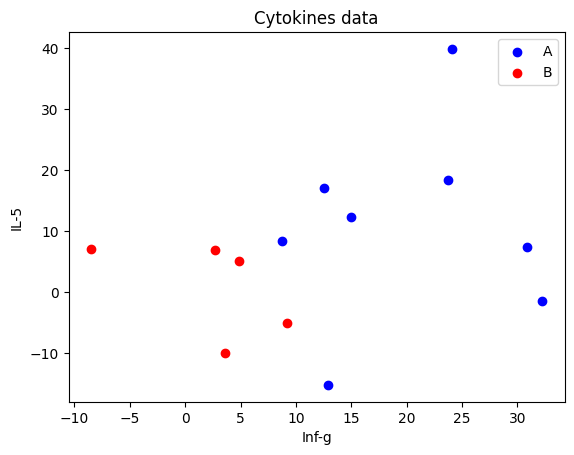

In [4]:
plt.figure()
# Blue for A, Red for B
plt.scatter(Infg[A_idx], IL5[A_idx], color='blue', label='A', marker='o')
plt.scatter(Infg[B_idx], IL5[B_idx], color='red',  label='B', marker='o')
plt.xlabel("Inf-g")
plt.ylabel("IL-5")
plt.legend()
plt.title("Cytokines data")
plt.show()


In [5]:
# Shapiro test for normality of A and B
stat_A, pval_A = shapiro(Infg[A_idx])
stat_B, pval_B = shapiro(Infg[B_idx])
print("Shapiro test group A:", stat_A, pval_A)
print("Shapiro test group B:", stat_B, pval_B)

# Bartlett test for equality of variance
bart_stat, bart_pval = bartlett(Infg[A_idx], Infg[B_idx])
print("Bartlett test: statistic =", bart_stat, "p-value =", bart_pval)

Shapiro test group A: 0.9068374410530935 0.33233011230371007
Shapiro test group B: 0.8754737847978038 0.2893012186768233
Bartlett test: statistic = 0.39982188279368674 p-value = 0.5271812583306359


### Manual implementation of LDA

In [6]:
nA = len(A_idx)
nB = len(B_idx)
n  = nA + nB

PA = nA / n
PB = nB / n

MA = np.mean(Infg[A_idx])
MB = np.mean(Infg[B_idx])

SA = np.var(Infg[A_idx], ddof=1)
SB = np.var(Infg[B_idx], ddof=1)

# Pooled variance estimate
S  = ((nA - 1) * SA + (nB - 1) * SB) / (n - 2)

print(f"Means: M_A={MA:.3f}, M_B={MB:.3f}")
print(f"Pooled var: S={S:.3f}")
print(f"Group prior probabilities: P(A)={PA}, P(B)={PB}")

Means: M_A=19.997, M_B=2.357
Pooled var: S=66.037
Group prior probabilities: P(A)=0.6153846153846154, P(B)=0.38461538461538464


$$ P(y_i|X) = \frac{P(X|y_i)P(y_i)}{P(X)} = \frac{P(X|y_i)P(y_i)}{\sum_{j}P(X|y_j)P(y_j)}$$

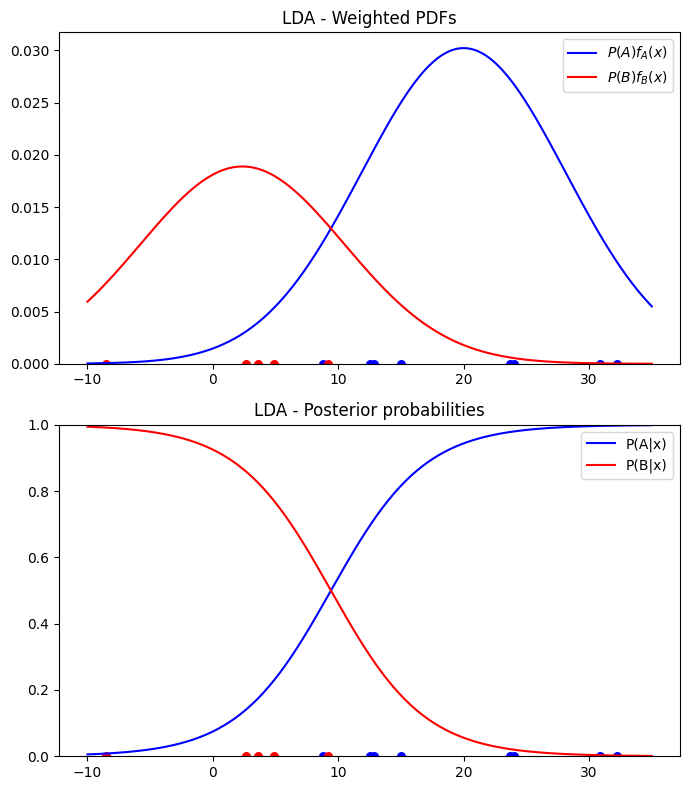

In [7]:
xgrid = np.linspace(-10, 35, 200)

# pdf for group A
pdfA = norm.pdf(xgrid, loc=MA, scale=np.sqrt(S))
# pdf for group B
pdfB = norm.pdf(xgrid, loc=MB, scale=np.sqrt(S))

plt.figure(figsize=(7,8))

# Top plot: PA * fA(x) and PB * fB(x)
plt.subplot(2,1,1)
plt.plot(xgrid, PA*pdfA, color='blue', label=r'$P(A)f_A(x)$')
plt.plot(xgrid, PB*pdfB, color='red',  label=r'$P(B)f_B(x)$')
plt.scatter(Infg[A_idx], np.zeros(nA), color='blue', s=30)
plt.scatter(Infg[B_idx], np.zeros(nB), color='red',  s=30)
plt.ylim(0, None)
plt.title("LDA - Weighted PDFs")
plt.legend()

# Bottom plot: Posterior probabilities
postA = PA*pdfA / (PA*pdfA + PB*pdfB)
postB = PB*pdfB / (PA*pdfA + PB*pdfB)

plt.subplot(2,1,2)
plt.plot(xgrid, postA, color='blue', label='P(A|x)')
plt.plot(xgrid, postB, color='red',  label='P(B|x)')
plt.scatter(Infg[A_idx], np.zeros(nA), color='blue', s=30)
plt.scatter(Infg[B_idx], np.zeros(nB), color='red',  s=30)
plt.ylim(0,1)
plt.title("LDA - Posterior probabilities")
plt.legend()
plt.tight_layout()
plt.show()


### LDA via scikit-learn

Posterior at x=0: [0.07476761 0.92523239]
Class assigned at x=0: ['B']


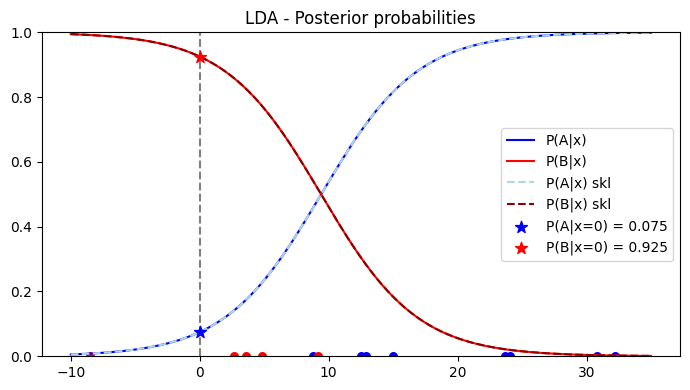

In [8]:
X = Infg.reshape(-1, 1)
y = groups

lda = LinearDiscriminantAnalysis()
lda.fit(X, y)

# Posterior probability for x=0:
x0_val = 0.0
posterior0 = lda.predict_proba([[x0_val]])[0]
postA_x0, postB_x0 = posterior0  # two classes (A, B)
print("Posterior at x=0:", posterior0)
print("Class assigned at x=0:", lda.predict([[x0_val]]))

# Posterior for a grid of x
xgrid = np.linspace(-10, 35, 200).reshape(-1, 1)
post_grid = lda.predict_proba(xgrid)  # columns: prob of A, prob of B
postA_skl = post_grid[:,0]
postB_skl = post_grid[:,1]

plt.figure(figsize=(7,4))
plt.plot(xgrid, postA, color='blue', label='P(A|x)')
plt.plot(xgrid, postB, color='red',  label='P(B|x)')
plt.plot(xgrid, postA_skl, '--', color='lightblue', label='P(A|x) skl')
plt.plot(xgrid, postB_skl, '--', color='darkred',  label='P(B|x) skl')
plt.scatter(Infg[A_idx], np.zeros(nA), color='blue', s=30)
plt.scatter(Infg[B_idx], np.zeros(nB), color='red',  s=30)
# Highlight the value at x=0:
plt.axvline(x=x0_val, color='gray', linestyle='--')
# 2. Markers for the two posterior values at x=0
plt.scatter([x0_val], [postA_x0], s=80, color='blue',  marker='*', zorder=5,
            label='P(A|x=0) = {:.3f}'.format(postA_x0))
plt.scatter([x0_val], [postB_x0], s=80, color='red',   marker='*', zorder=5,
            label='P(B|x=0) = {:.3f}'.format(postB_x0))
plt.ylim(0,1)
plt.title("LDA - Posterior probabilities")
plt.legend()
plt.tight_layout()
plt.show()

Explicitly set the priors

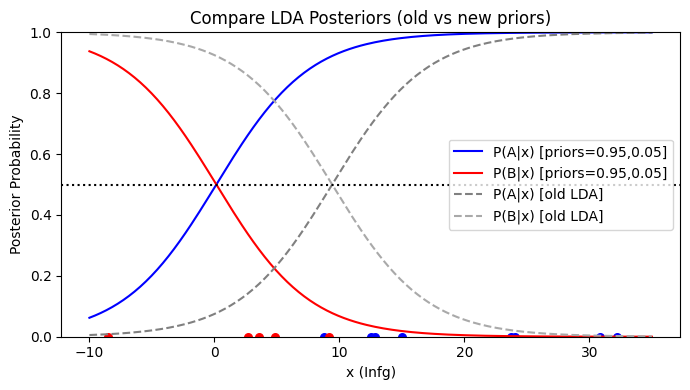

In [9]:
lda_1 = LinearDiscriminantAnalysis(priors=[0.95, 0.05])
lda_1.fit(X, y)

# Posterior on the same grid:
post_grid_1 = lda_1.predict_proba(xgrid)
postA_1 = post_grid_1[:, 0]
postB_1 = post_grid_1[:, 1]

plt.figure(figsize=(7, 4))

plt.plot(xgrid, postA_1, color='blue', label='P(A|x) [priors=0.95,0.05]')
plt.plot(xgrid, postB_1, color='red',  label='P(B|x) [priors=0.95,0.05]')

plt.plot(xgrid, postA_skl, '--', color='gray', label='P(A|x) [old LDA]')
plt.plot(xgrid, postB_skl, '--', color='darkgray', label='P(B|x) [old LDA]')

# Add horizontal line at 0.5
plt.axhline(y=0.5, color='black', linestyle=':')

# Add the points on x-axis for groups A and B
plt.scatter(Infg[A_idx], np.zeros(len(A_idx)), color='blue',  s=30)
plt.scatter(Infg[B_idx], np.zeros(len(B_idx)), color='red',   s=30)

plt.ylim(0, 1)
plt.xlabel("x (Infg)")
plt.ylabel("Posterior Probability")
plt.title("Compare LDA Posteriors (old vs new priors)")
plt.legend()
plt.tight_layout()
plt.show()

### Multivariate

### Iris

Considering only the first two variables of the iris datasets (Sepal Length and Sepal Width)

p = 2 # num variables

g = 3 # num groups

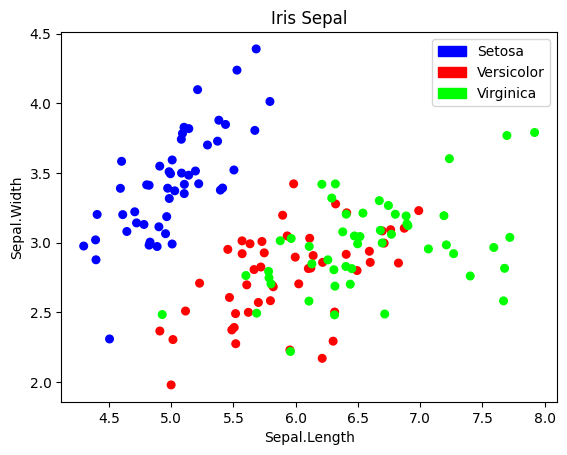

In [10]:
from sklearn.datasets import load_iris
import matplotlib.patches as mpatches

iris_data = load_iris()
X_iris = iris_data.data[:, :2]  # only Sepal.Length, Sepal.Width
y_iris = iris_data.target       # 0, 1, 2 for setosa, versicolor, virginica
species_names = iris_data.target_names

# We'll add small jitter
rng = np.random.RandomState(1)
X_iris = X_iris + rng.normal(scale=0.025, size=X_iris.shape)

plt.figure()
plt.scatter(X_iris[:,0], X_iris[:,1], c=y_iris, cmap='brg', s=30)

handles = [
    mpatches.Patch(color=plt.get_cmap("brg",3)(0), label='Setosa'),
    mpatches.Patch(color=plt.get_cmap("brg",3)(1), label='Versicolor'),
    mpatches.Patch(color=plt.get_cmap("brg",3)(2), label='Virginica')
]
plt.legend(handles=handles, loc='upper right')

plt.title("Iris Sepal")
plt.xlabel("Sepal.Length")
plt.ylabel("Sepal.Width")
plt.show()

In [11]:
lda_iris = LinearDiscriminantAnalysis()
lda_iris.fit(X_iris, y_iris)

print("Coefficients of linear discriminants:\n", lda_iris.coef_)
print("Intercepts:\n", lda_iris.intercept_)

Coefficients of linear discriminants:
 [[-5.94780454  7.87961702]
 [ 1.72106802 -3.82726215]
 [ 4.22673652 -4.05235487]]
Intercepts:
 [  5.63227073  -0.09185336 -15.14199104]


In [12]:
y_pred = lda_iris.predict(X_iris)
conf_mat = confusion_matrix(y_iris, y_pred)
print(conf_mat)

[[49  1  0]
 [ 0 35 15]
 [ 0 15 35]]


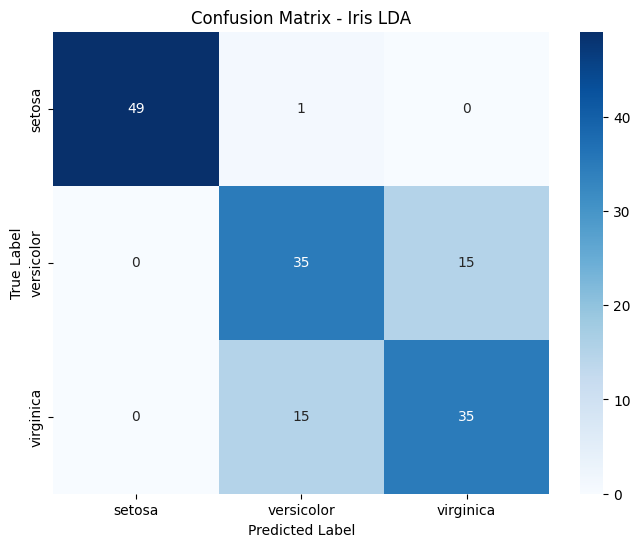

In [14]:
plt.figure(figsize=(8, 6))
sns.heatmap(conf_mat, annot=True, fmt="d", cmap="Blues",
            xticklabels=species_names, yticklabels=species_names)
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.title("Confusion Matrix - Iris LDA")
plt.show()


In [15]:
# APER (apparent error rate - proportion of misclassified samples)
# NB: this formula is correct if the proportions are estimated via empirical frequencies
# Otherwise it is sum of P(error|group g) * P(group g) = sum{ # errors_for_group_g * prior_prob[g]}
n_samples = len(y_iris)
misclassified = (y_pred != y_iris).sum()
APER = misclassified / n_samples
print("APER =", APER)

APER = 0.20666666666666667


In [16]:
from sklearn.metrics import accuracy_score

accuracy = accuracy_score(y_iris, y_pred)
print("Accuracy:", accuracy)


Accuracy: 0.7933333333333333


Let's plot the decision boundary identified by LDA

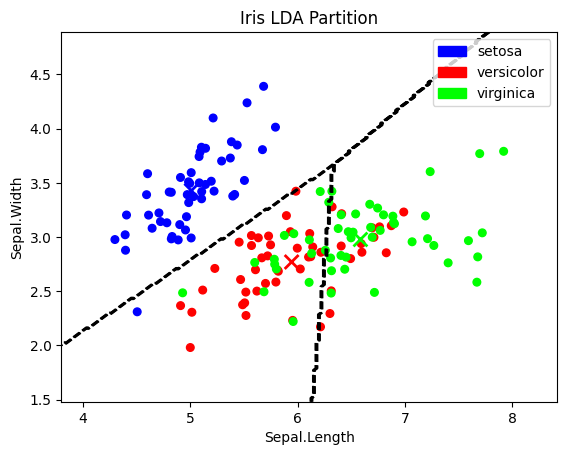

In [17]:
def plot_lda_partition(model, X, y, class_labels=None, title="LDA Partition", xtitle="Sepal.Length", ytitle="Sepal.Width"):
  x_min, x_max = X[:, 0].min() - 0.5, X[:, 0].max() + 0.5
  y_min, y_max = X[:, 1].min() - 0.5, X[:, 1].max() + 0.5
  xx, yy = np.meshgrid(np.linspace(x_min, x_max, 200),
                        np.linspace(y_min, y_max, 200))
  grid_points = np.c_[xx.ravel(), yy.ravel()]

  unique_classes = np.unique(y)
  n_classes = len(unique_classes)
  cmap = plt.get_cmap("brg", n_classes)

  class_pred = model.predict(grid_points)

  plt.figure()
  plt.scatter(X[:,0], X[:,1], c=y, cmap='brg', s=30)
  plt.title("Iris LDA Partition")
  # Now let's draw boundaries where the predicted class changes:
  class_pred_matrix = class_pred.reshape(xx.shape)
  # We'll plot the contour lines between classes:
  # e.g., any place that transitions from class i to j is a boundary.
  plt.contour(xx, yy, class_pred_matrix,
              colors='k', linestyles='--')

  # Mark class means (model.means_ shape: [n_classes, n_features])
  means = model.means_
  plt.scatter(means[:,0], means[:,1], marker='x',
              c=range(len(means)), cmap='brg', s=100, linewidths=2)

  if class_labels is None:
      class_labels = [f"Class {cls}" for cls in unique_classes]  # Default labels if not provided

  handles = [mpatches.Patch(color=cmap(i), label=class_labels[i]) for i in range(n_classes)]
  plt.legend(handles=handles, loc='upper right')

  plt.xlabel(xtitle)
  plt.ylabel(ytitle)
  plt.show()

plot_lda_partition(lda_iris, X_iris, y_iris, class_labels=species_names, title="Iris LDA Partition")


## Quadratic Discriminant Analysis

### Iris

In [ ]:
# fit a Quadratic Discriminant Analysis model from scikit learn, compute the APER and the confusion matrix

In [18]:
qda_iris = QuadraticDiscriminantAnalysis()
qda_iris.fit(X_iris, y_iris)

,priors,None
,reg_param,0.0
,store_covariance,False
,tol,0.0001


In [19]:
y_pred_qda = qda_iris.predict(X_iris)
conf_mat_qda = pd.crosstab(pd.Series(y_iris, name='True'),
                           pd.Series(y_pred_qda, name='Predicted'))
print(conf_mat_qda)

APER_q = (y_pred_qda != y_iris).sum() / len(y_iris)
print("APER QDA =", APER_q)

Predicted   0   1   2
True                 
0          49   1   0
1           0  37  13
2           0  16  34
APER QDA = 0.2


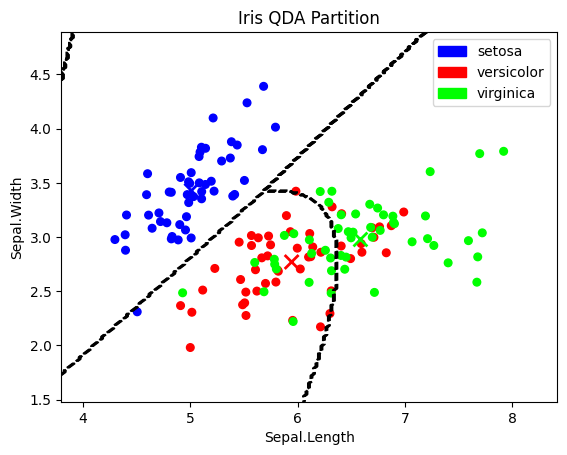

In [20]:
def plot_qda_partition(model, X, y, class_labels=None, title="QDA Partition", cmap=None, xtitle="Sepal.Length", ytitle="Sepal.Width"):
    x_min, x_max = X[:, 0].min() - 0.5, X[:, 0].max() + 0.5
    y_min, y_max = X[:, 1].min() - 0.5, X[:, 1].max() + 0.5
    xx, yy = np.meshgrid(np.linspace(x_min, x_max, 200),
                         np.linspace(y_min, y_max, 200))
    grid_points = np.c_[xx.ravel(), yy.ravel()]

    class_pred = model.predict(grid_points)
    if isinstance(class_pred[0], str):
      class_pred = np.array([np.where(class_labels == i) for i in class_pred])
    class_pred_matrix = class_pred.reshape(xx.shape)

    unique_classes = np.unique(y)
    n_classes = len(unique_classes)

    cmap = plt.get_cmap("brg", n_classes)

    plt.figure()
    plt.scatter(X[:,0], X[:,1], c=y, cmap=cmap, s=30)
    plt.title(title)
    plt.contour(xx, yy, class_pred_matrix,
                colors='k', linestyles='--')

    # Mark class means
    means = model.means_
    plt.scatter(means[:,0], means[:,1], marker='x',
                c=range(len(means)), cmap=cmap, s=100, linewidths=2)

    if class_labels is None:
        class_labels = [f"Class {cls}" for cls in unique_classes]  # Default labels if not provided

    handles = [mpatches.Patch(color=cmap(i), label=class_labels[i]) for i in range(n_classes)]
    plt.legend(handles=handles, loc='upper right')

    plt.xlabel(xtitle)
    plt.ylabel(ytitle)
    plt.show()

plot_qda_partition(qda_iris, X_iris, y_iris, class_labels=species_names, title="Iris QDA Partition")


## Cost-sensitive classification (Banknotes example)

The vending machines of the Exxon fuel contain optical detectors able
to measure the size of the banknotes inserted. Knowing that 0.1% of the
10\$ banknotes in circulation are counterfeit, Exxon would like to implement a
software to identify false 10$ banknotes, as to minimize the economic losses.
Assuming that:
  - both the populations of real and false banknotes follow a normal distribution (with different mean and covariance matrices);
  
  - accepting a false banknote leads to an economic loss of 10$;

  - rejecting a true banknote brings a economic loss quantifiable in 5 cents;

 satisfy the following requests of the Exxon:

 a) build an appropriate classifier, estimating the unknown parameters starting from the two datasets moneytrue.txt and moneyfalse.txt, containing data about 100 true banknotes and 100 counterfeit banknotes (in mm). Qualitatively show the two classification regions in a graph;

 b) calculate the APER of the classifier and, based on the APER, estimate the expected economic damage of the classifier;

 c) what is the estimated probability that the first 10$ banknote inserted in the machine is rejected?

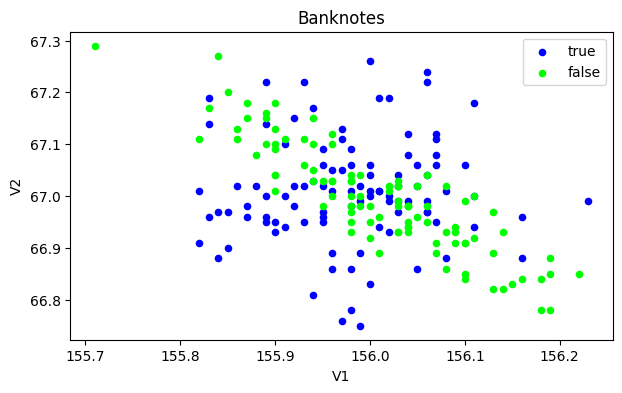

In [22]:
true_df  = pd.read_table("../DatasetsLabs/moneytrue.txt", sep=" ")   # columns e.g. V1, V2
false_df = pd.read_table("../DatasetsLabs/moneyfalse.txt", sep=" ")  # columns e.g. V1, V2

true_data  = true_df[["V1","V2"]].values
false_data = false_df[["V1","V2"]].values

banknotes = np.vstack([true_data, false_data])
vf = np.array(["true"]*len(true_data) + ["false"]*len(false_data), dtype=object)

plt.figure(figsize=(7,4))
plt.scatter(true_data[:,0],  true_data[:,1], color=(0.0, 0.0, 1.0, 1.0),  label='true', s=20)
plt.scatter(false_data[:,0], false_data[:,1], color=(0.0, 1.0, 0.0, 1.0), label='false', s=20)
plt.xlabel("V1")
plt.ylabel("V2")
plt.title("Banknotes")
plt.legend()
plt.show()

Priori probabilities determine the importance of a class. If misclassifying False as True is very costly, we need to increase the prior probability of False:

$$
\pi_{False}' = \frac{c_{TF}\cdot\pi_{False}}{c_{TF}\cdot\pi_{False} + c_{FT}\cdot\pi_{True}}
$$

 a) build an appropriate classifier, estimating the unknown parameters starting from the two datasets moneytrue.txt and moneyfalse.txt, containing data about 100 true banknotes and 100 counterfeit banknotes (in mm). Qualitatively show the two classification regions in a graph;

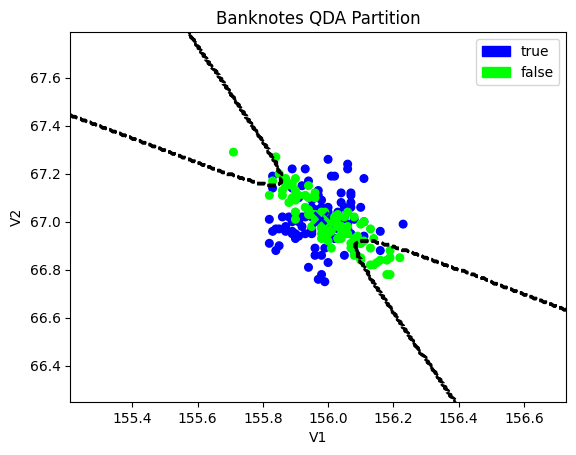

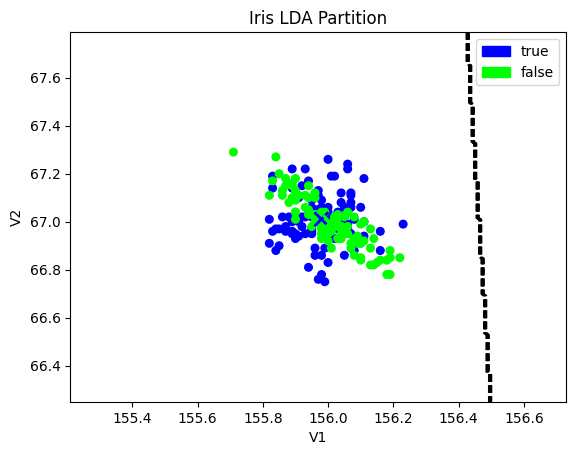

In [23]:
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import StandardScaler

c_tf = 10    # cost of accepting a false banknote
c_ft = 0.05  # cost of rejecting a true banknote
pf   = 0.001
pt   = 1 - pf

# Adjusted priors:
den = c_tf*pf + c_ft*pt # normalization factor to keep them sum to 1
p_true_c = pt*c_ft / den
p_false_c = pf*c_tf / den
prior_c = [p_true_c, p_false_c]

desired_order = ["true", "false"]  # the order MUST be consisted with the order of the priors!
y_encoded = np.array([desired_order.index(label) for label in vf])

qda_bank = QuadraticDiscriminantAnalysis(priors=prior_c)
qda_bank.fit(banknotes, y_encoded)

lda_bank = LinearDiscriminantAnalysis(priors=prior_c)
lda_bank.fit(banknotes, y_encoded)


plot_qda_partition(qda_bank, banknotes, y_encoded, class_labels=desired_order, title="Banknotes QDA Partition", xtitle="V1", ytitle="V2")
plot_lda_partition(lda_bank, banknotes, y_encoded, class_labels=desired_order, title="Banknotes LDA Partition", xtitle="V1", ytitle="V2")

b) calculate the APER of the classifier and, based on the APER, estimate the expected economic damage of the classifier;

In [24]:
y_pred = qda_bank.predict(banknotes)

# Compute confusion matrix
conf_matrix = confusion_matrix(y_encoded, y_pred)
print("Confusion Matrix:")
print(conf_matrix)

tp, fn, fp, tn = conf_matrix.ravel()  # Extract False Positives (FP) and False Negatives (FN)

## NB: be aware that here we have the TRUE as the first class, but it is more common to have viceversa

# APER Calculation using extracted FP and FN values
# APER = P(true) * P(misclassified | true) + P(false) * P(misclassified | false)
aper = p_true_c * (fn / (tp + fn)) + p_false_c * (fp / (fp + tn))

print("\nApparent Error Rate (APER): {:.4f}".format(aper))

Confusion Matrix:
[[98  2]
 [80 20]]

Apparent Error Rate (APER): 0.1501


c) what is the estimated probability that the first 10$ banknote inserted in the machine is rejected?

In [25]:
# P[rejected] = P[rejected | true]P[true] + P[rejected | false]P[false]

(fn / (fn+ tp)) * pt + (tn / (tn + fp)) * pf

np.float64(0.02018)

## Fisher Discriminant Analysis

LDA can also be used to project the data into a lower dimensional space, which maximizes the separability between the classes

In [26]:
from sklearn.metrics import confusion_matrix

iris_data = load_iris()
X_iris = iris_data.data
X_iris.shape
X = X_iris
y = y_iris

# Apply Fisher's Linear Discriminant Analysis (LDA)
lda = LinearDiscriminantAnalysis(n_components=2)
X_lda = lda.fit_transform(X, y)  # Transform data into canonical coordinates

X_lda.shape, X_iris.shape

((150, 2), (150, 4))

In [27]:
# Compute the confusion matrix for model performance
y_pred = lda.predict(X)
conf_matrix = confusion_matrix(y, y_pred)
APER = 1 - np.trace(conf_matrix) / np.sum(conf_matrix)

print("Misclassification Rate (APER):", APER)
print("Confusion Matrix:\n", conf_matrix)

Misclassification Rate (APER): 0.020000000000000018
Confusion Matrix:
 [[50  0  0]
 [ 0 48  2]
 [ 0  1 49]]


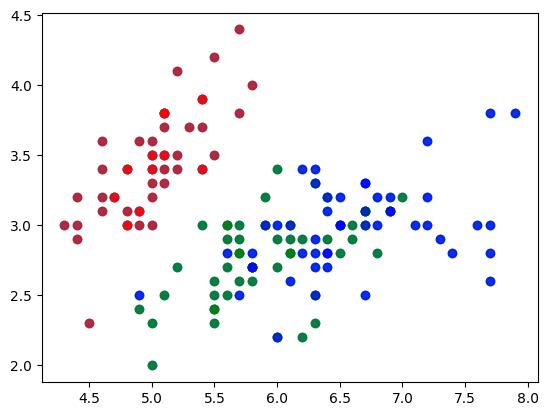

In [31]:
#applying fisher
plt.scatter(X_iris[:, 0], X_iris[:, 1])
X_iris_new = X_iris[0:, :2]
fisher = LinearDiscriminantAnalysis(n_components=2)
fisher.fit(X_iris_new, y_iris)
X_new = fisher.transform(X_iris_new)
#plt.scatter(X_new[:,0], X_new[:,1], c='red')

predictions=fisher.predict(X_iris_new)
predictions

color_species = ['red', 'green', 'blue']

for i, color in zip(range(3), color_species):
    plt.scatter(X_iris_new[y == i, 0], X_iris_new[y == i, 1], c=color, alpha=0.6)


How to classify a new observation in [5.85, 2.90]?

New observation classified as: versicolor


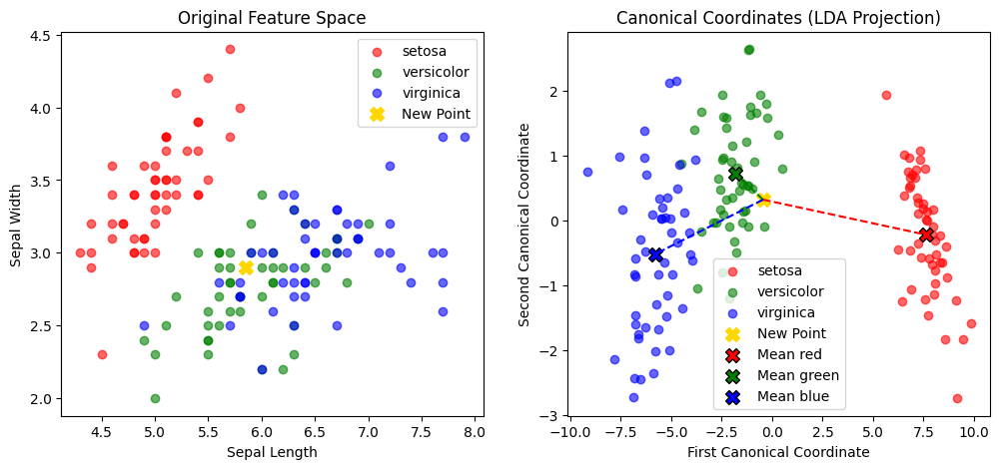

In [33]:
x_new = np.array([[5.85, 2.90]])  # New observation
cc_new = fisher.transform(x_new)  # Project into Fisher’s space
assigned_class = fisher.predict(x_new)
print("New observation classified as:", species_names[assigned_class[0]])

color_species = ['red', 'green', 'blue']

# Compute class means in LDA space
class_means_lda = lda.transform(lda.means_)  # Get means in LDA space

# Plot LDA Results with Connection Lines to Class Centers
def plot_fisher_score_with_connections():
    fig, ax = plt.subplots(1, 2, figsize=(12, 5))

    # Original Coordinate Space
    for i, color in zip(range(3), color_species):
        ax[0].scatter(X[y == i, 0], X[y == i, 1], c=color, label=species_names[i], alpha=0.6)

    ax[0].scatter(x_new[0, 0], x_new[0, 1], c='gold', marker='X', s=100, label="New Point")
    ax[0].set_xlabel("Sepal Length")
    ax[0].set_ylabel("Sepal Width")
    ax[0].set_title("Original Feature Space")
    ax[0].legend()

    # Canonical Coordinate Space (LDA Projection)
    for i, color in zip(range(3), color_species):
        ax[1].scatter(X_lda[y == i, 0], X_lda[y == i, 1], c=color, label=species_names[i], alpha=0.6)

    ax[1].scatter(cc_new[0, 0], cc_new[0, 1], c='gold', marker='X', s=100, label="New Point")

    # Connect new observation to class means
    for mean, color in zip(class_means_lda, color_species):
        ax[1].scatter(mean[0], mean[1], c=color, marker="X", s=100, edgecolors="black", label=f"Mean {color}")
        ax[1].plot([cc_new[0, 0], mean[0]], [cc_new[0, 1], mean[1]], color=color, linestyle="dashed")

    ax[1].set_xlabel("First Canonical Coordinate")
    ax[1].set_ylabel("Second Canonical Coordinate")
    ax[1].set_title("Canonical Coordinates (LDA Projection)")
    ax[1].legend()

    plt.show()

plot_fisher_score_with_connections()


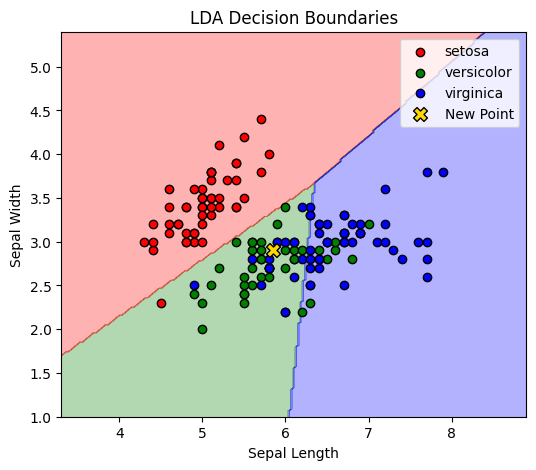

In [35]:
from matplotlib.colors import ListedColormap

x_min, x_max = X[:, 0].min() - 1, X[:, 0].max() + 1
y_min, y_max = X[:, 1].min() - 1, X[:, 1].max() + 1
xx, yy = np.meshgrid(np.linspace(x_min, x_max, 200),
                      np.linspace(y_min, y_max, 200))

# Predict on the grid
Z = fisher.predict(np.c_[xx.ravel(), yy.ravel()])
Z = Z.reshape(xx.shape)

plt.figure(figsize=(6, 5))
plt.contourf(xx, yy, Z, alpha=0.3, cmap=ListedColormap(color_species))

for i, color in zip(range(3), color_species):
    plt.scatter(X[y == i, 0], X[y == i, 1], c=color, label=species_names[i], edgecolors='k')

plt.scatter(x_new[0, 0], x_new[0, 1], c='gold', marker='X', s=100, label="New Point", edgecolors='black')
plt.xlabel("Sepal Length")
plt.ylabel("Sepal Width")
plt.title("LDA Decision Boundaries")
plt.legend()
plt.show()

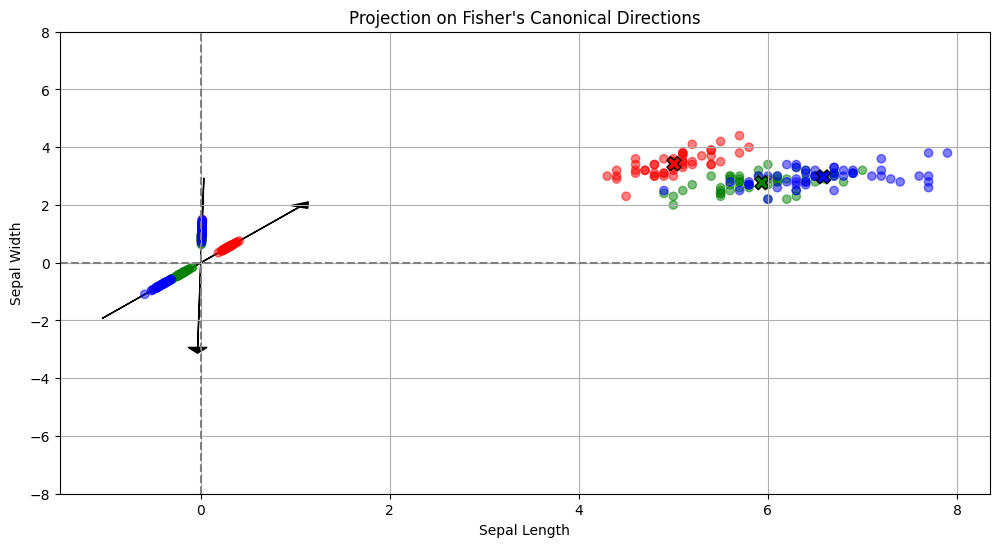

In [36]:
X_lda = lda.fit_transform(X_iris, y_iris)  # Canonical coordinates of data

# Fisher directions (discriminant vectors)
a1, a2 = lda.scalings_[:, 0], lda.scalings_[:, 1]

# Normalize Fisher directions for visualization
a1 /= np.linalg.norm(a1)
a2 /= np.linalg.norm(a2)

# Compute projections onto Fisher directions in the original space
proj_a1 = np.outer(X_iris @ a1, a1) / np.sum(a1 ** 2)
proj_a2 = np.outer(X_iris @ a2, a2) / np.sum(a2 ** 2)

class_means = lda.means_  # Means in original space

color_species = np.array(color_species)

# Plot: Projection on Canonical Directions (Original Space)**
plt.figure(figsize=(12, 6))
plt.scatter(X_iris[:, 0], X_iris[:, 1], c=color_species[y], alpha=0.5, label="Data")
plt.scatter(class_means[:, 0], class_means[:, 1], c=color_species, marker="X", s=100, edgecolors="black", label="Class Means")

# Scale factor for better visibility
t = 5

# Arrows for Fisher directions
plt.arrow(-t * a1[0], -t * a1[1], 2 * t * a1[0], 2 * t * a1[1], head_width=0.2, head_length=0.2, fc='black', ec='black', label="a1 (First Canonical Direction)")
plt.arrow(-t * a2[0], -t * a2[1], 2 * t * a2[0], 2 * t * a2[1], head_width=0.2, head_length=0.2, fc='black', ec='black', label="a2 (Second Canonical Direction)")

# Add dashed lines for original axes
plt.axhline(0, color='gray', linestyle='dashed')
plt.axvline(0, color='gray', linestyle='dashed')

# Projection of points onto Fisher's directions
plt.scatter(proj_a1[:, 0], proj_a1[:, 1], c=color_species[y], alpha=0.5)
plt.scatter(proj_a2[:, 0], proj_a2[:, 1], c=color_species[y], alpha=0.5)

# Labels
plt.xlabel("Sepal Length")
plt.ylabel("Sepal Width")
plt.title("Projection on Fisher's Canonical Directions")
plt.grid(True)
plt.ylim(-8,8)
plt.show()

In [37]:
# Compute the angle between a1 and a2
dot_product = np.dot(a1, a2)
angle_radians = np.arccos(dot_product)  # Angle in radians
angle_degrees = np.degrees(angle_radians)  # Convert to degrees

angle_degrees

np.float64(79.8377504537802)

Let's compare the projection on LDA axes with the one on PCA axes

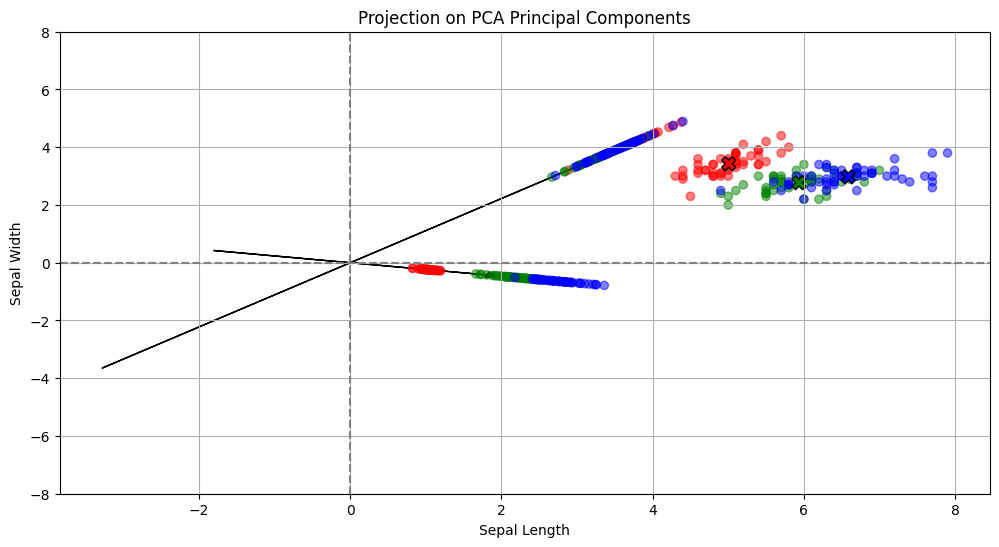

In [38]:
# Perform PCA on the original data
pca = PCA(n_components=2)
X_pca = pca.fit_transform(X_iris)  # PCA-transformed coordinates

pca1, pca2 = pca.components_

# Normalize PCA directions for visualization
pca1 /= np.linalg.norm(pca1)
pca2 /= np.linalg.norm(pca2)

# Compute projections onto PCA directions in the original space
proj_pca1 = np.outer(X_iris @ pca1, pca1) / np.sum(pca1 ** 2)
proj_pca2 = np.outer(X_iris @ pca2, pca2) / np.sum(pca2 ** 2)

# Compute class means in original space
class_means_pca = np.array([X_iris[y_iris == i].mean(axis=0) for i in range(3)])

# Plot: Projection on PCA Directions (Original Space)
plt.figure(figsize=(12, 6))
plt.scatter(X_iris[:, 0], X_iris[:, 1], c=color_species[y_iris], alpha=0.5, label="Data")
plt.scatter(class_means_pca[:, 0], class_means_pca[:, 1], c=color_species, marker="X", s=100, edgecolors="black", label="Class Means")

# Scale factor for better visibility
t = 5

# Arrows for PCA directions
plt.arrow(-t * pca1[0], -t * pca1[1], 2 * t * pca1[0], 2 * t * pca1[1], head_width=0.2, head_length=0.2, fc='black', ec='black', label="PC1 (First Principal Component)")
plt.arrow(-t * pca2[0], -t * pca2[1], 2 * t * pca2[0], 2 * t * pca2[1], head_width=0.2, head_length=0.2, fc='black', ec='black', label="PC2 (Second Principal Component)")

# Add dashed lines for original axes
plt.axhline(0, color='gray', linestyle='dashed')
plt.axvline(0, color='gray', linestyle='dashed')

# Projection of points onto PCA directions
plt.scatter(proj_pca1[:, 0], proj_pca1[:, 1], c=color_species[y_iris], alpha=0.5)
plt.scatter(proj_pca2[:, 0], proj_pca2[:, 1], c=color_species[y_iris], alpha=0.5)

# Labels
plt.xlabel("Sepal Length")
plt.ylabel("Sepal Width")
plt.title("Projection on PCA Principal Components")
plt.grid(True)
plt.ylim(-8, 8)
plt.show()


In [39]:
# Compute the angle between pca1 and pca2
dot_product = np.dot(pca1, pca2)
angle_radians = np.arccos(dot_product)  # Angle in radians
angle_degrees = np.degrees(angle_radians)  # Convert to degrees

angle_degrees

np.float64(90.00000000000003)

## K-Neareast Neighbour

## Iris

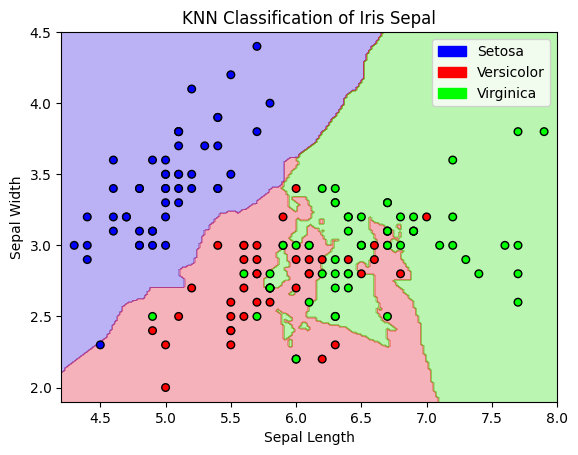

In [42]:
from sklearn.neighbors import KNeighborsClassifier

# Train a KNN classifier
knn = KNeighborsClassifier(n_neighbors=5)  # Using 5 neighbors
knn.fit(X_iris[:, :2], y_iris)

# Create a mesh grid for decision boundary
x_min, x_max = X_iris[:, 0].min() - 0.1, X_iris[:, 0].max() + 0.1
y_min, y_max = X_iris[:, 1].min() - 0.1, X_iris[:, 1].max() + 0.1
xx, yy = np.meshgrid(np.linspace(x_min, x_max, 200),
                     np.linspace(y_min, y_max, 200))

# Predict the class for each point in the grid
Z = knn.predict(np.c_[xx.ravel(), yy.ravel()])
Z = Z.reshape(xx.shape)

# Plot the decision boundary
plt.figure()
plt.contourf(xx, yy, Z, alpha=0.3, cmap='brg')

# Plot the data points
plt.scatter(X_iris[:, 0], X_iris[:, 1], c=y_iris, cmap='brg', edgecolor='k', s=30)

# Legend for species
handles = [
    mpatches.Patch(color=plt.get_cmap("brg", 3)(0), label='Setosa'),
    mpatches.Patch(color=plt.get_cmap("brg", 3)(1), label='Versicolor'),
    mpatches.Patch(color=plt.get_cmap("brg", 3)(2), label='Virginica')
]
plt.legend(handles=handles, loc='upper right')

# Labels and title
plt.title("KNN Classification of Iris Sepal")
plt.xlabel("Sepal Length")
plt.ylabel("Sepal Width")
plt.show()

In [44]:
y_pred = knn.predict(X_iris[:, :2])

conf_matrix = confusion_matrix(y_iris, y_pred)

# Compute APER (Apparent Error Rate)
aper = 1 - accuracy_score(y_iris, y_pred)

# Print results
print("Confusion Matrix:")
print(conf_matrix)
print("\nApparent Error Rate (APER): {:.4f}".format(aper))

Confusion Matrix:
[[49  1  0]
 [ 0 37 13]
 [ 0 11 39]]

Apparent Error Rate (APER): 0.1667


## Banknotes

In [45]:
from collections import Counter

# Define cost-sensitive priors
c_tf = 10    # Cost of accepting a false banknote
c_ft = 0.05  # Cost of rejecting a true banknote
pf   = 0.001 # Prior probability of a false banknote
pt   = 1 - pf # Prior probability of a true banknote

# Compute adjusted priors
num = c_tf * pf + c_ft * pt  # Normalization factor
p_true_c = (pt * c_ft) / num
p_false_c = (pf * c_tf) / num
prior_c = [p_true_c, p_false_c]

# Ensure labels match the priors
desired_order = ["true", "false"]  # Order must be consistent with priors
banknotes = np.vstack([true_data, false_data])
vf = np.array(["true"]*len(true_data) + ["false"]*len(false_data), dtype=object)
y_encoded = np.array([desired_order.index(label) for label in vf])  # Encode labels


# Train KNN classifier
knn = KNeighborsClassifier(n_neighbors=5)
knn.fit(banknotes, y_encoded)

# Retrieve neighbors for each test sample
distances, indices = knn.kneighbors(banknotes)

# Custom decision function that adjusts for priors
y_pred_adjusted = []
for i in range(len(banknotes)):
    neighbors = y_encoded[indices[i]]  # Get nearest neighbors' classes
    vote_counts = Counter(neighbors)  # Count occurrences of each class

    # Adjust votes based on priors
    weighted_votes = {cls: count * prior_c[cls] for cls, count in vote_counts.items()}

    # Assign the class with the highest weighted vote
    adjusted_prediction = max(weighted_votes, key=weighted_votes.get)
    y_pred_adjusted.append(adjusted_prediction)

# Compute confusion matrix
conf_matrix = confusion_matrix(y_encoded, y_pred_adjusted)


# Print results
print("Confusion Matrix (With Adjusted Priors):")
print(conf_matrix)

Confusion Matrix (With Adjusted Priors):
[[100   0]
 [ 78  22]]


In [46]:
# TODO: compute APER
aper = 1 - accuracy_score(y_encoded, y_pred_adjusted)
aper

0.39

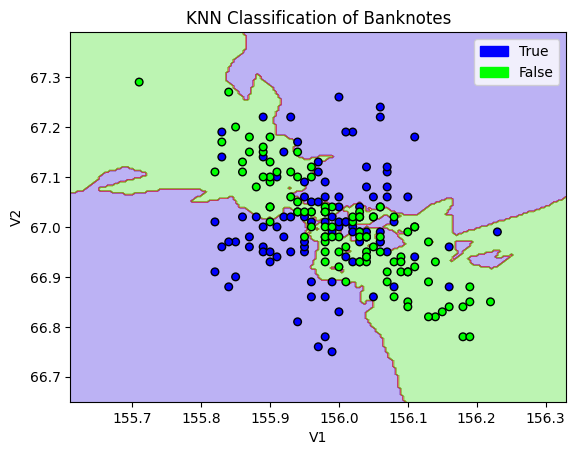

In [47]:
# TODO: plot decision boundaries
# Create a mesh grid for decision boundary
x_min, x_max = banknotes[:, 0].min() - 0.1, banknotes[:, 0].max() + 0.1
y_min, y_max = banknotes[:, 1].min() - 0.1, banknotes[:, 1].max() + 0.1
xx, yy = np.meshgrid(np.linspace(x_min, x_max, 200),
                     np.linspace(y_min, y_max, 200))

# Predict the class for each point in the grid
Z = knn.predict(np.c_[xx.ravel(), yy.ravel()])
Z = Z.reshape(xx.shape)

# Plot the decision boundary
plt.figure()
plt.contourf(xx, yy, Z, alpha=0.3, cmap='brg')

# Plot the data points
plt.scatter(banknotes[:, 0], banknotes[:, 1], c=y_encoded, cmap='brg', edgecolor='k', s=30)

# Legend for species
handles = [
    mpatches.Patch(color=plt.get_cmap("brg", 2)(0), label='True'),
    mpatches.Patch(color=plt.get_cmap("brg", 2)(1), label='False')
]
plt.legend(handles=handles, loc='upper right')

# Labels and title
plt.title("KNN Classification of Banknotes")
plt.xlabel("V1")
plt.ylabel("V2")
plt.show()

**<font size="5">Applied Statistics</font>**

<font size="3">MSc in High Performance Computing Engineering, Computer Science and Engineering, Physics Engineering - A.Y. 2024-2025</font>

Prof. Mario Beraha - Dott. Vittorio Torri

---

<font size="4">**Lab 6 - Linear Regression**</font>

# LAB 6

## Libraries

In [2]:
import pandas as pd
pd.options.display.float_format = '{:.2f}'.format

In [3]:
import matplotlib.pyplot as plt
import seaborn as sns

In [4]:
import numpy as np

In [5]:
from sklearn.metrics import r2_score
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.preprocessing import PolynomialFeatures

In [6]:
import statsmodels.api as sm

In [7]:
np.random.seed(1234)

In [8]:
import scipy.stats as stats

## Load Dataset

In [10]:
df = pd.read_csv('../DatasetsLabs/heart_failure_clinical_records_dataset_smhd.csv')
df

,age,anaemia,creatinine_phosphokinase,diabetes,ejection_fraction,high_blood_pressure,platelets,serum_creatinine,serum_sodium,sex,smoking,time,DEATH_EVENT,bmi
0,75.00,0,582,0,20.73,1,265000.00,1.90,138.39,Male,0,4,True,30.82
1,55.00,0,7861,0,29.02,0,263358.03,1.10,131.90,Male,0,6,True,25.40
2,65.00,0,146,0,26.24,0,162000.00,1.30,143.66,Male,1,7,True,29.45
3,50.00,1,111,0,10.21,0,210000.00,1.90,135.03,Male,0,7,True,36.06
4,65.00,1,160,1,19.33,0,327000.00,2.70,136.08,Female,0,8,True,33.69
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
294,62.00,0,61,1,38.05,1,155000.00,1.10,135.58,Male,1,270,False,25.60
295,55.00,0,1820,0,35.20,0,270000.00,1.20,142.02,Female,0,271,False,29.39
296,45.00,0,2060,1,62.32,0,742000.00,0.80,136.38,Female,0,278,False,20.71
297,45.00,0,2413,0,37.49,0,140000.00,1.40,133.91,Male,1,280,False,27.76


In [11]:
cat_vars = ['anaemia', 'diabetes', 'high_blood_pressure',  'sex',  'smoking',  'DEATH_EVENT']
num_vars = ['age', 'creatinine_phosphokinase', 'ejection_fraction', 'platelets', 'serum_creatinine', 'serum_sodium', 'bmi', 'time']

## Simple Linear Regression

Let's look at the scatterplot of bmi and ejection fraction

In [12]:
TARGET = 'bmi'

/var/folders/_y/h277wkdd5pn6k7_rv_nqy3yw0000gn/T/ipykernel_19936/3868311146.py:1: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.relplot(x="ejection_fraction", y="bmi", palette="muted", height=6, data=df)


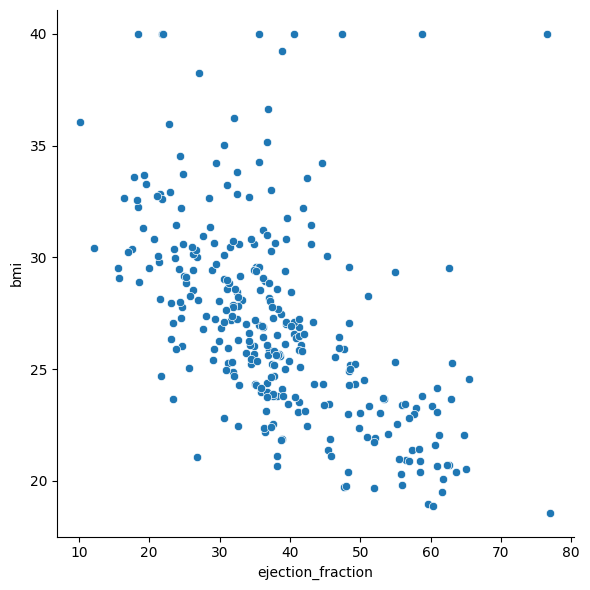

In [13]:
sns.relplot(x="ejection_fraction", y="bmi", palette="muted", height=6, data=df)

It looks like there is a relationship between them: we can try to predict BMI based on ejection fraction

In [14]:
X = df['ejection_fraction'].values.reshape(-1,1) #da un array 1d ad uno 2d con una colonna
y = df['bmi']
y.shape, X.shape

((299,), (299, 1))

In [15]:
X_const = sm.add_constant(X)

In [16]:
X_const.shape, y.shape, type(X_const)

((299, 2), (299,), numpy.ndarray)

$$ bmi = \beta_0 + \beta_1 \cdot ef + \epsilon $$

In [17]:
model = sm.OLS(y, X_const)
results = model.fit()
print(results.summary())


                            OLS Regression Results                            
Dep. Variable:                    bmi   R-squared:                       0.283
Model:                            OLS   Adj. R-squared:                  0.281
Method:                 Least Squares   F-statistic:                     117.2
Date:                Sun, 13 Jul 2025   Prob (F-statistic):           3.06e-23
Time:                        15:37:41   Log-Likelihood:                -821.26
No. Observations:                 299   AIC:                             1647.
Df Residuals:                     297   BIC:                             1654.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         34.5154      0.717     48.117      0.0

In [18]:
y_pred = results.predict(X_const)

r2 = r2_score(y,y_pred)
mse = mean_squared_error(y,y_pred)

print(f'R2: {r2:.4f}')
print(f'MSE: {mse:.4f}')

R2: 0.2829
MSE: 14.2321


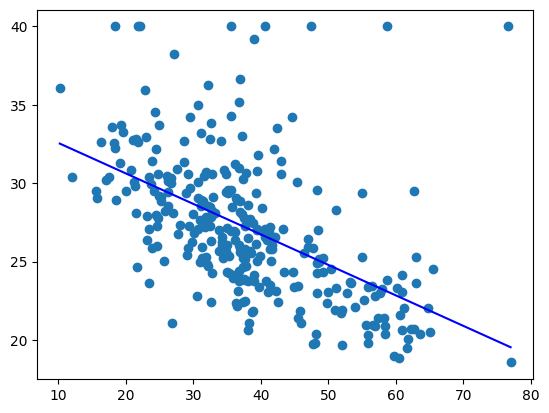

In [19]:
X_plot = np.arange(np.min(X),np.max(X),0.1).reshape(-1,1)
X_plot = sm.add_constant(X_plot)
y_plot = results.predict(X_plot)

plt.scatter(X, y)
plt.plot(X_plot[:,1], y_plot, c='blue')

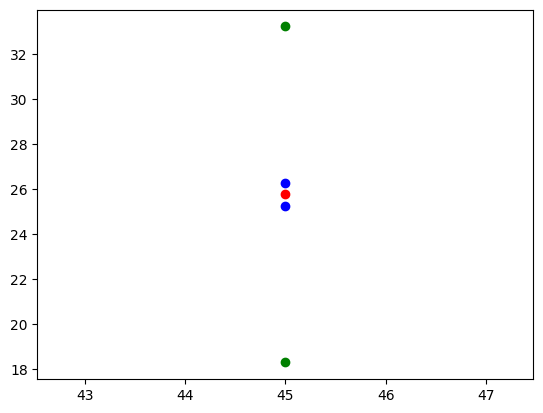

In [20]:
ef_point = 45
X0_const = np.array([1, ef_point])
prediction = results.get_prediction(X0_const) #ritorna una oggetto di una classe
intervals = prediction.summary_frame(alpha=0.05)
intervals
prediction = intervals['mean']
ci_lower = intervals['mean_ci_lower']
ci_upper = intervals['mean_ci_upper']
pi_lower = intervals['obs_ci_lower']
pi_upper = intervals['obs_ci_upper']

#plotting
plt.scatter(X0_const[1], prediction, c='red')
plt.scatter(X0_const[1], ci_lower, c='blue')
plt.scatter(X0_const[1], ci_upper, c='blue')
plt.scatter(X0_const[1], pi_lower, c='green')
plt.scatter(X0_const[1], pi_upper, c='green')
plt.show()

## Confidence/Prediction intervals

In [21]:
X_plot = np.linspace(X.min(), X.max(), 100).reshape(-1, 1)
X_plot_const = sm.add_constant(X_plot)

# Predict with confidence intervals
predictions = results.get_prediction(X_plot_const)
summary_frame = predictions.summary_frame(alpha=0.05)  # 95% intervals
summary_frame


,mean,mean_se,mean_ci_lower,mean_ci_upper,obs_ci_lower,obs_ci_upper
0,32.53,0.55,31.46,33.60,25.00,40.06
1,32.40,0.53,31.35,33.45,24.88,39.92
2,32.27,0.52,31.24,33.30,24.75,39.79
3,32.14,0.51,31.13,33.15,24.62,39.65
4,32.01,0.50,31.02,32.99,24.49,39.52
...,...,...,...,...,...,...
95,20.06,0.69,18.71,21.42,12.49,27.64
96,19.93,0.70,18.56,21.31,12.36,27.51
97,19.80,0.71,18.40,21.20,12.22,27.38
98,19.67,0.72,18.25,21.09,12.09,27.25


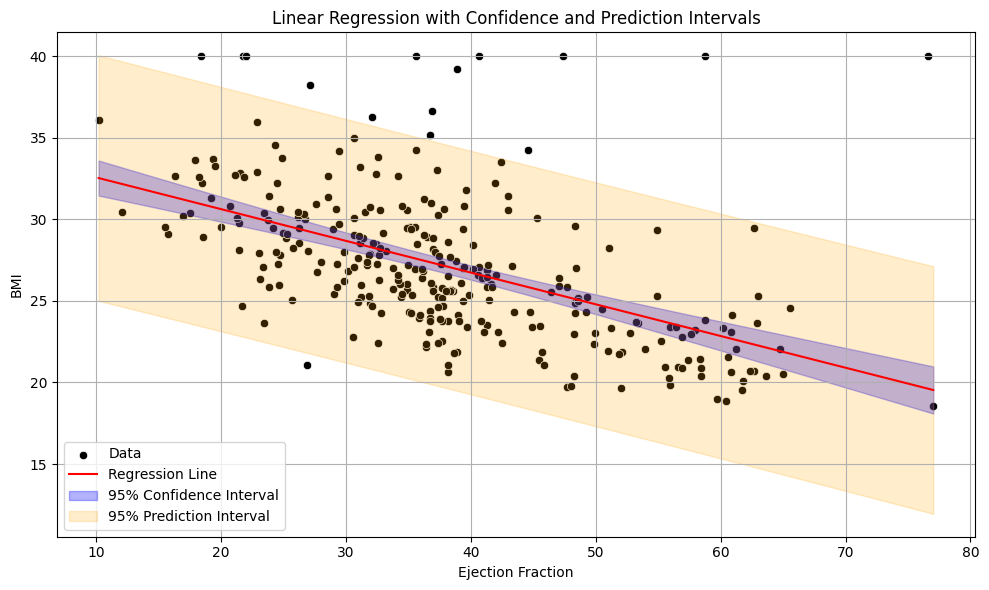

In [22]:
# Extract the values
y_pred = summary_frame['mean']
ci_lower = summary_frame['mean_ci_lower']
ci_upper = summary_frame['mean_ci_upper']
pi_lower = summary_frame['obs_ci_lower']
pi_upper = summary_frame['obs_ci_upper']

plt.figure(figsize=(10, 6))
sns.scatterplot(x=df['ejection_fraction'], y=df['bmi'], label='Data', color='black')
plt.plot(X_plot, y_pred, color='red', label='Regression Line')
plt.fill_between(X_plot.flatten(), ci_lower, ci_upper, color='blue', alpha=0.3, label='95% Confidence Interval')
plt.fill_between(X_plot.flatten(), pi_lower, pi_upper, color='orange', alpha=0.2, label='95% Prediction Interval')
plt.xlabel('Ejection Fraction')
plt.ylabel('BMI')
plt.title('Linear Regression with Confidence and Prediction Intervals')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


In [23]:
x_mean = X.mean()
idx_closest = np.argmin(np.abs(X_plot.flatten() - x_mean))

ci_width_at_mean = ci_upper.iloc[idx_closest] - ci_lower.iloc[idx_closest]
pi_width_at_mean = pi_upper.iloc[idx_closest] - pi_lower.iloc[idx_closest]

print(f'CI width at mean(X) = {x_mean:.2f}: {ci_width_at_mean:.4f}')
print(f'PI width at mean(X) = {x_mean:.2f}: {pi_width_at_mean:.4f}')

print("CI width (start/end):", ci_upper.iloc[0] - ci_lower.iloc[0], ci_upper.iloc[-1] - ci_lower.iloc[-1])
print("PI width (start/end):", pi_upper.iloc[0] - pi_lower.iloc[0], pi_upper.iloc[-1] - pi_lower.iloc[-1])

CI width at mean(X) = 38.03: 0.8617
PI width at mean(X) = 38.03: 14.9234
CI width (start/end): 2.147469878187124 2.887852059701423
PI width (start/end): 15.05250862305327 15.175838642002418


Prediction and confidence intervals for a pecific point, ef=45

In [24]:
ef_point = 45
X_new = [1, ef_point] # Add constant manually

EF = 45
Predicted BMI: 25.77
95% Confidence Interval (mean): [25.27, 26.26]
95% Prediction Interval (new patient): [18.30, 33.23]


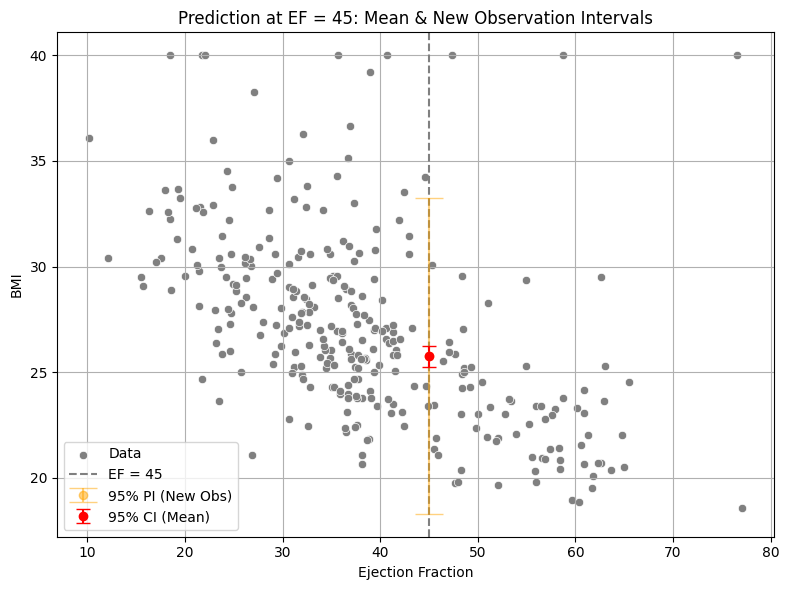

In [25]:
### TODO
ef_point = 45
X_new = np.array([[1, ef_point]])  # Add constant manually

# Get predictions with confidence and prediction intervals
pred_result = results.get_prediction(X_new)
pred_summary = pred_result.summary_frame(alpha=0.05)

# Extract predicted values and intervals
mean_pred = pred_summary['mean'].values[0]
ci_lower = pred_summary['mean_ci_lower'].values[0]
ci_upper = pred_summary['mean_ci_upper'].values[0]
pi_lower = pred_summary['obs_ci_lower'].values[0]
pi_upper = pred_summary['obs_ci_upper'].values[0]

print(f"EF = {ef_point}")
print(f"Predicted BMI: {mean_pred:.2f}")
print(f"95% Confidence Interval (mean): [{ci_lower:.2f}, {ci_upper:.2f}]")
print(f"95% Prediction Interval (new patient): [{pi_lower:.2f}, {pi_upper:.2f}]")

# --- Plot ---
plt.figure(figsize=(8,6))
sns.scatterplot(x=df['ejection_fraction'], y=df['bmi'], label='Data', color='gray')
plt.axvline(x=ef_point, color='grey', linestyle='--', label=f'EF = {ef_point}')


# PI for new observation
plt.errorbar(ef_point, mean_pred,
             yerr=[[mean_pred - pi_lower], [pi_upper - mean_pred]],
             fmt='o', color='orange', capsize=10, alpha=0.5, label='95% PI (New Obs)')

# CI for mean
plt.errorbar(ef_point, mean_pred,
             yerr=[[mean_pred - ci_lower], [ci_upper - mean_pred]],
             fmt='o', color='red', capsize=5, label='95% CI (Mean)')

plt.xlabel('Ejection Fraction')
plt.ylabel('BMI')
plt.title(f'Prediction at EF = {ef_point}: Mean & New Observation Intervals')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


## Train-test set

So far we are evaluating the model on the same data it was trained on..

In [26]:
from sklearn import model_selection

X = df[['age', 'anaemia', 'creatinine_phosphokinase', 'diabetes', 'high_blood_pressure', 'platelets', 'serum_creatinine', 'serum_sodium', 'sex', 'smoking', 'ejection_fraction', 'time']]

X_train, X_test, y_train, y_test = model_selection.train_test_split(X, y, test_size=0.20, random_state=1234)

train_index = X_train.index
test_index = X_test.index

In [27]:
### TODO: FIT THE MODEL ON TRAINING DATA
X_train_1 = X_train[['ejection_fraction']]
X_test_1 = X_test[['ejection_fraction']]
X_train_1 = sm.add_constant(X_train_1)
X_test_1 = sm.add_constant(X_test_1)

model = sm.OLS(y_train, X_train_1)
results = model.fit()
print(results.summary())

                            OLS Regression Results                            
Dep. Variable:                    bmi   R-squared:                       0.278
Model:                            OLS   Adj. R-squared:                  0.275
Method:                 Least Squares   F-statistic:                     91.11
Date:                Sun, 13 Jul 2025   Prob (F-statistic):           1.76e-18
Time:                        15:38:19   Log-Likelihood:                -664.47
No. Observations:                 239   AIC:                             1333.
Df Residuals:                     237   BIC:                             1340.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                        coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------
const                34.7489      0.82

In [28]:
### TODO: COMPUTE MSE AND R^2 ON TEST DATA
y_pred = results.predict(X_test_1)
r2 = r2_score(y_test,y_pred)
mse = mean_squared_error(y_test,y_pred)
print(r2)
print(mse)

0.2995161534784553
10.382415897515164


## Multiple linear regression

## Multiple input variables

In [29]:
variables = num_vars.copy()
variables.remove('bmi')

X_train_2 = X_train[variables]
X_test_2 = X_test[variables]
X_train_2 = sm.add_constant(X_train_2)
X_test_2 = sm.add_constant(X_test_2)

In [30]:
model = sm.OLS(y_train, X_train_2)
results = model.fit()
print(results.summary())

                            OLS Regression Results                            
Dep. Variable:                    bmi   R-squared:                       0.783
Model:                            OLS   Adj. R-squared:                  0.777
Method:                 Least Squares   F-statistic:                     119.2
Date:                Sun, 13 Jul 2025   Prob (F-statistic):           5.01e-73
Time:                        15:39:20   Log-Likelihood:                -520.64
No. Observations:                 239   AIC:                             1057.
Df Residuals:                     231   BIC:                             1085.
Df Model:                           7                                         
Covariance Type:            nonrobust                                         
                               coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------------
const                   

In [31]:
y_pred = results.predict(X_test_2)
r2 = r2_score(y_test,y_pred)
mse = mean_squared_error(y_test,y_pred)

n = len(y_test)
p = X_test_2.shape[1]
adj_r2 = 1 - (1 - r2) * (n - 1) / (n - p - 1)
print(f'R2: {r2:.4f}')
print(f'adj_R2: {adj_r2:.4f}')
print(f'MSE: {mse:.4f}')

R2: 0.6238
adj_R2: 0.5648
MSE: 5.5757


$$ R^2 = 1 - \frac{RSS}{TSS} = 1 - \frac{\sum{(y_i - \hat{y_i})^2}}{\sum{(y_i - \bar{y})^2}}$$

$$ AdjR^2 = 1 - \frac{n - 1}{n - k -1} \frac{RSS}{TSS} = 1 - \frac{n - 1}{n - k -1} (1 - R^2)$$

where $k$ is the number of regressors

## Collinearity

The Variance Inflation Factor (VIF) indicates how good a variable can be predicted from the others

A high VIF means there is collinearity with some other variable

Rule of thumb: VIF > 5 for a variable is problematic

In [32]:
from statsmodels.stats.outliers_influence import variance_inflation_factor

data = X_train_2

vif_data = pd.DataFrame()
vif_data["Variable"] = data.columns

vif_data["VIF"] = [variance_inflation_factor(data.values, i) for i in range(data.shape[1])]

print(vif_data)

                   Variable     VIF
0                     const 1158.00
1                       age    1.12
2  creatinine_phosphokinase    1.02
3         ejection_fraction    1.04
4                 platelets    1.02
5          serum_creatinine    1.07
6              serum_sodium    1.07
7                      time    1.07


The correlation coefficients can also identify collinearity, but not always. If a variable X1 is a linear transformation of a variable X2, their linear correlation coefficient will be high. But if the collinearity involves a group of variable, then it might not be evident from the correlation matrix

<Axes: >

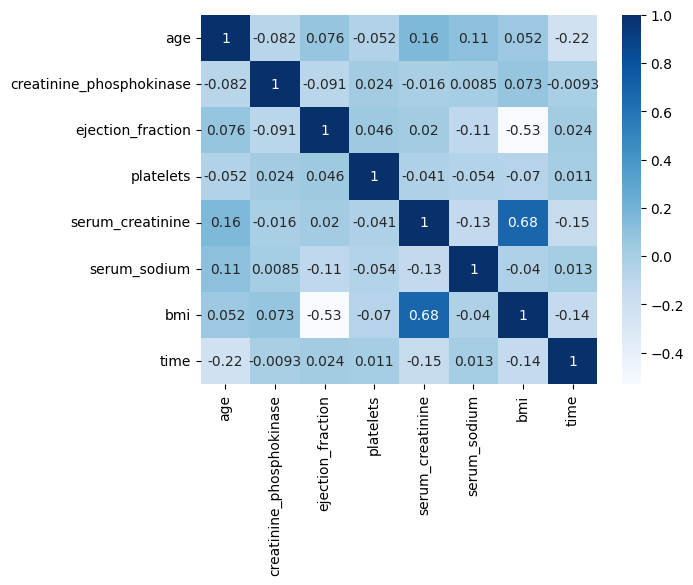

In [33]:
sns.heatmap(df[num_vars].corr(), cmap="Blues",annot=True)

## Scale variables

Numerical variables having different scales are often problematic. Many models have their coefficients' computation affected by this, but while this is not the case of linear regression with least square method, it is still useful to **standardize** the features for interpretability of coefficients and to reduce the condition numer when it is not due to a direct multicollinearity among the variables. The VIF is scale invariant, but the condition number is not.

Moreover, this is necessary when penalizations are introduced in linear regression models (more on this in the next lectures)

To standardize a variable x:

$$ z = \frac{x - \mu }{\sigma}$$

$$ $$

In [34]:
X_train_2 = X_train[variables]
X_test_2 = X_test[variables]

scaler = StandardScaler()
X_train_2_scaled = pd.DataFrame(scaler.fit_transform(X_train_2), columns=X_train_2.columns, index=X_train_2.index)
X_test_2_scaled = pd.DataFrame(scaler.transform(X_test_2), columns=X_test_2.columns, index=X_test_2.index)

X_train_2_scaled = sm.add_constant(X_train_2_scaled)
X_test_2_scaled = sm.add_constant(X_test_2_scaled)


In [35]:
model = sm.OLS(y_train, X_train_2_scaled)
results = model.fit()
print(results.summary())

                            OLS Regression Results                            
Dep. Variable:                    bmi   R-squared:                       0.783
Model:                            OLS   Adj. R-squared:                  0.777
Method:                 Least Squares   F-statistic:                     119.2
Date:                Sun, 13 Jul 2025   Prob (F-statistic):           5.01e-73
Time:                        15:39:37   Log-Likelihood:                -520.64
No. Observations:                 239   AIC:                             1057.
Df Residuals:                     231   BIC:                             1085.
Df Model:                           7                                         
Covariance Type:            nonrobust                                         
                               coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------------
const                   

In [36]:
y_pred = results.predict(X_test_2_scaled)
r2 = r2_score(y_test,y_pred)
mse = mean_squared_error(y_test,y_pred)
n = len(y_test)
p = X_test_2_scaled.shape[1]
adj_r2 = 1 - (1 - r2) * (n - 1) / (n - p - 1)
print(f'R2: {r2:.4f}')
print(f'adj_R2: {adj_r2:.4f}')
print(f'MSE: {mse:.4f}')

R2: 0.6238
adj_R2: 0.5648
MSE: 5.5757


## Reduce the number of variables

### EF + creatinine

$$ bmi = \beta_0 + \beta_1 \cdot ef + \beta_2 \cdot creatinine + \epsilon $$

In [37]:
variables = ['ejection_fraction', 'serum_creatinine']

X_train_3 = X_train[variables]
X_test_3 = X_test[variables]
X_train_3 = sm.add_constant(X_train_3)
X_test_3 = sm.add_constant(X_test_3)

In [38]:
model = sm.OLS(y_train, X_train_3)
results = model.fit()
print(results.summary())

                            OLS Regression Results                            
Dep. Variable:                    bmi   R-squared:                       0.780
Model:                            OLS   Adj. R-squared:                  0.778
Method:                 Least Squares   F-statistic:                     418.2
Date:                Sun, 13 Jul 2025   Prob (F-statistic):           2.64e-78
Time:                        15:39:42   Log-Likelihood:                -522.44
No. Observations:                 239   AIC:                             1051.
Df Residuals:                     236   BIC:                             1061.
Df Model:                           2                                         
Covariance Type:            nonrobust                                         
                        coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------
const                30.9120      0.48

In [39]:
y_pred = results.predict(X_test_3)
r2 = r2_score(y_test,y_pred)
mse = mean_squared_error(y_test,y_pred)
n = len(y_test)
p = X_test_3.shape[1]
adj_r2 = 1 - (1 - r2) * (n - 1) / (n - p - 1)
print(f'R2: {r2:.4f}')
print(f'adj_R2: {adj_r2:.4f}')
print(f'MSE: {mse:.4f}')

R2: 0.6279
adj_R2: 0.6080
MSE: 5.5148


with 2 regressors we can still visualize a plane:

In [40]:
# TODO
x1 = X_train_3['ejection_fraction']
x2 = X_train_3['serum_creatinine']
y = y_train

# Get model coefficients
b0, b1, b2 = results.params

# Create a grid for plotting the regression plane
x1_grid, x2_grid = np.meshgrid(
    np.linspace(x1.min(), x1.max(), 30),
    np.linspace(x2.min(), x2.max(), 30)
)
x2_grid.shape, y.shape,

((30, 30), (239,))

In [41]:
# Compute predicted y values over the grid
y_pred_grid = b0 + b1 * x1_grid + b2 * x2_grid
y_pred_grid.shape, b1, b0


((30, 30), -0.20615083151495278, 30.91195102560674)

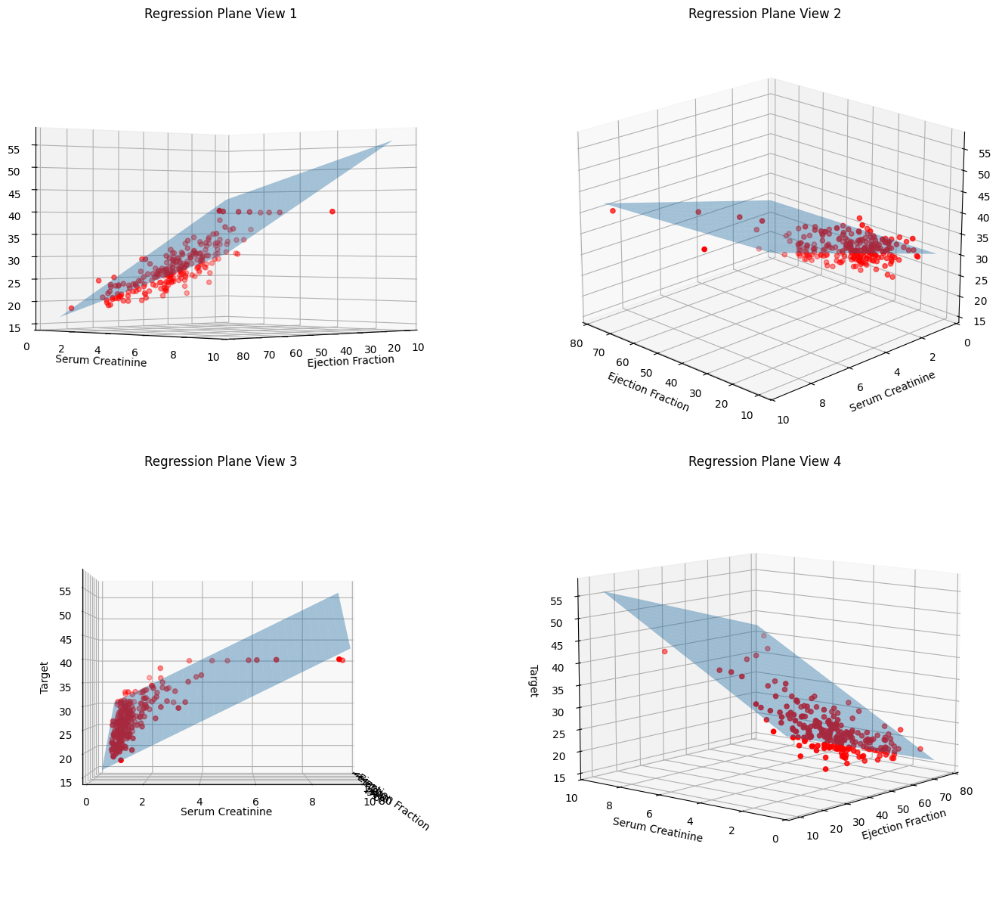

In [42]:
# Plot
fig = plt.figure(figsize=(16, 12))

views = [
    (0, 45),
    (20, 135),
    (0, 0),
    (10, 220)
]

titles = [
    "Regression Plane View 1",
    "Regression Plane View 2",
    "Regression Plane View 3",
    "Regression Plane View 4"
]

for i, (elev, azim) in enumerate(views):
    ax = fig.add_subplot(2, 2, i+1, projection='3d')
    ax.scatter(x1, x2, y, color='r', label='Data')
    ax.plot_surface(x1_grid, x2_grid, y_pred_grid, alpha=0.4)
    ax.set_xlabel('Ejection Fraction')
    ax.set_ylabel('Serum Creatinine')
    ax.set_zlabel('Target')
    ax.view_init(elev=elev, azim=azim)
    ax.set_title(titles[i])

plt.tight_layout()
plt.show()

with standardization:

In [49]:
scaletor = StandardScaler()
X_train_scaled = scaletor.fit_transform(X_train[num_vars])
X_train_scaled #ci sta che i valori non siano compresi tra -1 e 1, hanno solo media 0 e deviazione standard 1

array([[-0.08143932,  3.24989938,  1.67557712, ...,  4.7725326 ,
        -1.13017853, -1.08270124],
       [-0.2482731 , -0.44847392,  0.41603855, ..., -0.39113013,
         0.13775787,  1.31541386],
       [ 1.16981403, -0.01416599, -0.57572966, ...,  0.34780781,
         1.36392383, -1.33918413],
       ...,
       [ 0.75272958, -0.50927703,  0.61631107, ..., -0.39113013,
        -0.21993936, -1.06987709],
       [ 0.08539446, -0.51699806, -0.01122356, ..., -0.30210146,
        -0.2769896 ,  1.82837965],
       [-0.91560821, -0.01416599,  1.99592918, ..., -0.56918747,
        -0.64333327,  0.82809635]], shape=(239, 7))

In [50]:
X_train_3 = X_train[variables]
X_test_3 = X_test[variables]

scaler = StandardScaler()
X_train_3_scaled = pd.DataFrame(scaler.fit_transform(X_train_3), columns=X_train_3.columns, index=X_train_3.index)
X_test_3_scaled = pd.DataFrame(scaler.transform(X_test_3), columns=X_test_3.columns, index=X_test_3.index)

X_train_3_scaled = sm.add_constant(X_train_3_scaled)
X_test_3_scaled = sm.add_constant(X_test_3_scaled)



In [51]:
model = sm.OLS(y_train, X_train_3_scaled)
results = model.fit()
print(results.summary())

                            OLS Regression Results                            
Dep. Variable:                    bmi   R-squared:                       0.780
Model:                            OLS   Adj. R-squared:                  0.778
Method:                 Least Squares   F-statistic:                     418.2
Date:                Sun, 13 Jul 2025   Prob (F-statistic):           2.64e-78
Time:                        15:41:12   Log-Likelihood:                -522.44
No. Observations:                 239   AIC:                             1051.
Df Residuals:                     236   BIC:                             1061.
Df Model:                           2                                         
Covariance Type:            nonrobust                                         
                        coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------
const                27.2106      0.14

In [52]:
y_pred = results.predict(X_test_3_scaled)
r2 = r2_score(y_test,y_pred)
mse = mean_squared_error(y_test,y_pred)
n = len(y_test)
p = X_test_3_scaled.shape[1]
adj_r2 = 1 - (1 - r2) * (n - 1) / (n - p - 1)
print(f'R2: {r2:.4f}')
print(f'adj_R2: {adj_r2:.4f}')
print(f'MSE: {mse:.4f}')

R2: 0.6279
adj_R2: 0.6080
MSE: 5.5148


### EF + creatinine + time

$$ bmi = \beta_0 + \beta_1 \cdot ef + \beta_2 \cdot creatinine + \beta_3 \cdot time + \epsilon $$

In [ ]:
# TODO

## Polynomial features

$$ bmi = \beta_0 + \beta_1 \cdot ef + \beta_2 \cdot ef^2 + \epsilon $$

In [53]:
from sklearn.preprocessing import PolynomialFeatures

In [54]:
variables = ['ejection_fraction']

X_train_6 = X_train[variables]
X_test_6 = X_test[variables]

polynomial2 = PolynomialFeatures(degree=2, include_bias=True)
X_train_6 = polynomial2.fit_transform(X_train_6)
X_test_6 = polynomial2.fit_transform(X_test_6)

In [55]:
variables = ['ejection_fraction']

X_train_6 = X_train[variables]
X_test_6 = X_test[variables]

polynomial2 = PolynomialFeatures(degree=2, include_bias=True)
X_train_6 = polynomial2.fit_transform(X_train_6)
X_test_6 = polynomial2.fit_transform(X_test_6)

scaler = StandardScaler()

# Scale everything except the constant term (column index 0)
X_train_6[:, 1:] = scaler.fit_transform(X_train_6[:, 1:])
X_test_6[:, 1:] = scaler.transform(X_test_6[:, 1:])

# Convert to DataFrame, maintaining the column names
cols = ['const', 'ef', 'ef^2']
#cols = polynomial2.get_feature_names_out()
X_train_6 = pd.DataFrame(X_train_6, columns=cols, index=train_index)
X_test_6 = pd.DataFrame(X_test_6, columns=cols, index=test_index)

In [ ]:
X_train_6

,const,ef,ef^2
52,1.00,1.68,1.78
257,1.00,0.42,0.26
24,1.00,-0.58,-0.62
77,1.00,0.16,0.00
33,1.00,-1.11,-0.97
...,...,...,...
152,1.00,0.90,0.79
204,1.00,0.60,0.45
53,1.00,0.62,0.47
294,1.00,-0.01,-0.16


In [56]:
model = sm.OLS(y_train, X_train_6)
results = model.fit()
print(results.summary())

                            OLS Regression Results                            
Dep. Variable:                    bmi   R-squared:                       0.300
Model:                            OLS   Adj. R-squared:                  0.295
Method:                 Least Squares   F-statistic:                     50.68
Date:                Sun, 13 Jul 2025   Prob (F-statistic):           4.87e-19
Time:                        15:41:23   Log-Likelihood:                -660.64
No. Observations:                 239   AIC:                             1327.
Df Residuals:                     236   BIC:                             1338.
Df Model:                           2                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         27.2106      0.250    108.884      0.0

In [57]:
y_pred = results.predict(X_test_6)
r2 = r2_score(y_test,y_pred)
mse = mean_squared_error(y_test,y_pred)
n = len(y_test)
p = X_test_6.shape[1]
adj_r2 = 1 - (1 - r2) * (n - 1) / (n - p - 1)

print(f'R2: {r2:.4f}')
print(f'adj_R2: {adj_r2:.4f}')
print(f'MSE: {mse:.4f}')

R2: 0.2610
adj_R2: 0.2214
MSE: 10.9534


/Users/ema/Desktop/AppliedStatistics/.venv/lib/python3.13/site-packages/sklearn/utils/validation.py:2749: UserWarning: X does not have valid feature names, but PolynomialFeatures was fitted with feature names
  warnings.warn(
/var/folders/_y/h277wkdd5pn6k7_rv_nqy3yw0000gn/T/ipykernel_19936/3581671306.py:9: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.relplot(y="bmi", x="ejection_fraction", palette="muted",


<Axes: xlabel='ejection_fraction', ylabel='bmi'>

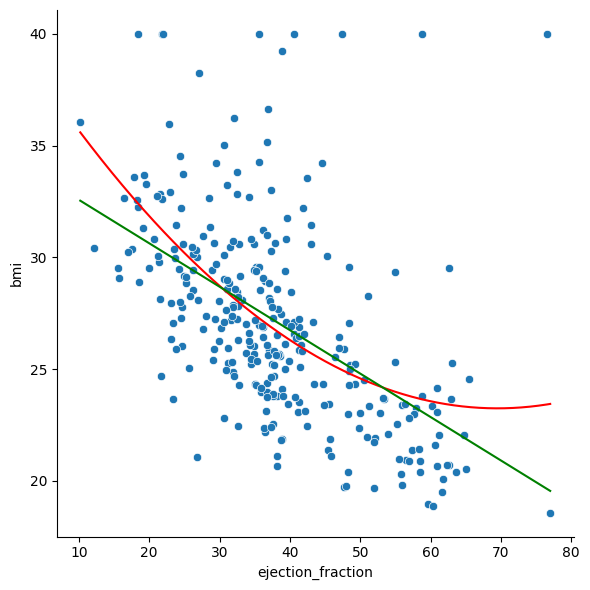

In [58]:
## TODO: plot the line fitted by this polinomial regression, compare to the simple regression on ef
X_plot = np.arange(np.min(X_train['ejection_fraction']),np.max(X_train['ejection_fraction']),0.1).reshape(-1,1)
X_plot_6 = polynomial2.transform(X_plot)

X_plot_6_scaled = X_plot_6
X_plot_6_scaled[:,1:] = scaler.transform(X_plot_6_scaled[:,1:])
y_plot_6 = results.predict(X_plot_6_scaled)

sns.relplot(y="bmi", x="ejection_fraction", palette="muted",
            height=6, data=df)
sns.lineplot(x=X_plot[:,0], y=y_plot_6,color='red')
sns.lineplot(x=X_plot[:,0], y=y_plot,color='green')

$$ bmi = \beta_0 + \beta_1 \cdot ef + \beta_2 \cdot creatinine + \beta_3 \cdot ef^2 + \beta_4 \cdot ef \cdot creatinine + \beta_5 \cdot creatinine^2 + \epsilon $$

In [60]:
variables = ['ejection_fraction', 'serum_creatinine']

X_train_7 = X_train[variables]
X_test_7 = X_test[variables]

polynomial2 = PolynomialFeatures(degree=2, include_bias=True)
X_train_7 = polynomial2.fit_transform(X_train_7)
X_test_7 = polynomial2.fit_transform(X_test_7)

scaler = StandardScaler()

# Scale everything except the constant term (column index 0)
X_train_7[:, 1:] = scaler.fit_transform(X_train_7[:, 1:])
X_test_7[:, 1:] = scaler.transform(X_test_7[:, 1:])

# Convert to DataFrame, maintaining the column names
cols = polynomial2.get_feature_names_out()
X_train_7 = pd.DataFrame(X_train_7, columns=cols, index=train_index)
X_test_7 = pd.DataFrame(X_test_7, columns=cols, index=test_index)

In [61]:
model = sm.OLS(y_train, X_train_7)
results = model.fit()
print(results.summary())

                            OLS Regression Results                            
Dep. Variable:                    bmi   R-squared:                       0.823
Model:                            OLS   Adj. R-squared:                  0.819
Method:                 Least Squares   F-statistic:                     216.6
Date:                Sun, 13 Jul 2025   Prob (F-statistic):           1.80e-85
Time:                        15:41:43   Log-Likelihood:                -496.43
No. Observations:                 239   AIC:                             1005.
Df Residuals:                     233   BIC:                             1026.
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                                         coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------------------
1   

In [62]:
y_pred = results.predict(X_test_7)
r2 = r2_score(y_test,y_pred)
mse = mean_squared_error(y_test,y_pred)
n = len(y_test)
p = X_test_7.shape[1]
adj_r2 = 1 - (1 - r2) * (n - 1) / (n - p - 1)
print(f'R2: {r2:.4f}')
print(f'adj_R2: {adj_r2:.4f}')
print(f'MSE: {mse:.4f}')

R2: 0.6693
adj_R2: 0.6319
MSE: 4.9017


$$ bmi = \beta_0 + \beta_1 \cdot ef + \beta_2 \cdot creatinine + \beta_3 \cdot ef \cdot creatinine + \beta_4 \cdot creatinine^2 + \epsilon $$

In [63]:
X_train_8 = X_train_7.drop('ejection_fraction^2', axis=1)
X_test_8 = X_test_7.drop('ejection_fraction^2', axis=1)

In [64]:
model = sm.OLS(y_train, X_train_8)
results = model.fit()
print(results.summary())

                            OLS Regression Results                            
Dep. Variable:                    bmi   R-squared:                       0.823
Model:                            OLS   Adj. R-squared:                  0.820
Method:                 Least Squares   F-statistic:                     271.7
Date:                Sun, 13 Jul 2025   Prob (F-statistic):           1.11e-86
Time:                        15:41:52   Log-Likelihood:                -496.51
No. Observations:                 239   AIC:                             1003.
Df Residuals:                     234   BIC:                             1020.
Df Model:                           4                                         
Covariance Type:            nonrobust                                         
                                         coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------------------
1   

In [65]:
y_pred = results.predict(X_test_8)
r2 = r2_score(y_test,y_pred)
mse = mean_squared_error(y_test,y_pred)
n = len(y_test)
p = X_test_8.shape[1]
adj_r2 = 1 - (1 - r2) * (n - 1) / (n - p - 1)
print(f'R2: {r2:.4f}')
print(f'adj_R2: {adj_r2:.4f}')
print(f'MSE: {mse:.4f}')

R2: 0.6688
adj_R2: 0.6382
MSE: 4.9087


## Categorical Features

To use them we need to transform categorical variables with one-hot encoding


In [ ]:
from sklearn.preprocessing import OneHotEncoder

encoder = OneHotEncoder(drop='first', sparse_output=False)

encoded_feature = encoder.fit_transform(df[cat_vars])
df_encoded = pd.DataFrame(encoded_feature, columns=encoder.get_feature_names_out(cat_vars))
df_encoded = pd.concat([df.drop(cat_vars, axis=1), df_encoded], axis=1)
df_encoded

,age,creatinine_phosphokinase,ejection_fraction,platelets,serum_creatinine,serum_sodium,time,bmi,anaemia_1,diabetes_1,high_blood_pressure_1,sex_Male,smoking_1,DEATH_EVENT_True
0,75.00,582,20.73,265000.00,1.90,138.39,4,30.82,0.00,0.00,1.00,1.00,0.00,1.00
1,55.00,7861,29.02,263358.03,1.10,131.90,6,25.40,0.00,0.00,0.00,1.00,0.00,1.00
2,65.00,146,26.24,162000.00,1.30,143.66,7,29.45,0.00,0.00,0.00,1.00,1.00,1.00
3,50.00,111,10.21,210000.00,1.90,135.03,7,36.06,1.00,0.00,0.00,1.00,0.00,1.00
4,65.00,160,19.33,327000.00,2.70,136.08,8,33.69,1.00,1.00,0.00,0.00,0.00,1.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
294,62.00,61,38.05,155000.00,1.10,135.58,270,25.60,0.00,1.00,1.00,1.00,1.00,0.00
295,55.00,1820,35.20,270000.00,1.20,142.02,271,29.39,0.00,0.00,0.00,0.00,0.00,0.00
296,45.00,2060,62.32,742000.00,0.80,136.38,278,20.71,0.00,1.00,0.00,0.00,0.00,0.00
297,45.00,2413,37.49,140000.00,1.40,133.91,280,27.76,0.00,0.00,0.00,1.00,1.00,0.00


$$ bmi = \beta_0 + \beta_1 \cdot ef + \beta_2 \cdot death+ \epsilon $$

In [67]:
num_variables = ['ejection_fraction']
cat_variables = ['DEATH_EVENT_True']

X_train_9_num = X_train[num_variables]
X_test_9_num = X_test[num_variables]

X_train_9_cat = df_encoded.loc[train_index, cat_variables]
X_test_9_cat = df_encoded.loc[test_index, cat_variables]


# Concatenate the polynomial features with the one-hot encoded categorical variable
X_train_9 = np.concatenate([X_train_9_num, X_train_9_cat], axis=1)
X_test_9 = np.concatenate([X_test_9_num, X_test_9_cat], axis=1)

cols = num_variables + cat_variables
X_train_9 = pd.DataFrame(X_train_9, index=train_index, columns=cols)
X_test_9 = pd.DataFrame(X_test_9, index=test_index, columns=cols)

X_train_9 = sm.add_constant(X_train_9)
X_test_9 = sm.add_constant(X_test_9)

In [68]:
model = sm.OLS(y_train, X_train_9)
results = model.fit()
print(results.summary())

                            OLS Regression Results                            
Dep. Variable:                    bmi   R-squared:                       0.349
Model:                            OLS   Adj. R-squared:                  0.343
Method:                 Least Squares   F-statistic:                     63.14
Date:                Sun, 13 Jul 2025   Prob (F-statistic):           1.09e-22
Time:                        15:42:32   Log-Likelihood:                -652.12
No. Observations:                 239   AIC:                             1310.
Df Residuals:                     236   BIC:                             1321.
Df Model:                           2                                         
Covariance Type:            nonrobust                                         
                        coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------
const                32.9851      0.86

<Axes: xlabel='ejection_fraction', ylabel='bmi'>

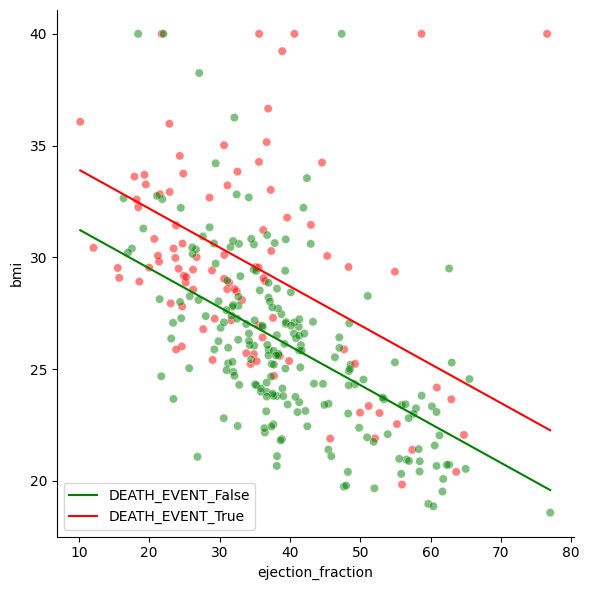

In [69]:
X_plot = np.arange(np.min(df['ejection_fraction']), np.max(df['ejection_fraction']), 0.1).reshape(-1, 1)
X_plot = sm.add_constant(X_plot)

# Create two versions of X_plot, one with the binary variable = 0, one with binary variable = 1
X_plot_0 = np.hstack([X_plot, np.zeros((X_plot.shape[0], 1))])  # Add column of 0's for binary_var = 0
X_plot_1 = np.hstack([X_plot, np.ones((X_plot.shape[0], 1))])   # Add column of 1's for binary_var = 1

y_plot_0 = results.predict(X_plot_0)  # Prediction for binary_var = 0
y_plot_1 = results.predict(X_plot_1)  # Prediction for binary_var = 1

sns.relplot(x="ejection_fraction", y="bmi", height=6, data=df, legend=False, hue='DEATH_EVENT', palette={0: 'green', 1: 'red'}, alpha=.5)

sns.lineplot(x=X_plot[:, 1], y=y_plot_0, color='green', label='DEATH_EVENT_False')
sns.lineplot(x=X_plot[:, 1], y=y_plot_1, color='red', label='DEATH_EVENT_True')

In [70]:
y_pred = results.predict(X_test_9)
r2 = r2_score(y_test,y_pred)
mse = mean_squared_error(y_test,y_pred)
n = len(y_test)
p = X_test_9.shape[1]
adj_r2 = 1 - (1 - r2) * (n - 1) / (n - p - 1)
print(f'R2: {r2:.4f}')
print(f'adj_R2: {adj_r2:.4f}')
print(f'MSE: {mse:.4f}')

R2: 0.3593
adj_R2: 0.3250
MSE: 9.4958


$$ bmi = \beta_0 + \beta_1 \cdot ef + \beta_2 \cdot creatinine + \beta_3 \cdot ef \cdot creatinine + \beta_4 \cdot creatinine^2 + \beta_5 \cdot death+ \epsilon $$

In [71]:
num_variables = ['ejection_fraction', 'serum_creatinine']
cat_variables = ['DEATH_EVENT_True']

X_train_9_num = X_train[num_variables]
X_test_9_num = X_test[num_variables]

X_train_9_cat = df_encoded.loc[train_index, cat_variables]
X_test_9_cat = df_encoded.loc[test_index, cat_variables]

# Perform Polynomial Features transformation on the numerical data
polynomial2 = PolynomialFeatures(degree=2, include_bias=True)
X_train_9_poly = polynomial2.fit_transform(X_train_9_num)
X_test_9_poly = polynomial2.fit_transform(X_test_9_num)

# Scale the polynomial features except for the bias (constant) term
scaler = StandardScaler()
X_train_9_poly[:, 1:] = scaler.fit_transform(X_train_9_poly[:, 1:])
X_test_9_poly[:, 1:] = scaler.transform(X_test_9_poly[:, 1:])

# Concatenate the polynomial features with the one-hot encoded categorical variable
X_train_9 = np.concatenate([X_train_9_poly, X_train_9_cat], axis=1)
X_test_9 = np.concatenate([X_test_9_poly, X_test_9_cat], axis=1)

# Convert to DataFrame for easier handling
cols_poly = polynomial2.get_feature_names_out(num_variables)
cols = np.concatenate([cols_poly, X_train_9_cat.columns])

X_train_9 = pd.DataFrame(X_train_9, columns=cols, index=train_index)
X_test_9 = pd.DataFrame(X_test_9, columns=cols, index=test_index)

X_train_9.drop('ejection_fraction^2', axis=1, inplace=True)
X_test_9.drop('ejection_fraction^2', axis=1, inplace=True)


In [72]:
model = sm.OLS(y_train, X_train_9)
results = model.fit()
print(results.summary())

                            OLS Regression Results                            
Dep. Variable:                    bmi   R-squared:                       0.823
Model:                            OLS   Adj. R-squared:                  0.819
Method:                 Least Squares   F-statistic:                     216.6
Date:                Sun, 13 Jul 2025   Prob (F-statistic):           1.79e-85
Time:                        15:42:45   Log-Likelihood:                -496.43
No. Observations:                 239   AIC:                             1005.
Df Residuals:                     233   BIC:                             1026.
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                                         coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------------------
1   

In [73]:
y_pred = results.predict(X_test_9)
r2 = r2_score(y_test,y_pred)
mse = mean_squared_error(y_test,y_pred)
n = len(y_test)
p = X_test_9.shape[1]
adj_r2 = 1 - (1 - r2) * (n - 1) / (n - p - 1)
print(f'R2: {r2:.4f}')
print(f'adj_R2: {adj_r2:.4f}')
print(f'MSE: {mse:.4f}')

R2: 0.6707
adj_R2: 0.6334
MSE: 4.8809


## Diagnostics

Let's check the assumptions of linear regression.

Assumptions:

1. There is a linear relationship between the predictors and the response
2. $\epsilon_i$ (residuals) are indipendent
3. $Var(\epsilon_i) = \sigma^2 \quad \forall i $ (homoschedasticity)

and for inference:

4. $\epsilon_i \sim N(0,\sigma^2) \quad \forall i$ (normality) --- or at least large $n$ (sample size)

Let's consider the model

$$ bmi = \beta_0 + \beta_1 \cdot ef + \beta_2 \cdot creatinine + \beta_3 \cdot \text{creatinine_phosphokinase} + \epsilon $$

In [74]:
variables = ['ejection_fraction', 'serum_creatinine', 'creatinine_phosphokinase']

X_train_5 = X_train[variables]
X_test_5 = X_test[variables]
X_train_5 = sm.add_constant(X_train_5)
X_test_5 = sm.add_constant(X_test_5)

In [75]:
model = sm.OLS(y_train, X_train_5)
results = model.fit()
print(results.summary())

                            OLS Regression Results                            
Dep. Variable:                    bmi   R-squared:                       0.781
Model:                            OLS   Adj. R-squared:                  0.778
Method:                 Least Squares   F-statistic:                     279.6
Date:                Sun, 13 Jul 2025   Prob (F-statistic):           3.16e-77
Time:                        15:42:56   Log-Likelihood:                -521.77
No. Observations:                 239   AIC:                             1052.
Df Residuals:                     235   BIC:                             1065.
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
                               coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------------
const                   

## Independence

Results summary includes Durbin-Watson test. The values of its test statistics are between 0 and 4. Values near 2 indicates no autocorrelation (independence), smaller values indicate positive autocorrelation, higher values negative autocorrelation

In [76]:
from statsmodels.stats.stattools import durbin_watson

In [77]:
durbin_watson(results.resid)

np.float64(2.119393199637481)

## Linearity and Homoschedasticity

We can visually inspect the residuals to check both

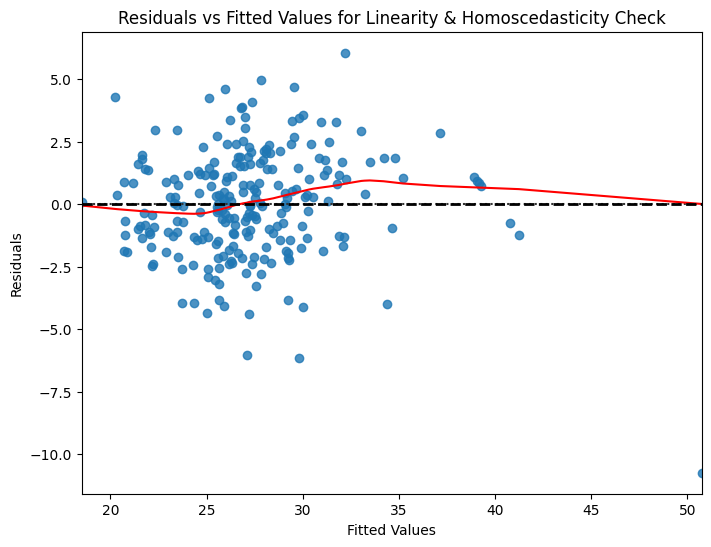

In [78]:
fitted_vals = results.fittedvalues
residuals = results.resid

plt.figure(figsize=(8, 6))
sns.residplot(x=fitted_vals, y=residuals, lowess=True,
              line_kws={'color': 'red', 'lw': 1.5})  # Add a smooth trendline

plt.axhline(0, color='black', linestyle='--', lw=2)  # Horizontal line at 0
plt.xlabel('Fitted Values')
plt.ylabel('Residuals')
plt.title('Residuals vs Fitted Values for Linearity & Homoscedasticity Check')
plt.show()

Breusch-Pagan statistical test for homoschedascity.

*H0: residuals are homoschedastic*

In [79]:
from statsmodels.stats.diagnostic import het_breuschpagan

bp_test = het_breuschpagan(results.resid, X_train_5)

print(f'p-value: {bp_test[1]}')

p-value: 1.6482512198890997e-06


## Gaussianity

Results summary includes the Jacques-Bera test for normality on residuals.

*H0: data are gaussian.*

This test has poor power for n < 100.

Other methods we previosly saw are the QQ-plot (graphical) and the Shapiro-Wilk test (good power for n < 2000)

In [80]:
print(f'Jacques-Bera test p-value: {results.diagn["jbpv"]:.4f}')

Jacques-Bera test p-value: 0.0000


In [81]:
sw = stats.shapiro(results.resid).pvalue
print(f'Shapiro-Wilk test p-value: {sw:.4f}')

Shapiro-Wilk test p-value: 0.0009


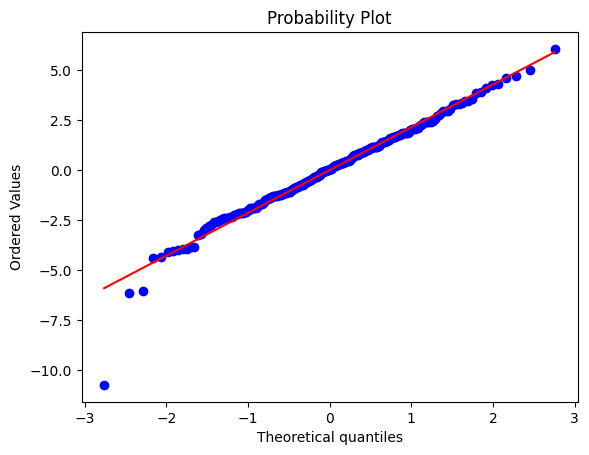

In [82]:
stats.probplot(results.resid, dist="norm", plot=plt)
plt.show()

## Transform y

In [83]:
y_train_10 = np.sqrt(y_train)
y_test_10 = np.sqrt(y_test)

# y_train_10 = np.log(y_train + 1)
# y_test_10 = np.log(y_test + 1)

# y_train_10 = np.cbrt(y_train)
# y_test_10 = np.cbrt(y_test)

model = sm.OLS(y_train_10, X_train_5)
results_new = model.fit()
print(results.summary())

                            OLS Regression Results                            
Dep. Variable:                    bmi   R-squared:                       0.781
Model:                            OLS   Adj. R-squared:                  0.778
Method:                 Least Squares   F-statistic:                     279.6
Date:                Sun, 13 Jul 2025   Prob (F-statistic):           3.16e-77
Time:                        15:43:17   Log-Likelihood:                -521.77
No. Observations:                 239   AIC:                             1052.
Df Residuals:                     235   BIC:                             1065.
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
                               coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------------
const                   

In [84]:
y_pred = results_new.predict(X_test_5)
r2 = r2_score(y_test_10,y_pred)
mse = mean_squared_error(y_test_10,y_pred)
n = len(y_test)
p = X_test_5.shape[1]
adj_r2 = 1 - (1 - r2) * (n - 1) / (n - p - 1)
print(f'R2: {r2:.4f}')
print(f'adj_R2: {adj_r2:.4f}')
print(f'MSE: {mse:.4f}')

R2: 0.6270
adj_R2: 0.5999
MSE: 0.0503


In [85]:
sw = stats.shapiro(results_new.resid).pvalue
print(f'Shapiro-Wilk test p-value: {sw:.4f}')

Shapiro-Wilk test p-value: 0.0013


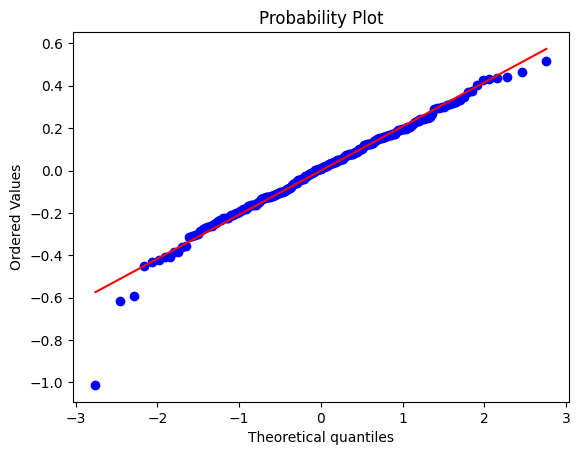

In [86]:
stats.probplot(results_new.resid, dist="norm", plot=plt)
plt.show()

## Leverages & outliers

**Outliers**: points with a very high residual (bad fit)
Residuals are standardized so to make it easier to spot outliers (those outside +- 2 or +- 3)

**Leverages**: points with unusual value

Hat Matrix $H$ s.t. $\hat{y}=Hy$

$H = X(X^TX)^{-1}X^T$

the leverage of point $i$ is $h_{ii} = x_i^T(X^TX)^{-1}x_i \in (0,1)$



**Cook's distanc**e: a mease of the point's overall influence of the model

$$
D_i = \frac{\epsilon_i^2}{k \cdot \sigma^2} \cdot \frac{h_{ii}}{(1-h_{ii})^2}
$$

comined the size of the (standardized) residuals, with respect to the model parameters, and the leverage

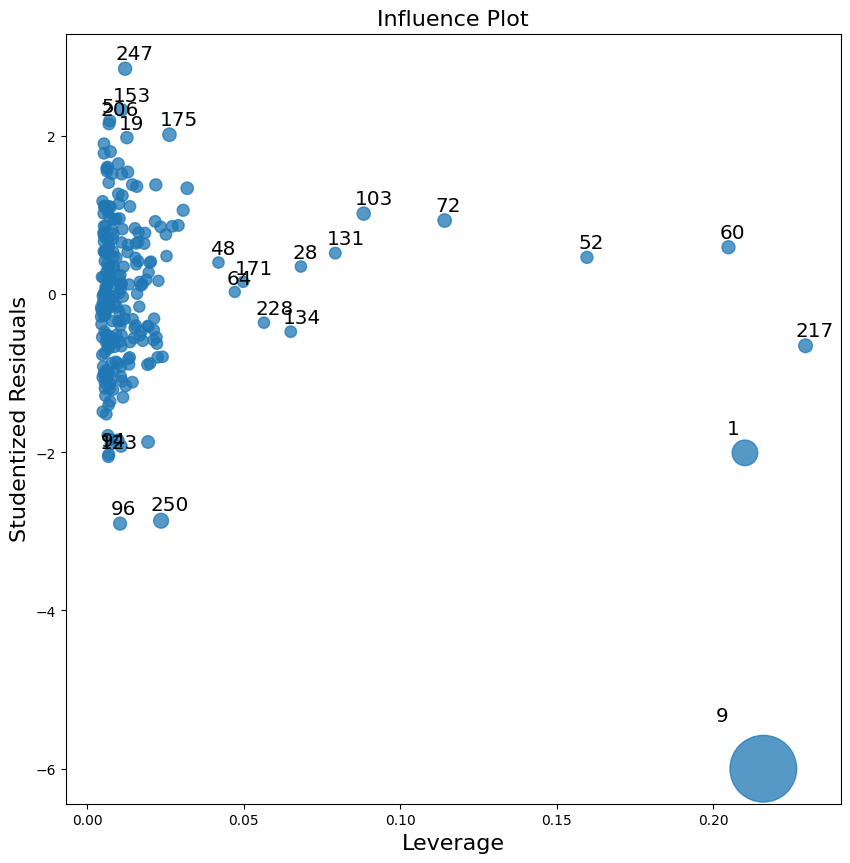

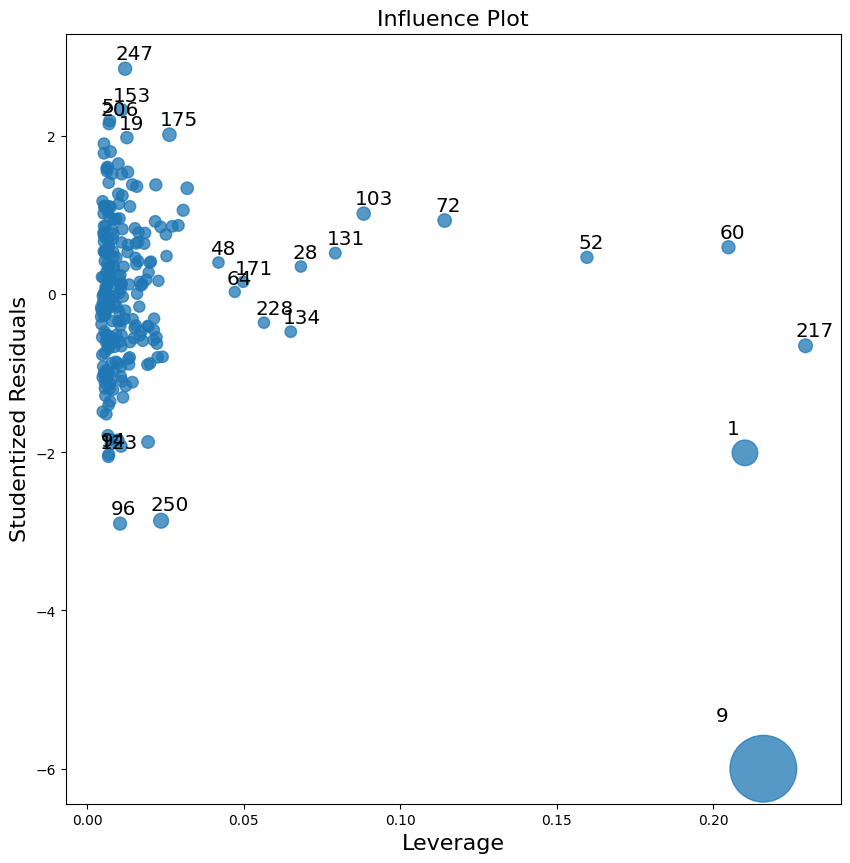

In [87]:
fig, ax = plt.subplots(figsize=(10,10))
sm.graphics.influence_plot(results, criterion="cooks", ax=ax)

In [88]:
influence = results.get_influence()

influence_df = influence.summary_frame()[['cooks_d', 'student_resid', 'hat_diag']]

influence_df = influence_df.rename(columns={'hat_diag': 'leverage'}).sort_values(by='cooks_d', ascending=False)

influence_df

,cooks_d,student_resid,leverage
9,2.16,-6.00,0.22
1,0.26,-2.01,0.21
250,0.05,-2.86,0.02
217,0.03,-0.65,0.23
72,0.03,0.93,0.11
...,...,...,...
37,0.00,0.01,0.01
135,0.00,0.02,0.01
246,0.00,0.01,0.02
214,0.00,-0.01,0.01


In [89]:
X_train_5.loc[9]

const                        1.00
ejection_fraction           35.63
serum_creatinine             9.40
creatinine_phosphokinase   123.00
Name: 9, dtype: float64

## Removing high leverage outliers

In [91]:
to_remove = [9]

X_train_11 = X_train_5.drop(to_remove)
y_train_11 = y_train.drop(to_remove)
X_test_11 = X_test_5
y_test_11 = y_test
model = sm.OLS(y_train_11, X_train_11)
results = model.fit()
print(results.summary())

                            OLS Regression Results                            
Dep. Variable:                    bmi   R-squared:                       0.804
Model:                            OLS   Adj. R-squared:                  0.801
Method:                 Least Squares   F-statistic:                     319.9
Date:                Sun, 13 Jul 2025   Prob (F-statistic):           1.76e-82
Time:                        15:43:34   Log-Likelihood:                -503.04
No. Observations:                 238   AIC:                             1014.
Df Residuals:                     234   BIC:                             1028.
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
                               coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------------
const                   

In [92]:
sw = stats.shapiro(results.resid).pvalue
print(f'Shapiro-Wilk test p-value: {sw:.4f}')

Shapiro-Wilk test p-value: 0.9159


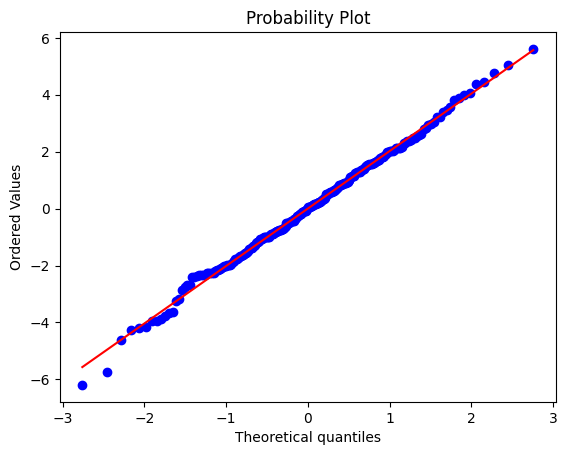

In [93]:
stats.probplot(results.resid, dist="norm", plot=plt)
plt.show()

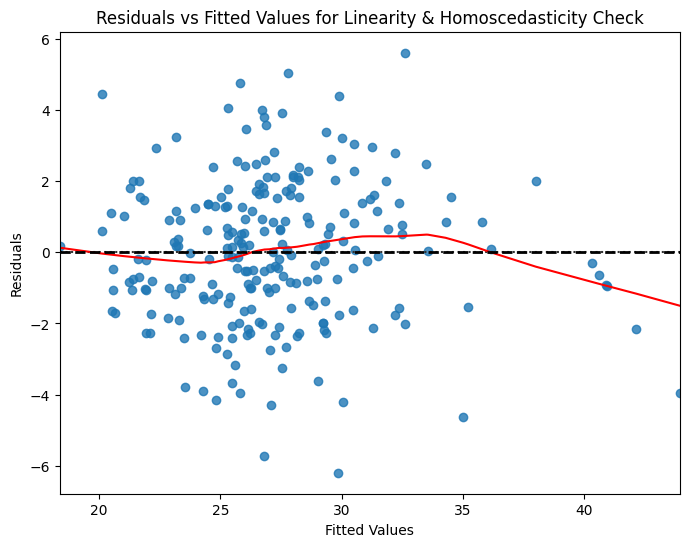

In [94]:
fitted_vals = results.fittedvalues
residuals = results.resid

plt.figure(figsize=(8, 6))
sns.residplot(x=fitted_vals, y=residuals, lowess=True,
              line_kws={'color': 'red', 'lw': 1.5})  # Add a smooth trendline

plt.axhline(0, color='black', linestyle='--', lw=2)  # Horizontal line at 0
plt.xlabel('Fitted Values')
plt.ylabel('Residuals')
plt.title('Residuals vs Fitted Values for Linearity & Homoscedasticity Check')
plt.show()

In [95]:
from statsmodels.stats.diagnostic import het_breuschpagan

bp_test = het_breuschpagan(results.resid, X_train_11)

print(f'p-value: {bp_test[1]}')

p-value: 0.45266279791912245


## Anscombe dataset

Four datasets with nearly identical:

* Mean of
𝑥
x and
𝑦
y

* Variance of
𝑥
x and
𝑦
y

* Correlation between
𝑥
x and
𝑦
y

* Regression line (𝑦 = 3.00 + 0.50𝑥 )

* $𝑅^2$
  and residual standard error

In [ ]:
import seaborn as sns
import pandas as pd
import matplotlib.pyplot as plt
import statsmodels.api as sm

# Load the built-in Anscombe dataset
df = sns.load_dataset("anscombe")

# Prepare containers
datasets = ['I', 'II', 'III', 'IV']
models = {}

# Plot setup: 2 rows x 4 columns
fig, axes = plt.subplots(2, 4, figsize=(16, 8))
fig.suptitle("Anscombe's Quartet: Regression & Residuals", fontsize=16)

for i, name in enumerate(datasets):
    data = df[df['dataset'] == name]

    x = data['x']
    y = data['y']
    X = sm.add_constant(x)
    model = sm.OLS(y, X).fit()
    models[name] = model

    # Scatter plot with regression line (top row)
    ax1 = axes[0, i]
    ax1.scatter(x, y, color='blue')
    ax1.plot(x, model.predict(X), color='red')
    ax1.set_title(f'Dataset {i+1}')
    ax1.set_xlabel('x')
    ax1.set_ylabel('y')

    # Residual plot (bottom row)
    ax2 = axes[1, i]
    ax2.scatter(x, model.resid, color='#ff6600')
    ax2.axhline(0, color='gray', linestyle='--')
    ax2.set_title(f'Residuals {i+1}')
    ax2.set_xlabel('x')
    ax2.set_ylabel('Residuals')

# Show all plots
plt.tight_layout(rect=[0, 0, 1, 0.95])
plt.show()

# Print regression summaries
for name, model in models.items():
    print(f"\n=== Summary for Dataset {name} ===")
    print(model.summary())


Dataset III
       x     y  leverage  cooks_distance  residuals  standard_resid
22 10.00  7.46      0.10            0.01      -0.54           -0.46
23  8.00  6.77      0.10            0.00      -0.23           -0.20
24 13.00 12.74      0.24            1.39       3.24            3.00
25  9.00  7.11      0.09            0.01      -0.39           -0.33
26 11.00  7.81      0.13            0.03      -0.69           -0.60
27 14.00  8.84      0.32            0.30      -1.16           -1.14
28  6.00  6.08      0.17            0.00       0.08            0.07
29  4.00  5.39      0.32            0.03       0.39            0.38
30 12.00  8.15      0.17            0.06      -0.85           -0.76
31  7.00  6.42      0.13            0.00      -0.08           -0.07
32  5.00  5.73      0.24            0.01       0.23            0.21


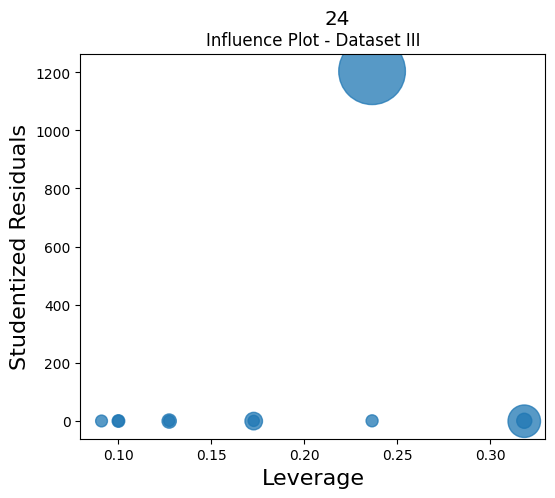

Dataset IV
       x     y  leverage  cooks_distance  residuals  standard_resid
33  8.00  6.58      0.10            0.01      -0.42           -0.36
34  8.00  5.76      0.10            0.06      -1.24           -1.06
35  8.00  7.71      0.10            0.02       0.71            0.60
36  8.00  8.84      0.10            0.14       1.84            1.57
37  8.00  8.47      0.10            0.09       1.47            1.25
38  8.00  7.04      0.10            0.00       0.04            0.03
39  8.00  5.25      0.10            0.12      -1.75           -1.49
40 19.00 12.50      1.00             NaN       0.00             NaN
41  8.00  5.56      0.10            0.08      -1.44           -1.23
42  8.00  7.91      0.10            0.03       0.91            0.78
43  8.00  6.89      0.10            0.00      -0.11           -0.10


/usr/local/lib/python3.11/dist-packages/statsmodels/stats/outliers_influence.py:847: RuntimeWarning: invalid value encountered in sqrt
  return self.resid / sigma / np.sqrt(1 - hii)
/usr/local/lib/python3.11/dist-packages/statsmodels/stats/outliers_influence.py:847: RuntimeWarning: invalid value encountered in sqrt
  return self.resid / sigma / np.sqrt(1 - hii)


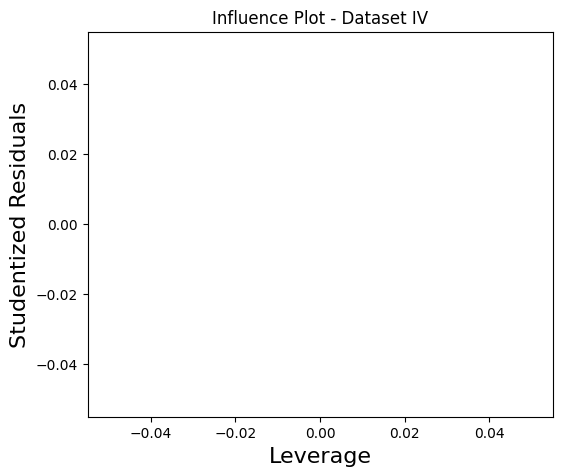

In [ ]:
## TODO: for datasets III and IV compute leverages and Cook distances
for dataset_label in ['III', 'IV']:
    print(f"Dataset {dataset_label}")

    # Filter data
    data = df[df['dataset'] == dataset_label]
    x = data['x']
    y = data['y']
    X = sm.add_constant(x)

    # Fit OLS model
    model = sm.OLS(y, X).fit()

    # Get influence measures
    influence = model.get_influence()
    leverage = influence.hat_matrix_diag
    cooks_d = influence.cooks_distance[0]  # [0] is Cook's D values, [1] are p-values

    # Create result DataFrame
    diagnostics_df = pd.DataFrame({
        'x': x,
        'y': y,
        'leverage': leverage,
        'cooks_distance': cooks_d,
        'residuals': model.resid,
        'standard_resid': influence.resid_studentized_internal
    }, index=data.index)

    print(diagnostics_df.round(3))

    # Influence plot
    fig, ax = plt.subplots(figsize=(6, 5))
    sm.graphics.influence_plot(model, ax=ax, criterion="cooks")
    plt.title(f'Influence Plot - Dataset {dataset_label}')
    plt.show()

## Bias-variance tradeoff

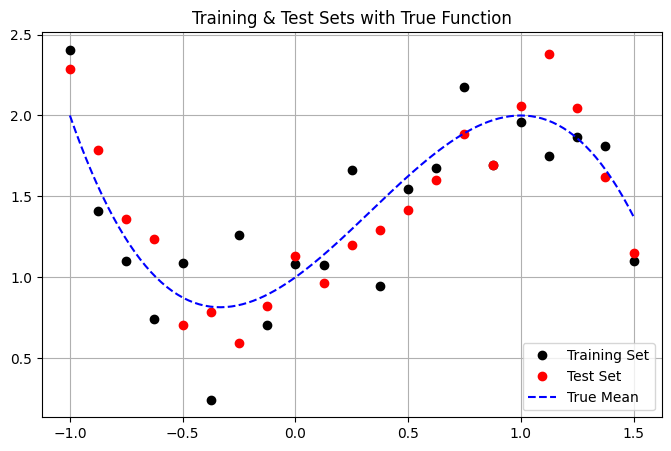

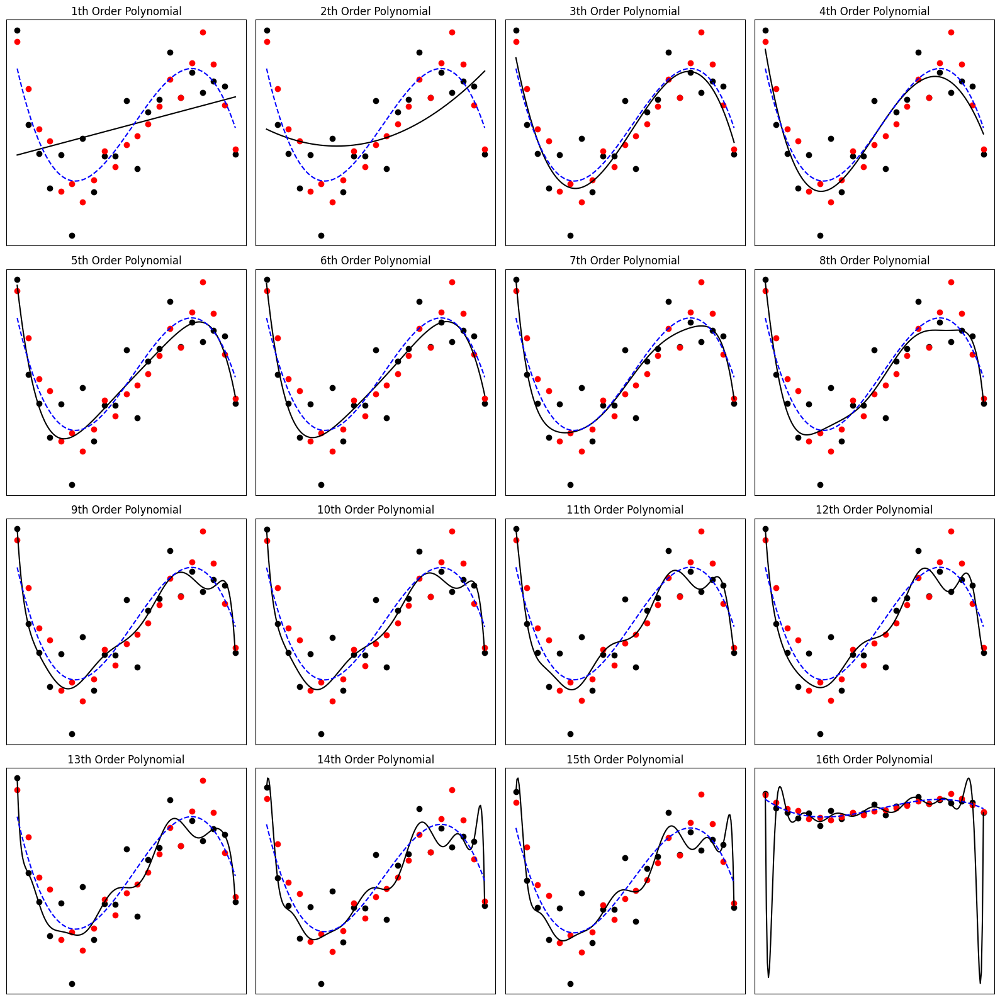

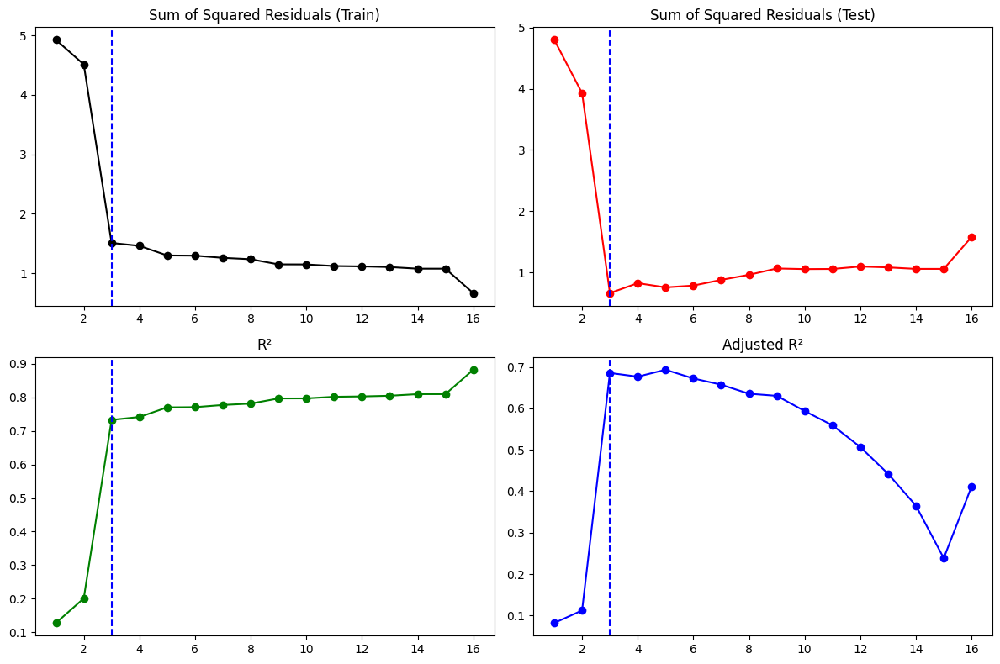

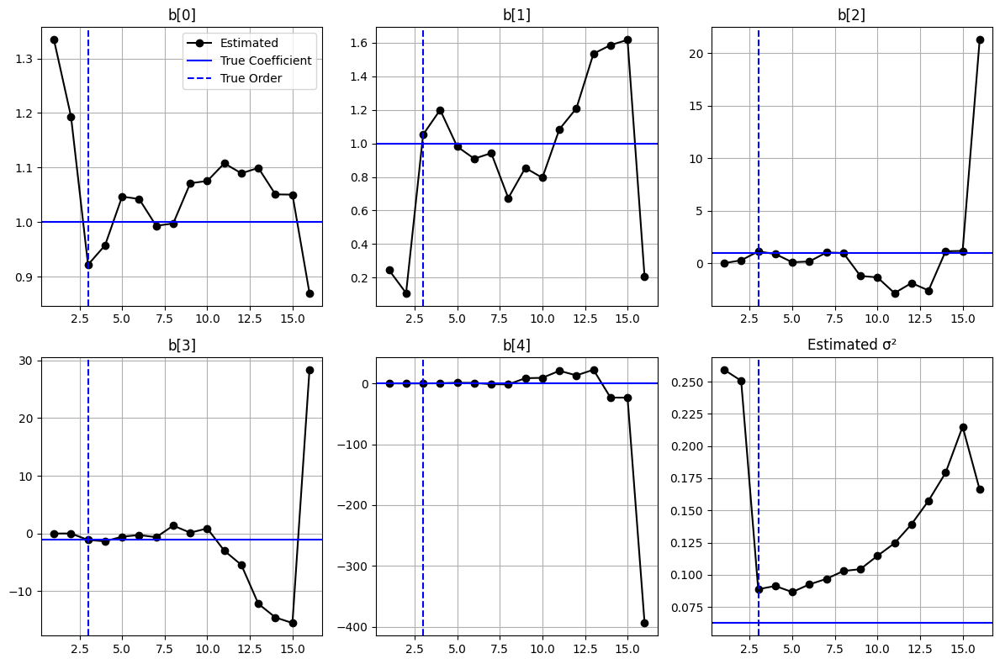

In [97]:
from sklearn.metrics import r2_score

np.random.seed(1)

# True model
def f(x): return 1 + x + x**2 - x**3
sigma = 0.25

# Generate data
x = np.linspace(-1, 1.5, 21)
y = f(x) + np.random.normal(0, sigma, size=x.shape)
y_new = f(x) + np.random.normal(0, sigma, size=x.shape)

# Build design matrix up to x^20
X = np.column_stack([x**p for p in range(21)])
X_df = pd.DataFrame(X, columns=[f'x{p}' for p in range(21)])

# Grid for plotting
x_plot = np.linspace(-1, 1.5, 210)
X_plot = np.column_stack([x_plot**p for p in range(21)])
X_plot_df = pd.DataFrame(X_plot, columns=[f'x{p}' for p in range(21)])

# Plot data with true curve
plt.figure(figsize=(8, 5))
plt.plot(x, y, 'ko', label='Training Set')
plt.plot(x, y_new, 'ro', label='Test Set')
plt.plot(x_plot, f(x_plot), 'b--', label='True Mean')
plt.legend(loc='lower right')
plt.title("Training & Test Sets with True Function")
plt.grid(True)
plt.show()

# Metrics to store
SSres, SSres_new, s2, R2, R2_adj, coeffs_all = [], [], [], [], [], []
n = len(x)

# Fit and plot polynomial models
plt.figure(figsize=(16, 16))
for p in range(1, 17):
    X_train_p = X_df.iloc[:, :p+1]
    X_plot_p = X_plot_df.iloc[:, :p+1]

    model = sm.OLS(y, X_train_p).fit()
    y_pred = model.predict(X_train_p)
    y_pred_new = model.predict(X_train_p)
    y_plot = model.predict(X_plot_p)

    # Plot the fit
    plt.subplot(4, 4, p)
    plt.plot(x, y, 'ko', label='Train')
    plt.plot(x, y_new, 'ro', label='Test')
    plt.plot(x_plot, y_plot, 'k-', label='Model')
    plt.plot(x_plot, f(x_plot), 'b--', label='True')
    plt.title(f'{p}th Order Polynomial')
    plt.xticks([]); plt.yticks([])

    # Store metrics
    res = y - y_pred
    res_new = y_new - y_pred_new
    SSres.append(np.sum(res**2))
    SSres_new.append(np.sum(res_new**2))
    s2.append(np.sum(res**2) / (n - (p + 1)))
    r2 = r2_score(y, y_pred)
    R2.append(r2)
    R2_adj.append(1 - (1 - r2) * (n - 1) / (n - p - 1))

    # Coefficients
    coeffs = np.zeros(17)
    coeffs[:p+1] = model.params
    coeffs_all.append(coeffs)

plt.tight_layout()
plt.show()

# Coefficients matrix
b = np.array(coeffs_all).T

# Compare model performance
plt.figure(figsize=(12, 8))
plt.subplot(2, 2, 1)
plt.plot(range(1, 17), SSres, 'ko-')
plt.axvline(3, color='blue', linestyle='--')
plt.title("Sum of Squared Residuals (Train)")

plt.subplot(2, 2, 2)
plt.plot(range(1, 17), SSres_new, 'ro-')
plt.axvline(3, color='blue', linestyle='--')
plt.title("Sum of Squared Residuals (Test)")

plt.subplot(2, 2, 3)
plt.plot(range(1, 17), R2, 'go-')
plt.axvline(3, color='blue', linestyle='--')
plt.title("R²")

plt.subplot(2, 2, 4)
plt.plot(range(1, 17), R2_adj, 'bo-')
plt.axvline(3, color='blue', linestyle='--')
plt.title("Adjusted R²")

plt.tight_layout()
plt.show()

# Compare coefficients
b_true = np.array([1, 1, 1, -1] + [0]*13)
plt.figure(figsize=(12, 8))
for i in range(5):
    plt.subplot(2, 3, i+1)
    plt.plot(range(1, 17), b[i], 'ko-')
    plt.axhline(b_true[i], color='blue')
    plt.axvline(3, color='blue', linestyle='--')
    plt.title(f'b[{i}]')
    plt.grid(True)
    if i == 0:
        plt.legend(['Estimated', 'True Coefficient', 'True Order'])

# Plot estimated variance
plt.subplot(2, 3, 6)
plt.plot(range(1, 17), s2, 'ko-')
plt.axhline(sigma**2, color='blue')
plt.axvline(3, color='blue', linestyle='--')
plt.title("Estimated σ²")
plt.grid(True)

plt.tight_layout()
plt.show()


# LAB 7

**<font size="5">Applied Statistics</font>**

<font size="3">MSc in High Performance Computing Engineering, Computer Science and Engineering, Physics Engineering - A.Y. 2024-2025</font>

Prof. Mario Beraha - Dott. Vittorio Torri

---

<font size="4">**Lab 7 - Logistic Regression**</font>

## Libraries

In [2]:
import pandas as pd
pd.options.display.float_format = '{:.2f}'.format

In [3]:
import matplotlib.pyplot as plt
import seaborn as sns

In [4]:
import numpy as np

In [5]:
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.model_selection import train_test_split

In [6]:
import statsmodels.api as sm

In [7]:
np.random.seed(1234)

In [8]:
import scipy.stats as stats

## Load Dataset

In [9]:
df = pd.read_csv('../DatasetsLabs/heart_failure_clinical_records_dataset_smhd.csv')  # Adjust the path as necessary

In [10]:
cat_vars = ['anaemia', 'diabetes', 'high_blood_pressure',  'sex',  'smoking',  'DEATH_EVENT']
num_vars = ['age', 'creatinine_phosphokinase', 'ejection_fraction', 'platelets', 'serum_creatinine', 'serum_sodium', 'bmi', 'time']

## Binary Logistic Regression

We want to build a model to classify patients as dead or survived during follow-up: binary classification.

We use a logistic regression model, which models the probability of the positive class (death) in the following way, where $x_1, ..., x_p$ are the input variables

$$
P(y = 1 | x) = \frac{1}{1 + e^{-(\beta_0 + \beta_1 x_1 + \beta_2 x_2 + \dots + \beta_p x_p)}}
$$


## Model

In [11]:
X = df[['age', 'bmi', 'anaemia', 'creatinine_phosphokinase', 'diabetes', 'high_blood_pressure', 'platelets', 'serum_creatinine', 'serum_sodium', 'sex', 'smoking', 'ejection_fraction', 'time']]
y = df['DEATH_EVENT']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20, random_state=1234)

train_index = X_train.index
test_index = X_test.index

We start using all numerical variables

In [12]:
X_train_1 = X_train[num_vars]
X_test_1 = X_test[num_vars]

# Fit the logistic regression model
logit_model = sm.Logit(y_train, X_train_1).fit()

print(logit_model.summary())

Optimization terminated successfully.
         Current function value: 0.376649
         Iterations 7
                           Logit Regression Results                           
Dep. Variable:            DEATH_EVENT   No. Observations:                  239
Model:                          Logit   Df Residuals:                      231
Method:                           MLE   Df Model:                            7
Date:                Sun, 13 Jul 2025   Pseudo R-squ.:                  0.4036
Time:                        15:46:11   Log-Likelihood:                -90.019
converged:                       True   LL-Null:                       -150.95
Covariance Type:            nonrobust   LLR p-value:                 3.151e-23
                               coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------
age                          0.0501      0.017      2.979      0.003       0.017

By default statsmodels uses the Newton-Raphson iterative optimization method to maximize the likelihood, but other methods can be specified

Statsmodels compute the pseudo R^2 statistics using the McFadden's definition:

$$pseudo_{R^2} = 1 - \frac{LL}{LL_{Null}}$$

It has values from 0 to 1 and it indicates the goodness of the model, but it's not the primary metric used to evaluate LR models

## Odds Ratios

L'odd ratio è P/1-P cioè la probabilità che l'evento accade diviso la probabilità che l'evento non accade. L'odd ratio per una variabile è e^(coefficient), quindi:
- odds ratio = 1 la variabile non ha effetto (coefficient = 0)
- > 1 la variabile aumenta la prob dell'evneto
- < 1 la variabile diminuisce la prob dell'evneto

In a logistic model, the effect of the coefficient is different from a linear regression model. A k-unit increase in $x_j$ increases the risk by a factor of $exp(k \cdot \hat{\beta_j})$. Odds ratios are defined as:

$$
OR_j = exp(\hat{\beta_j})
$$

In [13]:
coef = logit_model.params
odds_ratios = np.exp(coef)

conf = logit_model.conf_int()
conf.columns = ['2.5%', '97.5%']
conf = np.exp(conf)  # Exponentiate to get ORs' CIs

or_summary = pd.DataFrame({
    "Coefficient": coef,
    "Odds Ratio": odds_ratios,
    "2.5% CI OR": conf['2.5%'],
    "97.5% CI OR": conf['97.5%']
})

print(or_summary)

                          Coefficient  Odds Ratio  2.5% CI OR  97.5% CI OR
age                              0.05        1.05        1.02         1.09
creatinine_phosphokinase         0.00        1.00        1.00         1.00
ejection_fraction               -0.05        0.95        0.91         0.99
platelets                       -0.00        1.00        1.00         1.00
serum_creatinine                 0.52        1.69        0.88         3.24
serum_sodium                    -0.01        0.99        0.95         1.03
bmi                              0.07        1.07        0.91         1.27
time                            -0.02        0.98        0.97         0.99


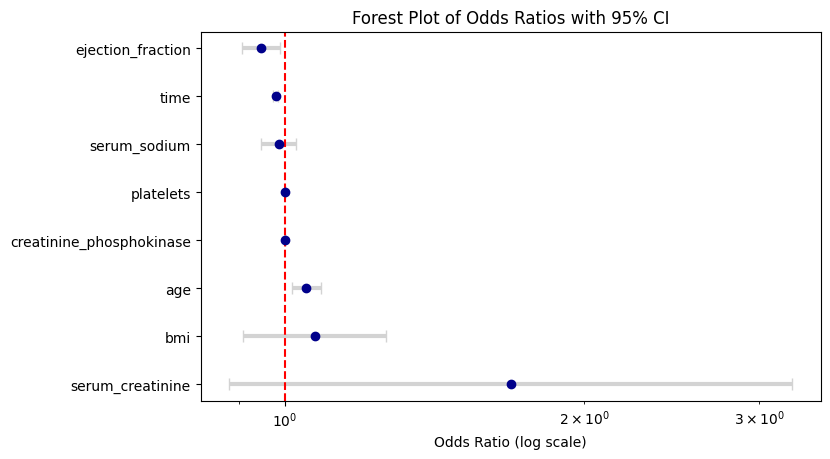

In [14]:
# Sort by odds ratio for better visualization
or_summary = or_summary.sort_values(by="Odds Ratio", ascending=False)

fig, ax = plt.subplots(figsize=(8, len(or_summary) * 0.6))

# Plot the OR as points
ax.errorbar(or_summary['Odds Ratio'], or_summary.index,
            xerr=[or_summary['Odds Ratio'] - or_summary['2.5% CI OR'], or_summary['97.5% CI OR'] - or_summary['Odds Ratio']],
            fmt='o', color='darkblue', ecolor='lightgray', elinewidth=3, capsize=4)

# Add a vertical line at OR = 1 (no effect)
ax.axvline(1, color='red', linestyle='--')

# Set labels
ax.set_xlabel("Odds Ratio (log scale)")
ax.set_title("Forest Plot of Odds Ratios with 95% CI")
ax.set_xscale("log")  # Log scale for better visualization

plt.show()

Infatti come si può notare all'aumentare della age, si avrà sempre un aumento della probabilità di morte

## Confusion Matrix

In [15]:
from sklearn.metrics import confusion_matrix

In [16]:
y_test_pred_prob = logit_model.predict(X_test_1)

In [17]:
y_test_pred_prob

73    0.28
110   0.27
291   0.02
168   0.17
289   0.03
124   0.81
286   0.03
164   0.29
296   0.00
261   0.01
138   0.37
166   0.03
66    0.58
69    0.70
101   0.32
7     0.26
260   0.01
145   0.20
287   0.00
112   0.59
163   0.17
100   0.58
40    0.93
6     0.95
22    0.74
223   0.05
213   0.05
108   0.45
283   0.03
132   0.20
106   0.28
234   0.02
186   0.01
149   0.20
273   0.01
235   0.03
74    0.76
227   0.04
274   0.04
31    0.94
127   0.04
156   0.15
125   0.08
181   0.30
221   0.03
242   0.01
229   0.08
170   0.15
276   0.03
99    0.37
29    0.87
80    0.56
67    0.72
210   0.27
93    0.68
241   0.07
205   0.03
122   0.12
244   0.05
162   0.12
dtype: float64

In [18]:
# Convert probabilities to binary outcomes based on a threshold
threshold = 0.5
y_test_pred_class = (y_test_pred_prob > threshold).astype(int)

In [20]:
print("Confusion Matrix on Test Set:")
print(confusion_matrix(y_test, y_test_pred_class))

Confusion Matrix on Test Set:
[[39  3]
 [ 7 11]]


With a more nice visualization:

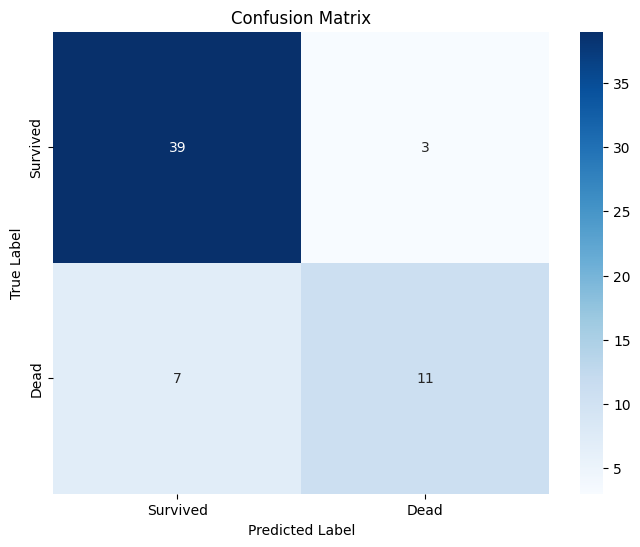

In [21]:
cm = confusion_matrix(y_test, y_test_pred_class)

class_names = ['Survived', 'Dead']

plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", xticklabels=class_names, yticklabels=class_names)
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.title("Confusion Matrix")
plt.show()

[  TN    FP  
   FN    TP]

## AUC

The Receiver-Operating-Characteristic Curve (ROC Curve) plots the FPR vs TPR at varying the classification threshold from 0 to 1, where

$$TPR = \frac{TP}{TP+FN} (= Sensitivity = Recall)$$

$$FPR = \frac{FP}{FP+TN}$$

The ideal point is (0,1), which maximizes the TPR and minimizes the FPR

The Area Under the Curve (AUC) is a measure of goodness of the model that is not influences by the choice of a classification threshold

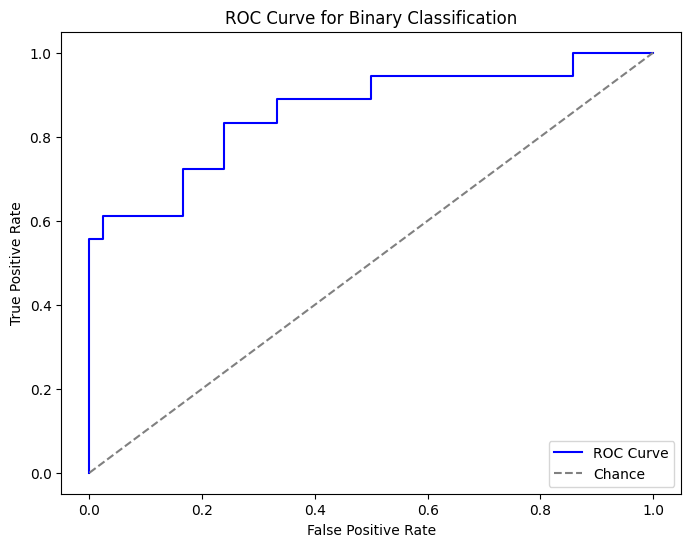

In [22]:
from sklearn.metrics import roc_curve

fpr, tpr, _ = roc_curve(y_test, y_test_pred_prob)

# Plot the ROC Curve
plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, color='blue', label=f"ROC Curve")

# Plot the diagonal line representing random chance
plt.plot([0, 1], [0, 1], color='gray', linestyle='--', label="Chance")

# Labels and legend
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("ROC Curve for Binary Classification")
plt.legend(loc="lower right")
plt.show()


In [23]:
from sklearn.metrics import roc_auc_score

auc_score = roc_auc_score(y_test, y_test_pred_prob)
print(f"ROC-AUC Score on Test Set: {auc_score}")

ROC-AUC Score on Test Set: 0.8597883597883599


## Accuracy, Precision, Recall/Sensitivity, F1-Score, Specificity

$$Accuracy = \frac{TP+TN}{TP+FP+TN+FN}$$
$$Precision = \frac{TP}{TP+FP}$$
$$Recall = Sensitivity = \frac{TP}{TP+FN}$$
$$\text{F1-Score} = \frac{2 \cdot Precision \cdot Recall}{Precision + Recall}$$
$$Specificity = \frac{TN}{TN+FP}$$

In [24]:
from sklearn.metrics import classification_report

print("\nClassification Report on Test Set:")
print(classification_report(y_test, y_test_pred_class, target_names=['Survived', 'Dead']))


Classification Report on Test Set:
              precision    recall  f1-score   support

    Survived       0.85      0.93      0.89        42
        Dead       0.79      0.61      0.69        18

    accuracy                           0.83        60
   macro avg       0.82      0.77      0.79        60
weighted avg       0.83      0.83      0.83        60



In [25]:
from sklearn.metrics import confusion_matrix
cm = confusion_matrix(y_test, y_test_pred_class)
cm

array([[39,  3],
       [ 7, 11]])

In [26]:
## TODO: try to compute the specificity from the confusion matrix
tn, fp, fn, tp = cm.ravel()
specificity = tn / (tn + fp) #percentuale di negativi che

print(f"Specificity on Test Set: {specificity}") # It is the recall of class that we defined as negative (Survived)

Specificity on Test Set: 0.9285714285714286


## Choice of the threshold

Using 0.5 as threshold is the most common choice, but it might not be the optimal one, especially in case of class unbalance

One suggest value is the percentage of negative samples

In [27]:
optimal_threshold_1 = 1 - df['DEATH_EVENT'].mean() # 1 - % of positive samples

In [28]:
optimal_threshold_1

np.float64(0.6789297658862876)

In [29]:
y_test_pred_class = (y_test_pred_prob > optimal_threshold_1).astype(int)

print("Confusion Matrix on Test Set:")
print(confusion_matrix(y_test, y_test_pred_class))

Confusion Matrix on Test Set:
[[42  0]
 [ 9  9]]


In [30]:
tn, fp, fn, tp = confusion_matrix(y_test, y_test_pred_class).ravel()

tpr_1 = tp / (tp + fn)  # Sensitivity or Recall or TPR
fpr_1 = fp / (fp + tn)  # False Positive Rate (FPR)

In [31]:
print("\nClassification Report on Test Set:")
print(classification_report(y_test, y_test_pred_class, target_names=['Survived', 'Dead']))


Classification Report on Test Set:
              precision    recall  f1-score   support

    Survived       0.82      1.00      0.90        42
        Dead       1.00      0.50      0.67        18

    accuracy                           0.85        60
   macro avg       0.91      0.75      0.78        60
weighted avg       0.88      0.85      0.83        60



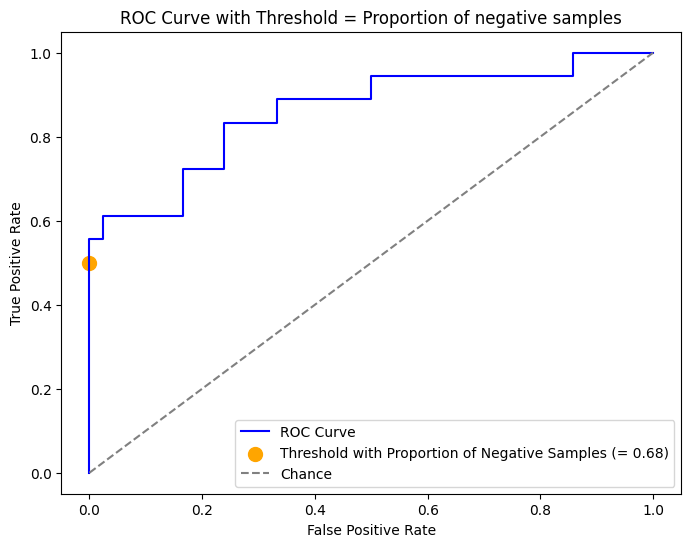

In [32]:
# Plot ROC Curve
plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, color='blue', label=f"ROC Curve")

# Plot the optimal threshold point
plt.scatter(fpr_1, tpr_1, color='orange', s=100, label=f"Threshold with Proportion of Negative Samples (= {optimal_threshold_1:.2f})")


# Plot the diagonal line representing random chance
plt.plot([0, 1], [0, 1], color='gray', linestyle='--', label="Chance")

# Labels and legend
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("ROC Curve with Threshold = Proportion of negative samples")
plt.legend(loc="lower right")
plt.show()

In [33]:
fpr, tpr, thresholds= roc_curve(y_test, y_test_pred_prob)
thresholds

array([           inf, 9.53908076e-01, 6.76273712e-01, 5.93853823e-01,
       5.77516053e-01, 3.24850371e-01, 2.85982628e-01, 2.73123438e-01,
       2.57326703e-01, 1.66578594e-01, 1.66227879e-01, 7.39754074e-02,
       4.85524201e-02, 1.74947868e-02, 1.38845912e-02, 3.97924223e-04])

In [34]:
#calcolare la roc curve per un valore del threshold dato
threshold = 0.5
probabilities = logit_model.predict(X_test_1)
y_pred = [1 if p>threshold else 0 for p in probabilities]
cm = confusion_matrix(y_test, y_pred)
tn, fp, fn, tp = cm.ravel()

# fpr = fp / (fp + tn)
# tpr = tp / (tp + fn)
#oppure

fpr, tpr, thresholds = roc_curve(y_test, probabilities)
thresholds

array([           inf, 9.53908076e-01, 6.76273712e-01, 5.93853823e-01,
       5.77516053e-01, 3.24850371e-01, 2.85982628e-01, 2.73123438e-01,
       2.57326703e-01, 1.66578594e-01, 1.66227879e-01, 7.39754074e-02,
       4.85524201e-02, 1.74947868e-02, 1.38845912e-02, 3.97924223e-04])

## Multiclass logistic regression

We want to develop a model to classify HF patients in three ejection fraction classes

In [35]:
df['ef_cat'] = pd.cut(df['ejection_fraction'], bins=[0,40,50,100], labels=['reduced', 'mildly reduced', 'preserved'])

In [36]:
df[['ejection_fraction', 'ef_cat']]

,ejection_fraction,ef_cat
0,20.73,reduced
1,29.02,reduced
2,26.24,reduced
3,10.21,reduced
4,19.33,reduced
...,...,...
294,38.05,reduced
295,35.20,reduced
296,62.32,preserved
297,37.49,reduced


## Model

A multinomial logistic regression model assumes a baseline class (assume the *K*-th without loss of generality) and computes a set of coefficients for each other class *k*:

$$
P(y = k | x) = \frac{e^{\beta_{k0} + \beta_{k1} x_1 + \beta_{k2} x_2 + \dots + \beta_{kp} x_p}}{1 + \sum_{j=1}^{K-1} e^{\beta_{j0} + \beta_{j1} x_1 + \beta_{j2} x_2 + \dots + \beta_{jp} x_p}} \quad\text{for }k < K \\
P(y = K | x) = \frac{1}{1 + \sum_{j=1}^{K-1} e^{\beta_{j0} + \beta_{j1} x_1 + \beta_{j2} x_2 + \dots + \beta_{jp} x_p}}
$$

The multinomial logistic regression model implemented in the *statsmodels* library requires categorical input variables to be *one-hot encoded*

In [37]:
df_encoded = pd.get_dummies(df, columns=cat_vars, drop_first=True, dtype=int) # another way to apply one-hot encoding

In [ ]:

X = df_encoded[['age', 'bmi', 'serum_sodium', 'serum_creatinine', 'diabetes_1', 'sex_Male', 'smoking_1', 'high_blood_pressure_1', 'anaemia_1']]
y = df_encoded['ef_cat']  # Multiclass target variable

X = sm.add_constant(X)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1234, stratify=y) #STRATIFICATION WITH RESPECT TO THE TARGET CLASS

model = sm.MNLogit(y_train, X_train)
result = model.fit()

result.predict(X_test)

Optimization terminated successfully.
         Current function value: 0.625371
         Iterations 8


,0,1,2
170,0.95,0.04,0.01
237,0.89,0.10,0.01
218,0.88,0.10,0.01
228,0.88,0.12,0.00
264,0.19,0.25,0.55
129,0.46,0.23,0.31
97,0.12,0.12,0.77
139,0.77,0.18,0.05
193,0.92,0.07,0.00
39,0.91,0.08,0.01


In [40]:
np.exp(result.params).rename(columns={0: 'mildly_reduced OR', 1:'preserved OR'})

,mildly_reduced OR,preserved OR
const,15812631.77,40511846878.96
age,1.02,1.00
bmi,0.71,0.41
serum_sodium,0.92,0.95
serum_creatinine,3.16,12.32
diabetes_1,0.92,1.83
sex_Male,1.59,0.94
smoking_1,0.70,1.42
high_blood_pressure_1,0.96,0.74
anaemia_1,0.61,1.37


In [41]:
model._ynames_map

{0: 'reduced', 1: 'mildly reduced', 2: 'preserved'}

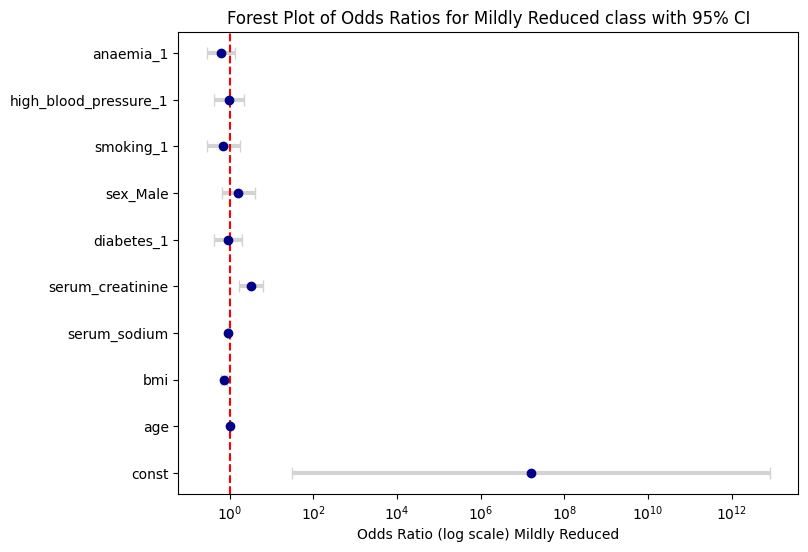

In [42]:
coef = result.params[0]
odds_ratios = np.exp(coef)

conf = result.conf_int().loc['mildly reduced']
conf.columns = ['2.5%', '97.5%']
conf = np.exp(conf)  # Exponentiate to get ORs' CIs

or_summary = pd.DataFrame({
    "Coefficient Mildly Reduced": coef,
    "Odds Ratio Mildly Reduced": odds_ratios,
    "2.5% CI OR Mildly Reduced": conf['2.5%'],
    "97.5% CI OR Mildly Reduced": conf['97.5%']
})

fig, ax = plt.subplots(figsize=(8, len(or_summary) * 0.6))

ax.errorbar(or_summary['Odds Ratio Mildly Reduced'], or_summary.index,
            xerr=[or_summary['Odds Ratio Mildly Reduced'] - or_summary['2.5% CI OR Mildly Reduced'], or_summary['97.5% CI OR Mildly Reduced'] - or_summary['Odds Ratio Mildly Reduced']],
            fmt='o', color='darkblue', ecolor='lightgray', elinewidth=3, capsize=4)

ax.axvline(1, color='red', linestyle='--')

ax.set_xlabel("Odds Ratio (log scale) Mildly Reduced")
ax.set_title("Forest Plot of Odds Ratios for Mildly Reduced class with 95% CI")
ax.set_xscale("log")  # Log scale for better visualization

plt.show()

## Test set evaluation

In [43]:
y_test_pred_prob = result.predict(X_test)  # Returns probabilities for each class
y_test_pred_prob

,0,1,2
170,0.95,0.04,0.01
237,0.89,0.10,0.01
218,0.88,0.10,0.01
228,0.88,0.12,0.00
264,0.19,0.25,0.55
129,0.46,0.23,0.31
97,0.12,0.12,0.77
139,0.77,0.18,0.05
193,0.92,0.07,0.00
39,0.91,0.08,0.01


In [44]:
y_test_pred_prob.rename(model._ynames_map, axis='columns', inplace=True)

y_test_pred_class = y_test_pred_prob.idxmax(axis=1) #for each sample, assign the class with maximum probability

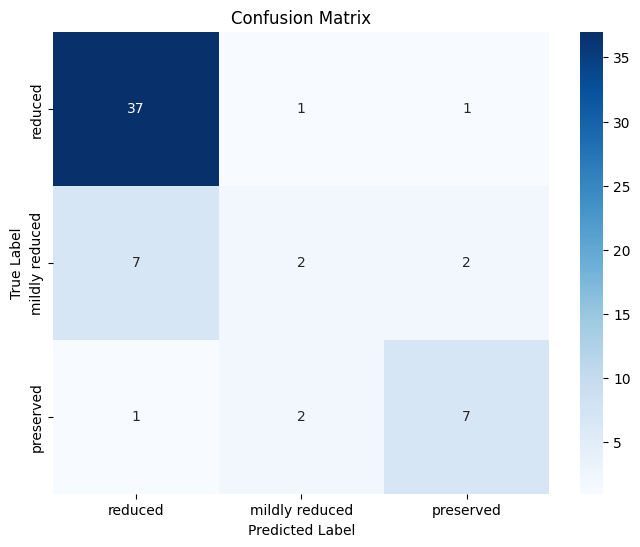

In [45]:
cm = confusion_matrix(y_test, y_test_pred_class, labels=list(model._ynames_map.values()))

class_names = model._ynames_map.values()

plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", xticklabels=class_names, yticklabels=class_names)
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.title("Confusion Matrix")
plt.show()

In [46]:
print("\nClassification Report:")
print(classification_report(y_test, y_test_pred_class))


Classification Report:
                precision    recall  f1-score   support

mildly reduced       0.40      0.18      0.25        11
     preserved       0.70      0.70      0.70        10
       reduced       0.82      0.95      0.88        39

      accuracy                           0.77        60
     macro avg       0.64      0.61      0.61        60
  weighted avg       0.72      0.77      0.74        60



In a multiclass context, the ROC-AUC can be computed per class with a one-vs-all approach

In [47]:
# Compute ROC AUC for each class (one-vs-all)
roc_auc_scores = {}
for i in (y_test_pred_prob.columns):
    roc_auc = roc_auc_score(y_test == i, y_test_pred_prob.loc[:, i])  # Treat class i as positive
    roc_auc_scores[i] = roc_auc

# Output the ROC AUC scores
for class_name, auc in roc_auc_scores.items():
    print(f'ROC AUC for {class_name}: {auc:.2f}')

ROC AUC for reduced: 0.93
ROC AUC for mildly reduced: 0.73
ROC AUC for preserved: 0.95


An aggregate ROC-AUC can be computed in different ways

In [48]:
y_test = y_test.map({'reduced': 0, 'mildly reduced': 1, 'preserved': 2})
y_test_pred_prob.rename(columns={'reduced': 0, 'mildly reduced': 1, 'preserved': 2}, inplace=True)

roc_auc_micro = roc_auc_score(y_test, y_test_pred_prob, average='micro', multi_class='ovr')
print(f'Micro-average ROC AUC: {roc_auc_micro:.2f}')

roc_auc_micro = roc_auc_score(y_test, y_test_pred_prob, average='macro', multi_class='ovr')
print(f'Macro-average ROC AUC: {roc_auc_micro:.2f}')

roc_auc_micro = roc_auc_score(y_test, y_test_pred_prob, average='weighted', multi_class='ovr')
print(f'Weighted-average ROC AUC: {roc_auc_micro:.2f}')

Micro-average ROC AUC: 0.92
Macro-average ROC AUC: 0.87
Weighted-average ROC AUC: 0.89


\begin{array}{|c|c|c|c|}
\hline
\textbf{Aspect} & \textbf{Macro-Averaging} & \textbf{Micro-Averaging} & \textbf{Weighted Averaging} \\
\hline
\textbf{Calculation} & \text{Average of individual class metrics} & \text{Aggregated metrics across all classes} & \text{Average of class metrics weighted by class size} \\
\hline
\textbf{Class Weighting} & \text{Treats all classes equally} & \text{Larger classes have more influence} & \text{Larger classes influence the average more} \\
\hline
\textbf{Performance Insight} & \text{Insight into performance of each class} & \text{Overall performance across the entire dataset} & \text{Balanced evaluation considering class sizes} \\
\hline
\textbf{Sensitivity} & \text{Sensitive to class imbalance} & \text{More robust to class imbalance} & \text{Moderately sensitive to class imbalance} \\
\hline
\textbf{Use Cases} & \text{Class-specific performance} & \text{Overall model performance} & \text{Balanced performance in imbalanced datasets} \\
\hline
\end{array}


$$
\text{Precision}_{\text{micro}} = \frac{\sum_{i=1}^{C} \text{TP}_i}{\sum_{i=1}^{C} (\text{TP}_i + \text{FP}_i)}
$$

$$
\text{Recall}_{\text{micro}} = \frac{\sum_{i=1}^{C} \text{TP}_i}{\sum_{i=1}^{C} (\text{TP}_i + \text{FN}_i)}
$$

$$
\text{F1}_{\text{micro}} = 2 \times \frac{\text{Precision}_{\text{micro}} \times \text{Recall}_{\text{micro}}}{\text{Precision}_{\text{micro}} + \text{Recall}_{\text{micro}}}
$$


Use macro when:

*  You care about per-class behavior, and you want to treat all classes equally, regardless of their frequency.

*  You want to evaluate model fairness across all classes, including rare or underrepresented ones.

*  You're dealing with imbalanced data, and you want to make sure small classes still matter in the evaluation.

*  You want to highlight weaknesses in your model’s performance on rare classes.



Use micro when:

*  You don't care about classes individually.

* You only care about total prediction quality.

* You are working with highly multilabel settings (many labels per sample).

* You want one simple number for "How many labels did I guess right?".

Use weighted when:

* You do care about per-class behavior.

* You want a summary that adjusts for imbalance but still thinks per-class.

* You have imbalanced classes, but you still want per-class precision/recall insight.

## Change baseline class

Manually encoding the target variable allows us to change the order of the numerical labels and consequently change the variable used as base

In [49]:
df_encoded = pd.get_dummies(df, columns=cat_vars, drop_first=True, dtype=int)
df_encoded['ef_cat'] = pd.Categorical(df['ef_cat'], categories=['mildly reduced', 'preserved', 'reduced'], ordered=True)

In [50]:
X = df_encoded[['age', 'bmi', 'serum_sodium', 'serum_creatinine', 'diabetes_1', 'sex_Male', 'smoking_1', 'high_blood_pressure_1', 'anaemia_1']]
y = df_encoded['ef_cat']  # Multiclass target variable

X = sm.add_constant(X)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1234, stratify=y)

In [51]:
model = sm.MNLogit(y_train, X_train)
result = model.fit()

print(result.summary())

Optimization terminated successfully.
         Current function value: 0.625371
         Iterations 8
                          MNLogit Regression Results                          
Dep. Variable:                 ef_cat   No. Observations:                  239
Model:                        MNLogit   Df Residuals:                      219
Method:                           MLE   Df Model:                           18
Date:                Sun, 13 Jul 2025   Pseudo R-squ.:                  0.2901
Time:                        15:48:21   Log-Likelihood:                -149.46
converged:                       True   LL-Null:                       -210.53
Covariance Type:            nonrobust   LLR p-value:                 1.657e-17
     ef_cat=preserved       coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------
const                     7.8485      8.602      0.912      0.362      -9.011      24.

In [52]:
np.exp(result.params).rename(columns={0: 'preserved OR', 1:'reduced OR'})

,preserved OR,reduced OR
const,2561.99,0.00
age,0.97,0.98
bmi,0.57,1.40
serum_sodium,1.04,1.09
serum_creatinine,3.89,0.32
diabetes_1,2.00,1.09
sex_Male,0.60,0.63
smoking_1,2.03,1.43
high_blood_pressure_1,0.77,1.05
anaemia_1,2.25,1.64


**<font size="5">Applied Statistics</font>**

<font size="3">MSc in High Performance Computing Engineering, Computer Science and Engineering, Physics Engineering - A.Y. 2024-2025</font>

Prof. Mario Beraha - Dott. Vittorio Torri

---

<font size="4">**Lab 8 - Variable Selection, Cross Validation, Regularized Models**</font>

# LAB 8

## Libraries

In [2]:
import pandas as pd
pd.options.display.float_format = '{:.2f}'.format

In [3]:
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.linear_model import Ridge, Lasso
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import mean_squared_error
import numpy as np
import matplotlib.pyplot as plt

In [4]:
import statsmodels.api as sm

In [5]:
np.random.seed(1234)

In [6]:
import scipy.stats as stats

## Load Dataset

In [7]:
df = pd.read_csv('../DatasetsLabs/heart_failure_clinical_records_dataset_smhd.csv')

In [8]:
cat_vars = ['anaemia', 'diabetes', 'high_blood_pressure',  'sex',  'smoking',  'DEATH_EVENT']
num_vars = ['age', 'creatinine_phosphokinase', 'ejection_fraction', 'platelets', 'serum_creatinine', 'serum_sodium', 'bmi', 'time']#, 'rehospitalizations']

## Feature selection

## Linear Regression for ejection fraction

In [ ]:
import time
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.linear_model import LinearRegression
from sklearn.feature_selection import SequentialFeatureSelector
from sklearn.metrics import mean_squared_error
from mlxtend.feature_selection import ExhaustiveFeatureSelector

# Prepare data
X = df[['age', 'anaemia', 'creatinine_phosphokinase', 'diabetes', 'high_blood_pressure',
        'platelets', 'serum_creatinine', 'serum_sodium', 'sex', 'smoking', 'bmi', 'time',
        'DEATH_EVENT']]
y = df['ejection_fraction']

numeric_vars = num_vars.copy()
numeric_vars.remove('ejection_fraction')
categorical_vars = cat_vars.copy()

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=123)

# Preprocessing
preprocessor = ColumnTransformer([
    ('num', StandardScaler(), numeric_vars),
    ('cat', OneHotEncoder(drop='first', sparse_output=False), categorical_vars)
])

X_train_proc = preprocessor.fit_transform(X_train)
X_test_proc = preprocessor.transform(X_test)
feature_names = preprocessor.get_feature_names_out()
n = len(y_test)

# Helper for metrics computation
def get_model_stats(y_true, y_pred, p, mse_full):
    n = len(y_true)
    rss = np.sum((y_true - y_pred) ** 2)
    mse = rss / n
    r2 = 1 - (rss / np.sum((y_true - np.mean(y_true)) ** 2))
    adj_r2 = 1 - ((1 - r2) * (n - 1)) / (n - p - 1)
    aic = n * np.log(mse) + 2 * p
    bic = n * np.log(mse) + p * np.log(n)
    cp = rss / mse_full - n + 2 * p
    return aic, bic, cp, adj_r2


# Full model (OLS)
start = time.time()
ols_model = LinearRegression().fit(X_train_proc, y_train)
train_rss_full = np.sum((y_train - ols_model.predict(X_train_proc)) ** 2)
mse_full = train_rss_full / len(y_train)
y_pred_ols = ols_model.predict(X_test_proc)
aic_ols, bic_ols, cp_ols, adj_r2_ols = get_model_stats(y_test, y_pred_ols, X_test_proc.shape[1] + 1, mse_full)
time_ols = time.time() - start

# Best Subset Selection
start = time.time()
efs = ExhaustiveFeatureSelector(LinearRegression(), min_features=1, max_features=10, scoring='r2', cv=5)
efs.fit(X_train_proc, y_train)
best_subset_idx = list(efs.best_idx_)
model_best = LinearRegression().fit(X_train_proc[:, best_subset_idx], y_train)
y_pred_best = model_best.predict(X_test_proc[:, best_subset_idx])
aic_best, bic_best, cp_best, adj_r2_best = get_model_stats(y_test, y_pred_best, len(best_subset_idx) + 1, mse_full)
time_best = time.time() - start

# Forward Selection
start = time.time()
sfs_forward = SequentialFeatureSelector(LinearRegression(), direction='forward', cv=5, scoring='r2')
sfs_forward.fit(X_train_proc, y_train)
fmask = sfs_forward.get_support()
model_fwd = LinearRegression().fit(X_train_proc[:, fmask], y_train)
y_pred_fwd = model_fwd.predict(X_test_proc[:, fmask])
aic_fwd, bic_fwd, cp_fwd, adj_r2_fwd = get_model_stats(y_test, y_pred_fwd, sum(fmask) + 1, mse_full)
time_fwd = time.time() - start

# Backward Selection
start = time.time()
sfs_backward = SequentialFeatureSelector(LinearRegression(), direction='backward', cv=5, scoring='r2')
sfs_backward.fit(X_train_proc, y_train)
bmask = sfs_backward.get_support()
model_bwd = LinearRegression().fit(X_train_proc[:, bmask], y_train)
y_pred_bwd = model_bwd.predict(X_test_proc[:, bmask])
aic_bwd, bic_bwd, cp_bwd, adj_r2_bwd = get_model_stats(y_test, y_pred_bwd, sum(bmask) + 1, mse_full)
time_bwd = time.time() - start

# Compile metrics
metrics_df = pd.DataFrame([
    {'Model': 'OLS (All)', 'AIC': aic_ols, 'BIC': bic_ols, "Cp": cp_ols, 'Adj. R^2': adj_r2_ols, 'Time (s)': time_ols},
    {'Model': 'Best Subset', 'AIC': aic_best, 'BIC': bic_best, "Cp": cp_best, 'Adj. R^2': adj_r2_best, 'Time (s)': time_best},
    {'Model': 'Forward Selection', 'AIC': aic_fwd, 'BIC': bic_fwd, "Cp": cp_fwd, 'Adj. R^2': adj_r2_fwd, 'Time (s)': time_fwd},
    {'Model': 'Backward Selection', 'AIC': aic_bwd, 'BIC': bic_bwd, "Cp": cp_bwd, 'Adj. R^2': adj_r2_bwd, 'Time (s)': time_bwd}
])



# Display
print("\n\nModel Comparison (AIC, BIC, Cp, Time):")
print(metrics_df)

print("\nSelected Features:")
print('Best subset:\n')
print(feature_names[best_subset_idx])
print('\nForward selection:\n')
print(feature_names[fmask])
print('\nBackward selection:\n')
print(feature_names[bmask])


## Logistic Regression for Death

In [ ]:
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, log_loss

# Target
X = df[['age', 'anaemia', 'creatinine_phosphokinase', 'diabetes', 'high_blood_pressure',
        'platelets', 'serum_creatinine', 'serum_sodium', 'sex', 'smoking', 'bmi', 'time', 'ejection_fraction'
        ]]
y = df['DEATH_EVENT']

# Feature groups
numeric_vars = num_vars.copy()
categorical_vars = cat_vars.copy()
categorical_vars.remove('DEATH_EVENT')  # remove target

# Train/test split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=123)

# Preprocessing
preprocessor = ColumnTransformer([
    ('num', StandardScaler(), numeric_vars),
    ('cat', OneHotEncoder(drop='first', sparse_output=False), categorical_vars)
])

X_train_proc = preprocessor.fit_transform(X_train)
X_test_proc = preprocessor.transform(X_test)
feature_names = preprocessor.get_feature_names_out()
n = len(y_test)

# Fit full logistic model
start = time.time()
logreg_full = LogisticRegression(max_iter=1000).fit(X_train_proc, y_train)
y_pred_full = logreg_full.predict(X_test_proc)
y_proba_full = logreg_full.predict_proba(X_test_proc)[:, 1]
logloss_full = log_loss(y_test, y_proba_full)
time_full = time.time() - start

def get_classification_metrics(y_true, y_prob, p, logloss_full):
    n = len(y_true)
    log_loss_model = log_loss(y_true, y_prob)
    ll = -log_loss(y_true, y_prob, normalize=False)
    aic = 2 * p - 2 * ll
    bic = p * np.log(n) - 2 * ll
    cp = (n * log_loss_model) / logloss_full - n + 2 * p
    return aic, bic, cp


logloss_full = log_loss(y_test, y_proba_full)
aic_full, bic_full, cp_full = get_classification_metrics(y_test, y_proba_full, X_train_proc.shape[1] + 1, logloss_full)


# Best Subset Selection
start = time.time()
efs = ExhaustiveFeatureSelector(LogisticRegression(max_iter=1000), min_features=1, max_features=10,
                                scoring='accuracy', cv=5, n_jobs=-1)
efs.fit(X_train_proc, y_train)
best_subset_idx = list(efs.best_idx_)
model_best = LogisticRegression(max_iter=1000).fit(X_train_proc[:, best_subset_idx], y_train)
y_pred_best = model_best.predict(X_test_proc[:, best_subset_idx])
y_proba_best = model_best.predict_proba(X_test_proc[:, best_subset_idx])[:, 1]
time_best = time.time() - start
aic_best, bic_best, cp_best = get_classification_metrics(y_test, y_proba_best, len(best_subset_idx) + 1, logloss_full)


# Forward Selection
start = time.time()
sfs_forward = SequentialFeatureSelector(LogisticRegression(max_iter=1000), direction='forward', scoring='accuracy', cv=5, n_jobs=-1)
sfs_forward.fit(X_train_proc, y_train)
fmask = sfs_forward.get_support()
model_fwd = LogisticRegression(max_iter=1000).fit(X_train_proc[:, fmask], y_train)
y_proba_fwd = model_fwd.predict_proba(X_test_proc[:, fmask])[:, 1]
time_fwd = time.time() - start
aic_fwd, bic_fwd, cp_fwd = get_classification_metrics(y_test, y_proba_fwd, sum(fmask) + 1, logloss_full)


# Backward Selection
start = time.time()
sfs_backward = SequentialFeatureSelector(LogisticRegression(max_iter=1000), direction='backward', scoring='accuracy', cv=5, n_jobs=-1)
sfs_backward.fit(X_train_proc, y_train)
bmask = sfs_backward.get_support()
model_bwd = LogisticRegression(max_iter=1000).fit(X_train_proc[:, bmask], y_train)
y_proba_bwd = model_bwd.predict_proba(X_test_proc[:, bmask])[:, 1]
time_bwd = time.time() - start
aic_bwd, bic_bwd, cp_bwd = get_classification_metrics(y_test, y_proba_bwd, sum(bmask) + 1, logloss_full)

# Summary table
metrics_df = pd.DataFrame([
    {'Model': 'Full Logistic', 'AIC': aic_full, 'BIC': bic_full, 'Cp': cp_full, 'Time (s)': time_full},
    {'Model': 'Best Subset', 'AIC': aic_best, 'BIC': bic_best, 'Cp': cp_best, 'Time (s)': time_best},
    {'Model': 'Forward Selection', 'AIC': aic_fwd, 'BIC': bic_fwd, 'Cp': cp_fwd, 'Time (s)': time_fwd},
    {'Model': 'Backward Selection', 'AIC': aic_bwd, 'BIC': bic_bwd, 'Cp': cp_bwd, 'Time (s)': time_bwd}
])

# Selected features
features_df = pd.concat([
    pd.DataFrame({'Feature': feature_names[best_subset_idx], 'Method': 'Best Subset'}),
    pd.DataFrame({'Feature': feature_names[fmask], 'Method': 'Forward Selection'}),
    pd.DataFrame({'Feature': feature_names[bmask], 'Method': 'Backward Selection'})
])

# Output results
print("Logistic Regression Model Comparison:")
print(metrics_df)

print("\nSelected Features per Method:")
print(features_df)


## Cross-validation

Let's fit a pipeline including the pre-preocessing, a forward feature selection and a linear regression model on ejection fraction.

NB: the forward feature selection here requires to set the n_features_to_select parameter so as to be runned automatically. You can specifiy a number or "auto".


If *auto*, the behaviour depends on the *tol* parameter:

  -> if *tol* is not *None*, then features are selected while the score change does not exceed tol. The score depends on the *scoring* parameters (default R^2 for regression, accuracy for classification)

  -> otherwise, half of the features are selected.

If integer, the parameter is the absolute number of features to select.

If float between 0 and 1, it is the fraction of features to select.

In [17]:
# converting true and false to 1 and 0
y = y.astype(int)

In [26]:
from sklearn.feature_selection import SequentialFeatureSelector
from sklearn.linear_model import LinearRegression
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.metrics import make_scorer, mean_squared_error, mean_absolute_error, r2_score
from sklearn.model_selection import cross_val_score, KFold, LeaveOneOut

numeric_vars = num_vars.copy()
numeric_vars.remove('ejection_fraction')
categorical_vars = cat_vars.copy()
categorical_vars = [var for var in categorical_vars if var != 'DEATH_EVENT']

# Preprocessing
preprocessor = ColumnTransformer([
    ('num', StandardScaler(), numeric_vars),
    ('cat', OneHotEncoder(drop='first', sparse_output=False), categorical_vars)
])

# Base regressor
regressor = LinearRegression()

# Forward feature selection (after preprocessing)
#selector = SequentialFeatureSelector(regressor, direction='forward', n_features_to_select='auto', tol=0.1, cv=5)

# Full pipeline with feature selection
pipeline = Pipeline([
    ('preprocessor', preprocessor),
    ('regressor', regressor)
])

# Define scoring metrics
scoring = {
    'MSE': make_scorer(mean_squared_error),
    'MAE': make_scorer(mean_absolute_error),
    'R2': make_scorer(r2_score)
}

# K-Fold Cross-Validation
k = 5
kf = KFold(n_splits=k, shuffle=True, random_state=123)

print(f"\n {k}-Fold Cross-Validation:")
kfold_results = {}
for metric, scorer in scoring.items():
    scores = cross_val_score(pipeline, X, y, scoring=scorer, cv=kf)
    kfold_results[metric] = (np.mean(scores), np.std(scores))
    print(f"{metric}: Mean = {scores.mean():.3f}, Std = {scores.std():.3f}")


 5-Fold Cross-Validation:
MSE: Mean = 0.149, Std = 0.027
MAE: Mean = 0.320, Std = 0.038
R2: Mean = 0.282, Std = 0.159


What if we use Leave-One-Out Cross-Validation? Be aware that next cell can take about 6 minutes

In [27]:
loo = LeaveOneOut()

print("\n Leave-One-Out (LOO) Cross-Validation:")
loo_results = {}
for metric, scorer in scoring.items():
    if metric == "R2":
        print(f"{metric}: skipped (not defined for LOO)")
        continue
    scores = cross_val_score(pipeline, X, y, scoring=scorer, cv=loo)
    loo_results[metric] = (np.mean(scores), np.std(scores))
    print(f"{metric}: Mean = {scores.mean():.3f}, Std = {scores.std():.3f}")


 Leave-One-Out (LOO) Cross-Validation:
MSE: Mean = 0.144, Std = 0.177
MAE: Mean = 0.315, Std = 0.212
R2: skipped (not defined for LOO)


## Penalized Linear Regression

Ridge Regression:

$$
\hat{\beta} = \underset{\beta}{\arg \min} \left( \sum_{i=1}^n (y_i - X_i \beta)^2 + \alpha \sum_{j=1}^p \beta_j^2 \right)
$$

Lasso Regression:
$$
\hat{\beta} = \underset{\beta}{\arg \min} \left( \sum_{i=1}^n (y_i - X_i \beta)^2 + \alpha \sum_{j=1}^p |\beta_j| \right)
$$

## Only Ridge

In [28]:
#qui non trovo i parametri migliori ma semplicemente li valuto

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.linear_model import LinearRegression, Ridge
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
from sklearn.model_selection import cross_validate


In [29]:
#qui non trovo i parametri migliori ma semplicemente li valuto

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.linear_model import LinearRegression, Ridge
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
from sklearn.model_selection import cross_validate

# Define X and y
X = df[['age', 'anaemia', 'creatinine_phosphokinase', 'diabetes', 'high_blood_pressure',
        'platelets', 'serum_creatinine', 'serum_sodium', 'sex', 'smoking', 'bmi', 'time',
        'DEATH_EVENT']]
y = df['ejection_fraction']

# Feature groups
numeric_vars = num_vars.copy()
numeric_vars.remove('ejection_fraction')
categorical_vars = cat_vars.copy()

# Preprocessor
preprocessor = ColumnTransformer([
    ('num', StandardScaler(), numeric_vars),
    ('cat', OneHotEncoder(drop='first', sparse_output=False), categorical_vars)
])

# Pipelines
ols_pipeline = Pipeline([
    ('preprocessor', preprocessor),
    ('regressor', LinearRegression())
])

ridge_pipeline = Pipeline([
    ('preprocessor', preprocessor),
    ('regressor', Ridge(alpha=100))  # Adjust alpha as desired
])

# Fit models (for coefficient comparison)
ols_pipeline.fit(X, y)
ridge_pipeline.fit(X, y)

# Predictions on full data (just for coefficients, not performance)
y_pred_ols = ols_pipeline.predict(X)
y_pred_ridge = ridge_pipeline.predict(X)

# Feature names
feature_names = ridge_pipeline.named_steps['preprocessor'].get_feature_names_out()

# Coefficients
ols_coefs = ols_pipeline.named_steps['regressor'].coef_
ridge_coefs = ridge_pipeline.named_steps['regressor'].coef_

# Intercepts
ols_intercept = ols_pipeline.named_steps['regressor'].intercept_
ridge_intercept = ridge_pipeline.named_steps['regressor'].intercept_

# Combine coefficients
coef_df = pd.DataFrame({
    'Feature': ['Intercept'] + list(feature_names),
    'OLS': [ols_intercept] + list(ols_coefs),
    'Ridge': [ridge_intercept] + list(ridge_coefs)
})

# --- Cross-Validation ---

# Scoring metrics
scoring = {
    'r2': 'r2',
    'neg_mse': 'neg_mean_squared_error',
    'neg_mae': 'neg_mean_absolute_error'
}

# Perform CV
cv_results_ols = cross_validate(ols_pipeline, X, y, cv=5, scoring=scoring)
cv_results_ridge = cross_validate(ridge_pipeline, X, y, cv=5, scoring=scoring)

def summarize_cv(cv_results, model_name):
    r2 = np.mean(cv_results['test_r2'])
    mse = -np.mean(cv_results['test_neg_mse'])
    mae = -np.mean(cv_results['test_neg_mae'])
    n, p = X.shape
    adj_r2 = 1 - (1 - r2) * (n - 1) / (n - p - 1)
    return {'Model': model_name, 'Adj R^2': adj_r2, 'MSE': mse, 'MAE': mae}

metrics_cv_df = pd.DataFrame([
    summarize_cv(cv_results_ols, 'OLS'),
    summarize_cv(cv_results_ridge, 'Ridge')
])

print("Coefficient Comparison:")
print(coef_df)

print("\nCross-Validation Performance Metrics:")
print(metrics_cv_df)

Coefficient Comparison:
                          Feature    OLS  Ridge
0                       Intercept  40.45  39.23
1                        num__age   0.55   0.71
2   num__creatinine_phosphokinase  -0.02  -0.34
3                  num__platelets  -0.05   0.13
4           num__serum_creatinine   8.34   3.38
5               num__serum_sodium  -0.73  -0.94
6                        num__bmi -11.84  -6.43
7                       num__time  -0.82  -0.22
8                  cat__anaemia_1  -0.44   0.03
9                 cat__diabetes_1   0.15  -0.09
10     cat__high_blood_pressure_1  -1.45  -0.22
11                  cat__sex_Male  -1.43  -0.91
12                 cat__smoking_1  -0.05  -0.30
13          cat__DEATH_EVENT_True  -2.62  -1.30

Cross-Validation Performance Metrics:
   Model  Adj R^2   MSE  MAE
0    OLS     0.40 75.08 6.80
1  Ridge     0.33 91.50 7.53


In [32]:
lasso_pipeline = Pipeline([
    ('preprocessor', preprocessor),
    ('regressor', Lasso(alpha=10))  # Adjust alpha as desired
])

cv_results_lasso = cross_validate(lasso_pipeline, X, y, cv=5, scoring=scoring)
cv_results_lasso['test_r2']

array([-0.0325273 , -0.01652987, -0.02273668, -0.00553782, -0.0027022 ])

## Ridge and Lasso

In [33]:
# TODO: compare Ridge and OLS with Lasso Regression
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.linear_model import LinearRegression, Ridge, Lasso
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
from sklearn.model_selection import cross_validate

# Define X and y
X = df[['age', 'anaemia', 'creatinine_phosphokinase', 'diabetes', 'high_blood_pressure',
        'platelets', 'serum_creatinine', 'serum_sodium', 'sex', 'smoking', 'bmi', 'time',
        'DEATH_EVENT']]
y = df['ejection_fraction']

# Feature groups
numeric_vars = num_vars.copy()
numeric_vars.remove('ejection_fraction')
categorical_vars = cat_vars.copy()

# Preprocessor
preprocessor = ColumnTransformer([
    ('num', StandardScaler(), numeric_vars),
    ('cat', OneHotEncoder(drop='first', sparse_output=False), categorical_vars)
])

# Pipelines
ols_pipeline = Pipeline([
    ('preprocessor', preprocessor),
    ('regressor', LinearRegression())
])

ridge_pipeline = Pipeline([
    ('preprocessor', preprocessor),
    ('regressor', Ridge(alpha=10))  # Tune alpha if needed
])

lasso_pipeline = Pipeline([
    ('preprocessor', preprocessor),
    ('regressor', Lasso(alpha=1.0))  # Tune alpha if needed
])

# Fit models for coefficient comparison
ols_pipeline.fit(X, y)
ridge_pipeline.fit(X, y)
lasso_pipeline.fit(X, y)

# Predictions (only for coefficient comparison, not performance)
y_pred_ols = ols_pipeline.predict(X)
y_pred_ridge = ridge_pipeline.predict(X)
y_pred_lasso = lasso_pipeline.predict(X)

# Feature names
feature_names = ridge_pipeline.named_steps['preprocessor'].get_feature_names_out()

# Coefficients
ols_coefs = ols_pipeline.named_steps['regressor'].coef_
ridge_coefs = ridge_pipeline.named_steps['regressor'].coef_
lasso_coefs = lasso_pipeline.named_steps['regressor'].coef_

# Intercepts
ols_intercept = ols_pipeline.named_steps['regressor'].intercept_
ridge_intercept = ridge_pipeline.named_steps['regressor'].intercept_
lasso_intercept = lasso_pipeline.named_steps['regressor'].intercept_

# Combine coefficients
coef_df = pd.DataFrame({
    'Feature': ['Intercept'] + list(feature_names),
    'OLS': [ols_intercept] + list(ols_coefs),
    'Ridge': [ridge_intercept] + list(ridge_coefs),
    'Lasso': [lasso_intercept] + list(lasso_coefs)
})

# --- Cross-Validation ---

# Scoring metrics
scoring = {
    'r2': 'r2',
    'neg_mse': 'neg_mean_squared_error',
    'neg_mae': 'neg_mean_absolute_error'
}

# Perform CV
cv_results_ols = cross_validate(ols_pipeline, X, y, cv=5, scoring=scoring)
cv_results_ridge = cross_validate(ridge_pipeline, X, y, cv=5, scoring=scoring)
cv_results_lasso = cross_validate(lasso_pipeline, X, y, cv=5, scoring=scoring)

# Summary function
def summarize_cv(cv_results, model_name):
    r2 = np.mean(cv_results['test_r2'])
    mse = -np.mean(cv_results['test_neg_mse'])
    mae = -np.mean(cv_results['test_neg_mae'])
    n, p = X.shape
    adj_r2 = 1 - (1 - r2) * (n - 1) / (n - p - 1)
    return {'Model': model_name, 'Adj R^2': adj_r2, 'MSE': mse, 'MAE': mae}

# Compile metrics
metrics_cv_df = pd.DataFrame([
    summarize_cv(cv_results_ols, 'OLS'),
    summarize_cv(cv_results_ridge, 'Ridge'),
    summarize_cv(cv_results_lasso, 'Lasso')
])

# --- Display Results ---

print("Coefficient Comparison:")
print(coef_df)

print("\nCross-Validation Performance Metrics:")
print(metrics_cv_df)


Coefficient Comparison:
                          Feature    OLS  Ridge  Lasso
0                       Intercept  40.45  40.21  38.03
1                        num__age   0.55   0.61   0.00
2   num__creatinine_phosphokinase  -0.02  -0.09  -0.00
3                  num__platelets  -0.05  -0.01   0.00
4           num__serum_creatinine   8.34   7.37   5.48
5               num__serum_sodium  -0.73  -0.82  -0.03
6                        num__bmi -11.84 -10.84  -9.21
7                       num__time  -0.82  -0.67  -0.00
8                  cat__anaemia_1  -0.44  -0.31   0.00
9                 cat__diabetes_1   0.15   0.05   0.00
10     cat__high_blood_pressure_1  -1.45  -1.11  -0.00
11                  cat__sex_Male  -1.43  -1.35  -0.00
12                 cat__smoking_1  -0.05  -0.15  -0.00
13          cat__DEATH_EVENT_True  -2.62  -2.35  -0.00

Cross-Validation Performance Metrics:
   Model  Adj R^2   MSE  MAE
0    OLS     0.40 75.08 6.80
1  Ridge     0.42 74.28 6.86
2  Lasso     0.41 76.03 6

## CV for alpha

In [34]:
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.linear_model import LinearRegression, Ridge, Lasso
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

#method to tune the hyperparameter alpha, it can be used as the inner cycle in a CV

# Data and features
X = df[['age', 'anaemia', 'creatinine_phosphokinase', 'diabetes', 'high_blood_pressure',
        'platelets', 'serum_creatinine', 'serum_sodium', 'sex', 'smoking', 'bmi', 'time',
        'DEATH_EVENT']]
y = df['ejection_fraction']

# Feature groups
numeric_vars = num_vars.copy()
numeric_vars.remove('ejection_fraction')
categorical_vars = cat_vars.copy()

# Train/Test Split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=123)

# Preprocessing
preprocessor = ColumnTransformer([
    ('num', StandardScaler(), numeric_vars),
    ('cat', OneHotEncoder(drop='first', sparse_output=False), categorical_vars)
])

# Pipelines
ols_pipeline = Pipeline([
    ('preprocessor', preprocessor),
    ('regressor', LinearRegression())
])

ridge_pipeline = Pipeline([
    ('preprocessor', preprocessor),
    ('regressor', Ridge())
])
ridge_params = {'regressor__alpha': np.logspace(-3, 3, 50)}
ridge_cv = GridSearchCV(ridge_pipeline, ridge_params, cv=5, scoring='r2') #r2 is already the default scoring

lasso_pipeline = Pipeline([
    ('preprocessor', preprocessor),
    ('regressor', Lasso(max_iter=10000))
])
lasso_params = {'regressor__alpha': np.logspace(-3, 3, 50)}
lasso_cv = GridSearchCV(lasso_pipeline, lasso_params, cv=5)

# Fit models
ols_pipeline.fit(X_train, y_train)
ridge_cv.fit(X_train, y_train)
lasso_cv.fit(X_train, y_train)

# Best alphas
print("Best alpha for Ridge:", ridge_cv.best_params_['regressor__alpha'])
print("Best alpha for Lasso:", lasso_cv.best_params_['regressor__alpha'])

# Predictions
y_pred_ols = ols_pipeline.predict(X_test)
y_pred_ridge = ridge_cv.predict(X_test)
y_pred_lasso = lasso_cv.predict(X_test)

# Evaluation function
def evaluate(y_true, y_pred, model_name):
    r2 = r2_score(y_true, y_pred)
    n = len(y_true)
    p = len(preprocessor.fit(X_train).get_feature_names_out())
    adj_r2 = 1 - (1 - r2) * (n - 1) / (n - p - 1)
    return {
        'Model': model_name,
        'Adj R^2': adj_r2,
        'MSE': mean_squared_error(y_true, y_pred),
        'MAE': mean_absolute_error(y_true, y_pred)
    }

# Metrics comparison
metrics_df = pd.DataFrame([
    evaluate(y_test, y_pred_ols, 'OLS'),
    evaluate(y_test, y_pred_ridge, 'Ridge'),
    evaluate(y_test, y_pred_lasso, 'Lasso')
])

# Coefficient comparison
feature_names = preprocessor.get_feature_names_out()
coef_df = pd.DataFrame({
    'Feature': ['Intercept'] + list(feature_names),
    'OLS': [ols_pipeline.named_steps['regressor'].intercept_] + list(ols_pipeline.named_steps['regressor'].coef_),
    'Ridge': [ridge_cv.best_estimator_.named_steps['regressor'].intercept_] + list(ridge_cv.best_estimator_.named_steps['regressor'].coef_),
    'Lasso': [lasso_cv.best_estimator_.named_steps['regressor'].intercept_] + list(lasso_cv.best_estimator_.named_steps['regressor'].coef_)
})

# Show results
print("\nModel Performance Comparison:")
print(metrics_df)

print("\nCoefficient Comparison:")
print(coef_df)


Best alpha for Ridge: 6.25055192527397
Best alpha for Lasso: 0.28117686979742307

Model Performance Comparison:
   Model  Adj R^2   MSE  MAE
0    OLS     0.31 71.48 6.99
1  Ridge     0.32 70.40 6.94
2  Lasso     0.31 71.54 6.94

Coefficient Comparison:
                          Feature    OLS  Ridge  Lasso
0                       Intercept  40.37  40.18  38.46
1                        num__age   0.32   0.39   0.00
2   num__creatinine_phosphokinase  -0.39  -0.44  -0.26
3                  num__platelets   0.07   0.11   0.00
4           num__serum_creatinine   8.27   7.49   7.47
5               num__serum_sodium  -0.59  -0.66  -0.43
6                        num__bmi -12.03 -11.23 -11.48
7                       num__time  -0.51  -0.40   0.00
8                  cat__anaemia_1  -0.28  -0.16   0.00
9                 cat__diabetes_1  -0.04  -0.14  -0.00
10     cat__high_blood_pressure_1  -1.56  -1.28  -0.10
11                  cat__sex_Male  -1.15  -1.09  -0.00
12                 cat__smoking_

### Nested CV

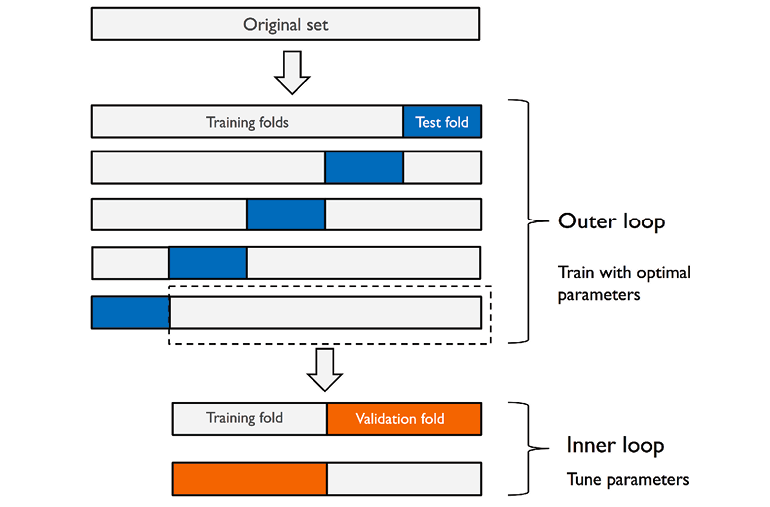

In [35]:
from sklearn.model_selection import cross_validate

# Preprocessing
preprocessor = ColumnTransformer([
    ('num', StandardScaler(), [col for col in num_vars if col != 'ejection_fraction']),
    ('cat', OneHotEncoder(drop='first', sparse_output=False), cat_vars)
])

# Define model search spaces
ridge_pipeline = Pipeline([
    ('preprocessor', preprocessor),
    ('regressor', Ridge())
])

ridge_params = {'regressor__alpha': np.logspace(-3, 3, 50)}
ridge_nested = GridSearchCV(ridge_pipeline, ridge_params, cv=5)

lasso_pipeline = Pipeline([
    ('preprocessor', preprocessor),
    ('regressor', Lasso(max_iter=10000))
])
lasso_params = {'regressor__alpha': np.logspace(-3, 3, 50)}
lasso_nested = GridSearchCV(lasso_pipeline, lasso_params, cv=5)

# Outer CV for nested evaluation
outer_cv = KFold(n_splits=5, shuffle=True, random_state=42)

# Evaluate nested Ridge
ridge_scores = cross_validate(ridge_nested, X, y, scoring=(
    'neg_mean_squared_error', 'neg_mean_absolute_error', 'r2'), cv=outer_cv)

# Evaluate nested Lasso
lasso_scores = cross_validate(lasso_nested, X, y, scoring=(
    'neg_mean_squared_error', 'neg_mean_absolute_error', 'r2'), cv=outer_cv)

# Function to format and print results
def summarize_nested_cv(name, scores):
    print(f"\n {name} Nested Cross-Validation Results (5-Fold):")
    mse = -scores['test_neg_mean_squared_error']
    mae = -scores['test_neg_mean_absolute_error']
    r2 = scores['test_r2']

    print(f"  ▸ MSE   : Mean = {mse.mean():.3f}, Std = {mse.std():.3f}")
    print(f"  ▸ MAE   : Mean = {mae.mean():.3f}, Std = {mae.std():.3f}")
    print(f"  ▸ R²    : Mean = {r2.mean():.3f}, Std = {r2.std():.3f}")

# Print summaries
summarize_nested_cv("Ridge", ridge_scores)
summarize_nested_cv("Lasso", lasso_scores)



 Ridge Nested Cross-Validation Results (5-Fold):
  ▸ MSE   : Mean = 77.203, Std = 6.083
  ▸ MAE   : Mean = 6.935, Std = 0.566
  ▸ R²    : Mean = 0.469, Std = 0.053

 Lasso Nested Cross-Validation Results (5-Fold):
  ▸ MSE   : Mean = 73.606, Std = 7.966
  ▸ MAE   : Mean = 6.786, Std = 0.612
  ▸ R²    : Mean = 0.493, Std = 0.072


Then need to re-tune on the whole training set to get the final best value of alpha

## Penalized Logistic Regression

In [36]:
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, classification_report

# Features and target
X = df[['age', 'anaemia', 'creatinine_phosphokinase', 'diabetes', 'high_blood_pressure',
        'platelets', 'serum_creatinine', 'serum_sodium', 'sex', 'smoking', 'bmi', 'time', 'ejection_fraction']]
y = df['DEATH_EVENT']

categorical_vars = cat_vars.copy()
categorical_vars.remove('DEATH_EVENT')

# Train/Test Split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=123)

# Preprocessing
preprocessor = ColumnTransformer([
    ('num', StandardScaler(), num_vars),
    ('cat', OneHotEncoder(drop='first', sparse_output=False), categorical_vars)
])

# Logistic Regression without regularization (penalty='none')
logreg_none_pipeline = Pipeline([
    ('preprocessor', preprocessor),
    ('classifier', LogisticRegression(penalty=None, solver='lbfgs', max_iter=1000))
])


# Logistic Regression (L2)
logreg_l2_pipeline = Pipeline([
    ('preprocessor', preprocessor),
    ('classifier', LogisticRegression(penalty='l2', solver='liblinear', max_iter=1000))
])

logreg_l2_params = {'classifier__C': np.logspace(-3, 3, 50)}
logreg_l2_cv = GridSearchCV(logreg_l2_pipeline, logreg_l2_params, cv=5, scoring='roc_auc')

# Logistic Regression (L1)
logreg_l1_pipeline = Pipeline([
    ('preprocessor', preprocessor),
    ('classifier', LogisticRegression(penalty='l1', solver='liblinear', max_iter=1000))
])

logreg_l1_params = {'classifier__C': np.logspace(-3, 3, 50)}
logreg_l1_cv = GridSearchCV(logreg_l1_pipeline, logreg_l1_params, cv=5, scoring='roc_auc')

# Fit models
logreg_l2_cv.fit(X_train, y_train)
logreg_l1_cv.fit(X_train, y_train)
logreg_none_pipeline.fit(X_train, y_train)

print("Best C for Logistic Regression (L2):", logreg_l2_cv.best_params_['classifier__C'])
print("Best C for Logistic Regression (L1):", logreg_l1_cv.best_params_['classifier__C'])

# Predictions
y_pred_none = logreg_none_pipeline.predict(X_test)
y_proba_none = logreg_none_pipeline.predict_proba(X_test)[:, 1]

y_pred_l2 = logreg_l2_cv.predict(X_test)
y_proba_l2 = logreg_l2_cv.predict_proba(X_test)[:, 1]

y_pred_l1 = logreg_l1_cv.predict(X_test)
y_proba_l1 = logreg_l1_cv.predict_proba(X_test)[:, 1]

# Evaluation function
def evaluate_classification(y_true, y_pred, y_proba, model_name):
    return {
        'Model': model_name,
        'Accuracy': accuracy_score(y_true, y_pred),
        'Precision': precision_score(y_true, y_pred),
        'Recall': recall_score(y_true, y_pred),
        'F1 Score': f1_score(y_true, y_pred),
        'ROC AUC': roc_auc_score(y_true, y_proba)
    }

# Compare metrics
metrics_classif_df = pd.DataFrame([
    evaluate_classification(y_test, y_pred_none, y_proba_none, 'LogReg None'),
    evaluate_classification(y_test, y_pred_l2, y_proba_l2, 'LogReg L2'),
    evaluate_classification(y_test, y_pred_l1, y_proba_l1, 'LogReg L1')
])

print("\nClassification Performance:")
print(metrics_classif_df)

# Coefficient Comparison
feature_names = logreg_l2_cv.best_estimator_.named_steps['preprocessor'].get_feature_names_out()

coef_df = pd.DataFrame({
    'Feature': ['Intercept'] + list(feature_names),
    'No Reg': [logreg_none_pipeline.named_steps['classifier'].intercept_[0]] +
            list(logreg_none_pipeline.named_steps['classifier'].coef_[0]),
    'L2': [logreg_l2_cv.best_estimator_.named_steps['classifier'].intercept_[0]] +
          list(logreg_l2_cv.best_estimator_.named_steps['classifier'].coef_[0]),
    'L1': [logreg_l1_cv.best_estimator_.named_steps['classifier'].intercept_[0]] +
          list(logreg_l1_cv.best_estimator_.named_steps['classifier'].coef_[0])
})

print("\nCoefficient Comparison:")
print(coef_df)

Best C for Logistic Regression (L2): 0.06866488450043001
Best C for Logistic Regression (L1): 0.1206792640639329

Classification Performance:
         Model  Accuracy  Precision  Recall  F1 Score  ROC AUC
0  LogReg None      0.85       0.83    0.80      0.82     0.90
1    LogReg L2      0.83       0.86    0.72      0.78     0.90
2    LogReg L1      0.82       0.82    0.72      0.77     0.90

Coefficient Comparison:
                          Feature  No Reg    L2    L1
0                       Intercept   -1.02 -0.51 -0.92
1                        num__age    0.62  0.35  0.23
2   num__creatinine_phosphokinase    0.05  0.04  0.00
3          num__ejection_fraction   -0.43 -0.30 -0.08
4                  num__platelets   -0.18 -0.06  0.00
5           num__serum_creatinine    0.23  0.22  0.00
6               num__serum_sodium    0.03  0.02  0.00
7                        num__bmi    0.57  0.31  0.47
8                       num__time   -1.73 -0.92 -1.06
9                  cat__anaemia_1   -0.24

## CV for KNN

Best k: 15 with macro-f1: 0.9799


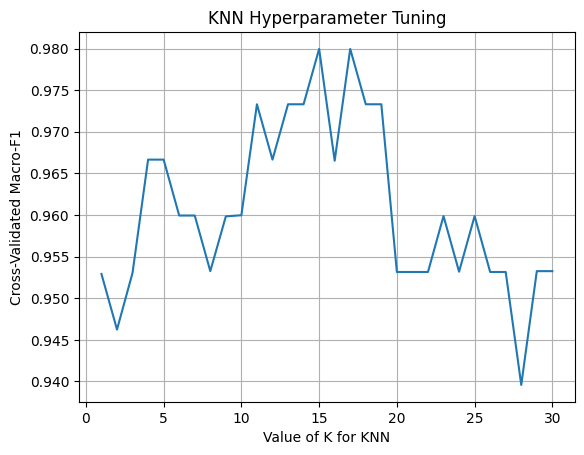

In [37]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.datasets import load_iris
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import cross_val_score, StratifiedKFold

# Load data
iris = load_iris()
X, y = iris.data, iris.target

# Set up stratified CV
cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=42) # keeps y distribution constant among folds

# Evaluate range of k
k_range = range(1, 31)
scores = [cross_val_score(KNeighborsClassifier(n_neighbors=k), X, y, cv=cv, scoring='f1_macro').mean()
          for k in k_range]

# Find best k
best_score_idx = np.argmax(scores)
best_k = k_range[best_score_idx]
print(f"Best k: {best_k} with macro-f1: {scores[best_score_idx]:.4f}")

# Train final model
knn = KNeighborsClassifier(n_neighbors=best_k)
knn.fit(X, y)

# Plot results
plt.plot(k_range, scores)
plt.xlabel('Value of K for KNN')
plt.ylabel('Cross-Validated Macro-F1')
plt.title('KNN Hyperparameter Tuning')
plt.grid(True)
plt.show()


**<font size="5">Applied Statistics</font>**

<font size="3">MSc in High Performance Computing Engineering, Computer Science and Engineering, Physics Engineering - A.Y. 2024-2025</font>

Prof. Mario Beraha - Dott. Vittorio Torri

---

<font size="4">**Lab 9 - Classification and Regression Trees, Random Forest, Boosting**</font>

# LAB 9

## Libraries

In [2]:
import pandas as pd
pd.options.display.float_format = '{:.2f}'.format

In [3]:
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import mean_squared_error
import numpy as np
import matplotlib.pyplot as plt
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.metrics import make_scorer, mean_squared_error, mean_absolute_error, r2_score, classification_report

In [4]:
import statsmodels.api as sm

In [5]:
np.random.seed(1234)

In [6]:
import scipy.stats as stats

## Load Dataset

In [7]:
df = pd.read_csv('../DatasetsLabs/heart_failure_clinical_records_dataset_smhd.csv')

In [8]:
cat_vars = ['anaemia', 'diabetes', 'high_blood_pressure',  'sex',  'smoking',  'DEATH_EVENT']
num_vars = ['age', 'creatinine_phosphokinase', 'ejection_fraction', 'platelets', 'serum_creatinine', 'serum_sodium', 'bmi', 'time']#, 'rehospitalizations']

## Decision Trees

Train Accuracy: 0.98
Test Accuracy:  0.97
              precision    recall  f1-score   support

      setosa       1.00      1.00      1.00        10
  versicolor       1.00      0.90      0.95        10
   virginica       0.91      1.00      0.95        10

    accuracy                           0.97        30
   macro avg       0.97      0.97      0.97        30
weighted avg       0.97      0.97      0.97        30



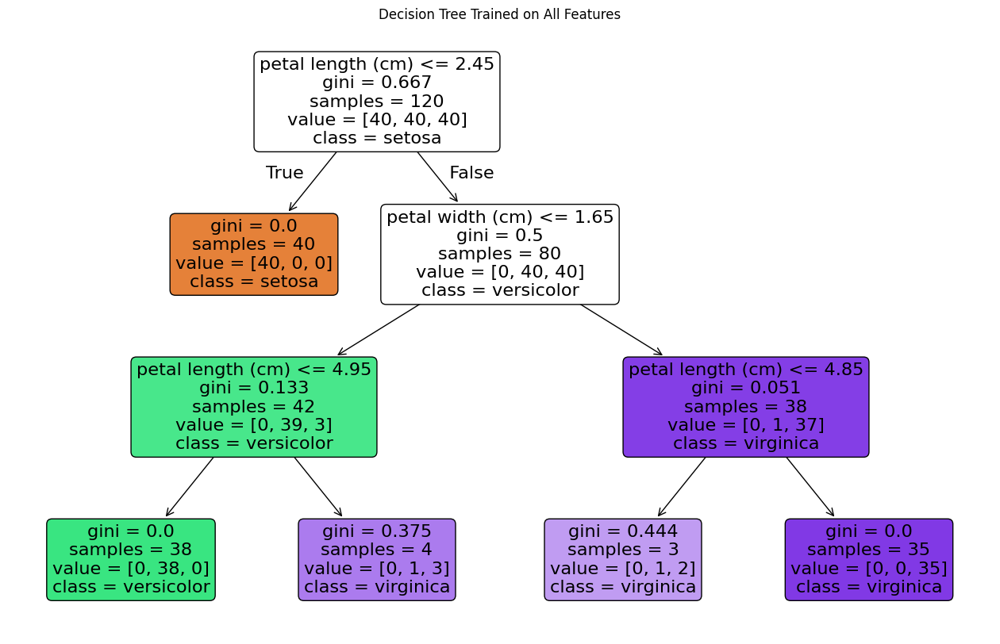

In [9]:
from sklearn.datasets import load_iris
from sklearn.tree import DecisionTreeClassifier, plot_tree
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
from mpl_toolkits.mplot3d import Axes3D

# Load data
iris = load_iris()
X = iris.data
y = iris.target
feature_names = iris.feature_names
target_names = iris.target_names

# Train/test split
X_train, X_test, y_train, y_test = train_test_split(X, y, stratify=y, random_state=42, test_size=0.2)

# Train decision tree using all features
clf = DecisionTreeClassifier(max_depth=3, random_state=42)
clf.fit(X_train, y_train)

# Evaluate
y_pred = clf.predict(X_test)
train_acc = accuracy_score(y_train, clf.predict(X_train))
test_acc = accuracy_score(y_test, y_pred)

print(f"Train Accuracy: {train_acc:.2f}")
print(f"Test Accuracy:  {test_acc:.2f}")
print(classification_report(y_test, y_pred, target_names=target_names))

# Tree Visualization
plt.figure(figsize=(16, 10))
plot_tree(clf, feature_names=feature_names, class_names=target_names, filled=True, rounded=True)
plt.title("Decision Tree Trained on All Features")
plt.show()

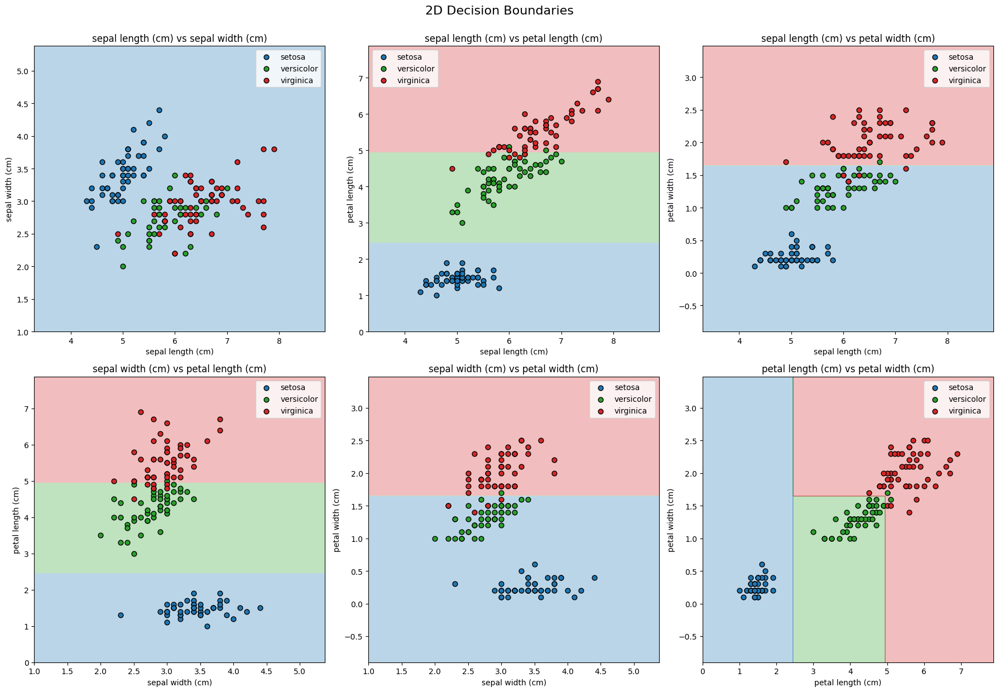

In [10]:
import matplotlib.pyplot as plt
import numpy as np
import itertools
from matplotlib.colors import ListedColormap

# Define class-specific colors
class_colors = ['#1f77b4', '#2ca02c', '#d62728']  # blue, green, red
cmap_light = ListedColormap(class_colors)

# All feature pairs
pairs = list(itertools.combinations(range(X.shape[1]), 2))
plot_step = 0.02
fig, axes = plt.subplots(2, 3, figsize=(18, 12))
axes = axes.flatten()

for idx, (i, j) in enumerate(pairs):
    ax = axes[idx]

    # Create mesh for the selected feature pair
    x_min, x_max = X[:, i].min() - 1, X[:, i].max() + 1
    y_min, y_max = X[:, j].min() - 1, X[:, j].max() + 1
    xx, yy = np.meshgrid(np.arange(x_min, x_max, plot_step),
                         np.arange(y_min, y_max, plot_step))

    # Input for prediction (other features fixed)
    X_slice = np.zeros((xx.ravel().shape[0], X.shape[1]))
    X_slice[:, i] = xx.ravel()
    X_slice[:, j] = yy.ravel()
    for k in range(X.shape[1]):
        if k != i and k != j:
            X_slice[:, k] = X[:, k].mean()

    Z = clf.predict(X_slice).reshape(xx.shape)

    # Plot decision surface
    ax.contourf(xx, yy, Z, alpha=0.3, cmap=cmap_light)

    # Plot data points
    for class_idx, class_color in enumerate(class_colors):
        ax.scatter(X[y == class_idx, i],
                   X[y == class_idx, j],
                   label=target_names[class_idx],
                   c=class_color, edgecolor='k', s=40)

    ax.set_xlabel(feature_names[i])
    ax.set_ylabel(feature_names[j])
    ax.set_title(f"{feature_names[i]} vs {feature_names[j]}")
    ax.legend()

plt.tight_layout()
plt.suptitle("2D Decision Boundaries", fontsize=16, y=1.03)
plt.show()


Different criteria can be used to decide where to split:

$$\text{Gini}(t) = 1 - \sum_{i=1}^{C} p_i^2$$

$$\Delta \text{Gini} = \text{Gini}_{\text{parent}} - \left( \frac{N_L}{N} \cdot \text{Gini}_L + \frac{N_R}{N} \cdot \text{Gini}_R \right)$$

$$\text{Entropy}(t) = -\sum_{i=1}^{C} p_i \log_2 p_i
$$

$$\text{Information Gain} = \text{Entropy}_{\text{parent}} - \left( \frac{N_L}{N} \cdot \text{Entropy}_L + \frac{N_R}{N} \cdot \text{Entropy}_R \right)
$$

Both measures are biased toward variables with many levels




In [11]:
clf_gini = DecisionTreeClassifier(criterion='gini', max_depth=3, random_state=42)
clf_entropy = DecisionTreeClassifier(criterion='entropy', max_depth=3, random_state=42)

clf_gini.fit(X_train, y_train)
clf_entropy.fit(X_train, y_train)

print(f"Gini Test Accuracy:    {accuracy_score(y_test, clf_gini.predict(X_test)):.2f}")
print(f"Entropy Test Accuracy: {accuracy_score(y_test, clf_entropy.predict(X_test)):.2f}")


Gini Test Accuracy:    0.97
Entropy Test Accuracy: 0.97


We can measure feature importance as the (weighted) sum of the delta gini / entropy in all nodes in which it was used

$$
\text{Importance of feature } j = \sum_{\text{nodes } t \text{ using } j} \frac{N_t}{N} \cdot \Delta \text{Impurity}_t
$$

In [12]:
importances = clf.feature_importances_
for name, score in sorted(zip(feature_names, importances), key=lambda x: -x[1]):
    print(f"{name:25s}: {score:.3f}")


petal length (cm)        : 0.579
petal width (cm)         : 0.421
sepal length (cm)        : 0.000
sepal width (cm)         : 0.000


## Depth control

Depth of the tree is a critical parameter:

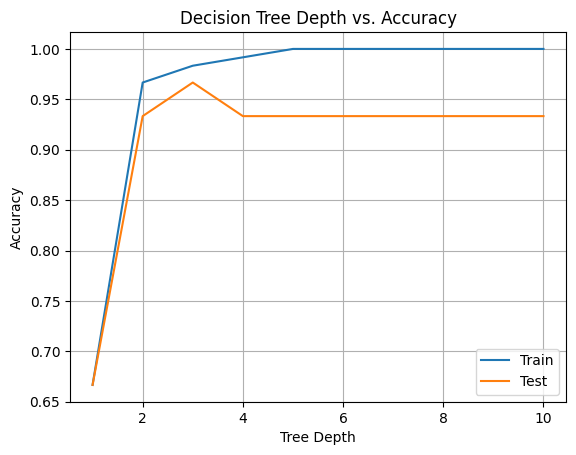

In [13]:
depths = range(1, 11)
train_scores = []
test_scores = []

for d in depths:
    clf = DecisionTreeClassifier(max_depth=d, random_state=42)
    clf.fit(X_train, y_train)
    train_scores.append(clf.score(X_train, y_train))
    test_scores.append(clf.score(X_test, y_test))

plt.plot(depths, train_scores, label="Train")
plt.plot(depths, test_scores, label="Test")
plt.xlabel("Tree Depth")
plt.ylabel("Accuracy")
plt.title("Decision Tree Depth vs. Accuracy")
plt.legend()
plt.grid(True)
plt.show()


If you want to to the pruning during fitting:

In [14]:
path = clf.cost_complexity_pruning_path(X_train, y_train)
alphas = path.ccp_alphas[:-1]  # skip last (trivial) tree

for alpha in alphas:
    clf_pruned = DecisionTreeClassifier(random_state=42, ccp_alpha=alpha)
    clf_pruned.fit(X_train, y_train)
    print(f"Alpha: {alpha:.5f} | Test Accuracy: {clf_pruned.score(X_test, y_test):.3f}")


Alpha: 0.00000 | Test Accuracy: 0.933
Alpha: 0.00625 | Test Accuracy: 0.967
Alpha: 0.00811 | Test Accuracy: 0.967
Alpha: 0.03393 | Test Accuracy: 0.933
Alpha: 0.27068 | Test Accuracy: 0.667


`clf.cost_complexity_pruning_path(X_train, y_train)` returns the effective alphas (regularization strengths) at which:

*   Removing a branch would minimally increase the total impurity
*   But reduce model complexity (number of leaves)

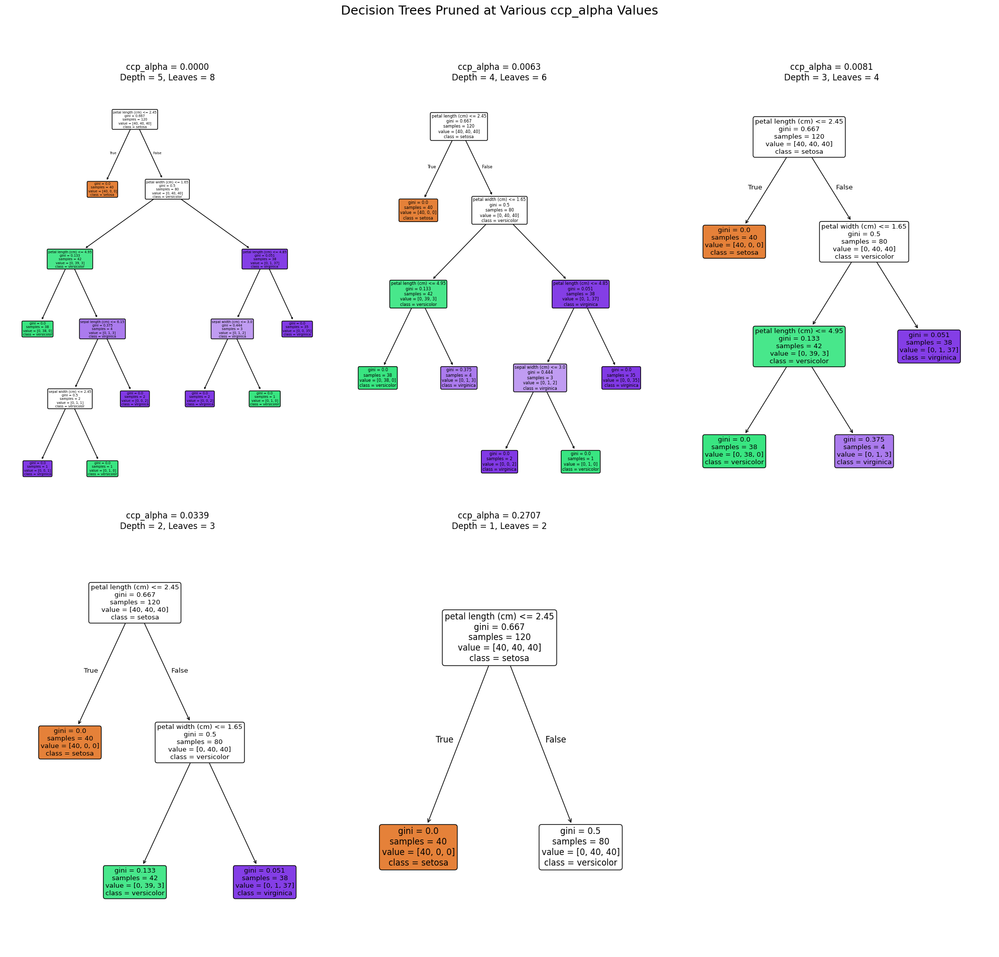

In [15]:
# Get pruning path
clf = DecisionTreeClassifier(random_state=42)
path = clf.cost_complexity_pruning_path(X_train, y_train)
ccp_alphas = path.ccp_alphas[:-1]  # exclude the last alpha (always leads to root-only tree)

# Train a tree for each alpha
clfs = []
for alpha in ccp_alphas:
    clf = DecisionTreeClassifier(random_state=42, ccp_alpha=alpha)
    clf.fit(X_train, y_train)
    clfs.append(clf)

# Plot the trees for a selected subset of alpha values
n_trees_to_plot = min(6, len(clfs))  # limit to 6 for clarity
indices_to_plot = np.linspace(0, len(clfs) - 1, n_trees_to_plot, dtype=int)

plt.figure(figsize=(20, 20))
for i, idx in enumerate(indices_to_plot):
    clf = clfs[idx]
    plt.subplot(2, 3, i + 1)
    plot_tree(clf,
              filled=True,
              rounded=True,
              class_names=target_names,
              feature_names=feature_names)
    plt.title(f"ccp_alpha = {ccp_alphas[idx]:.4f}\nDepth = {clf.get_depth()}, Leaves = {clf.get_n_leaves()}")
plt.suptitle("Decision Trees Pruned at Various ccp_alpha Values", fontsize=18)
plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()


Selection of ccp_alpha can be done via CV:

Best ccp_alpha: 0.00000 with CV accuracy: 0.9417
Test accuracy of pruned tree: 0.9333


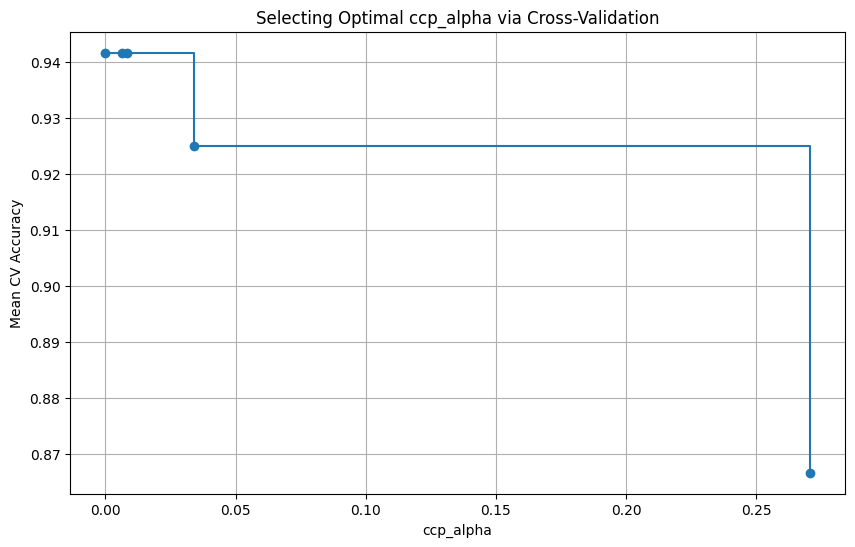

In [16]:
from sklearn.model_selection import cross_val_score

# Step 1: Get pruning path
clf = DecisionTreeClassifier(random_state=1234)
path = clf.cost_complexity_pruning_path(X_train, y_train)
ccp_alphas = path.ccp_alphas[:-1]  # skip the last one (trivial tree)

# Step 2: Train trees with different alphas + CV
clfs = []
cv_scores = []

for alpha in ccp_alphas:
    clf = DecisionTreeClassifier(random_state=42, ccp_alpha=alpha)
    scores = cross_val_score(clf, X_train, y_train, cv=5)
    clfs.append(clf)
    cv_scores.append(scores.mean())

# Step 3: Select best alpha
best_idx = np.argmax(cv_scores)
best_alpha = ccp_alphas[best_idx]
print(f"Best ccp_alpha: {best_alpha:.5f} with CV accuracy: {cv_scores[best_idx]:.4f}")

# Step 4: Retrain final model on full training set with best alpha
final_tree = DecisionTreeClassifier(random_state=42, ccp_alpha=best_alpha)
final_tree.fit(X_train, y_train)

# Evaluate on test set
test_acc = final_tree.score(X_test, y_test)
print(f"Test accuracy of pruned tree: {test_acc:.4f}")

# Step 5: Plot alpha vs. CV accuracy
plt.figure(figsize=(10, 6))
plt.plot(ccp_alphas, cv_scores, marker='o', drawstyle="steps-post")
plt.xlabel("ccp_alpha")
plt.ylabel("Mean CV Accuracy")
plt.title("Selecting Optimal ccp_alpha via Cross-Validation")
plt.grid(True)
plt.show()

## Regression Tree

In [17]:
from sklearn.tree import DecisionTreeRegressor

# Separate features/target
X = df.drop(columns='ejection_fraction')
y = df['ejection_fraction']

numeric_vars = num_vars.copy()
numeric_vars.remove('ejection_fraction')
categorical_vars = cat_vars.copy()

# Preprocessing
preprocessor = ColumnTransformer([
    ('num', StandardScaler(), numeric_vars),
    ('cat', OneHotEncoder(drop='first'), categorical_vars)
])

# Pipeline
pipeline = Pipeline([
    ('preprocessor', preprocessor),
    ('regressor', DecisionTreeRegressor(random_state=42, max_depth=4))
])

# Train/test split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Fit model
pipeline.fit(X_train, y_train)
y_pred = pipeline.predict(X_test)

# Adjusted R²
r2 = r2_score(y_test, y_pred)
n = len(y_test)
p = preprocessor.fit(X_train).transform(X_train).shape[1]
adj_r2 = 1 - ((1 - r2) * (n - 1)) / (n - p - 1)

# Metrics
mse = mean_squared_error(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)

print(f"R² Score:       {r2:.3f}")
print(f"Adjusted R²:    {adj_r2:.3f}")
print(f"MSE:            {mse:.3f}")
print(f"MAE:            {mae:.3f}")


R² Score:       0.363
Adjusted R²:    0.183
MSE:            110.892
MAE:            7.924


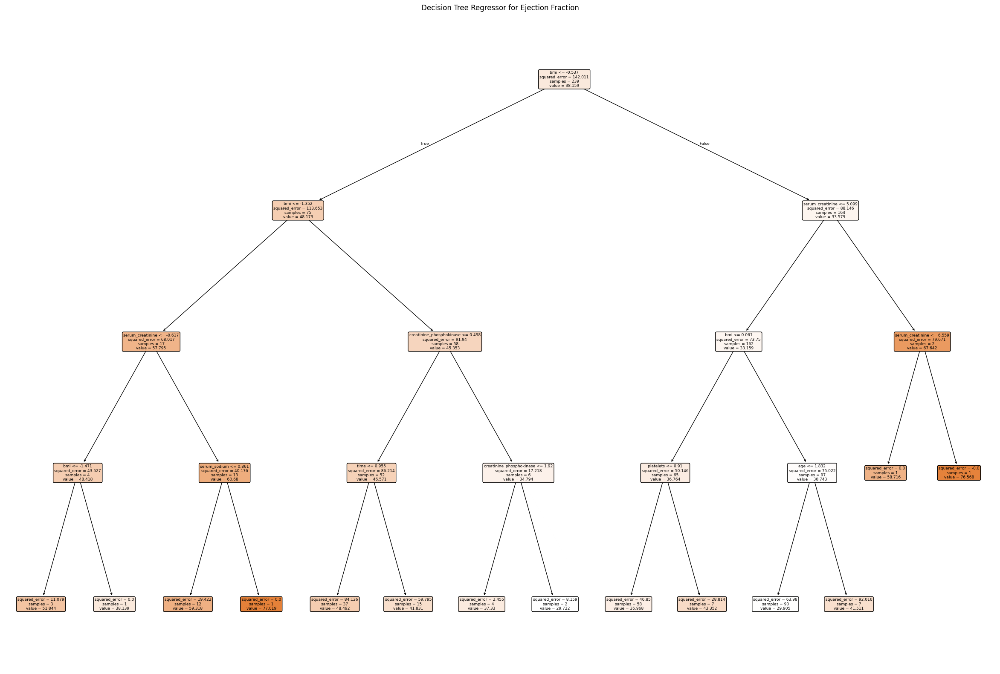

In [18]:
# Get feature names after encoding
encoded_feature_names = preprocessor.named_transformers_['cat'].get_feature_names_out(categorical_vars)
all_feature_names = numeric_vars + list(encoded_feature_names)

# Plot the tree
reg_tree = pipeline.named_steps['regressor']

plt.figure(figsize=(30, 20))
plot_tree(reg_tree,
          feature_names=all_feature_names,
          filled=True,
          rounded=True,)
plt.title("Decision Tree Regressor for Ejection Fraction")
plt.show()

## Random Forest

In [19]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.datasets import load_iris
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.metrics import accuracy_score, classification_report, ConfusionMatrixDisplay

# Load data
iris = load_iris()
X, y = iris.data, iris.target
feature_names = iris.feature_names
target_names = iris.target_names

# Train/test split
X_train, X_test, y_train, y_test = train_test_split(X, y, stratify=y, test_size=0.2, random_state=42)

# Train Random Forest
rf = RandomForestClassifier(n_estimators=100, max_depth=5, random_state=42)
rf.fit(X_train, y_train)

# Predict
y_pred = rf.predict(X_test)

# Evaluate
acc = accuracy_score(y_test, y_pred)
print(f"Test Accuracy: {acc:.3f}")
print("\nClassification Report:")
print(classification_report(y_test, y_pred, target_names=target_names))

Test Accuracy: 0.933

Classification Report:
              precision    recall  f1-score   support

      setosa       1.00      1.00      1.00        10
  versicolor       0.90      0.90      0.90        10
   virginica       0.90      0.90      0.90        10

    accuracy                           0.93        30
   macro avg       0.93      0.93      0.93        30
weighted avg       0.93      0.93      0.93        30



## Hyperparameters

Recommended values are $m=p/3$ for regression and $m=\sqrt{p}$ for classification, with m being the % of features to keep (max_features)

In [20]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score

# Define parameter grid
param_grid = {
    'n_estimators': [10, 50, 100],
    'max_depth': [None, 3, 5, 10],
    'max_features': ['sqrt', 'log2', None]  # or you can use int values
}

# Setup grid search
rf = RandomForestClassifier(random_state=42)
grid_search = GridSearchCV(rf, param_grid, cv=5, scoring='accuracy', n_jobs=-1, verbose=1)
grid_search.fit(X_train, y_train)

# Best model
best_rf = grid_search.best_estimator_
print(f"\nBest Parameters: {grid_search.best_params_}")
print(f"Best CV Accuracy: {grid_search.best_score_:.3f}")

# Test performance
y_pred = best_rf.predict(X_test)
print("\nTest Accuracy:", accuracy_score(y_test, y_pred))
print("\nClassification Report:\n", classification_report(y_test, y_pred, target_names=target_names))

Fitting 5 folds for each of 36 candidates, totalling 180 fits

Best Parameters: {'max_depth': None, 'max_features': 'sqrt', 'n_estimators': 10}
Best CV Accuracy: 0.958

Test Accuracy: 0.9666666666666667

Classification Report:
               precision    recall  f1-score   support

      setosa       1.00      1.00      1.00        10
  versicolor       1.00      0.90      0.95        10
   virginica       0.91      1.00      0.95        10

    accuracy                           0.97        30
   macro avg       0.97      0.97      0.97        30
weighted avg       0.97      0.97      0.97        30



## Out-Of-Bag evaluation



1.   For each training point, collect predictions from only the trees that didn’t see it.
2.  Compare these predictions to the true labels.
3.  Average the accuracy (or other metric) over all such point






In [21]:
rf_oob = RandomForestClassifier(oob_score=True, n_estimators=100, random_state=42)
rf_oob.fit(X, y)
print("OOB Score:", rf_oob.oob_score_)

OOB Score: 0.9533333333333334


The scikit-learn OOB implementation is limited to accuracy for classification and R^2 for regression. Other metrics can be computed by accessing the OOB predictions:

In [22]:
from sklearn.metrics import f1_score

y_pred_oob = np.argmax(rf_oob.oob_decision_function_, axis=1)
f1 = f1_score(y, y_pred_oob, average='macro')
print(f"OOB F1 Score (macro): {f1:.3f}")

OOB F1 Score (macro): 0.953


## Interpretation

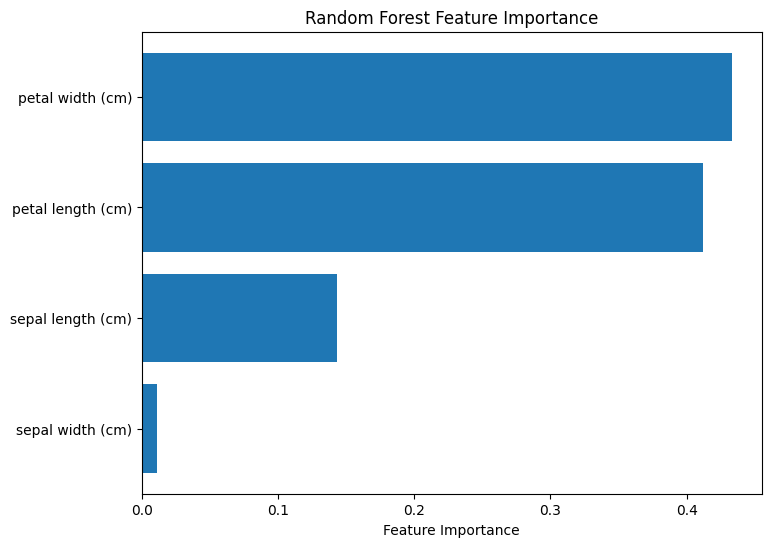

In [23]:
importances = best_rf.feature_importances_
sorted_idx = np.argsort(importances)[::-1]

plt.figure(figsize=(8, 6))
plt.barh(np.array(feature_names)[sorted_idx], importances[sorted_idx])
plt.xlabel("Feature Importance")
plt.title("Random Forest Feature Importance")
plt.gca().invert_yaxis()
plt.show()

Partial Dependency Plots

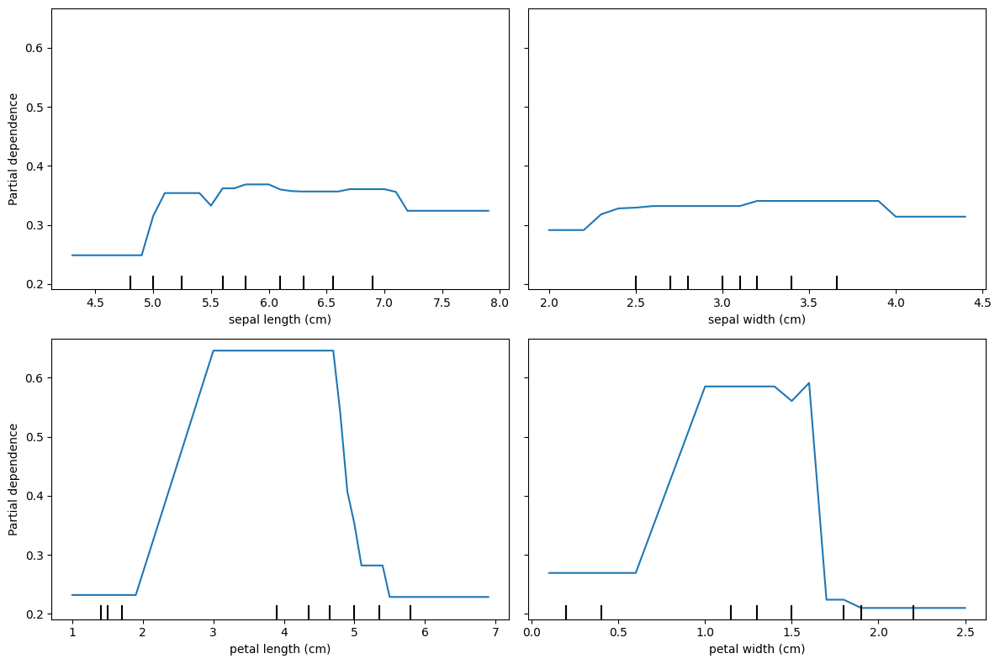

In [24]:
from sklearn.inspection import PartialDependenceDisplay

fig, ax = plt.subplots(2, 2, figsize=(12, 8))  # Adjust as needed
PartialDependenceDisplay.from_estimator(best_rf, X, features=[0, 1, 2, 3], feature_names=feature_names, target=1, ax=ax)
plt.tight_layout()
plt.show()

## Random Forest for Regression

In [25]:
from sklearn.ensemble import RandomForestRegressor

# Separate features/target
X = df.drop(columns='ejection_fraction')
y = df['ejection_fraction']

numeric_vars = num_vars.copy()
numeric_vars.remove('ejection_fraction')
categorical_vars = cat_vars.copy()

# Preprocessing pipeline
preprocessor = ColumnTransformer([
    ('num', StandardScaler(), numeric_vars),
    ('cat', OneHotEncoder(drop='first'), categorical_vars)
])

# Full pipeline with RandomForestRegressor
pipeline = Pipeline([
    ('preprocessor', preprocessor),
    ('model', RandomForestRegressor(n_estimators=100, random_state=42, oob_score=True))
])

# Split data
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Fit model
pipeline.fit(X_train, y_train)
y_pred = pipeline.predict(X_test)

# Adjusted R²
r2 = r2_score(y_test, y_pred)
n = len(y_test)
p = preprocessor.fit(X_train).transform(X_train).shape[1]
adj_r2 = 1 - ((1 - r2) * (n - 1)) / (n - p - 1)

mse = mean_squared_error(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)

# Output
rf_model = pipeline.named_steps['model']
print(f"OOB R²: {rf_model.oob_score_:.3f}")
print(f"R²:        {r2:.3f}")
print(f"Adjusted R²:    {adj_r2:.3f}")
print(f"MSE:            {mse:.2f}")
print(f"MAE:            {mae:.2f}")


OOB R²: 0.416
R²:        0.567
Adjusted R²:    0.445
MSE:            75.41
MAE:            6.92


## Gradient Boosting

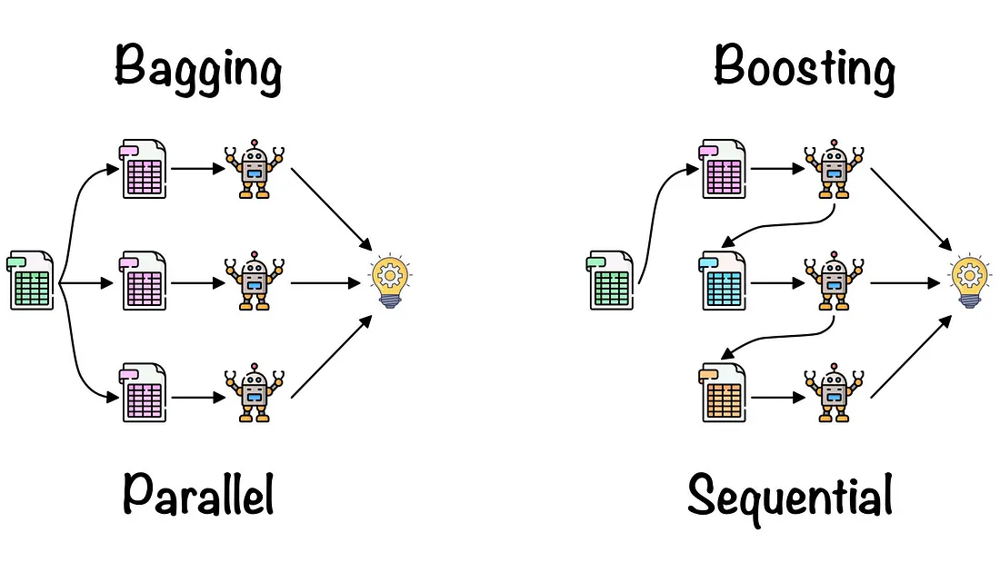

## Gradient Boosting Regressor

In [26]:
from sklearn.ensemble import GradientBoostingRegressor

# Separate features/target
X = df.drop(columns='ejection_fraction')
y = df['ejection_fraction']

numeric_vars = num_vars.copy()
numeric_vars.remove('ejection_fraction')
categorical_vars = cat_vars.copy()

# Preprocessing
preprocessor = ColumnTransformer([
    ('num', StandardScaler(), numeric_vars),
    ('cat', OneHotEncoder(drop='first'), categorical_vars)
])

# Pipeline with Gradient Boosting
pipeline = Pipeline([
    ('preprocessor', preprocessor),
    ('model', GradientBoostingRegressor(
        n_estimators=100,
        learning_rate=0.1,
        max_depth=3,
        random_state=42))
])

# Train/test split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# Fit model
pipeline.fit(X_train, y_train)
y_pred = pipeline.predict(X_test)

# Adjusted R²
r2 = r2_score(y_test, y_pred)
n = len(y_test)
p = preprocessor.fit(X_train).transform(X_train).shape[1]
adj_r2 = 1 - ((1 - r2) * (n - 1)) / (n - p - 1)

mse = mean_squared_error(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)

# Output
print(f"R²:        {r2:.3f}")
print(f"Adjusted R²:    {adj_r2:.3f}")
print(f"MSE:            {mse:.2f}")
print(f"MAE:            {mae:.2f}")


R²:        0.486
Adjusted R²:    0.398
MSE:            88.24
MAE:            7.57


## Gradient Boosting Classifier

Test Accuracy: 0.967

Classification Report:
              precision    recall  f1-score   support

      setosa       1.00      1.00      1.00        10
  versicolor       1.00      0.90      0.95        10
   virginica       0.91      1.00      0.95        10

    accuracy                           0.97        30
   macro avg       0.97      0.97      0.97        30
weighted avg       0.97      0.97      0.97        30



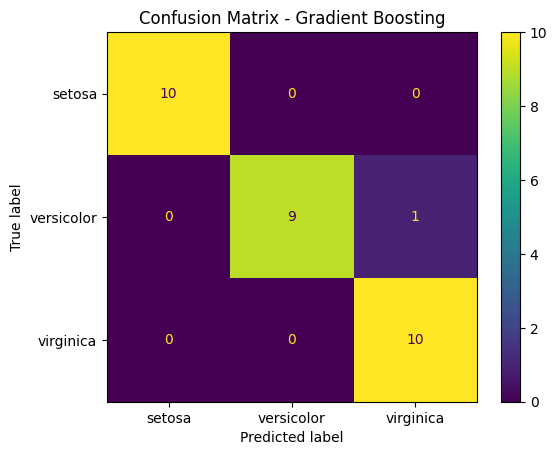

In [27]:
from sklearn.datasets import load_iris
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.metrics import accuracy_score, classification_report, ConfusionMatrixDisplay

# Load iris data
iris = load_iris()
X, y = iris.data, iris.target
feature_names = iris.feature_names
target_names = iris.target_names

# Train/test split
X_train, X_test, y_train, y_test = train_test_split(X, y, stratify=y, test_size=0.2, random_state=42)

# Gradient Boosting fit
gb = GradientBoostingClassifier(n_estimators=100, learning_rate=0.1, max_depth=3, random_state=42)
gb.fit(X_train, y_train)

# Predict
y_pred = gb.predict(X_test)

# Evaluate
acc = accuracy_score(y_test, y_pred)
print(f"Test Accuracy: {acc:.3f}")
print("\nClassification Report:")
print(classification_report(y_test, y_pred, target_names=target_names))

ConfusionMatrixDisplay.from_estimator(gb, X_test, y_test, display_labels=target_names)
plt.title("Confusion Matrix - Gradient Boosting")
plt.show()


In [28]:
from sklearn.linear_model import LinearRegression
model = LinearRegression()


In [29]:
num_vars = ['age', 'creatinine_phosphokinase', 'ejection_fraction', 'platelets', 'serum_creatinine', 'serum_sodium', 'bmi', 'time']#, 'rehospitalizations']
num_vars.remove('ejection_fraction')

X = df[num_vars]
y = df['ejection_fraction']

model.fit(X,y)

,fit_intercept,True
,copy_X,True
,tol,1e-06
,n_jobs,None
,positive,False


In [30]:
y_pred = model.predict(X)
residuals = y - y_pred

299

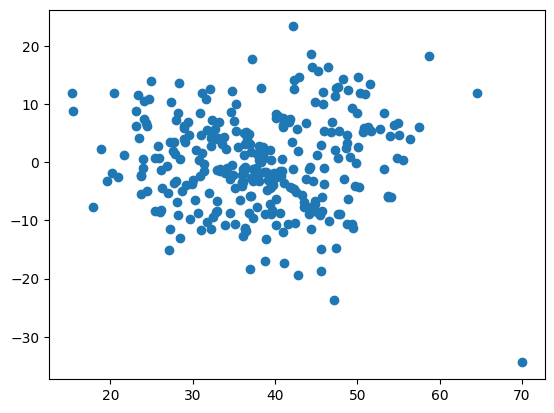

In [31]:
#plotting
import matplotlib.pyplot as plt
plt.scatter(y_pred, residuals)
len(residuals)

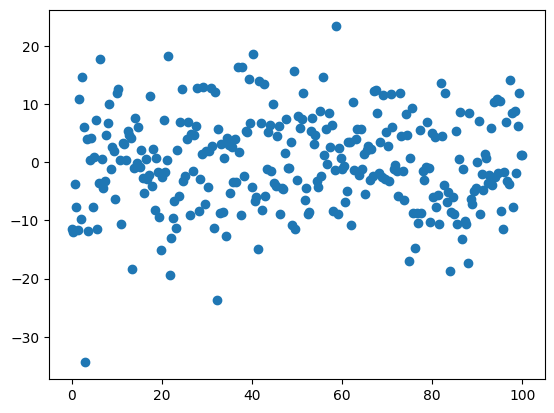

In [33]:
x_plotting = np.linspace(0, 100, 299)
plt.scatter(x_plotting, residuals)


## Manual implementation

In [34]:
from sklearn.tree import DecisionTreeRegressor

# -----------------------------
# Data generation and plotting
# -----------------------------

def GenerateData():
    X = np.arange(0, 50).reshape(-1, 1)

    y = np.concatenate([
        np.random.uniform(10, 15, 10),
        np.random.uniform(20, 25, 10),
        np.random.uniform(0, 5, 10),
        np.random.uniform(30, 32, 10),
        np.random.uniform(13, 17, 10)
    ])

    return X, y.reshape(-1, 1)

def PlotModel(X, y, yp, title='', fn=None):
    plt.figure(figsize=(20,10))
    plt.scatter(X, y, color='blue', label='True y')
    plt.plot(X, yp, color='red', label='Prediction')
    plt.xlim([-1, 51])
    plt.ylim([-1, 35])
    plt.xlabel('x')
    plt.ylabel('y')
    plt.title(title)
    plt.legend()
    if fn:
        plt.savefig(fn)
    plt.show()

def PlotResidual(X, residuals, title='', fn=None):
    plt.figure(figsize=(20,10))
    plt.scatter(X, residuals, color='green')
    plt.xlim([-1, 51])
    plt.ylim([-25, 25])
    plt.xlabel('x')
    plt.ylabel('residual')
    plt.title(title)
    if fn:
        plt.savefig(fn)
    plt.show()

# -----------------------------
# Gradient Boosting Logic
# -----------------------------

def GradientBoosting(X, y, n_iterations=30, max_depth=1, plot=True):
    # Initial prediction is the mean
    initial_pred = np.ones_like(y) * y.mean()
    prediction = initial_pred.copy()

    if plot:
        PlotModel(X, y, initial_pred, title='Iteration #1 - Initial Mean')
        PlotResidual(X, y - prediction, title='Iteration #1 - Residual')

    for i in range(n_iterations):
        residuals = y - prediction

        stump = DecisionTreeRegressor(max_depth=max_depth)
        stump.fit(X, residuals)
        update = stump.predict(X).reshape(-1, 1)

        prediction += update

        if plot and (i+2)%5==0:
            PlotModel(X, y, prediction, title=f'Iteration #{i+2} - Model')
            PlotResidual(X, y - prediction, title=f'Iteration #{i+2} - Residual')

    return prediction

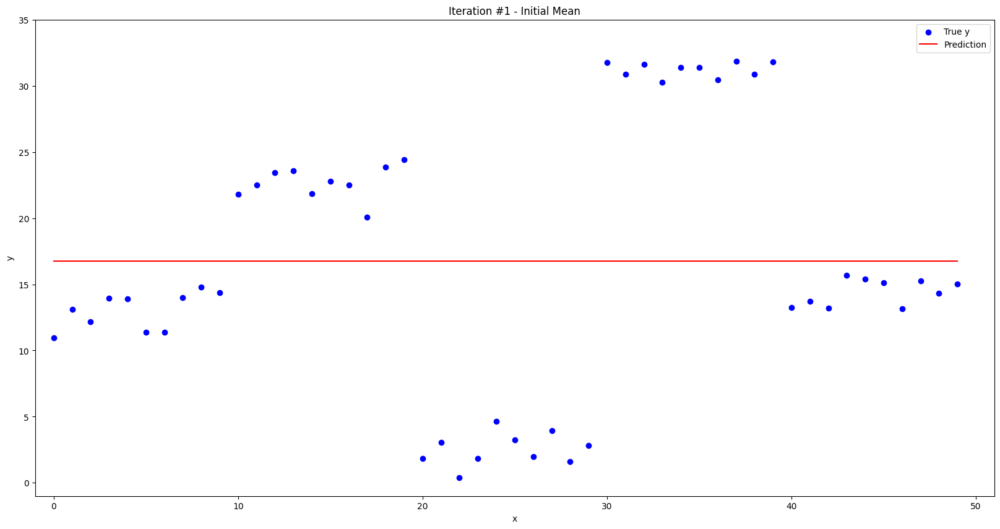

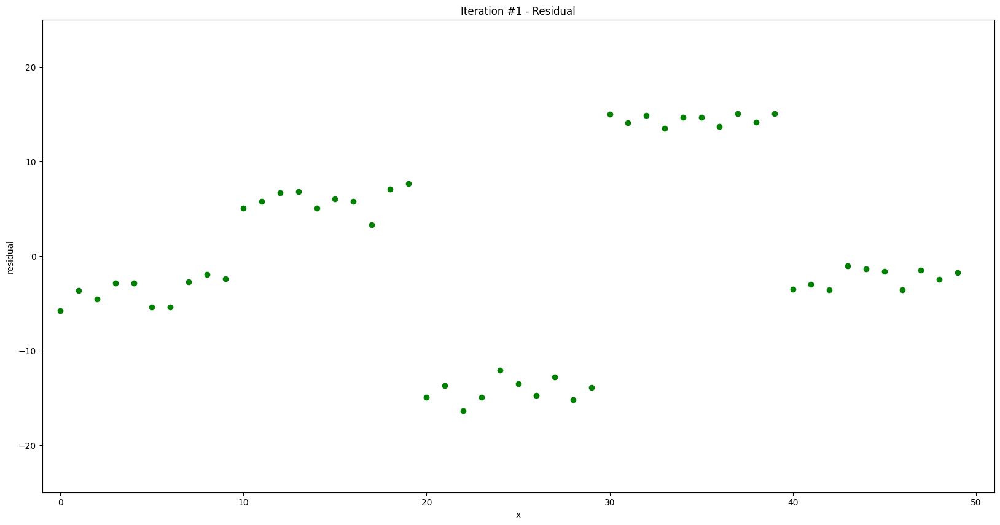

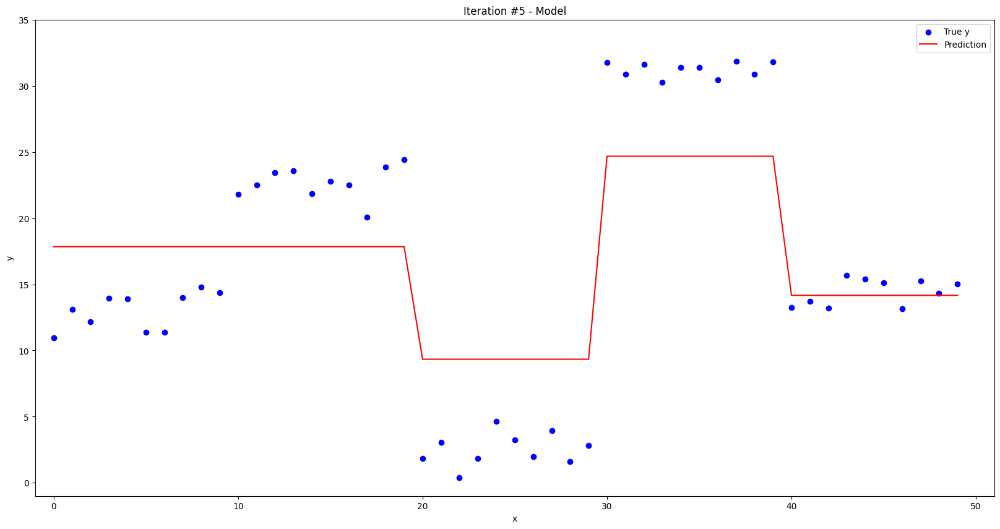

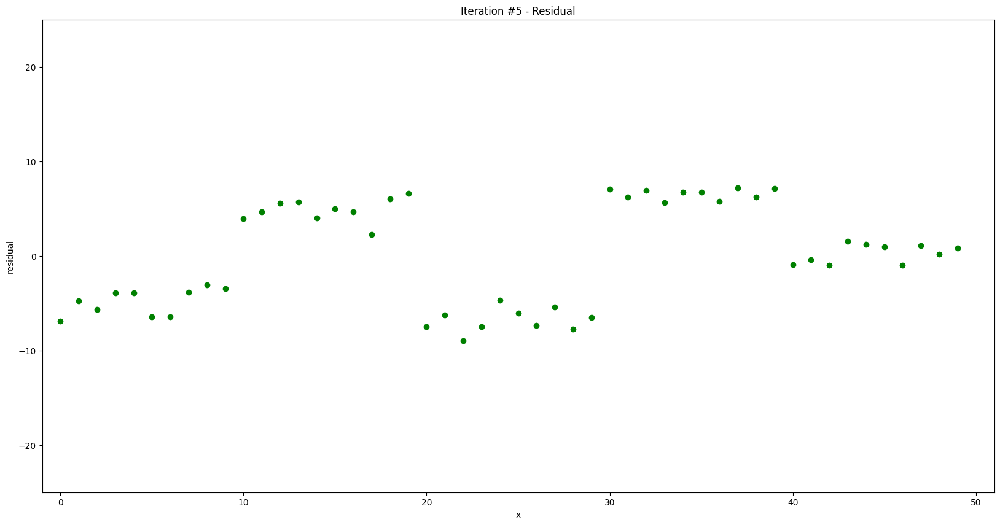

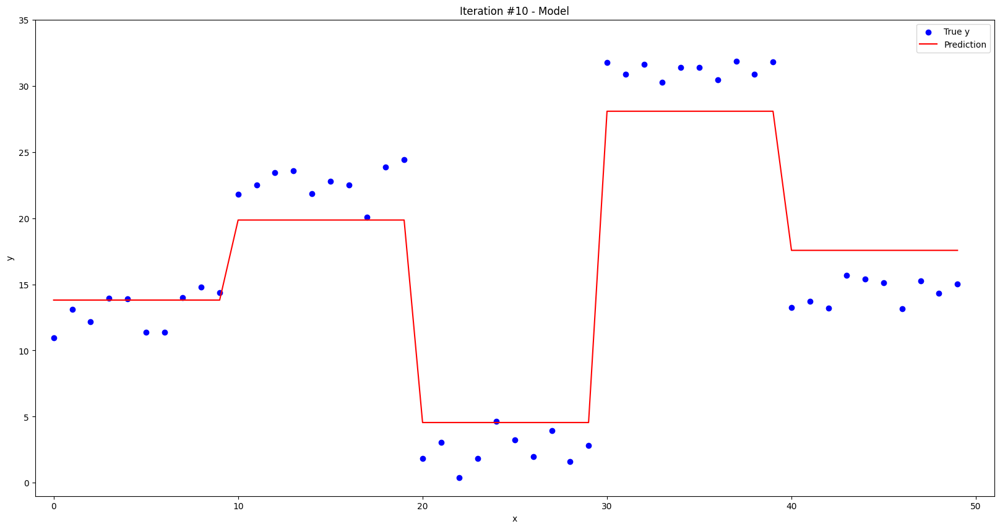

...

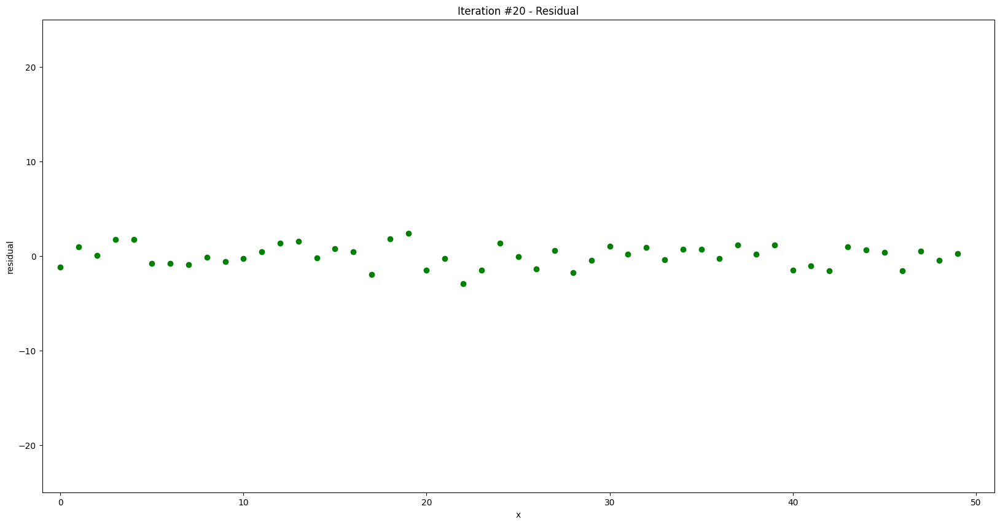

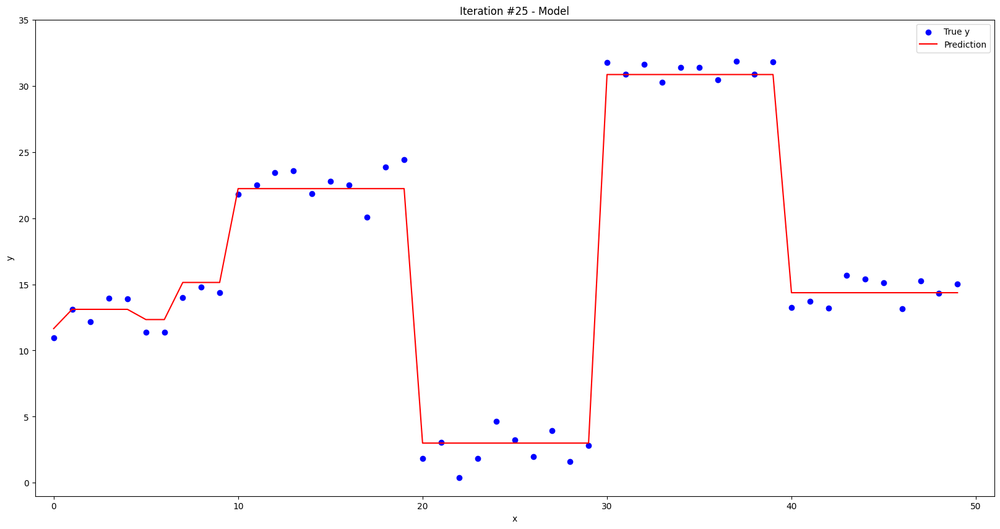

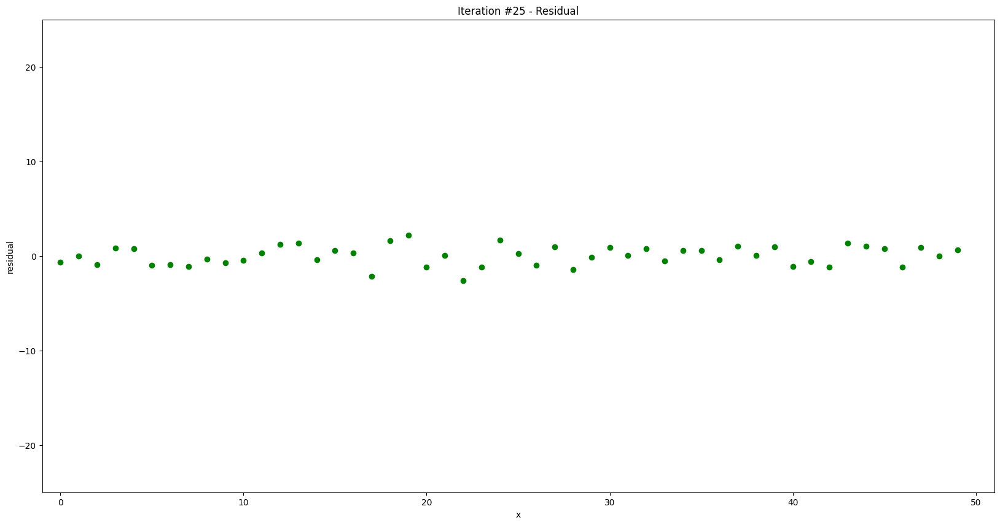

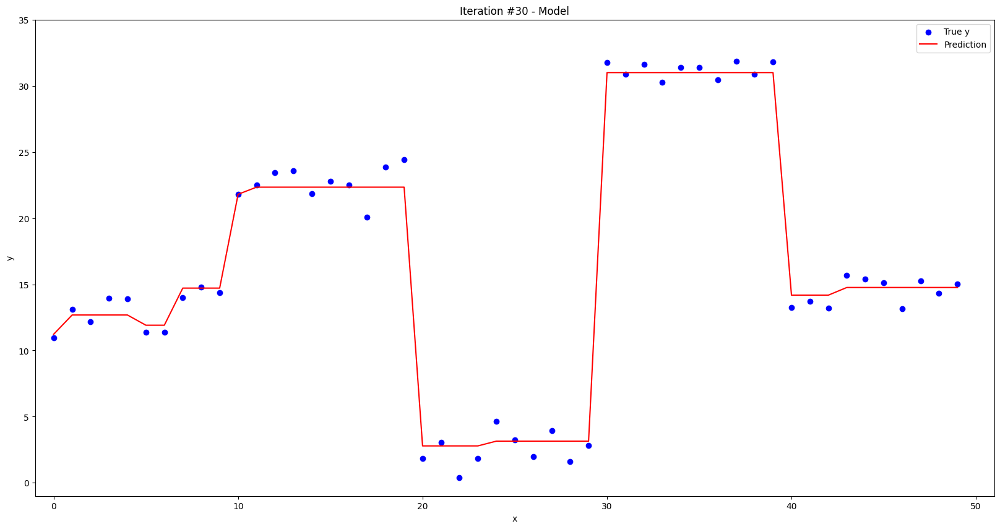

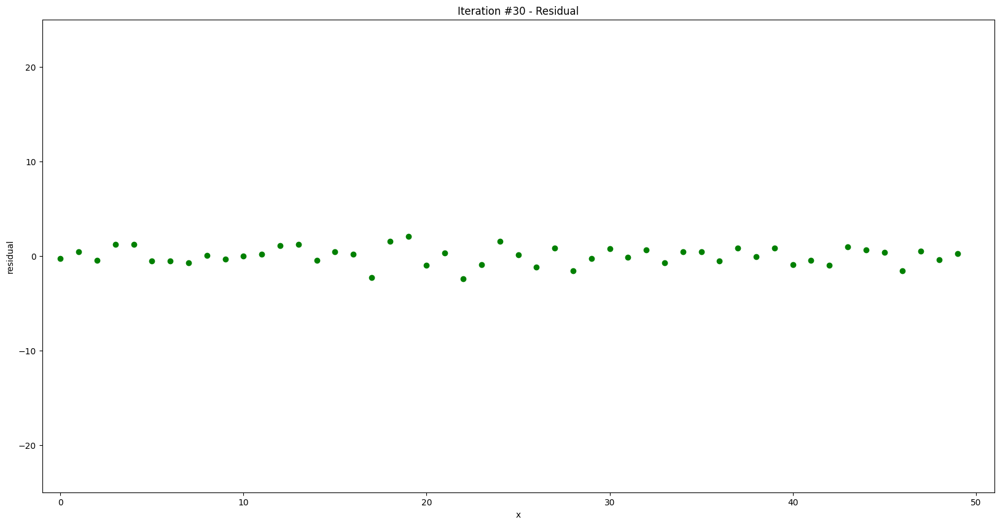

In [35]:
X, y = GenerateData()
final_prediction = GradientBoosting(X, y, n_iterations=30, max_depth=1, plot=True)

## XGBoost

Have a look at it, with its improvements over Gradient Boosting, if you are curious!